# Generative_Airfoil

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# drive.mount("/content/drive", force_remount=True)

In [3]:
# !pip install beautifulsoup4 lxml
# !apt-get install -y xfoil  # Install XFOIL for airfoil analysis


In [4]:
import os
import requests
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from zipfile import ZipFile
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import os
import requests
import zipfile
import os
import urllib.request as urllib2
from bs4 import BeautifulSoup
import re

## Dataset

### init

In [5]:
import os

extract_path = "data"

# Ensure the directory exists
os.makedirs(extract_path, exist_ok=True)

In [6]:
!mkdir -p /content/data
!cp /content/drive/MyDrive/AI/Airfoil_diffusion/Dataset/Fulldata/*.npy /content/data/
!ls /content/data


coord_min_max.npy  xs_test_scaled.npy	ys_test.npy	    ys_train_scaled.npy
label_min_max.npy  xs_train.npy		ys_test_scaled.npy
xs_test.npy	   xs_train_scaled.npy	ys_train.npy


In [7]:
# --- Stage-0 : set paths & load raw arrays ----------------------------
from pathlib import Path
import numpy as np

DATA_DIR = Path("/content/data")          # change here if you move the .npy files

RAW_X_TRAIN = DATA_DIR / "xs_train.npy"
RAW_X_TEST  = DATA_DIR / "xs_test.npy"
RAW_Y_TRAIN = DATA_DIR / "ys_train.npy"
RAW_Y_TEST  = DATA_DIR / "ys_test.npy"

xs_train = np.load(RAW_X_TRAIN)           # (N_train, 192, 2)
xs_test  = np.load(RAW_X_TEST)            # (N_test , 192, 2)
ys_train = np.load(RAW_Y_TRAIN)           # (N_train, 2)  -> [CL, CD]
ys_test  = np.load(RAW_Y_TEST)            # (N_test , 2)

print("Train shapes :", xs_train.shape, ys_train.shape)
print("Test  shapes :", xs_test.shape , ys_test.shape)
# ----------------------------------------------------------------------


Train shapes : (38802, 192, 2) (38802, 2)
Test  shapes : (9701, 192, 2) (9701, 2)


In [8]:
ls

data/  drive/  sample_data/


In [9]:
import os
import numpy as np

npy_files = [f for f in os.listdir(DATA_DIR) if f.endswith('.npy')]

# Display structure of the numpy arrays
for npy_file in npy_files:
    file_path = os.path.join(DATA_DIR, npy_file)
    data = np.load(file_path)

    # Assuming the naming convention includes 'train' or 'test' in the filename
    dataset_type = 'Training' if 'train' in npy_file else 'Testing'

    print(f"\n{npy_file} ({dataset_type} Dataset):")
    print(f"Shape: {data.shape}")
    print(f"Data Type: {data.dtype}")
    print(f"Sample Data (First Row):\n{data[:1]}")



label_min_max.npy (Testing Dataset):
Shape: (2, 2)
Data Type: float32
Sample Data (First Row):
[[0. 0.]]

ys_train_scaled.npy (Training Dataset):
Shape: (38802, 2)
Data Type: float64
Sample Data (First Row):
[[0.5575  0.00741]]

xs_train.npy (Training Dataset):
Shape: (38802, 192, 2)
Data Type: float64
Sample Data (First Row):
[[[ 1.00003650e+00  8.06423311e-05]
  [ 9.91114001e-01  3.84616473e-03]
  [ 9.81408451e-01  7.49134118e-03]
  [ 9.70801940e-01  1.11778953e-02]
  [ 9.59716845e-01  1.49610729e-02]
  [ 9.48900590e-01  1.87715464e-02]
  [ 9.38072993e-01  2.27168406e-02]
  [ 9.27228228e-01  2.67855167e-02]
  [ 9.16360641e-01  3.09656323e-02]
  [ 9.05463659e-01  3.52451373e-02]
  [ 8.94531705e-01  3.96111063e-02]
  [ 8.83558321e-01  4.40504487e-02]
  [ 8.72536603e-01  4.85497239e-02]
  [ 8.61460257e-01  5.30946851e-02]
  [ 8.50346112e-01  5.76611384e-02]
  [ 8.39239950e-01  6.22240082e-02]
  [ 8.28192391e-01  6.67761004e-02]
  [ 8.17209218e-01  7.13302566e-02]
  [ 8.06294690e-01  7.

### Plot, Analysis

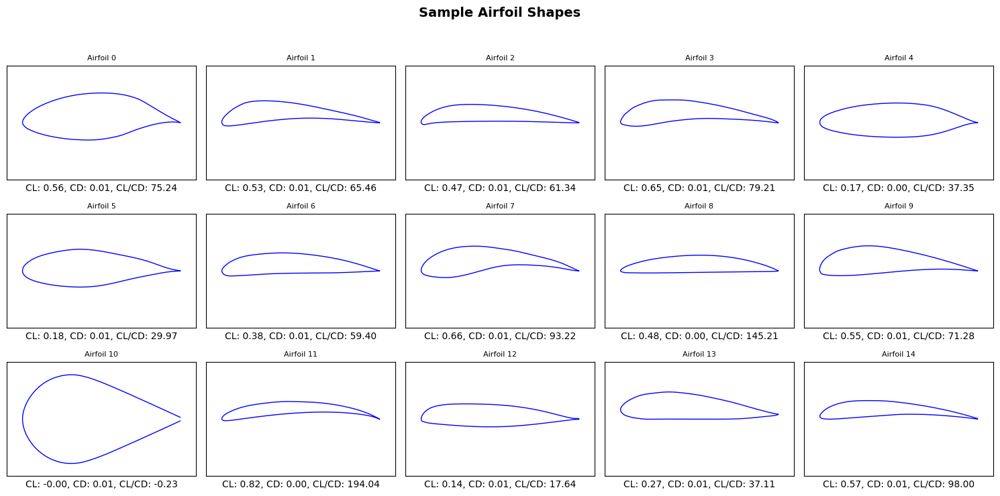

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Function to plot airfoils in a grid layout
def plot_airfoils_grid(xs_data, ys_data, num_samples=15, rows=3, cols=5, title="Sample Airfoil Shapes"):
    num_samples = min(num_samples, len(xs_data))  # Ensure we don't exceed available airfoils
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 2.5))  # Adjust size dynamically
    fig.suptitle(title, fontsize=14, fontweight='bold')

    for i, ax in enumerate(axes.flat):  # Loop over subplots
        if i < num_samples:
            x_coords = xs_data[i, :, 0]  # Extract X coordinates
            y_coords = xs_data[i, :, 1]  # Extract Y coordinates
            Cl = ys_data[i, 0]  # Extract CL value
            Cd = ys_data[i, 1]  # Extract CD value
            # epsilon = 1e-8
            cl_cd_ratio = Cl / (Cd) # Calculate CL/CD ratio
            # Todo: here is wrong
            ax.plot(x_coords, y_coords, color='blue', linewidth=1)
            ax.set_title(f"Airfoil {i}", fontsize=8)
            ax.set_xlabel(f"CL: {Cl:.2f}, CD: {Cd:.2f}, CL/CD: {cl_cd_ratio:.2f}")
            ax.set_xticks([])
            ax.set_yticks([])
            ax.set_xlim(-0.1, 1.1)  # Normalize X range
            ax.set_ylim(-0.25, 0.25)  # Normalize Y range
        else:
            ax.axis('off')  # Hide extra subplots if not needed

    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit title
    plt.show()

# Run the function with 15 airfoil samples
plot_airfoils_grid(xs_train, ys_train, num_samples=15, rows=3, cols=5)


### initial data analysis of data


=== Label distributions ===


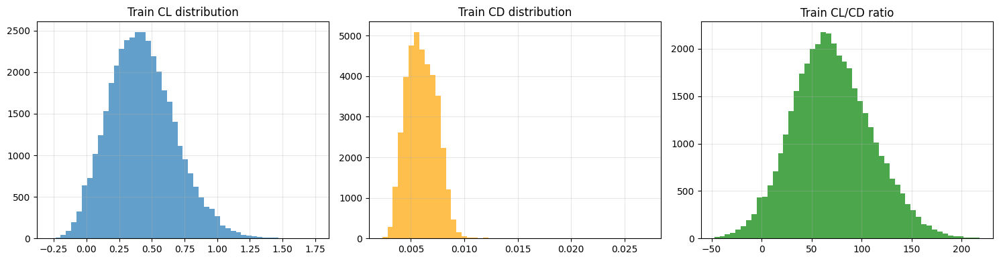

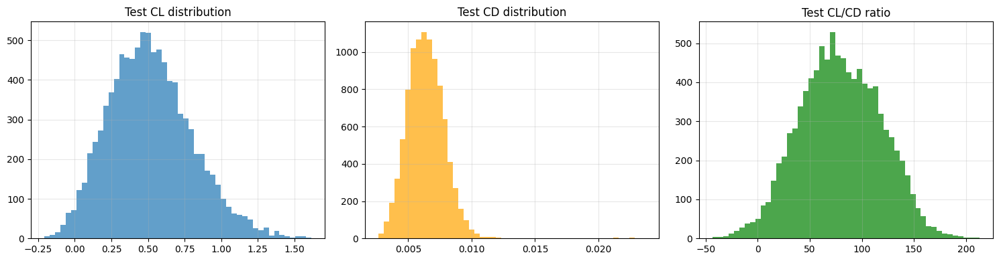


=== Coordinate summaries ===

--- Train coords summary ---
Points: 38802 airfoils × 192 pts each
 X → min -0.0132, max 1.0002, mean 0.4587, std 0.3040
 Y → min -0.1944, max 0.2234, mean 0.0219, std 0.0466

--- Test coords summary ---
Points: 9701 airfoils × 192 pts each
 X → min -0.0120, max 0.9946, mean 0.4657, std 0.3086
 Y → min -0.1025, max 0.2091, mean 0.0266, std 0.0485

=== Coordinate histograms ===


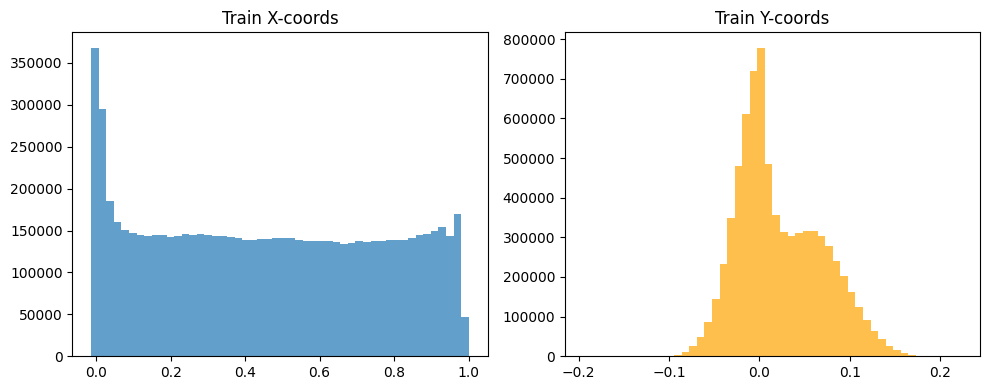

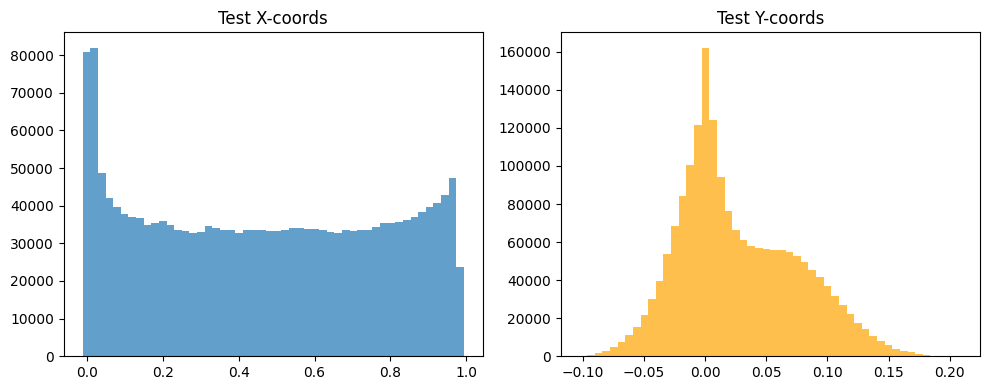


=== Single-airfoil preview ===


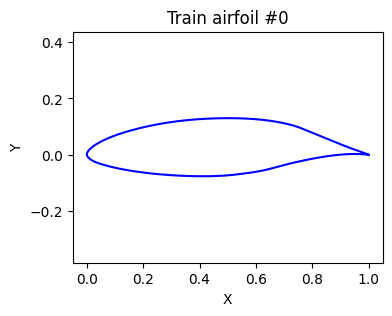

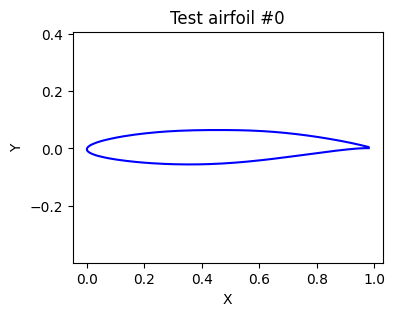


=== Pointwise patterns ===


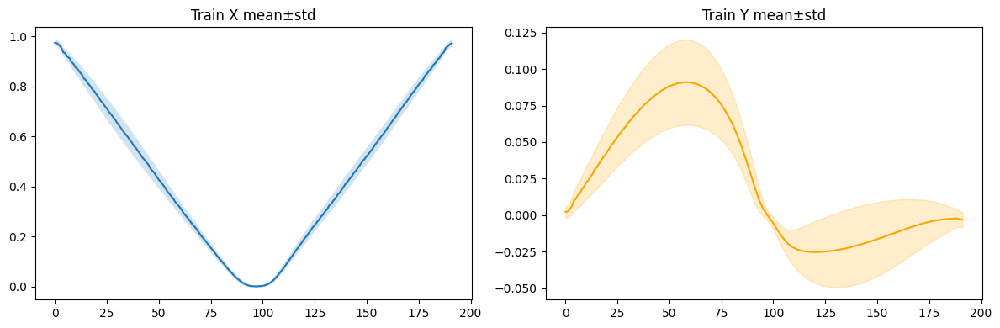

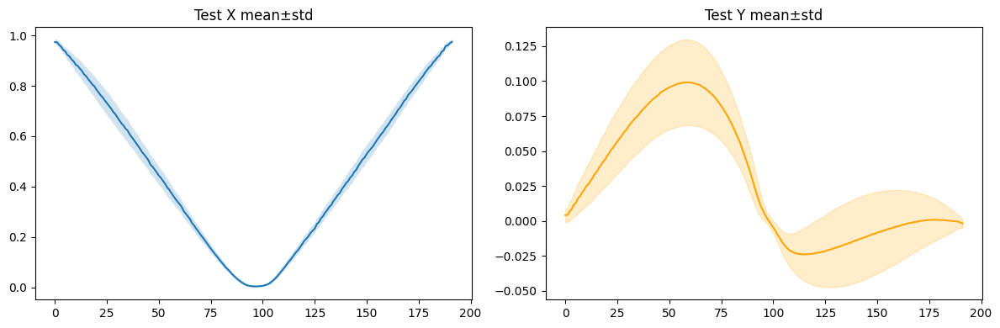

In [ ]:
### Stage-Info: explore ORIGINAL data only =================================
import numpy as np
import matplotlib.pyplot as plt

# 1) Label histograms: CL & CD, plus their ratio
def plot_label_distributions(ys, title_prefix="Train"):
    CL = ys[:, 0]
    CD = ys[:, 1]
    R  = CL / CD

    fig, axes = plt.subplots(1, 3, figsize=(15,4))
    axes[0].hist(CL, bins=50, alpha=0.7)
    axes[0].set_title(f"{title_prefix} CL distribution")
    axes[1].hist(CD, bins=50, alpha=0.7, color="orange")
    axes[1].set_title(f"{title_prefix} CD distribution")
    axes[2].hist(R, bins=50, alpha=0.7, color="green")
    axes[2].set_title(f"{title_prefix} CL/CD ratio")
    for ax in axes:
        ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

print("\n=== Label distributions ===")
plot_label_distributions(ys_train, "Train")
plot_label_distributions(ys_test,  "Test")

# 2) Numeric summaries of X & Y coords
def analyze_coords(xs, name="Data"):
    all_x = xs[...,0].ravel()
    all_y = xs[...,1].ravel()
    print(f"\n--- {name} coords summary ---")
    print(f"Points: {xs.shape[0]} airfoils × {xs.shape[1]} pts each")
    print(f" X → min {all_x.min():.4f}, max {all_x.max():.4f}, mean {all_x.mean():.4f}, std {all_x.std():.4f}")
    print(f" Y → min {all_y.min():.4f}, max {all_y.max():.4f}, mean {all_y.mean():.4f}, std {all_y.std():.4f}")

print("\n=== Coordinate summaries ===")
analyze_coords(xs_train, "Train")
analyze_coords(xs_test,  "Test")

# 3) Coordinate histograms
def plot_coord_histograms(xs, title_prefix="Train"):
    X = xs[...,0].ravel()
    Y = xs[...,1].ravel()
    fig, ax = plt.subplots(1,2, figsize=(10,4))
    ax[0].hist(X, bins=50, alpha=0.7)
    ax[0].set_title(f"{title_prefix} X-coords")
    ax[1].hist(Y, bins=50, alpha=0.7, color="orange")
    ax[1].set_title(f"{title_prefix} Y-coords")
    plt.tight_layout()
    plt.show()

print("\n=== Coordinate histograms ===")
plot_coord_histograms(xs_train, "Train")
plot_coord_histograms(xs_test,  "Test")

# 4) Single-airfoil preview
def plot_single_airfoil(coords, idx=0, title_prefix="Train"):
    x, y = coords[idx,:,0], coords[idx,:,1]
    plt.figure(figsize=(4,3))
    plt.plot(x, y, 'b-')
    plt.title(f"{title_prefix} airfoil #{idx}")
    plt.axis('equal')
    plt.xlabel("X"); plt.ylabel("Y")
    plt.show()

print("\n=== Single-airfoil preview ===")
plot_single_airfoil(xs_train, idx=0, title_prefix="Train")
plot_single_airfoil(xs_test,  idx=0, title_prefix="Test")

# 5) Pointwise mean±std signature
def plot_pointwise_signature(xs, name="Data"):
    mean_x = xs[...,0].mean(axis=0)
    std_x  = xs[...,0].std(axis=0)
    mean_y = xs[...,1].mean(axis=0)
    std_y  = xs[...,1].std(axis=0)

    fig, ax = plt.subplots(1,2, figsize=(12,4))
    ax[0].plot(mean_x)
    ax[0].fill_between(range(xs.shape[1]), mean_x-std_x, mean_x+std_x, alpha=0.2)
    ax[0].set_title(f"{name} X mean±std")

    ax[1].plot(mean_y, color="orange")
    ax[1].fill_between(range(xs.shape[1]), mean_y-std_y, mean_y+std_y, alpha=0.2, color="orange")
    ax[1].set_title(f"{name} Y mean±std")

    plt.tight_layout()
    plt.show()

print("\n=== Pointwise patterns ===")
plot_pointwise_signature(xs_train, "Train")
plot_pointwise_signature(xs_test,  "Test")


### transform, scale

In [10]:
### transform, scale

# ──────────────────────────────────────────────────────────────
#  Toggle here ─ if False you train on raw coordinates/labels.
# ──────────────────────────────────────────────────────────────
APPLY_SCALING = False          # True → min-max scale, False → raw
# ──────────────────────────────────────────────────────────────


# ========== coordinate scaling (Stage-1) ==========
if APPLY_SCALING:
    # compute per-axis min & max on TRAIN only
    x_min, x_max = xs_train[...,0].min(), xs_train[...,0].max()
    y_min, y_max = xs_train[...,1].min(), xs_train[...,1].max()

    xs_train_s = xs_train.copy()
    xs_test_s  = xs_test.copy()

    xs_train_s[...,0] = (xs_train[...,0] - x_min) / (x_max - x_min)
    xs_train_s[...,1] = (xs_train[...,1] - y_min) / (y_max - y_min)

    xs_test_s[...,0]  = (xs_test[...,0]  - x_min) / (x_max - x_min)
    xs_test_s[...,1]  = (xs_test[...,1]  - y_min) / (y_max - y_min)

    coord_mm = np.array([[x_min, y_min], [x_max, y_max]], dtype=np.float32)
else:
    # no scaling – just reuse raw data and write an “identity” scaler
    xs_train_s, xs_test_s = xs_train, xs_test
    coord_mm = np.array([[0., 0.], [1., 1.]], dtype=np.float32)   # inverse() becomes no-op

# save (the filenames never change)
np.save(DATA_DIR / "xs_train_scaled.npy", xs_train_s)
np.save(DATA_DIR / "xs_test_scaled.npy",  xs_test_s)
np.save(DATA_DIR / "coord_min_max.npy",   coord_mm)


# ========== label processing (Stage-2) ==========
if APPLY_SCALING:
    # compute per-axis min & max on TRAIN only
    cl_min, cl_max = ys_train[:,0].min(), ys_train[:,0].max()
    cd_min, cd_max = ys_train[:,1].min(), ys_train[:,1].max()

    ys_train_s = (ys_train - np.array([cl_min, cd_min])) / np.array([cl_max - cl_min, cd_max - cd_min])
    ys_test_s  = (ys_test  - np.array([cl_min, cd_min])) / np.array([cl_max - cl_min, cd_max - cd_min])

    label_mm = np.array([[cl_min, cd_min], [cl_max, cd_max]], dtype=np.float32)
else:
    # no scaling – keep raw CL & CD
    ys_train_s, ys_test_s = ys_train, ys_test
    label_mm = np.array([[0., 0.], [1., 1.]], dtype=np.float32)  # inverse() becomes no-op

np.save(DATA_DIR / "ys_train_scaled.npy", ys_train_s)
np.save(DATA_DIR / "ys_test_scaled.npy",  ys_test_s)
np.save(DATA_DIR / "label_min_max.npy",   label_mm)


# ========== quick sanity print ==========
print(f"APPLY_SCALING = {APPLY_SCALING}")

# coordinate ranges
print("xs_train_scaled X range :", xs_train_s[...,0].min(), xs_train_s[...,0].max())
print("xs_train_scaled Y range :", xs_train_s[...,1].min(), xs_train_s[...,1].max())

# label ranges (CL & CD separately)
print("ys_train_scaled CL range:", ys_train_s[:,0].min(), ys_train_s[:,0].max())
print("ys_train_scaled CD range:", ys_train_s[:,1].min(), ys_train_s[:,1].max())


APPLY_SCALING = False
xs_train_scaled X range : -0.013179942965507507 1.0002249852635365
xs_train_scaled Y range : -0.19444930618259842 0.22336526884723834
ys_train_scaled CL range: -0.2779 1.7515
ys_train_scaled CD range: 0.00232 0.02715



=== Label histograms: Train ===


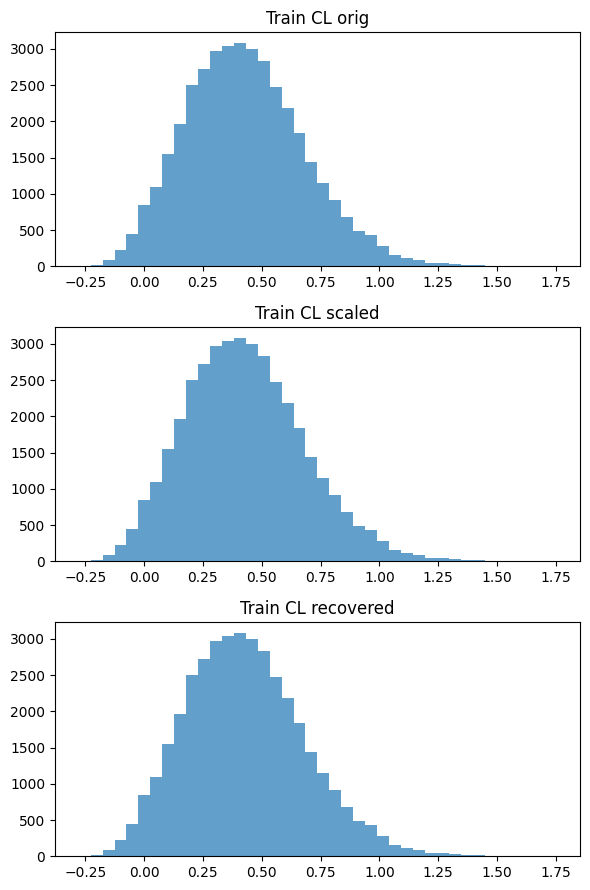

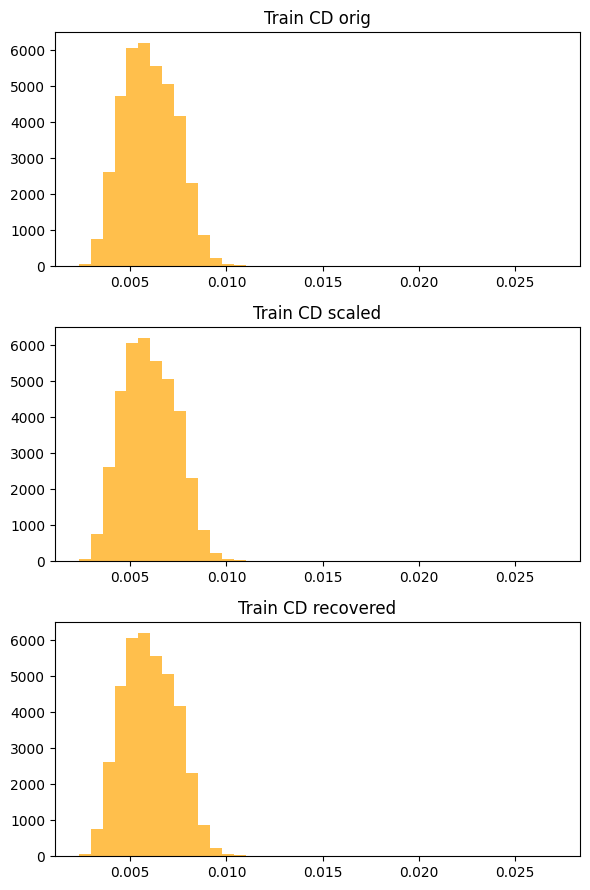


=== Coordinate signatures for sample #0 ===


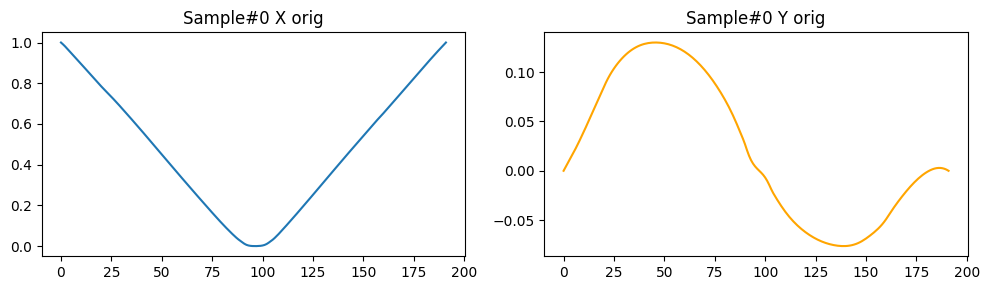

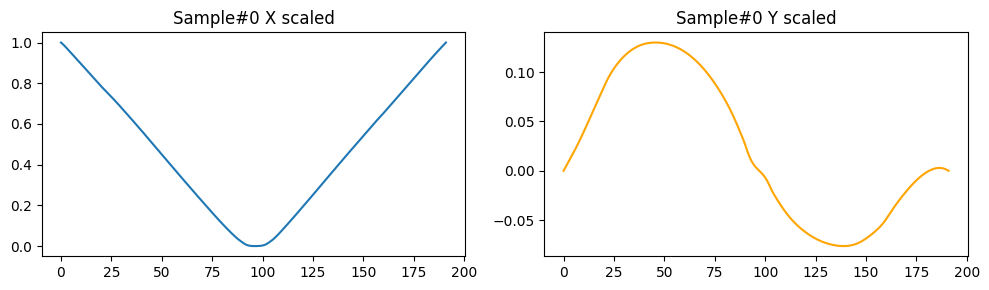

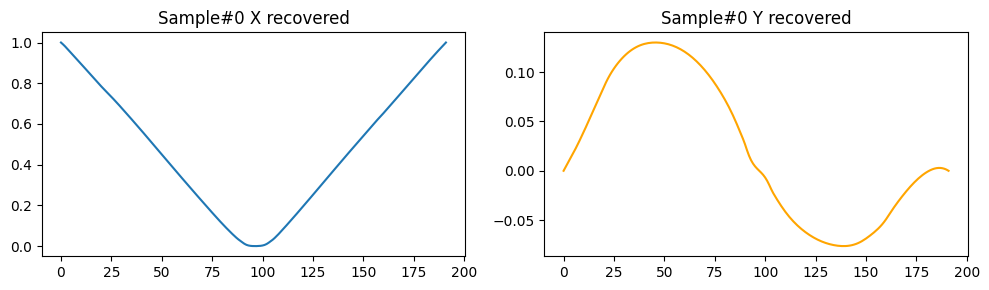

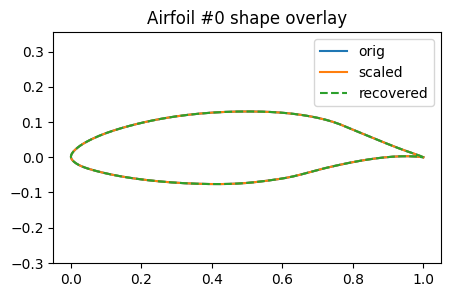

In [11]:
### Stage-2: label/coordinate inverse transforms & visual checks

import numpy as np
import matplotlib.pyplot as plt

# load saved min-max files
coord_mm = np.load(DATA_DIR / "coord_min_max.npy")   # [[x_min, y_min], [x_max, y_max]]
label_mm = np.load(DATA_DIR / "label_min_max.npy")   # [[cl_min, cd_min], [cl_max, cd_max]]

x_min,  y_min  = coord_mm[0]; x_max,  y_max  = coord_mm[1]
cl_min, cd_min = label_mm[0]; cl_max, cd_max = label_mm[1]

def unscale_coords(xs_s):
    """
    xs_s: shape (..., 2) or (N, 192, 2)
    returns coords in original physical units (or identity if no scaling)
    """
    xs = np.empty_like(xs_s)
    xs[...,0] = xs_s[...,0] * (x_max - x_min) + x_min
    xs[...,1] = xs_s[...,1] * (y_max - y_min) + y_min
    return xs

def unscale_labels(ys_s):
    """
    ys_s: shape (N, 2)
    returns labels (CL, CD) in original units (or identity if no scaling)
    """
    ys = np.empty_like(ys_s)
    ys[:,0] = ys_s[:,0] * (cl_max - cl_min) + cl_min
    ys[:,1] = ys_s[:,1] * (cd_max - cd_min) + cd_min
    return ys

# ——— Visual checks for LABELS —————————————————————————————
def compare_label_histos(orig, scaled, recovered, title):
    bins = 40
    # CL histograms
    fig, ax = plt.subplots(3, 1, figsize=(6, 9))
    ax[0].hist(orig[:,0], bins, alpha=0.7);    ax[0].set_title(f"{title} CL orig")
    ax[1].hist(scaled[:,0], bins, alpha=0.7);  ax[1].set_title(f"{title} CL scaled")
    ax[2].hist(recovered[:,0], bins, alpha=0.7);ax[2].set_title(f"{title} CL recovered")
    plt.tight_layout(); plt.show()

    # CD histograms
    fig, ax = plt.subplots(3, 1, figsize=(6, 9))
    ax[0].hist(orig[:,1], bins, alpha=0.7, color='orange');    ax[0].set_title(f"{title} CD orig")
    ax[1].hist(scaled[:,1], bins, alpha=0.7, color='orange');  ax[1].set_title(f"{title} CD scaled")
    ax[2].hist(recovered[:,1], bins, alpha=0.7, color='orange');ax[2].set_title(f"{title} CD recovered")
    plt.tight_layout(); plt.show()

# run comparison on train labels
ys_train_recov = unscale_labels(ys_train_s)
print("\n=== Label histograms: Train ===")
compare_label_histos(ys_train, ys_train_s, ys_train_recov, "Train")


# ——— Visual checks for COORDINATES —————————————————————————————
def compare_coord_signatures(orig, scaled, recovered, title):
    for xs, tag in [(orig, "orig"), (scaled, "scaled"), (recovered, "recovered")]:
        mean_x, std_x = xs[...,0].mean(0), xs[...,0].std(0)
        mean_y, std_y = xs[...,1].mean(0), xs[...,1].std(0)
        fig, ax = plt.subplots(1, 2, figsize=(10, 3))
        ax[0].plot(mean_x)
        ax[0].fill_between(range(xs.shape[1]), mean_x - std_x, mean_x + std_x, alpha=0.2)
        ax[0].set_title(f"{title} X {tag}")
        ax[1].plot(mean_y, color='orange')
        ax[1].fill_between(range(xs.shape[1]), mean_y - std_y, mean_y + std_y, alpha=0.2)
        ax[1].set_title(f"{title} Y {tag}")
        plt.tight_layout(); plt.show()

# pick one sample
i = 0
orig_xy   = xs_train[i:i+1]
scaled_xy = xs_train_s[i:i+1]
recov_xy  = unscale_coords(scaled_xy)

print("\n=== Coordinate signatures for sample #0 ===")
compare_coord_signatures(orig_xy, scaled_xy, recov_xy, "Sample#0")

# overlay raw shape
plt.figure(figsize=(5, 3))
plt.plot(orig_xy[0,:,0],  orig_xy[0,:,1],  label="orig")
plt.plot(scaled_xy[0,:,0], scaled_xy[0,:,1], label="scaled")
plt.plot(recov_xy[0,:,0],  recov_xy[0,:,1],  label="recovered", linestyle='--')
plt.legend(); plt.axis('equal'); plt.title("Airfoil #0 shape overlay")
plt.show()


### Dataset Class

coords batch: torch.Size([128, 2, 192])
labels batch: torch.Size([128, 2])


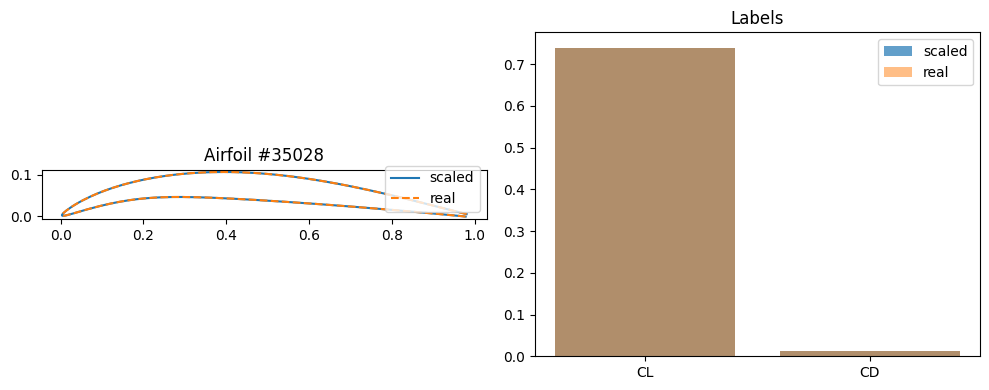

In [12]:
import os
from pathlib import Path

import numpy as np
import torch
from torch.utils.data import Dataset, DataLoader
import matplotlib.pyplot as plt

class AirfoilDataset(Dataset):
    """
    Loads scaled airfoil coordinates and scaled CL/CD labels,
    and can invert them back to physical units.
    """
    def __init__(self,
                 xs_scaled_path: str,
                 ys_scaled_path: str,
                 coord_min_max_path: str,
                 label_min_max_path: str):
        # load scaled arrays
        self.xs = np.load(xs_scaled_path)   # (N, 192, 2), values in [0,1]
        self.ys = np.load(ys_scaled_path)   # (N, 2), values in [0,1]

        # load min/max for coords & labels
        coord_mm = np.load(coord_min_max_path)  # [[x_min,y_min],[x_max,y_max]]
        label_mm = np.load(label_min_max_path)  # [[cl_min,cd_min],[cl_max,cd_max]]

        self.x_min,  self.y_min  = coord_mm[0]
        self.x_max,  self.y_max  = coord_mm[1]
        self.cl_min, self.cd_min = label_mm[0]
        self.cl_max, self.cd_max = label_mm[1]

    def __len__(self):
        return len(self.xs)

    def __getitem__(self, idx: int):
        # scaled coords: (192,2) -> transpose to (2,192)
        coords = self.xs[idx].T.astype(np.float32)
        cl, cd = self.ys[idx].astype(np.float32)
        return torch.from_numpy(coords), torch.tensor([cl, cd], dtype=torch.float32)

    def inverse_scale_coords(self, coords_scaled: np.ndarray) -> np.ndarray:
        """
        coords_scaled: np array shape (..., 2)
        returns coords in original physical units
        """
        x_s, y_s = coords_scaled[...,0], coords_scaled[...,1]
        x = x_s * (self.x_max - self.x_min) + self.x_min
        y = y_s * (self.y_max - self.y_min) + self.y_min
        return np.stack([x, y], axis=-1)

    def inverse_scale_labels(self, ys_scaled: np.ndarray) -> np.ndarray:
        """
        ys_scaled: shape (N,2)
        returns labels in original (CL, CD) units
        """
        cl_s, cd_s = ys_scaled[:,0], ys_scaled[:,1]
        cl = cl_s * (self.cl_max - self.cl_min) + self.cl_min
        cd = cd_s * (self.cd_max - self.cd_min) + self.cd_min
        return np.stack([cl, cd], axis=-1)

    def plot_sample(self, idx: int = None):
        """
        Shows scaled vs real airfoil and label for one index.
        """
        if idx is None:
            idx = np.random.randint(len(self))
        coords_s, lbl_s = self[idx]
        # back to numpy
        coords_s = coords_s.numpy().T        # (192,2)
        lbl_s    = lbl_s.numpy()[None,:]     # (1,2)
        coords_r = self.inverse_scale_coords(coords_s[None])[0]
        lbl_r    = self.inverse_scale_labels(lbl_s)[0]

        # plot curves
        fig, ax = plt.subplots(1,2, figsize=(10,4))
        ax[0].plot(coords_s[:,0], coords_s[:,1], label="scaled")
        ax[0].plot(coords_r[:,0], coords_r[:,1], linestyle='--', label="real")
        ax[0].set_aspect('equal')
        ax[0].set_title(f"Airfoil #{idx}")
        ax[0].legend()

        # plot labels
        cl_s_val, cd_s_val = lbl_s[0]
        cl_r_val, cd_r_val = lbl_r
        ax[1].bar(["CL","CD"], [cl_s_val, cd_s_val], alpha=0.7, label="scaled")
        ax[1].bar(["CL","CD"], [cl_r_val, cd_r_val], alpha=0.5, label="real")
        ax[1].set_title("Labels")
        ax[1].legend()

        plt.tight_layout()
        plt.show()


# ----------------- USAGE EXAMPLE -----------------
data_dir = "/content/data"
ds = AirfoilDataset(
    xs_scaled_path      = os.path.join(data_dir, "xs_train_scaled.npy"),
    ys_scaled_path      = os.path.join(data_dir, "ys_train_scaled.npy"),
    coord_min_max_path  = os.path.join(data_dir, "coord_min_max.npy"),
    label_min_max_path  = os.path.join(data_dir, "label_min_max.npy")
)
loader = DataLoader(ds, batch_size=128, shuffle=True)

# check shapes
coords_batch, labels_batch = next(iter(loader))
print("coords batch:", coords_batch.shape)  # (16,2,192)
print("labels batch:", labels_batch.shape)  # (16,2)

# visualize a random sample
ds.plot_sample()


## Surrogate Model

### Residual

In [ ]:
import os
import time
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader

In [ ]:
class ResidualBlock1D(nn.Module):
    """
    A 1D residual block with optional downsampling.
    The first conv can do stride=2 if downsample=True, the second conv uses stride=1.
    We'll use kernel=5, pad=2 so that stride=1 doesn't reduce length at all.
    """
    def __init__(self, in_channels, out_channels, downsample=False):
        super().__init__()
        self.downsample = downsample

        # If we want to downsample, we set stride=2 for the first conv and the shortcut
        stride_first = 2 if downsample else 1
        kernel_size = 5
        pad = 2

        # 1) First conv
        self.bn1 = nn.BatchNorm1d(in_channels, momentum=0.9)
        self.conv1 = nn.Conv1d(in_channels, out_channels,
                               kernel_size=kernel_size,
                               stride=stride_first,
                               padding=pad)
        # 2) Second conv always stride=1
        self.bn2 = nn.BatchNorm1d(out_channels, momentum=0.9)
        self.conv2 = nn.Conv1d(out_channels, out_channels,
                               kernel_size=kernel_size,
                               stride=1,
                               padding=pad)

        # Shortcut (for downsample or channel mismatch)
        if downsample or (in_channels != out_channels):
            self.shortcut_conv = nn.Conv1d(in_channels, out_channels,
                                           kernel_size=1,
                                           stride=stride_first,
                                           padding=0)
        else:
            self.shortcut_conv = nn.Identity()

        self.lrelu = nn.LeakyReLU(0.2, inplace=True)

    def forward(self, x, debug=False):
        if debug:
            print(f"  [ResidualBlock] Input shape: {x.shape}")
        identity = self.shortcut_conv(x)     # Possibly stride=2 if downsample is True

        # First conv
        out = self.bn1(x)
        out = self.lrelu(out)
        out = self.conv1(out)
        if debug:
            print(f"    After conv1 shape: {out.shape}")

        # Second conv
        out = self.bn2(out)
        out = self.lrelu(out)
        out = self.conv2(out)
        if debug:
            print(f"    After conv2 shape: {out.shape}")

        # Add skip
        out = out + identity
        if debug:
            print(f"  [ResidualBlock] Output shape: {out.shape}\n")

        return out




class SurrogateModel1D(nn.Module):
    """
    A 1D ResNet-like approach for (batch, 2, n_points).
    We'll do four "groups" of blocks, each of which can downsample the length dimension in the first block.
    """
    def __init__(self, n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2]):
        super().__init__()
        self.depth = depth
        self.residual_list = residual_list

        # -- Initial Conv: kernel=5, pad=2, stride=1 => length stays 192
        self.conv_initial = nn.Conv1d(in_channels, depth, kernel_size=5, stride=1, padding=2)
        self.bn_initial = nn.BatchNorm1d(depth, momentum=0.9)
        self.lrelu = nn.LeakyReLU(0.2, inplace=True)

        # Group0: no downsample in first block
        self.blocks0 = nn.ModuleList([
            ResidualBlock1D(depth, depth, downsample=False)
            for _ in range(residual_list[0])
        ])
        # Group1: first block downsample => depth-> depth*2
        self.resblock1_0 = ResidualBlock1D(depth, depth*2, downsample=True)
        self.blocks1 = nn.ModuleList([
            ResidualBlock1D(depth*2, depth*2, downsample=False)
            for _ in range(residual_list[1]-1)
        ])
        # Group2
        self.resblock2_0 = ResidualBlock1D(depth*2, depth*4, downsample=True)
        self.blocks2 = nn.ModuleList([
            ResidualBlock1D(depth*4, depth*4, downsample=False)
            for _ in range(residual_list[2]-1)
        ])
        # Group3
        self.resblock3_0 = ResidualBlock1D(depth*4, depth*8, downsample=True)
        self.blocks3 = nn.ModuleList([
            ResidualBlock1D(depth*8, depth*8, downsample=False)
            for _ in range(residual_list[3]-1)
        ])

        # Final BN + global avg pool + FC(128) + BN + LReLU + FC(2) + Sigmoid
        self.bn_final = nn.BatchNorm1d(depth*8, momentum=0.9)
        self.fc1 = nn.Linear(depth*8, 128)
        self.bn_fc1 = nn.BatchNorm1d(128, momentum=0.9)
        self.fc2 = nn.Linear(128, 2)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x, debug=False):
        if debug:
            print(f"Input shape: {x.shape}")
        out = self.conv_initial(x)
        out = self.bn_initial(out)
        out = self.lrelu(out)
        if debug:
            print(f"After initial conv shape: {out.shape}")

        # group0
        for block in self.blocks0:
            out = block(out, debug=debug)
        if debug:
            print(f"After group0 shape: {out.shape}")

        # group1
        out = self.resblock1_0(out, debug=debug)
        for block in self.blocks1:
            out = block(out, debug=debug)
        if debug:
            print(f"After group1 shape: {out.shape}")

        # group2
        out = self.resblock2_0(out, debug=debug)
        for block in self.blocks2:
            out = block(out, debug=debug)
        if debug:
            print(f"After group2 shape: {out.shape}")

        # group3
        out = self.resblock3_0(out, debug=debug)
        for block in self.blocks3:
            out = block(out, debug=debug)
        if debug:
            print(f"After group3 shape: {out.shape}")

        out = self.bn_final(out)
        out = self.lrelu(out)
        if debug:
            print(f"After bn_final + lrelu shape: {out.shape}")

        # global avg pool => (batch, depth*8, 1)
        out = F.adaptive_avg_pool1d(out, 1)
        if debug:
            print(f"After global avg pool shape: {out.shape}")
        out = out.view(out.size(0), -1)  # => (batch, depth*8)

        out = self.fc1(out)
        out = self.bn_fc1(out)
        out = self.lrelu(out)
        if debug:
            print(f"After fc1 shape: {out.shape}")

        out = self.fc2(out)
        out = self.sigmoid(out)
        if debug:
            print(f"Output shape: {out.shape}")

        return out


In [ ]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

def print_model_info(model, input_shape=(2, 2, 192)):
    print("Model Architecture:")
    print(model)
    total_params = count_parameters(model)
    print(f"Total trainable parameters: {total_params:,}\n")

    dummy_input = torch.randn(*input_shape)
    print("Running dummy forward pass with debug=True (training mode):")
    _ = model(dummy_input, debug=True)
    print("Dummy forward pass complete.\n")

# -----------------------------
# Training Loop with History, Checkpoint Saving, Best Model, and Early Stopping
# -----------------------------
def train_surrogate_model(
    model,
    train_loader,
    test_loader,
    num_epochs=100,
    lr=0.0005,
    device='cuda',
    debug=False,
    checkpoint_dir="/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0",
    patience=50  # Early stopping patience: stop if no improvement for 'patience' epochs.
):
    os.makedirs(checkpoint_dir, exist_ok=True)
    model = model.to(device)
    criterion = nn.L1Loss()
    optimizer = optim.Adam(model.parameters(), lr=lr, betas=(0.5, 0.999))

    train_losses = []
    test_losses = []
    best_loss = float('inf')
    best_epoch = 0
    epochs_without_improvement = 0
    start_time = time.time()

    for epoch in range(1, num_epochs+1):
        model.train()
        running_loss = 0.0
        for batch_idx, batch in enumerate(train_loader):
            coords = batch[0].to(device)   # shape: (batch, 2, n_points)
            labels = batch[1].to(device)   # shape: (batch, 2)

            if batch_idx == 0 and debug:
                print(f"\n--- Epoch {epoch}, Batch {batch_idx} ---")
                print("Input coords shape:", coords.shape)
                print("Labels shape:", labels.shape)

            optimizer.zero_grad()
            outputs = model(coords, debug=(batch_idx == 0 and debug))
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item() * coords.size(0)

        epoch_loss = running_loss / len(train_loader.dataset)
        train_losses.append(epoch_loss)

        # Evaluate on test set
        model.eval()
        test_loss = 0.0
        with torch.no_grad():
            for batch in test_loader:
                coords = batch[0].to(device)
                labels = batch[1].to(device)
                preds = model(coords)
                test_loss += criterion(preds, labels).item() * coords.size(0)
        test_loss /= len(test_loader.dataset)
        test_losses.append(test_loss)

        print(f"Epoch [{epoch}/{num_epochs}] - Train Loss: {epoch_loss:.6f}, Test Loss: {test_loss:.6f}")

        # Save a checkpoint for this epoch
        epoch_checkpoint = os.path.join(checkpoint_dir, f"model_epoch_{epoch}.pt")
        torch.save(model.state_dict(), epoch_checkpoint)
        print(f"Checkpoint saved at: {epoch_checkpoint}")

        # Best model saving and early stopping check
        if test_loss < best_loss:
            best_loss = test_loss
            best_epoch = epoch
            epochs_without_improvement = 0
            best_model_path = os.path.join(checkpoint_dir, "best_model.pt")
            torch.save(model.state_dict(), best_model_path)
            print(f"New best model saved at epoch {epoch} with test loss {test_loss:.6f}")
        else:
            epochs_without_improvement += 1

        if epochs_without_improvement >= patience:
            print(f"No improvement for {patience} epochs. Early stopping at epoch {epoch}.")
            break

    elapsed = time.time() - start_time
    print(f"\nTraining completed in {elapsed:.2f} seconds. Best epoch: {best_epoch} with test loss: {best_loss:.6f}")

    # Plot loss history
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, len(train_losses)+1), train_losses, label="Train Loss")
    plt.plot(range(1, len(test_losses)+1), test_losses, label="Test Loss")
    plt.xlabel("Epoch")
    plt.ylabel("L1 Loss (MAE)")
    plt.title("Training and Test Loss History")
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.show()

    # Save loss history to disk
    np.save(os.path.join(checkpoint_dir, "train_losses.npy"), np.array(train_losses))
    np.save(os.path.join(checkpoint_dir, "test_losses.npy"), np.array(test_losses))


In [ ]:
from torch.utils.data import DataLoader
train_dataset = AirfoilDataset(xs_train_path, ys_train_scaled_path, y_min_path, y_max_path)
test_dataset = AirfoilDataset(xs_train_path, ys_train_scaled_path, y_min_path, y_max_path)  # Use your test set accordingly

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader  = DataLoader(test_dataset, batch_size=64, shuffle=False)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
model = SurrogateModel1D(n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2])

# Print model information before training
print_model_info(model, input_shape=(2, 2, 192))


Model Architecture:
SurrogateModel1D(
  (conv_initial): Conv1d(2, 16, kernel_size=(5,), stride=(1,), padding=(2,))
  (bn_initial): BatchNorm1d(16, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
  (lrelu): LeakyReLU(negative_slope=0.2, inplace=True)
  (blocks0): ModuleList(
    (0-1): 2 x ResidualBlock1D(
      (bn1): BatchNorm1d(16, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
      (conv1): Conv1d(16, 16, kernel_size=(5,), stride=(1,), padding=(2,))
      (bn2): BatchNorm1d(16, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
      (conv2): Conv1d(16, 16, kernel_size=(5,), stride=(1,), padding=(2,))
      (shortcut_conv): Identity()
      (lrelu): LeakyReLU(negative_slope=0.2, inplace=True)
    )
  )
  (resblock1_0): ResidualBlock1D(
    (bn1): BatchNorm1d(16, eps=1e-05, momentum=0.9, affine=True, track_running_stats=True)
    (conv1): Conv1d(16, 32, kernel_size=(5,), stride=(2,), padding=(2,))
    (bn2): BatchNorm1d(32, eps=1e-05, mo

In [ ]:
######

In [ ]:
#### Alert! ###

In [ ]:
#####

<ipython-input-18-f0d83738265d>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/50] - Train Loss: 0.029231, Test Loss: 0.018536
Checkpoint saved at: /content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0/model_epoch_1.pt
New best model saved at epoch 1 with test loss 0.018536
Epoch [2/50] - Train Loss: 0.023743, Test Loss: 0.028979
Checkpoint saved at: /content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0/model_epoch_2.pt
Epoch [3/50] - Train Loss: 0.022830, Test Loss: 0.031754
Checkpoint saved at: /content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0/model_epoch_3.pt
Epoch [4/50] - Train Loss: 0.021550, Test Loss: 0.017462
Checkpoint saved at: /content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0/model_epoch_4.pt
New best model saved at epoch 4 with test loss 0.017462
Epoch [5/50] - Train Loss: 0.020948, Test Loss: 0.012762
Checkpoint saved at: /content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0/model_epoch_5.pt
New best model saved at epoch 5 with test loss 0.012762
Epoch [

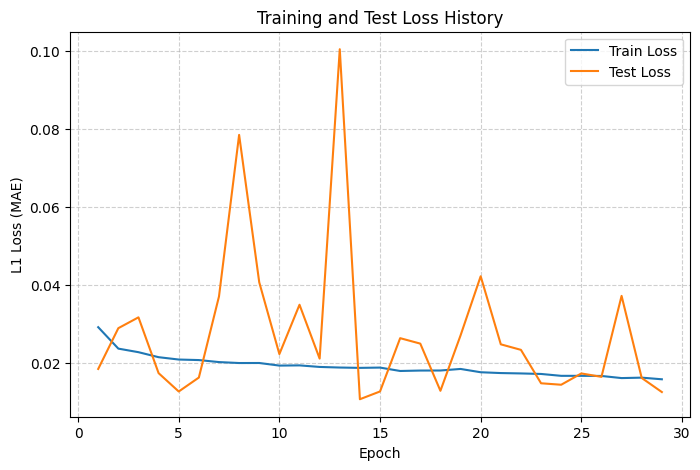

In [ ]:
train_surrogate_model(
    model,
    train_loader,
    test_loader,
    num_epochs=50,
    lr=0.001,
    device=device,
    debug=False,
    checkpoint_dir="/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residulV0",
    patience=15
)

the best final surrogate model training was done in this kaggle notebook:

[link](https://www.kaggle.com/code/mahanveisi/generative-airfoil-surrogate-model2/edit),  if you do not have access, ask Mahan to add you

#### residualV0 results

In [ ]:
def visualize_predictions_grid(model, dataset, device, sample_indices=None, set_name="Train", figsize=(20,8)):
    """
    Visualizes a grid of predictions for a set of airfoil samples.

    For each selected sample, the function plots the airfoil shape twice:
      - Top row: Annotated with the true and predicted CL values (both scaled and inverse-scaled).
      - Bottom row: Annotated with the true and predicted CL/CD ratio values (both scaled and inverse-scaled).

    Args:
      model: The trained PyTorch model.
      dataset: An instance of your AirfoilDataset.
      device: 'cuda' or 'cpu'.
      sample_indices: List or array of sample indices to visualize. If None, 5 random indices are chosen.
      set_name: String label for the dataset (e.g. "Train" or "Test").
      figsize: Tuple for figure size.
    """
    model.eval()
    if sample_indices is None:
        num_samples = 5
        sample_indices = np.random.choice(len(dataset), size=num_samples, replace=False)
    else:
        num_samples = len(sample_indices)

    # Create a grid with 2 rows and num_samples columns
    fig, axs = plt.subplots(2, num_samples, figsize=figsize)

    for j, idx in enumerate(sample_indices):
        # Get a sample from the dataset: coords (tensor of shape (2, n_points)) and scaled label (tensor of shape (2,))
        coords, label = dataset[idx]
        # Ensure coords and label are on CPU and in NumPy format
        coords_np = coords.cpu().numpy()  # shape: (2, n_points)

        # Run a forward pass on the sample
        coords_batch = coords.unsqueeze(0).to(device)  # add batch dimension: (1, 2, n_points)
        with torch.no_grad():
            pred = model(coords_batch)
        pred = pred.squeeze(0).cpu()  # shape: (2,)

        # Inverse scale both prediction and true label
        true_unscaled = dataset.inverse_scale_label(label.numpy()).flatten()  # shape: (2,)
        pred_unscaled = dataset.inverse_scale_label(pred.numpy()).flatten()   # shape: (2,)

        # Extract values:
        # For CL: element 0; for ratio: element 1.
        true_CL_scaled = label[0].item()
        pred_CL_scaled = pred[0].item()
        true_ratio_scaled = label[1].item()
        pred_ratio_scaled = pred[1].item()

        true_CL_real = true_unscaled[0]
        pred_CL_real = pred_unscaled[0]
        true_ratio_real = true_unscaled[1]
        pred_ratio_real = pred_unscaled[1]

        # --- Top row: CL information ---
        axs[0, j].plot(coords_np[0], coords_np[1], 'b-', linewidth=2)
        axs[0, j].set_title(
            f"Sample {idx}\n"
            f"CL (scaled): True {true_CL_scaled:.3f}, Pred {pred_CL_scaled:.3f}\n"
            f"CL (real): True {true_CL_real:.3f}, Pred {pred_CL_real:.3f}"
        )
        axs[0, j].set_xlabel("X")
        axs[0, j].set_ylabel("Y")
        axs[0, j].set_aspect('equal', adjustable='box')
        axs[0, j].grid(True, linestyle="--", alpha=0.6)

        # --- Bottom row: CL/CD ratio information ---
        axs[1, j].plot(coords_np[0], coords_np[1], 'b-', linewidth=2)
        axs[1, j].set_title(
            f"Sample {idx}\n"
            f"Ratio (scaled): True {true_ratio_scaled:.3f}, Pred {pred_ratio_scaled:.3f}\n"
            f"Ratio (real): True {true_ratio_real:.3f}, Pred {pred_ratio_real:.3f}"
        )
        axs[1, j].set_xlabel("X")
        axs[1, j].set_ylabel("Y")
        axs[1, j].set_aspect('equal', adjustable='box')
        axs[1, j].grid(True, linestyle="--", alpha=0.6)

    plt.suptitle(f"{set_name} Set Predictions", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()



In [ ]:
###

Visualizing predictions on TRAIN set samples:


<ipython-input-18-f0d83738265d>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


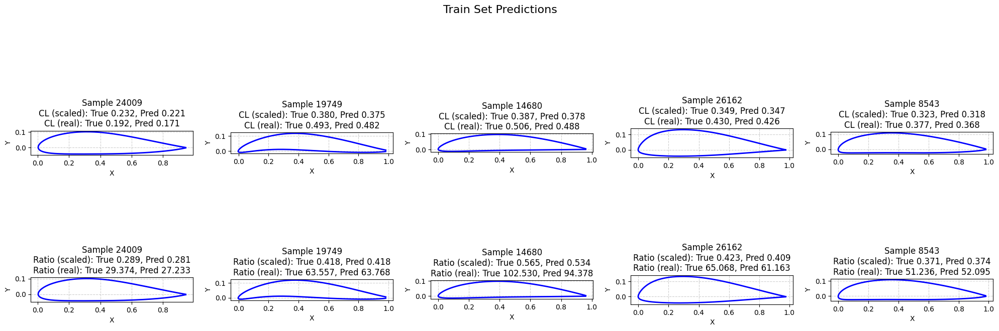

Visualizing predictions on TEST set samples:


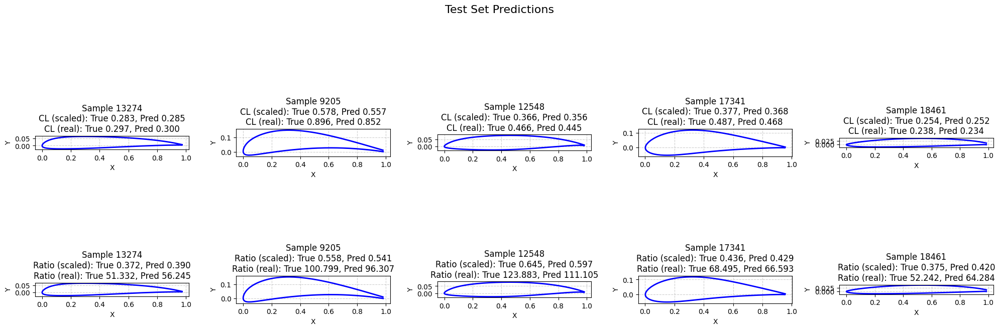

In [ ]:
print("Visualizing predictions on TRAIN set samples:")
visualize_predictions_grid(model, train_dataset, device, set_name="Train")

print("Visualizing predictions on TEST set samples:")
visualize_predictions_grid(model, test_dataset, device, set_name="Test")


In [ ]:
def plot_small_subset_predictions(model, dataset, device, sample_count=100, set_name="Train"):
    """
    Plots a smaller subset of samples (default=100) to compare predicted vs. true labels (CL and CL/CD).
    We do a line plot with 2 subplots:
      - Top subplot: CL (real) vs. predicted
      - Bottom subplot: Ratio (real) vs. predicted

    Args:
      model: Trained PyTorch model
      dataset: Instance of your AirfoilDataset
      device: 'cuda' or 'cpu'
      sample_count: Number of samples to plot
      set_name: String for labeling (e.g., "Train" or "Test")
    """
    model.eval()

    # Pick a random subset of sample_count indices from the dataset
    indices = np.random.choice(len(dataset), size=sample_count, replace=False)
    indices = sorted(indices)  # Sort so that the lines look smoother in the plot

    # We'll store real CL/CD and predicted CL/CD in arrays for plotting
    real_CL_vals = []
    real_ratio_vals = []
    pred_CL_vals = []
    pred_ratio_vals = []

    # No batch dimension here, we'll just do them one by one (100 is small enough)
    with torch.no_grad():
        for idx in indices:
            coords, scaled_label = dataset[idx]

            # coords shape: (2, n_points)
            # scaled_label shape: (2,) => [CL_scaled, ratio_scaled]
            # Move coords to device
            coords_batch = coords.unsqueeze(0).to(device)  # shape: (1, 2, n_points)

            # Model prediction
            pred_scaled = model(coords_batch)  # shape: (1, 2)
            pred_scaled = pred_scaled.squeeze(0).cpu().numpy()  # shape: (2,)

            # Inverse-scale both the ground-truth and the prediction
            true_unscaled = dataset.inverse_scale_label(scaled_label.numpy()).flatten()  # shape: (2,)
            pred_unscaled = dataset.inverse_scale_label(pred_scaled).flatten()           # shape: (2,)

            # Extract CL and ratio
            real_CL_vals.append(true_unscaled[0])
            real_ratio_vals.append(true_unscaled[1])
            pred_CL_vals.append(pred_unscaled[0])
            pred_ratio_vals.append(pred_unscaled[1])

    # Now we have arrays of length = sample_count for real/pred CL and ratio
    x_axis = range(sample_count)  # Just 0..(sample_count-1)

    plt.figure(figsize=(12, 8))

    # --- Top subplot: CL ---
    plt.subplot(2, 1, 1)
    plt.plot(x_axis, real_CL_vals, 'o-', label="True CL", color='blue', alpha=0.7)
    plt.plot(x_axis, pred_CL_vals, 's--', label="Predicted CL", color='red', alpha=0.7)
    plt.title(f"{set_name} Set: CL on {sample_count} Samples")
    plt.xlabel("Sample Index (subset)")
    plt.ylabel("CL (real scale)")
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.legend()

    # --- Bottom subplot: CL/CD ratio ---
    plt.subplot(2, 1, 2)
    plt.plot(x_axis, real_ratio_vals, 'o-', label="True Ratio", color='blue', alpha=0.7)
    plt.plot(x_axis, pred_ratio_vals, 's--', label="Predicted Ratio", color='red', alpha=0.7)
    plt.title(f"{set_name} Set: CL/CD Ratio on {sample_count} Samples")
    plt.xlabel("Sample Index (subset)")
    plt.ylabel("CL/CD Ratio (real scale)")
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.legend()

    plt.tight_layout()
    plt.show()

In [ ]:
####

Plotting a smaller subset (100 samples) for the TRAIN set:


<ipython-input-18-f0d83738265d>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


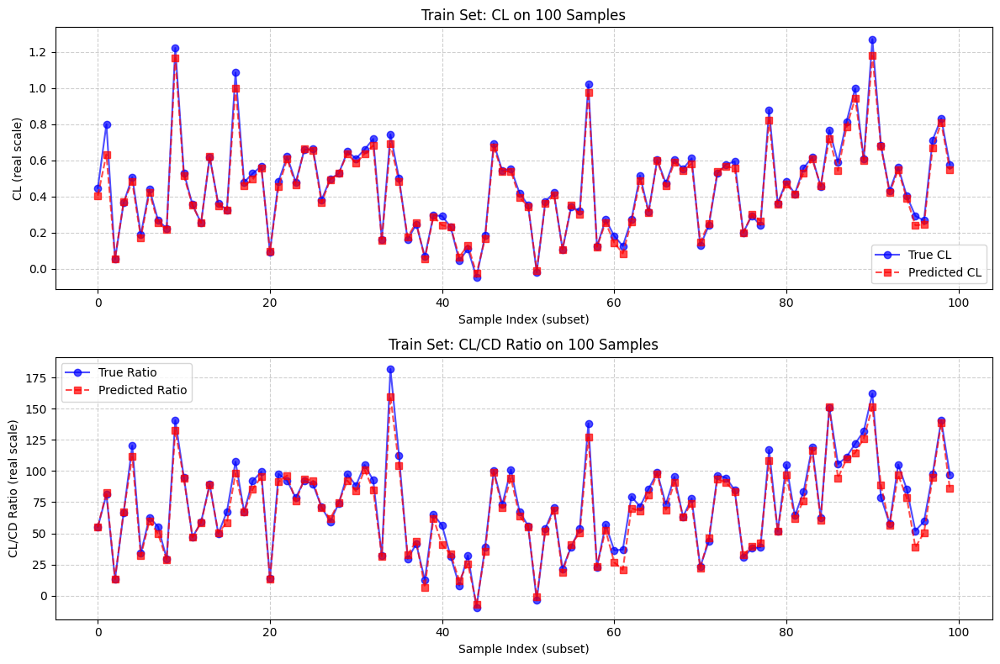

Plotting a smaller subset (100 samples) for the TEST set:


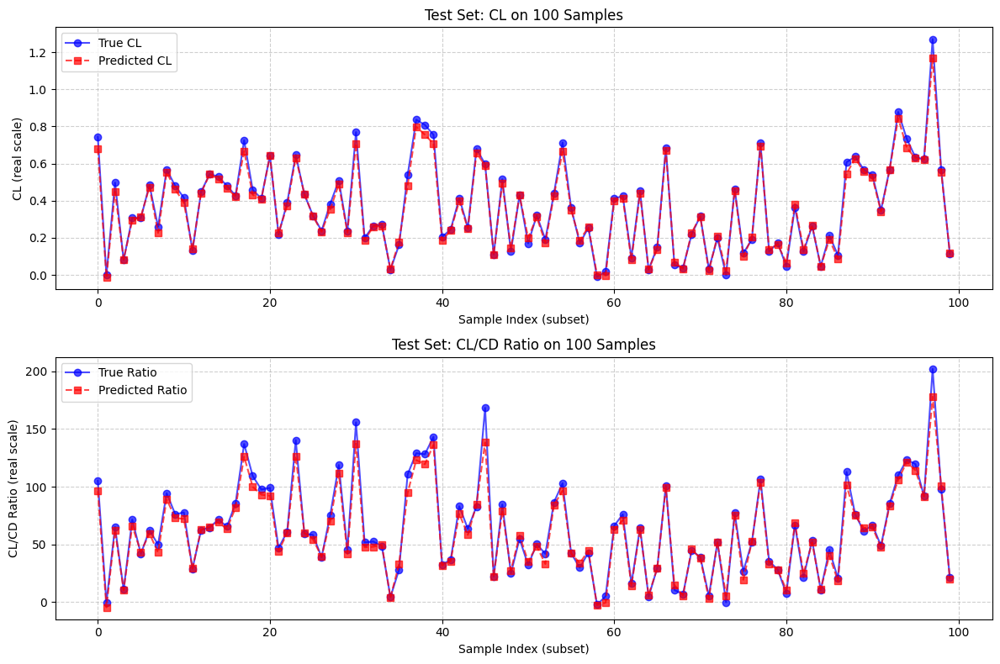

In [ ]:
print("Plotting a smaller subset (100 samples) for the TRAIN set:")
plot_small_subset_predictions(model, train_dataset, device, sample_count=100, set_name="Train")

print("Plotting a smaller subset (100 samples) for the TEST set:")
plot_small_subset_predictions(model, test_dataset, device, sample_count=100, set_name="Test")


#### residualV1 results

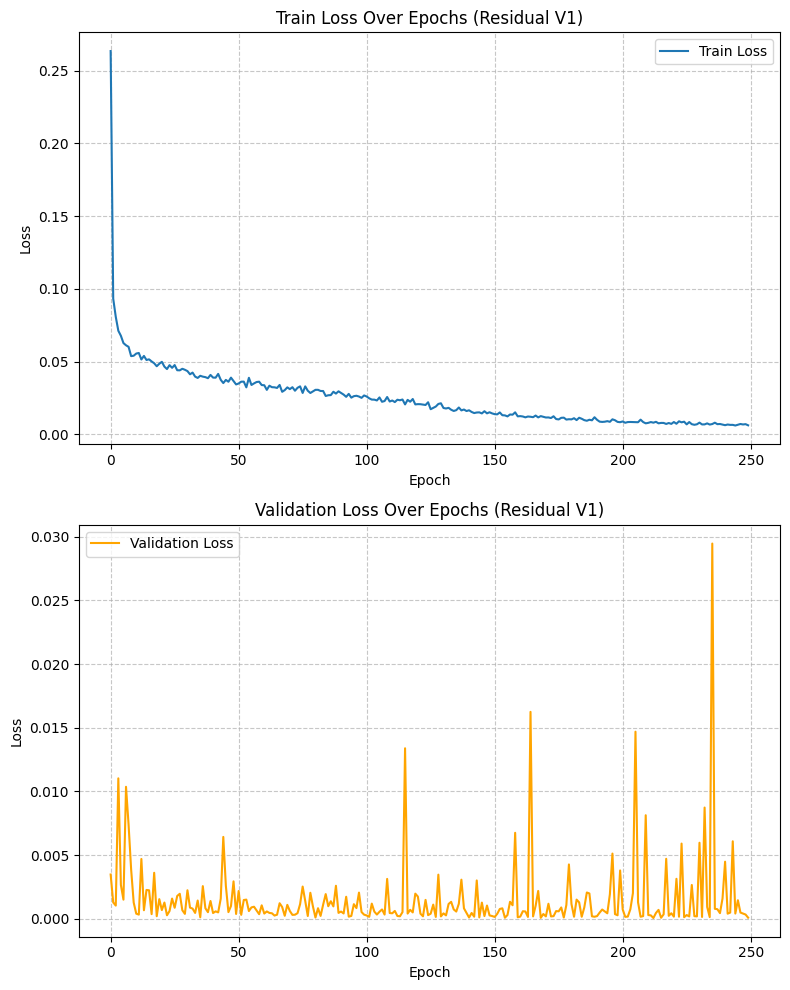

In [ ]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt

# Make sure you have your SurrogateModel1D class loaded or defined
# Make sure you have your AirfoilDataset, train_dataset, and test_dataset loaded

# 1) Define paths and load losses
checkpoint_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residualV1"
train_losses_path = os.path.join(checkpoint_dir, "train_losses.npy")
test_losses_path  = os.path.join(checkpoint_dir, "test_losses.npy")

train_losses = np.load(train_losses_path)
test_losses  = np.load(test_losses_path)

# 2) Plot train vs. test losses in a two-subplot figure
fig, axes = plt.subplots(2, 1, figsize=(8, 10))

axes[0].plot(train_losses, label="Train Loss")
axes[0].set_title("Train Loss Over Epochs (Residual V1)")
axes[0].set_xlabel("Epoch")
axes[0].set_ylabel("Loss")
axes[0].grid(True, linestyle="--", alpha=0.7)
axes[0].legend()

axes[1].plot(test_losses, label="Validation Loss", color="orange")
axes[1].set_title("Validation Loss Over Epochs (Residual V1)")
axes[1].set_xlabel("Epoch")
axes[1].set_ylabel("Loss")
axes[1].grid(True, linestyle="--", alpha=0.7)
axes[1].legend()

plt.tight_layout()
plt.show()

=== Visualizing best_model predictions on the TRAIN set ===


<ipython-input-11-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


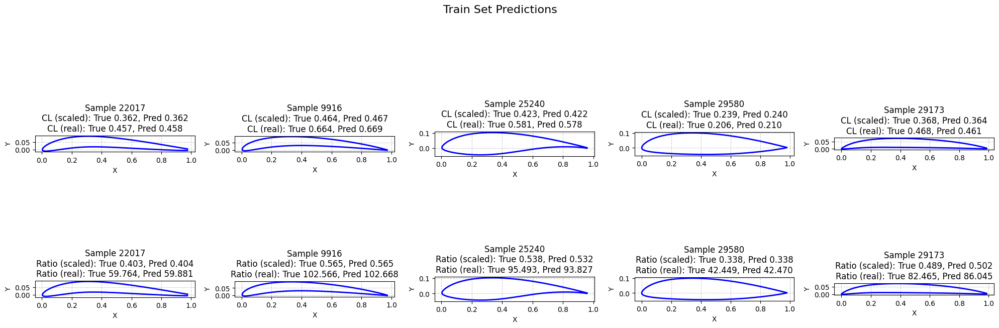

=== Visualizing best_model predictions on the TEST set ===


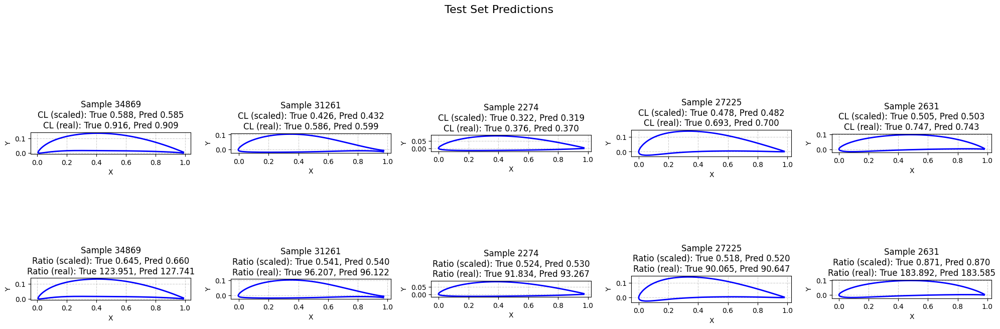

=== Plotting a smaller subset (100 samples) for the TRAIN set (best_model) ===


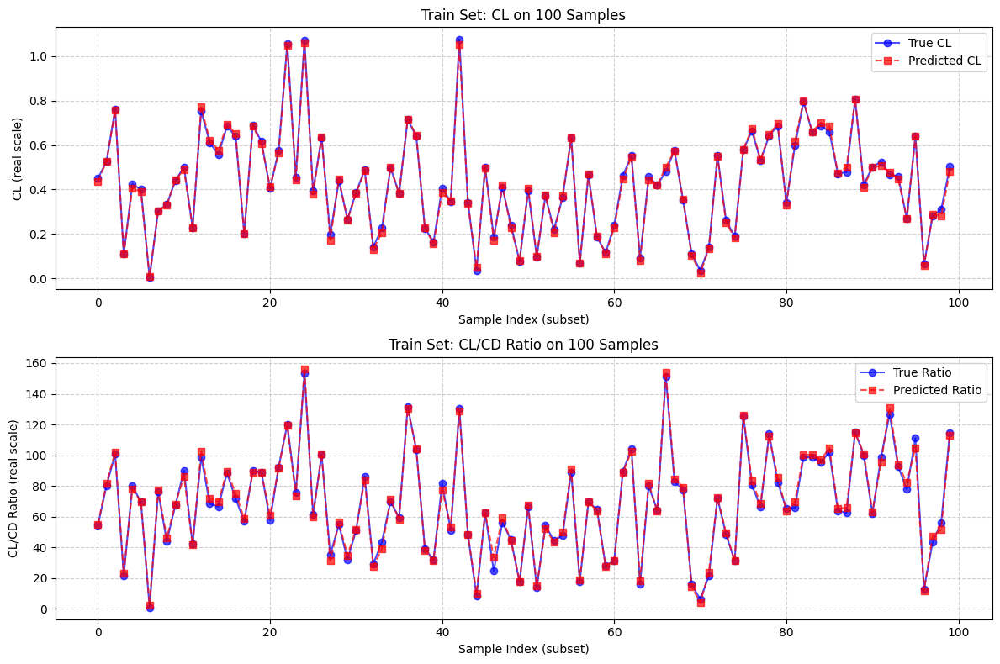

=== Plotting a smaller subset (100 samples) for the TEST set (best_model) ===


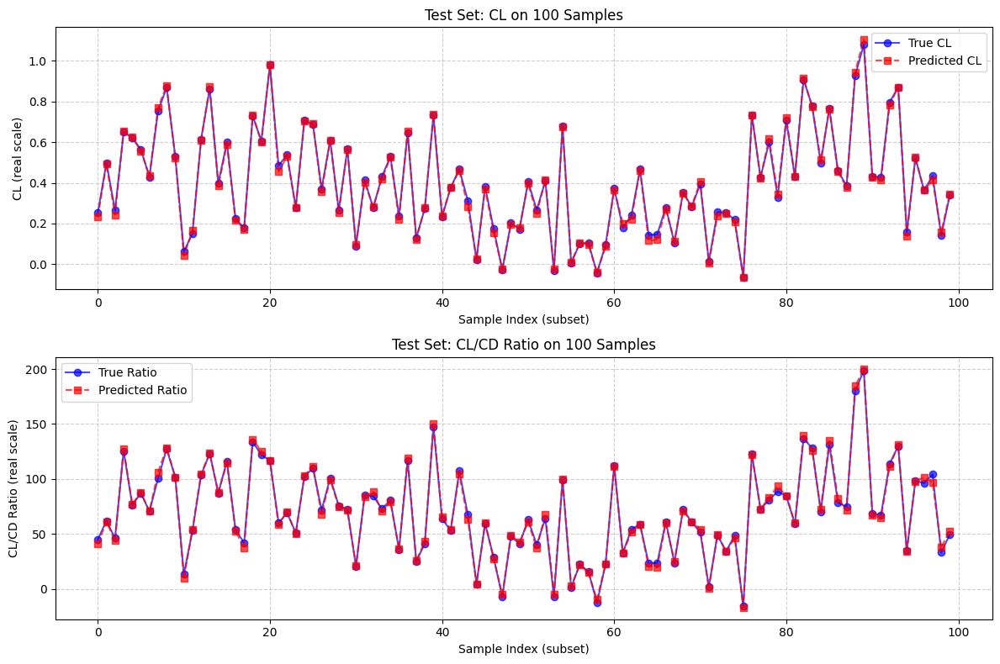

=== Visualizing model_epoch_250 predictions on the TRAIN set ===


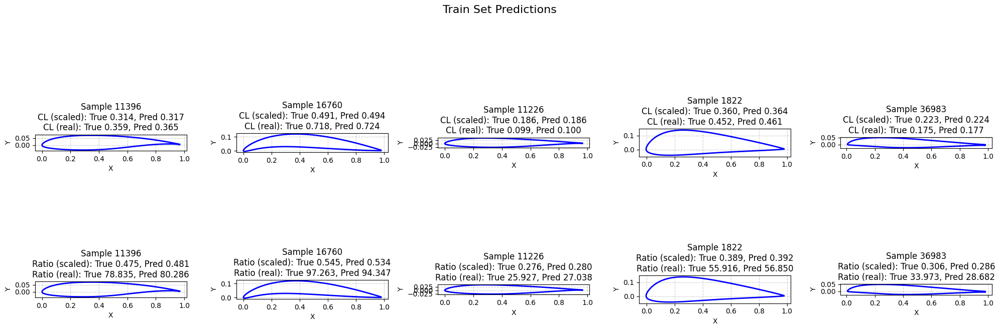

=== Visualizing model_epoch_250 predictions on the TEST set ===


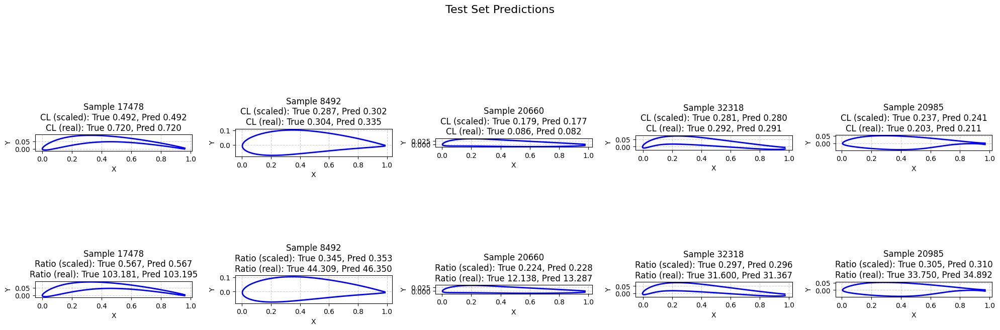

=== Plotting a smaller subset (100 samples) for the TRAIN set (model_epoch_250) ===


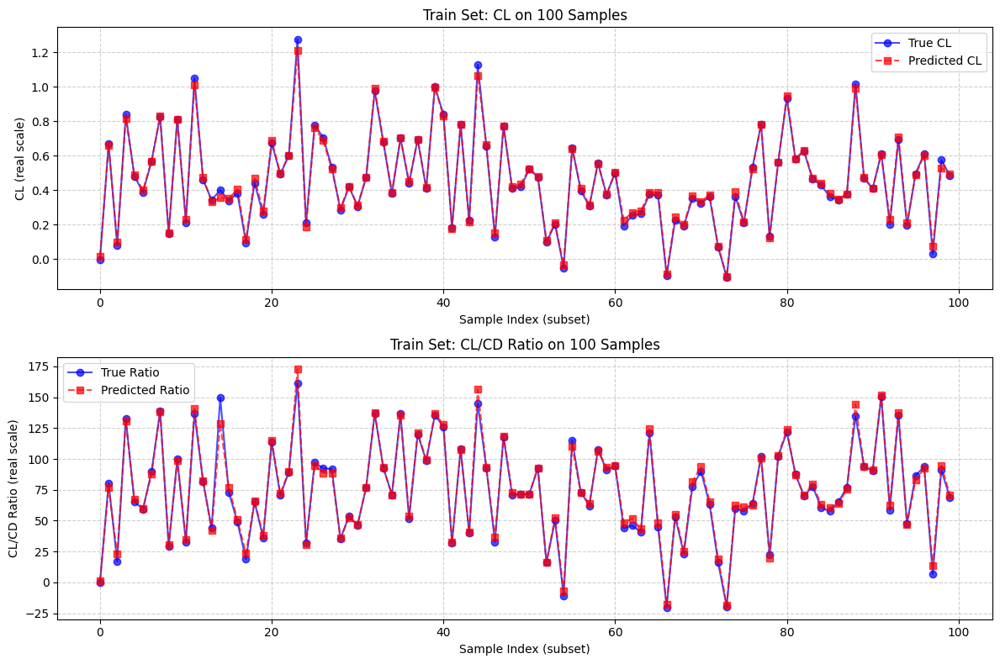

=== Plotting a smaller subset (100 samples) for the TEST set (model_epoch_250) ===


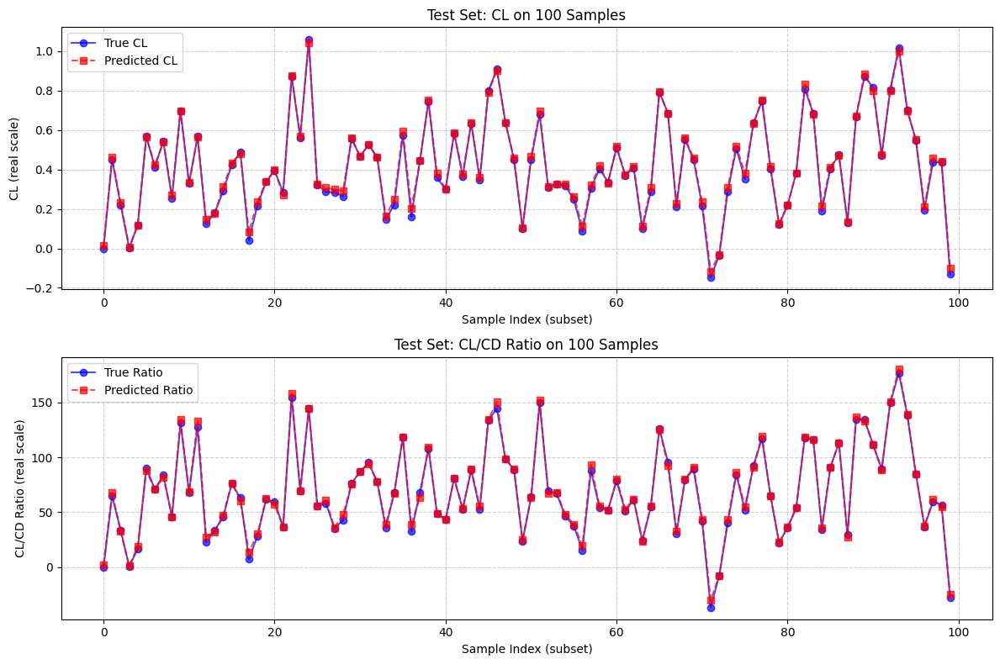

In [ ]:
# 3) Load your best model checkpoint
best_model_path = os.path.join(checkpoint_dir, "best_model.pt")
model_best = SurrogateModel1D(n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2])
model_best.load_state_dict(torch.load(best_model_path, map_location=device))
model_best.to(device)
model_best.eval()

# 4) Visualize predictions with best_model
print("=== Visualizing best_model predictions on the TRAIN set ===")
visualize_predictions_grid(model_best, train_dataset, device, set_name="Train")
print("=== Visualizing best_model predictions on the TEST set ===")
visualize_predictions_grid(model_best, test_dataset, device, set_name="Test")

print("=== Plotting a smaller subset (100 samples) for the TRAIN set (best_model) ===")
plot_small_subset_predictions(model_best, train_dataset, device, sample_count=100, set_name="Train")
print("=== Plotting a smaller subset (100 samples) for the TEST set (best_model) ===")
plot_small_subset_predictions(model_best, test_dataset, device, sample_count=100, set_name="Test")

# 5) Load the model_epoch_250 checkpoint
model_250_path = os.path.join(checkpoint_dir, "model_epoch_250.pt")
model_epoch_250 = SurrogateModel1D(n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2])
model_epoch_250.load_state_dict(torch.load(model_250_path, map_location=device))
model_epoch_250.to(device)
model_epoch_250.eval()

# 6) Visualize predictions with model_epoch_250
print("=== Visualizing model_epoch_250 predictions on the TRAIN set ===")
visualize_predictions_grid(model_epoch_250, train_dataset, device, set_name="Train")
print("=== Visualizing model_epoch_250 predictions on the TEST set ===")
visualize_predictions_grid(model_epoch_250, test_dataset, device, set_name="Test")

print("=== Plotting a smaller subset (100 samples) for the TRAIN set (model_epoch_250) ===")
plot_small_subset_predictions(model_epoch_250, train_dataset, device, sample_count=100, set_name="Train")
print("=== Plotting a smaller subset (100 samples) for the TEST set (model_epoch_250) ===")
plot_small_subset_predictions(model_epoch_250, test_dataset, device, sample_count=100, set_name="Test")


### Navid_MLP

##### Model and data reprepare!

In [ ]:
import torch.nn as nn
import torch.nn.functional as F
import torch

activation_function_list = [nn.ReLU()]
class MultiLayerPerceptron_forward(nn.Module):
    def __init__(self, input_size, hidden_layers, num_classes, net_n):
        super(MultiLayerPerceptron_forward, self).__init__()
        #################################################################################
        # Initialize the modules required to implement the mlp with given layer   #
        # configuration. input_size --> hidden_layers[0] --> hidden_layers[1] .... -->  #
        # hidden_layers[-1] --> num_classes                                             #
        #################################################################################
        layers = []
        layers.append(nn.Linear((input_size), (hidden_layers[0])))
        for i in range(len(hidden_layers)-1):
            layers.append(nn.Linear((hidden_layers[i]), (hidden_layers[i+1])))

        layers.append(nn.Linear((hidden_layers[len(hidden_layers)-1]), (num_classes)))
        self.layers = nn.Sequential(*layers)
        self.net_n = net_n
        self.hidden_layers = hidden_layers
    def forward(self, x):
        #################################################################################
        # Implement the forward pass computations                                 #
        #################################################################################
        m = activation_function_list[self.net_n]
        for i in range(len(self.hidden_layers)):
            x = self.layers[i](x)
            x = m(x)
        x = (self.layers[len(self.hidden_layers)](x))
        out=x
        return out



In [ ]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset

########################################
# 1) Hyperparameters and device config
########################################
input_size = 384    # (192 * 2) if you flatten each airfoil
hidden_size = [150, 200, 200, 150]
num_classes = 2
num_epochs = 250
learning_rate = 9e-4
learning_rate_decay = 0.999
batch_size = 128
patience = 100

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print("Using device:", device)


###############################
# 2) Load data and flatten
###############################
data_path = "/content/data"  # Adjust to your location
xs_train_path = os.path.join(data_path, "xs_train.npy")
xs_test_path  = os.path.join(data_path, "xs_test.npy")
ys_train_scaled_path = os.path.join(data_path, "ys_train_scaled.npy")
ys_test_scaled_path  = os.path.join(data_path, "ys_test_scaled.npy")

xs_train = np.load(xs_train_path)         # shape (N_train, 192, 2)
xs_test  = np.load(xs_test_path)          # shape (N_test, 192, 2)
ys_train_scaled = np.load(ys_train_scaled_path) # shape (N_train, 2)
ys_test_scaled  = np.load(ys_test_scaled_path)  # shape (N_test, 2)

Ntrain = xs_train.shape[0]
xs_train_flat = xs_train.reshape(Ntrain, -1)  # => (N_train, 384)
Ntest = xs_test.shape[0]
xs_test_flat = xs_test.reshape(Ntest, -1)     # => (N_test, 384)

print("Train input shape:", xs_train_flat.shape)
print("Train labels shape:", ys_train_scaled.shape)
print("Test input shape:", xs_test_flat.shape)
print("Test labels shape:", ys_test_scaled.shape)

# Convert to Tensors
X_train_tensor = torch.from_numpy(xs_train_flat).float()
Y_train_tensor = torch.from_numpy(ys_train_scaled).float()
X_test_tensor  = torch.from_numpy(xs_test_flat).float()
Y_test_tensor  = torch.from_numpy(ys_test_scaled).float()

# Build TensorDatasets
train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
test_dataset  = TensorDataset(X_test_tensor, Y_test_tensor)

train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader  = DataLoader(test_dataset,  batch_size=batch_size, shuffle=False)


Using device: cuda
Train input shape: (38802, 384)
Train labels shape: (38802, 2)
Test input shape: (9701, 384)
Test labels shape: (9701, 2)


##### Train

In [ ]:
########################################
# 3) Define MLP model and init weights
########################################
model_mlp = MultiLayerPerceptron_forward(
    input_size, hidden_size, num_classes, net_n=0
).to(device)

def weights_init(m):
    if isinstance(m, nn.Linear):
        m.weight.data.normal_(mean=0.0, std=1e-3)
        m.bias.data.fill_(0.0)

model_mlp.apply(weights_init)


###############################
# 4) Define Losses & Optimizer
###############################
def sum_mse(yhat, y):
    """
    Summed per-sample MSE (averaged across the 2 outputs).
    """
    per_sample_mse = torch.mean((yhat - y)**2, dim=1)  # shape (batch,)
    return torch.sum(per_sample_mse)

criterion_train = sum_mse
criterion_val   = nn.MSELoss()  # Standard mean MSE
optimizer = optim.Adam(model_mlp.parameters(), lr=learning_rate)

def update_lr(optimizer, new_lr):
    for param_group in optimizer.param_groups:
        param_group['lr'] = new_lr



Epoch [1/250], Step [100/304], Train Loss (batch): 1.7109
Epoch [1/250], Step [200/304], Train Loss (batch): 0.6668
Epoch [1/250], Step [300/304], Train Loss (batch): 0.4408
Epoch [1/250] - Train Loss: 2.121456, Test Loss: 0.004646
New best model at epoch 1 with test loss 0.004646
Epoch [2/250], Step [100/304], Train Loss (batch): 0.3598
Epoch [2/250], Step [200/304], Train Loss (batch): 0.2591
Epoch [2/250], Step [300/304], Train Loss (batch): 0.2640
Epoch [2/250] - Train Loss: 0.368382, Test Loss: 0.003370
New best model at epoch 2 with test loss 0.003370
Epoch [3/250], Step [100/304], Train Loss (batch): 0.2771
Epoch [3/250], Step [200/304], Train Loss (batch): 0.2867
Epoch [3/250], Step [300/304], Train Loss (batch): 0.3151
Epoch [3/250] - Train Loss: 0.288043, Test Loss: 0.003734
Epoch [4/250], Step [100/304], Train Loss (batch): 0.3270
Epoch [4/250], Step [200/304], Train Loss (batch): 0.1789
Epoch [4/250], Step [300/304], Train Loss (batch): 0.2382
Epoch [4/250] - Train Loss: 0.

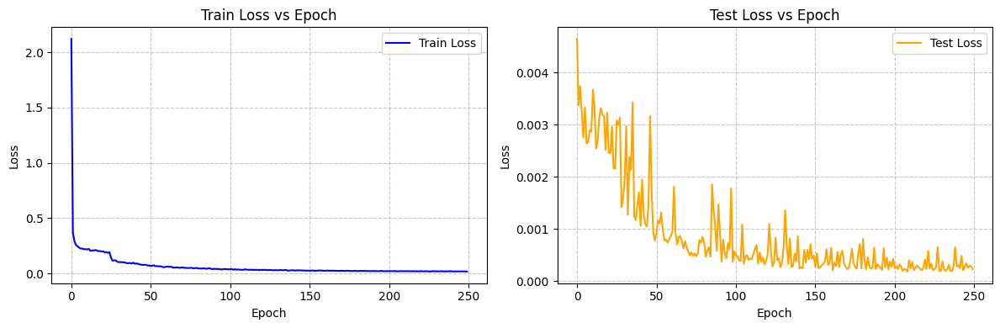

In [ ]:
########################################
# 5) Training loop with early stopping
########################################
best_loss = float('inf')
best_epoch = 0
epochs_no_improve = 0
lr_current = learning_rate

train_losses = []
test_losses  = []

start_time = time.time()

for epoch in range(1, num_epochs + 1):
    # ---- Training ----
    model_mlp.train()
    running_loss = 0.0
    for batch_idx, (features, labels) in enumerate(train_loader):
        features, labels = features.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model_mlp(features)  # shape (batch, 2)
        loss = criterion_train(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * features.size(0)

        # if (batch_idx + 1) % 100 == 0:
        #     print(f"Epoch [{epoch}/{num_epochs}], Step [{batch_idx+1}/{len(train_loader)}],"
        #           f" Train Loss (batch): {loss.item():.4f}")

    epoch_train_loss = running_loss / len(train_loader.dataset)
    train_losses.append(epoch_train_loss)

    # ---- Validation ----
    model_mlp.eval()
    test_loss = 0.0
    with torch.no_grad():
        for features, labels in test_loader:
            features, labels = features.to(device), labels.to(device)
            preds = model_mlp(features)
            test_loss += criterion_val(preds, labels).item() * features.size(0)
    epoch_test_loss = test_loss / len(test_loader.dataset)
    test_losses.append(epoch_test_loss)

    # Print log
    print(f"Epoch [{epoch}/{num_epochs}] - Train Loss: {epoch_train_loss:.6f}, Test Loss: {epoch_test_loss:.6f}")

    # Early stopping check
    if epoch_test_loss < best_loss:
        best_loss = epoch_test_loss
        best_epoch = epoch
        epochs_no_improve = 0
        torch.save(model_mlp.state_dict(), "mlp_best_model.pt")
        print(f"New best model at epoch {epoch} with test loss {best_loss:.6f}")
    else:
        epochs_no_improve += 1
        if epochs_no_improve >= patience:
            print(f"No improvement for {patience} epochs. Early stopping at epoch {epoch}.")
            break

    # Update learning rate
    lr_current *= learning_rate_decay
    update_lr(optimizer, lr_current)

elapsed = time.time() - start_time
print(f"\nTraining completed in {elapsed:.2f} seconds. Best epoch: {best_epoch} with test loss {best_loss:.6f}")

# Save final model weights
torch.save(model_mlp.state_dict(), "mlp_final_model.pt")
print("Saved mlp_final_model.pt")


############################################################
# 6) Save and plot train/test losses in separate subplots
############################################################
train_losses = np.array(train_losses)
test_losses  = np.array(test_losses)

# Save them as .npy
np.save("train_losses.npy", train_losses)
np.save("test_losses.npy",  test_losses)

# Two subplots: one for Train Loss, one for Test Loss
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

axs[0].plot(train_losses, label="Train Loss", color="blue")
axs[0].set_title("Train Loss vs Epoch")
axs[0].set_xlabel("Epoch")
axs[0].set_ylabel("Loss")
axs[0].grid(True, linestyle="--", alpha=0.7)
axs[0].legend()

axs[1].plot(test_losses, label="Test Loss", color="orange")
axs[1].set_title("Test Loss vs Epoch")
axs[1].set_xlabel("Epoch")
axs[1].set_ylabel("Loss")
axs[1].grid(True, linestyle="--", alpha=0.7)
axs[1].legend()

plt.tight_layout()
plt.show()

##### Load

In [ ]:
# Instantiate a fresh model with the same architecture
model_mlp = MultiLayerPerceptron_forward(
    input_size=input_size,
    hidden_layers=hidden_size,
    num_classes=num_classes,
    net_n=0  # using ReLU
).to(device)

# Path to your best or final model checkpoint
# checkpoint_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/Navid_mlp"
# best_model_path = os.path.join(checkpoint_dir, "mlp_best_model.pt")
best_model_path = os.path.join("mlp_best_model.pt")

# Load the saved state_dict
model_mlp.load_state_dict(torch.load(best_model_path, map_location=device))
model_mlp.eval()
print("Loaded MLP model weights from:", best_model_path)


# final_model_path = os.path.join(checkpoint_dir, "mlp_final_model.pt")
final_model_path = os.path.join("mlp_final_model.pt")
model_mlp_final = MultiLayerPerceptron_forward(
    input_size, hidden_size, num_classes, net_n=0
).to(device)

model_mlp_final.load_state_dict(torch.load(final_model_path, map_location=device))
model_mlp_final.eval()
print("Loaded final model weights from:", final_model_path)

Loaded MLP model weights from: mlp_best_model.pt
Loaded final model weights from: mlp_final_model.pt


##### rewriting the functions for the plot (adapted)

In [ ]:
def inverse_scale_label_mlp(scaled_label, y_min, y_max):
    """
    scaled_label: shape (2,) or (batch,2) in [0,1]
    y_min, y_max: shape (2,)

    Returns real values: shape matching scaled_label
    """
    # If tensor, convert to NumPy
    if isinstance(scaled_label, torch.Tensor):
        scaled_label = scaled_label.cpu().numpy()

    # Flatten y_min, y_max to (2,) if they aren't already
    y_min = y_min.ravel()
    y_max = y_max.ravel()

    if scaled_label.ndim == 1:
        # shape => (2,)
        return scaled_label * (y_max - y_min) + y_min
    else:
        # shape => (batch,2)
        return scaled_label * (y_max[None,:] - y_min[None,:]) + y_min[None,:]

def visualize_predictions_grid_mlp(model, dataset, y_min, y_max, device,
                                   sample_indices=None, set_name="Train",
                                   figsize=(20,8)):
    """
    Similar to 'visualize_predictions_grid' but adapted for an MLP
    that receives flattened input of shape (384,).

    dataset: a TensorDataset where each sample is (features, label):
      - features.shape == (384,)
      - label.shape == (2,) in [0,1].

    We reshape the flattened input to (192,2)->.T =>(2,192) for plotting.
    We call 'inverse_scale_label_mlp' to get the real (CL, ratio).
    """
    model.eval()

    # If no specific indices given, pick 5 random
    if sample_indices is None:
        num_samples = 5
        sample_indices = np.random.choice(len(dataset), size=num_samples, replace=False)
    else:
        num_samples = len(sample_indices)

    fig, axs = plt.subplots(2, num_samples, figsize=figsize)

    for j, idx in enumerate(sample_indices):
        # 1) Extract features (384,) and label (2,)
        features, scaled_label = dataset[idx]

        # Reshape to (192,2) => transpose =>(2,192)
        coords_2d = features.reshape(192,2).T  # row0 => X, row1 => Y
        coords_np = coords_2d.numpy()  # for plotting

        # 2) Model forward pass
        with torch.no_grad():
            features_batch = features.unsqueeze(0).to(device)   # => (1,384)
            pred_scaled = model(features_batch)                 # => (1,2)
        pred_scaled = pred_scaled.squeeze(0).cpu().numpy()      # => (2,)

        # 3) Inverse-scale ground-truth & predicted
        true_unscaled = inverse_scale_label_mlp(scaled_label, y_min, y_max)
        pred_unscaled = inverse_scale_label_mlp(pred_scaled,   y_min, y_max)

        # For convenience
        true_CL_scaled    = scaled_label[0].item()
        pred_CL_scaled    = pred_scaled[0]
        true_ratio_scaled = scaled_label[1].item()
        pred_ratio_scaled = pred_scaled[1]

        true_CL_real    = true_unscaled[0]
        pred_CL_real    = pred_unscaled[0]
        true_ratio_real = true_unscaled[1]
        pred_ratio_real = pred_unscaled[1]

        # --- Top row: CL info
        axs[0, j].plot(coords_np[0], coords_np[1], 'b-', linewidth=1)
        axs[0, j].set_title(
            f"Sample {idx}\n"
            f"CL (scaled): T={true_CL_scaled:.3f}, P={pred_CL_scaled:.3f}\n"
            f"CL (real):   T={true_CL_real:.3f}, P={pred_CL_real:.3f}"
        )
        axs[0, j].set_xlabel("X")
        axs[0, j].set_ylabel("Y")
        axs[0, j].set_aspect('equal', adjustable='box')
        axs[0, j].grid(True, linestyle="--", alpha=0.6)

        # --- Bottom row: CL/CD ratio info
        axs[1, j].plot(coords_np[0], coords_np[1], 'b-', linewidth=1)
        axs[1, j].set_title(
            f"Ratio (scaled): T={true_ratio_scaled:.3f}, P={pred_ratio_scaled:.3f}\n"
            f"Ratio (real):   T={true_ratio_real:.3f}, P={pred_ratio_real:.3f}"
        )
        axs[1, j].set_xlabel("X")
        axs[1, j].set_ylabel("Y")
        axs[1, j].set_aspect('equal', adjustable='box')
        axs[1, j].grid(True, linestyle="--", alpha=0.6)

    plt.suptitle(f"{set_name} Set Predictions (MLP)", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


def plot_small_subset_predictions_mlp(model, dataset, y_min, y_max, device,
                                      sample_count=100, set_name="Train"):
    """
    Plots 100 random samples' real vs. predicted CL and ratio in 2 subplots.

    dataset: TensorDataset with shape (384,) for features, (2,) for label.
    We do not need to reshape to (2,192) here, because we only want numeric comparisons.
    """
    model.eval()

    indices = np.random.choice(len(dataset), size=sample_count, replace=False)
    indices = sorted(indices)

    real_CL_vals = []
    real_ratio_vals = []
    pred_CL_vals = []
    pred_ratio_vals = []

    with torch.no_grad():
        for idx in indices:
            features, scaled_label = dataset[idx]
            # Model forward pass
            features_batch = features.unsqueeze(0).to(device)  # (1,384)
            pred_scaled = model(features_batch)                # => (1,2)
            pred_scaled = pred_scaled.squeeze(0).cpu().numpy() # => (2,)

            # Inverse scale
            true_unscaled = inverse_scale_label_mlp(scaled_label, y_min, y_max)
            pred_unscaled = inverse_scale_label_mlp(pred_scaled,   y_min, y_max)

            real_CL_vals.append(true_unscaled[0])
            real_ratio_vals.append(true_unscaled[1])
            pred_CL_vals.append(pred_unscaled[0])
            pred_ratio_vals.append(pred_unscaled[1])

    x_axis = np.arange(sample_count)
    plt.figure(figsize=(12, 8))

    # --- top subplot: CL
    plt.subplot(2, 1, 1)
    plt.plot(x_axis, real_CL_vals, 'o-', label="True CL", color='blue', alpha=0.7)
    plt.plot(x_axis, pred_CL_vals, 's--', label="Pred CL", color='red', alpha=0.7)
    plt.title(f"{set_name} Set: CL on {sample_count} samples")
    plt.xlabel("Sample Index")
    plt.ylabel("CL (real scale)")
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.6)

    # --- bottom subplot: CL/CD ratio
    plt.subplot(2, 1, 2)
    plt.plot(x_axis, real_ratio_vals, 'o-', label="True Ratio", color='blue', alpha=0.7)
    plt.plot(x_axis, pred_ratio_vals, 's--', label="Pred Ratio", color='red', alpha=0.7)
    plt.title(f"{set_name} Set: CL/CD on {sample_count} samples")
    plt.xlabel("Sample Index")
    plt.ylabel("CL/CD (real scale)")
    plt.legend()
    plt.grid(True, linestyle="--", alpha=0.6)

    plt.tight_layout()
    plt.show()



##### Visulization Results

###### Best model (Navid) Performance

Visualizing predictions (grid) on TRAIN set:


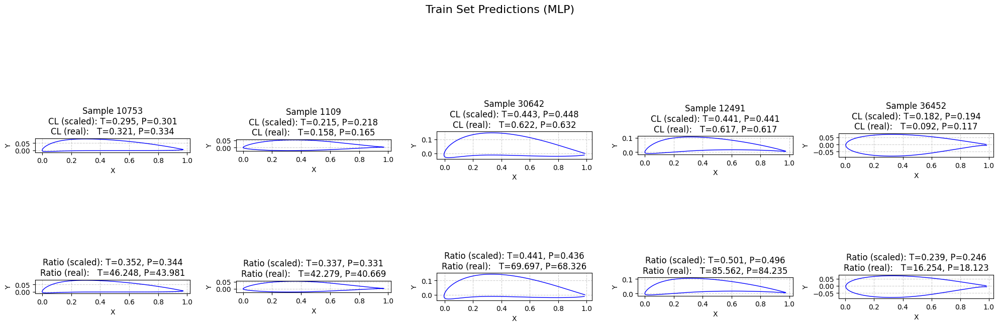

Visualizing predictions (grid) on TEST set:


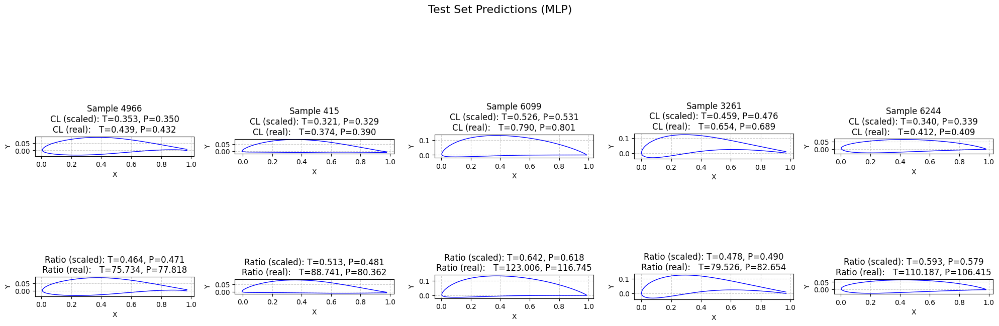

Plotting a smaller subset (100 samples) for the TRAIN set:


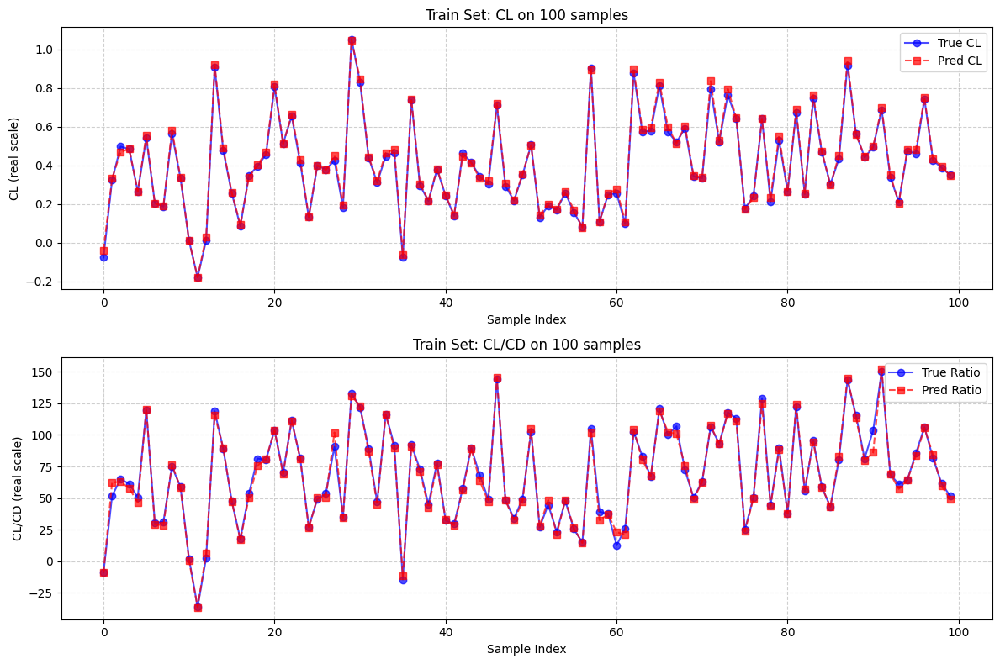

Plotting a smaller subset (100 samples) for the TEST set:


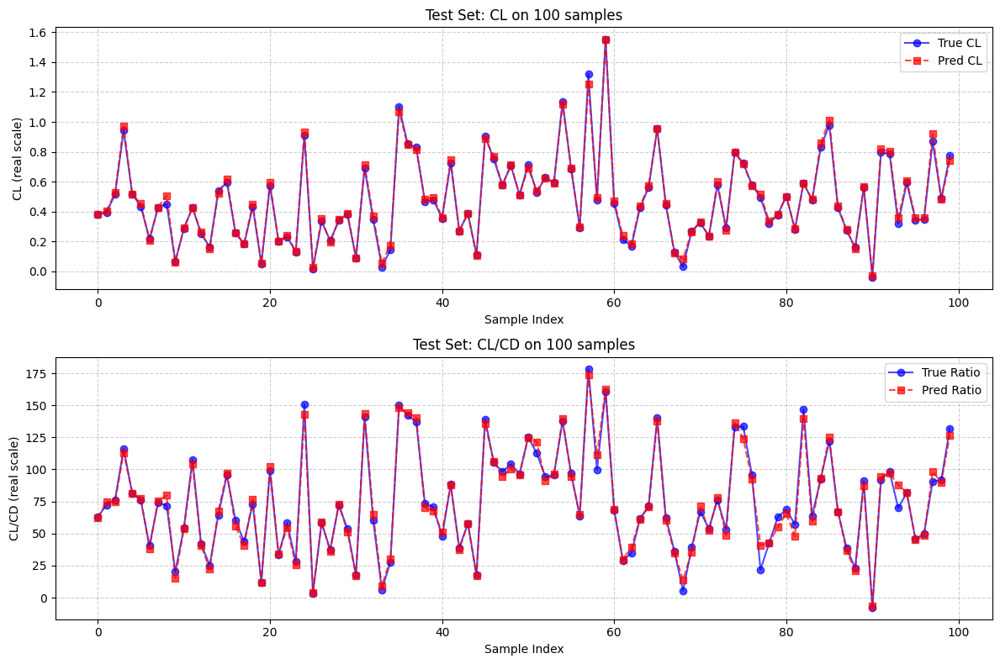

In [ ]:
# 1) After finishing training (and optionally reloading your model)...
y_min = np.load(os.path.join(data_path, "y_min.npy"))  # shape (1,2)
y_max = np.load(os.path.join(data_path, "y_max.npy"))  # shape (1,2)

# 2) Plot a random grid of 5 samples from the train_dataset
print("Visualizing predictions (grid) on TRAIN set:")
visualize_predictions_grid_mlp(model_mlp, train_dataset, y_min, y_max, device, set_name="Train")

# 3) Plot the same but for the test_dataset
print("Visualizing predictions (grid) on TEST set:")
visualize_predictions_grid_mlp(model_mlp, test_dataset, y_min, y_max, device, set_name="Test")

# 4) Plot 100-sample line plots for train/test
print("Plotting a smaller subset (100 samples) for the TRAIN set:")
plot_small_subset_predictions_mlp(model_mlp, train_dataset, y_min, y_max, device, sample_count=100, set_name="Train")

print("Plotting a smaller subset (100 samples) for the TEST set:")
plot_small_subset_predictions_mlp(model_mlp, test_dataset, y_min, y_max, device, sample_count=100, set_name="Test")


###### Final (epoch 250) model (Navid) Performance

Visualizing predictions (grid) on TRAIN set:


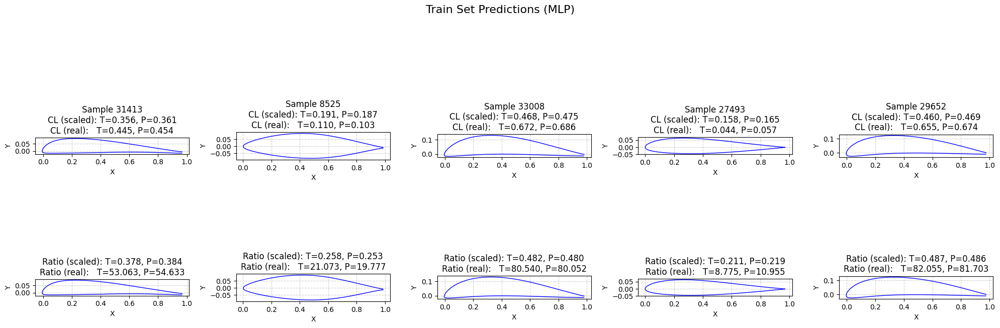

Visualizing predictions (grid) on TEST set:


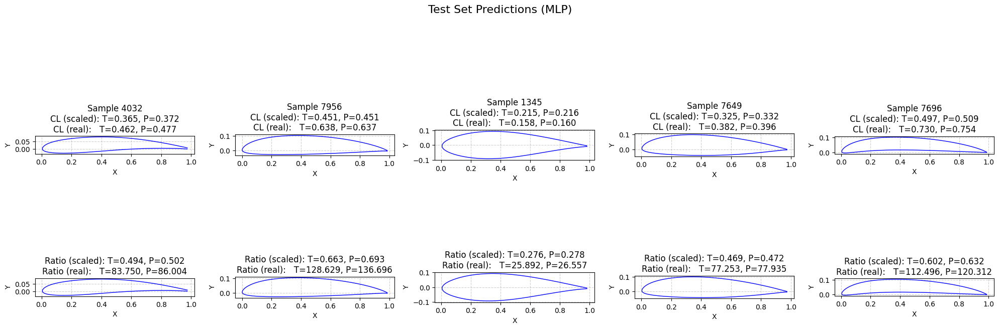

Plotting a smaller subset (100 samples) for the TRAIN set:


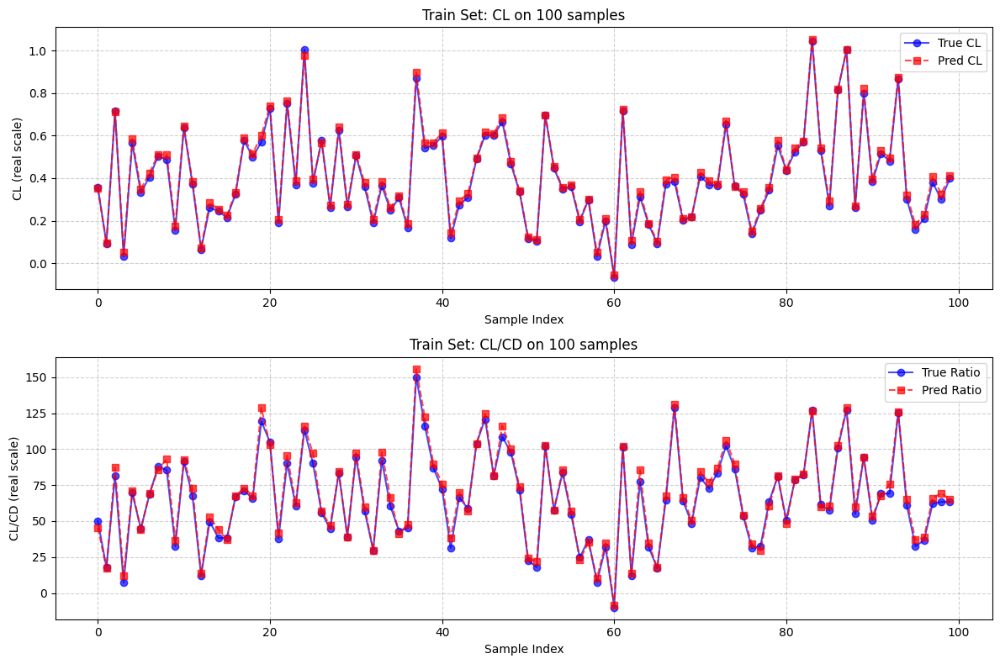

Plotting a smaller subset (100 samples) for the TEST set:


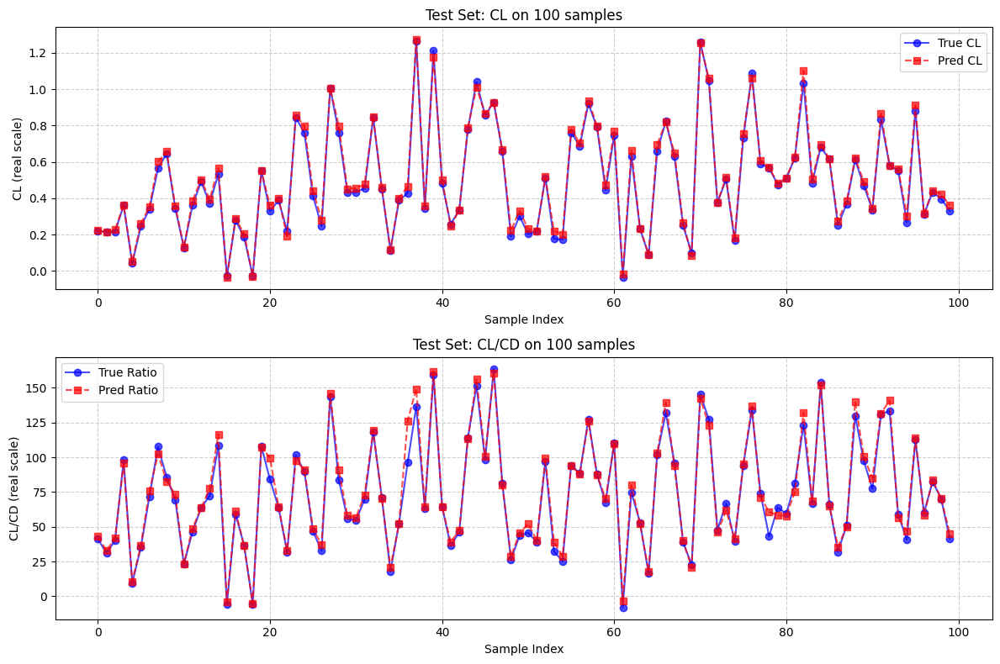

In [ ]:
# 1) After finishing training (and optionally reloading your model)...
y_min = np.load(os.path.join(data_path, "y_min.npy"))  # shape (1,2)
y_max = np.load(os.path.join(data_path, "y_max.npy"))  # shape (1,2)

# 2) Plot a random grid of 5 samples from the train_dataset
print("Visualizing predictions (grid) on TRAIN set:")
visualize_predictions_grid_mlp(model_mlp_final, train_dataset, y_min, y_max, device, set_name="Train")

# 3) Plot the same but for the test_dataset
print("Visualizing predictions (grid) on TEST set:")
visualize_predictions_grid_mlp(model_mlp_final, test_dataset, y_min, y_max, device, set_name="Test")

# 4) Plot 100-sample line plots for train/test
print("Plotting a smaller subset (100 samples) for the TRAIN set:")
plot_small_subset_predictions_mlp(model_mlp_final, train_dataset, y_min, y_max, device, sample_count=100, set_name="Train")

print("Plotting a smaller subset (100 samples) for the TEST set:")
plot_small_subset_predictions_mlp(model_mlp_final, test_dataset, y_min, y_max, device, sample_count=100, set_name="Test")


### Final Compariment between the trained surrogate models

In [ ]:
########################
## 0) Imports & Setup ##
########################
import os
import numpy as np
import torch
import matplotlib.pyplot as plt

from torch.utils.data import DataLoader, TensorDataset

#######################
## 1) Residual Model ##
#######################

# 1.2) Paths for residual (V1) data & checkpoints
resid_data_path = "/content/data"  # where xs_train.npy, ys_train_scaled.npy, etc. are
residv1_checkpoint_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residualV1"

# residual data
resid_xs_train_path = os.path.join(resid_data_path, "xs_train.npy")
resid_ys_train_path = os.path.join(resid_data_path, "ys_train_scaled.npy")
resid_y_min_path    = os.path.join(resid_data_path, "y_min.npy")
resid_y_max_path    = os.path.join(resid_data_path, "y_max.npy")

resid_train_dataset = AirfoilDataset(resid_xs_train_path, resid_ys_train_path,
                                     resid_y_min_path, resid_y_max_path)

# If you have a separate test set for residual
resid_xs_test_path = os.path.join(resid_data_path, "xs_test.npy")
resid_ys_test_path = os.path.join(resid_data_path, "ys_test_scaled.npy")
resid_test_dataset = AirfoilDataset(resid_xs_test_path, resid_ys_test_path,
                                    resid_y_min_path, resid_y_max_path)

resid_device = 'cuda' if torch.cuda.is_available() else 'cpu'

# 1.3) Residual V1 (best and final) models
residv1_best_path  = os.path.join(residv1_checkpoint_dir, "best_model.pt")
residv1_final_path = os.path.join(residv1_checkpoint_dir, "model_epoch_250.pt")

residv1_best_model = SurrogateModel1D(n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2]).to(resid_device)
residv1_best_model.load_state_dict(torch.load(residv1_best_path, map_location=resid_device))
residv1_best_model.eval()

residv1_final_model = SurrogateModel1D(n_points=192, in_channels=2, depth=16, residual_list=[2,2,2,2]).to(resid_device)
residv1_final_model.load_state_dict(torch.load(residv1_final_path, map_location=resid_device))
residv1_final_model.eval()


################################
## 2) MLP Model Setup & Paths ##
################################


# 2.2) MLP data
mlp_data_path = "/content/data"
mlp_xs_train_path = os.path.join(mlp_data_path, "xs_train.npy")  # shape (N,192,2)
mlp_xs_test_path  = os.path.join(mlp_data_path, "xs_test.npy")
mlp_ys_train_scaled_path = os.path.join(mlp_data_path, "ys_train_scaled.npy")
mlp_ys_test_scaled_path  = os.path.join(mlp_data_path, "ys_test_scaled.npy")

mlp_y_min = np.load(os.path.join(mlp_data_path, "y_min.npy")) # shape (1,2)
mlp_y_max = np.load(os.path.join(mlp_data_path, "y_max.npy")) # shape (1,2)

# Flatten inputs
mlp_xs_train = np.load(mlp_xs_train_path)  # (N_train,192,2)
mlp_xs_test  = np.load(mlp_xs_test_path)   # (N_test,192,2)
mlp_ys_train = np.load(mlp_ys_train_scaled_path) # (N_train,2)
mlp_ys_test  = np.load(mlp_ys_test_scaled_path)  # (N_test,2)

mlp_xs_train_flat = mlp_xs_train.reshape(mlp_xs_train.shape[0], -1) # => (N_train,384)
mlp_xs_test_flat  = mlp_xs_test.reshape(mlp_xs_test.shape[0], -1)   # => (N_test,384)

X_train_tensor = torch.from_numpy(mlp_xs_train_flat).float()
Y_train_tensor = torch.from_numpy(mlp_ys_train).float()
X_test_tensor  = torch.from_numpy(mlp_xs_test_flat).float()
Y_test_tensor  = torch.from_numpy(mlp_ys_test).float()

mlp_train_dataset = TensorDataset(X_train_tensor, Y_train_tensor)
mlp_test_dataset  = TensorDataset(X_test_tensor,  Y_test_tensor)

mlp_device = 'cuda' if torch.cuda.is_available() else 'cpu'

# 2.3) MLP best and final
mlp_checkpoint_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/Navid_mlp"
mlp_best_path  = os.path.join(mlp_checkpoint_dir, "mlp_best_model.pt")
mlp_final_path = os.path.join(mlp_checkpoint_dir, "mlp_final_model.pt")

mlp_input_size = 384
mlp_hidden = [150, 200, 200, 150]
mlp_num_classes = 2

mlp_best_model = MultiLayerPerceptron_forward(mlp_input_size, mlp_hidden, mlp_num_classes, net_n=0).to(mlp_device)
mlp_best_model.load_state_dict(torch.load(mlp_best_path, map_location=mlp_device))
mlp_best_model.eval()

mlp_final_model = MultiLayerPerceptron_forward(mlp_input_size, mlp_hidden, mlp_num_classes, net_n=0).to(mlp_device)
mlp_final_model.load_state_dict(torch.load(mlp_final_path, map_location=mlp_device))
mlp_final_model.eval()


#######################################
## 3) Evaluate MSE for Each of 4 Models
#######################################
def evaluate_dataset_mse(model, dataset, device):
    """
    Evaluate the average MSE over the entire dataset.
    For the residual model, dataset item => shape (2,192).
    For the MLP model, dataset item => shape (384,).
    We also have labels => shape (2,).
    """
    model.eval()
    from torch.utils.data import DataLoader
    loader = DataLoader(dataset, batch_size=128, shuffle=False)

    mse_criterion = torch.nn.MSELoss(reduction='sum')  # We'll sum then divide
    total_loss = 0.0
    total_samples = 0

    with torch.no_grad():
        for (features, labels) in loader:
            features = features.to(device)
            labels   = labels.to(device)
            preds    = model(features)
            loss     = mse_criterion(preds, labels)
            total_loss += loss.item()
            total_samples += features.size(0)

    return total_loss / total_samples  # mean MSE

def print_mse_for_model(model_name, model, train_dataset, test_dataset, device):
    train_mse = evaluate_dataset_mse(model, train_dataset, device)
    test_mse  = evaluate_dataset_mse(model, test_dataset, device)
    print(f"{model_name}: MSE => Train: {train_mse:.6f}, Test: {test_mse:.6f}")
    return train_mse, test_mse


# Evaluate all 4
residv1_best_train_mse, residv1_best_test_mse   = print_mse_for_model("ResidualV1_Best",
                                residv1_best_model,  resid_train_dataset,  resid_test_dataset,  resid_device)

residv1_final_train_mse, residv1_final_test_mse = print_mse_for_model("ResidualV1_Final",
                                residv1_final_model, resid_train_dataset,  resid_test_dataset,  resid_device)

mlp_best_train_mse, mlp_best_test_mse           = print_mse_for_model("MLP_Best",
                                mlp_best_model,    mlp_train_dataset,     mlp_test_dataset,     mlp_device)

mlp_final_train_mse, mlp_final_test_mse         = print_mse_for_model("MLP_Final",
                                mlp_final_model,   mlp_train_dataset,     mlp_test_dataset,     mlp_device)


################################################
## 4) Summarize results in a small “table”
################################################
print("\n=== Summary of MSE across 4 Models ===")
summary_table = [
    ["Model",          "Train MSE",               "Test MSE"             ],
    ["ResidualV1_Best", f"{residv1_best_train_mse:.6f}",  f"{residv1_best_test_mse:.6f}"],
    ["ResidualV1_Final",f"{residv1_final_train_mse:.6f}", f"{residv1_final_test_mse:.6f}"],
    ["MLP_Best",        f"{mlp_best_train_mse:.6f}",       f"{mlp_best_test_mse:.6f}"],
    ["MLP_Final",       f"{mlp_final_train_mse:.6f}",      f"{mlp_final_test_mse:.6f}"],
]

# Print in a simple textual table
col_widths = [max(len(row[i]) for row in summary_table) for i in range(3)]
row_format = "| " + " | ".join([f"{{:<{w}}}" for w in col_widths]) + " |"
for row in summary_table:
    print(row_format.format(*row))





<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


ResidualV1_Best: MSE => Train: 0.000128, Test: 0.000208
ResidualV1_Final: MSE => Train: 0.000181, Test: 0.000384
MLP_Best: MSE => Train: 0.000248, Test: 0.000383
MLP_Final: MSE => Train: 0.000403, Test: 0.000625

=== Summary of MSE across 4 Models ===
| Model            | Train MSE | Test MSE |
| ResidualV1_Best  | 0.000128  | 0.000208 |
| ResidualV1_Final | 0.000181  | 0.000384 |
| MLP_Best         | 0.000248  | 0.000383 |
| MLP_Final        | 0.000403  | 0.000625 |



=== ResidualV1_Best: Grid Plot (Train) ===


<ipython-input-11-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


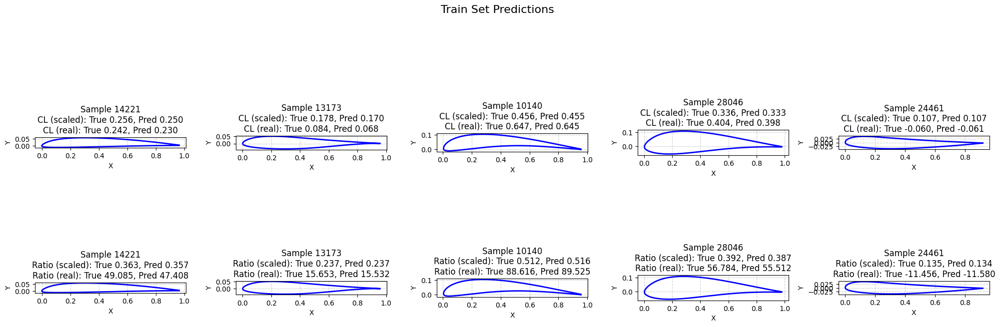

=== ResidualV1_Best: Grid Plot (Test) ===


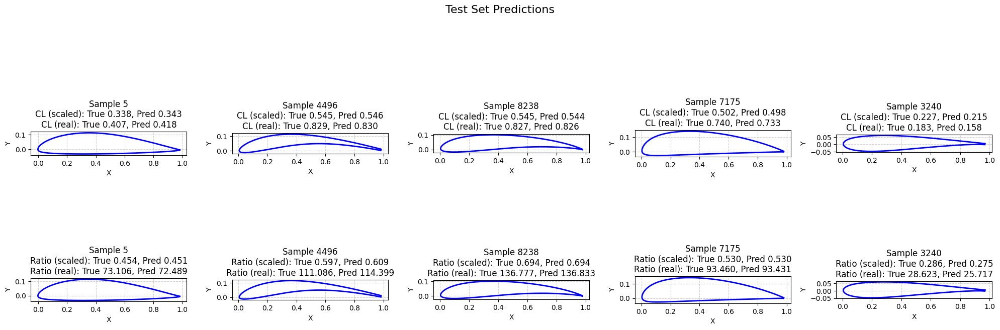

=== ResidualV1_Best: 200-sample line plot (Train) ===


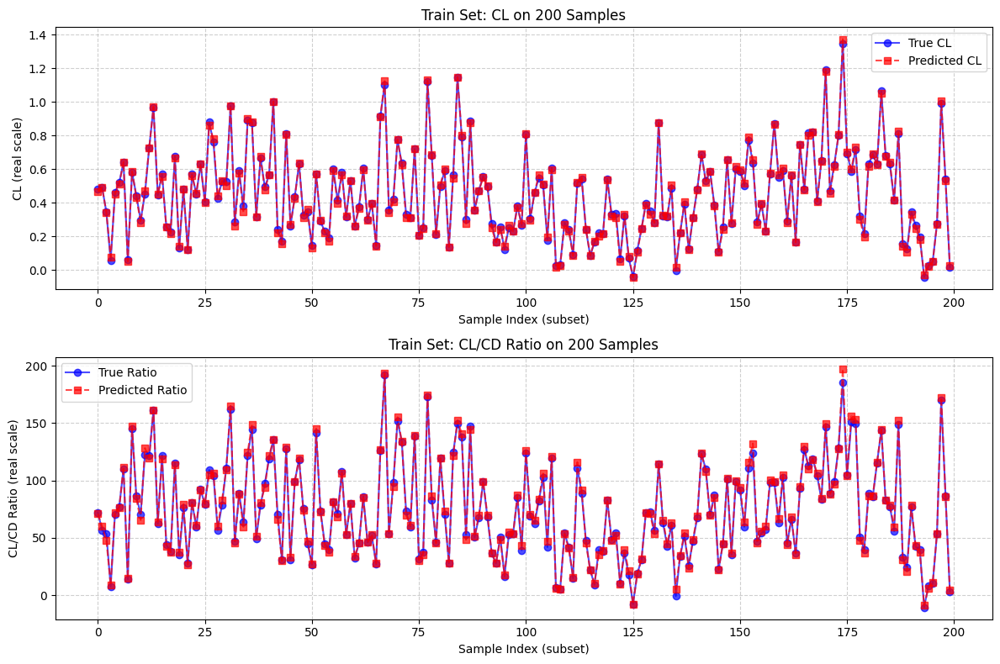

=== ResidualV1_Best: 200-sample line plot (Test) ===


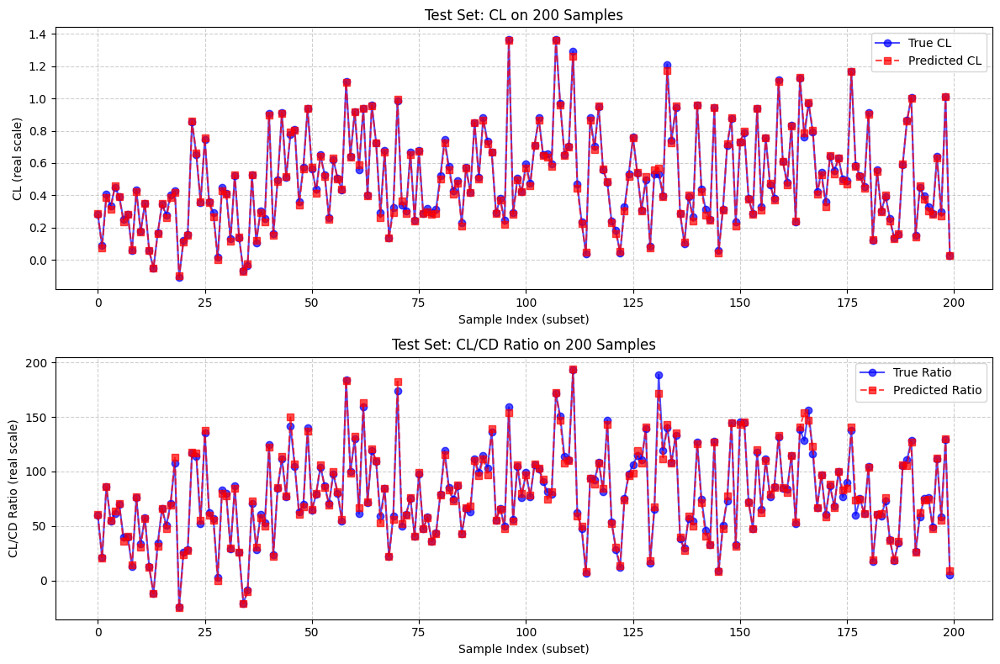


=== ResidualV1_Final: Grid Plot (Train) ===


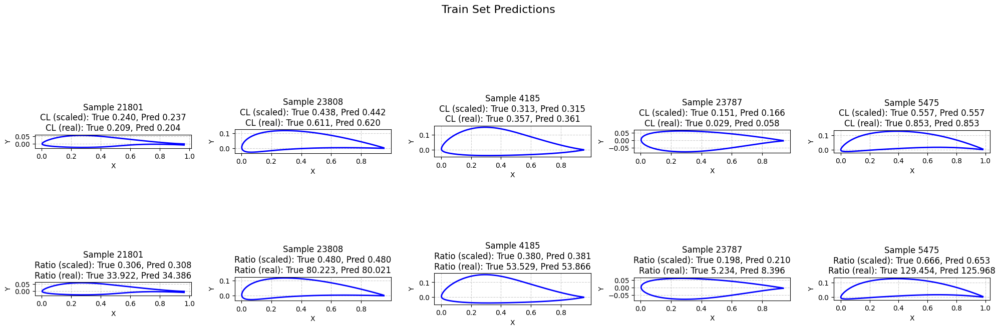

=== ResidualV1_Final: Grid Plot (Test) ===


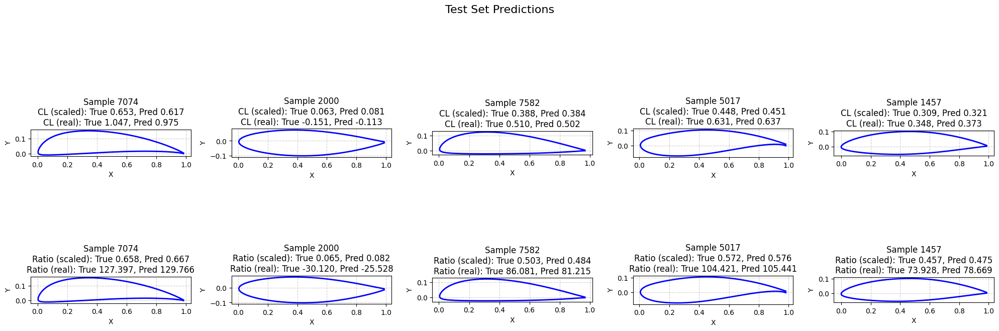

=== ResidualV1_Final: 200-sample line plot (Train) ===


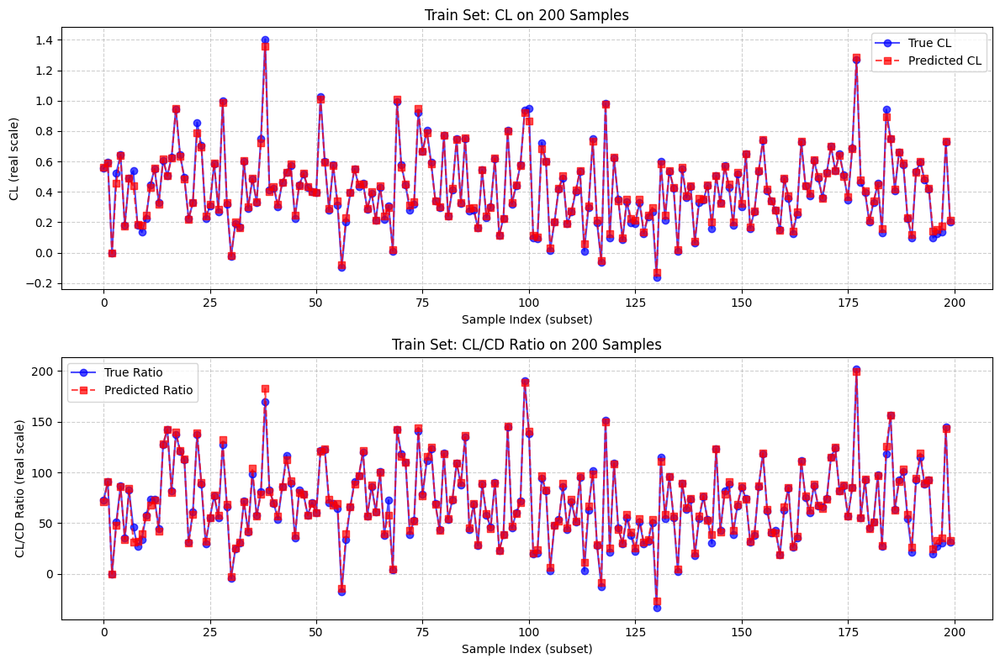

=== ResidualV1_Final: 200-sample line plot (Test) ===


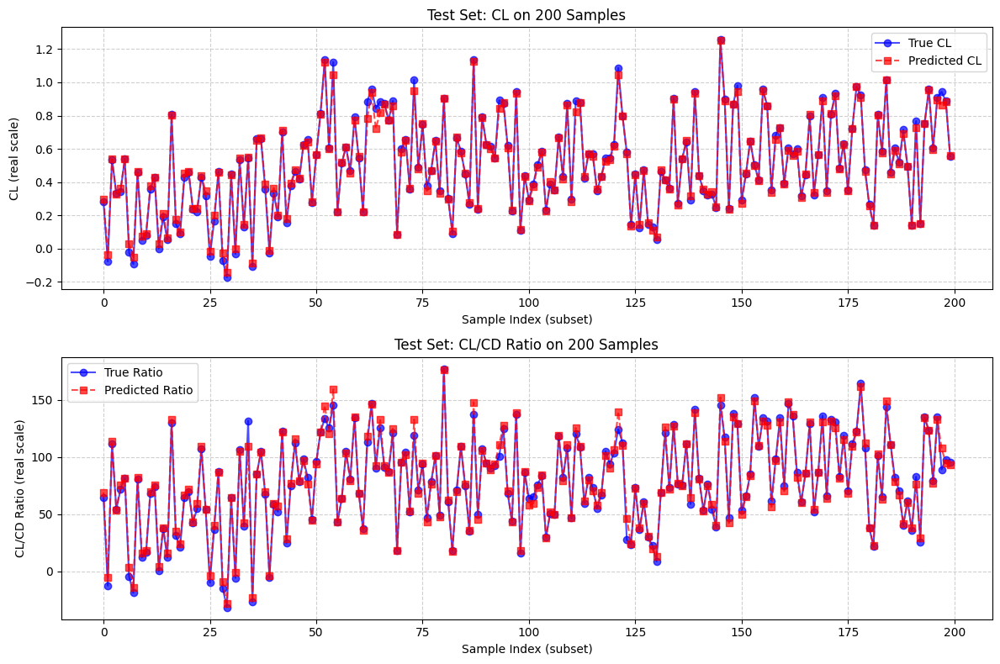


=== MLP_Best: Grid Plot (Train) ===


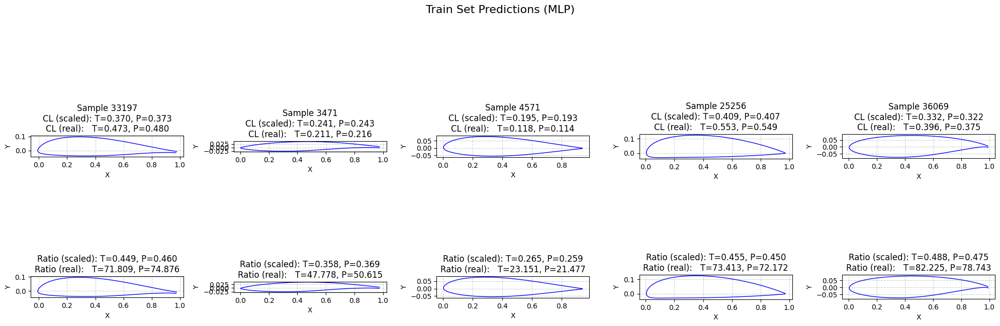

=== MLP_Best: Grid Plot (Test) ===


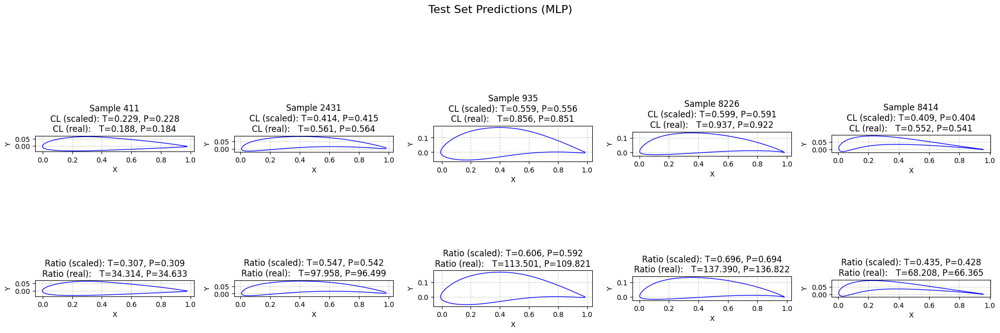

=== MLP_Best: 200-sample line plot (Train) ===


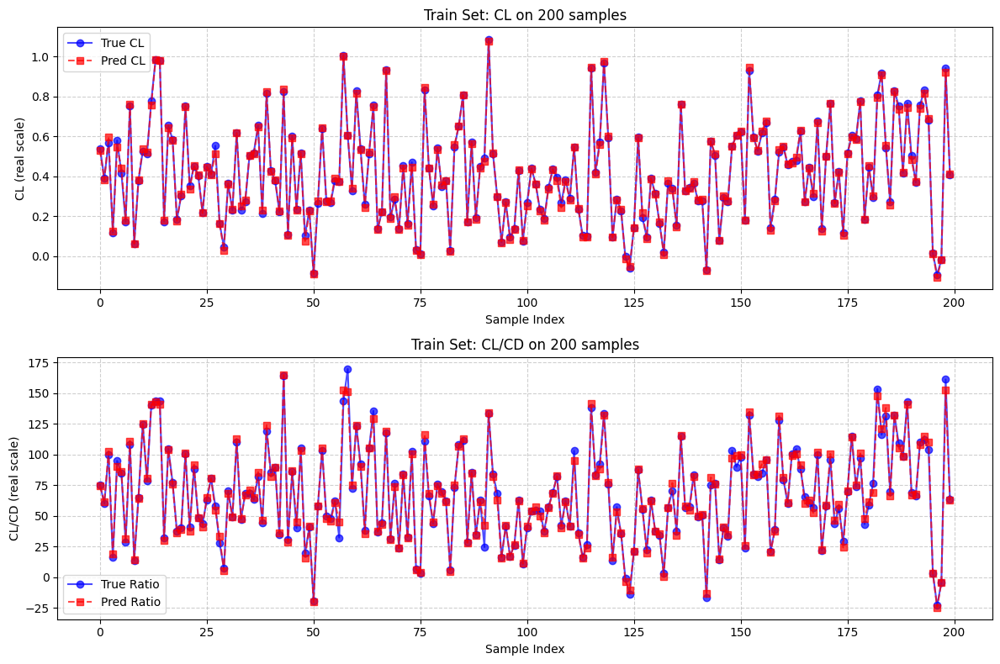

=== MLP_Best: 200-sample line plot (Test) ===


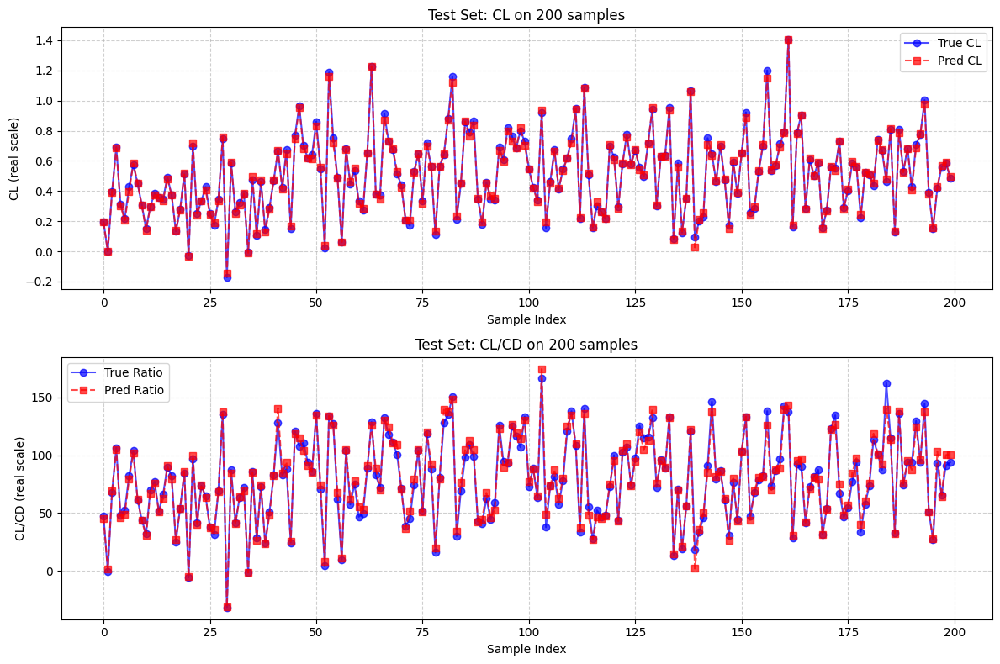


=== MLP_Final: Grid Plot (Train) ===


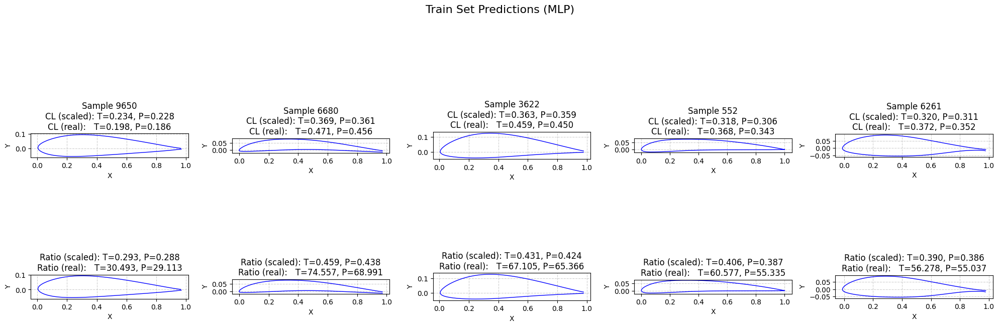

=== MLP_Final: Grid Plot (Test) ===


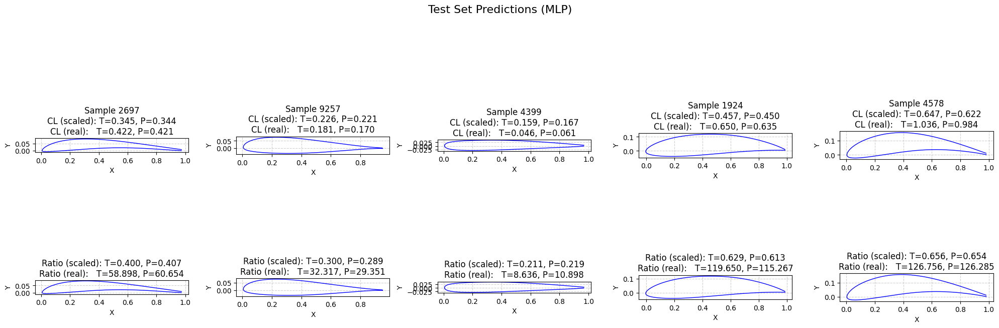

=== MLP_Final: 200-sample line plot (Train) ===


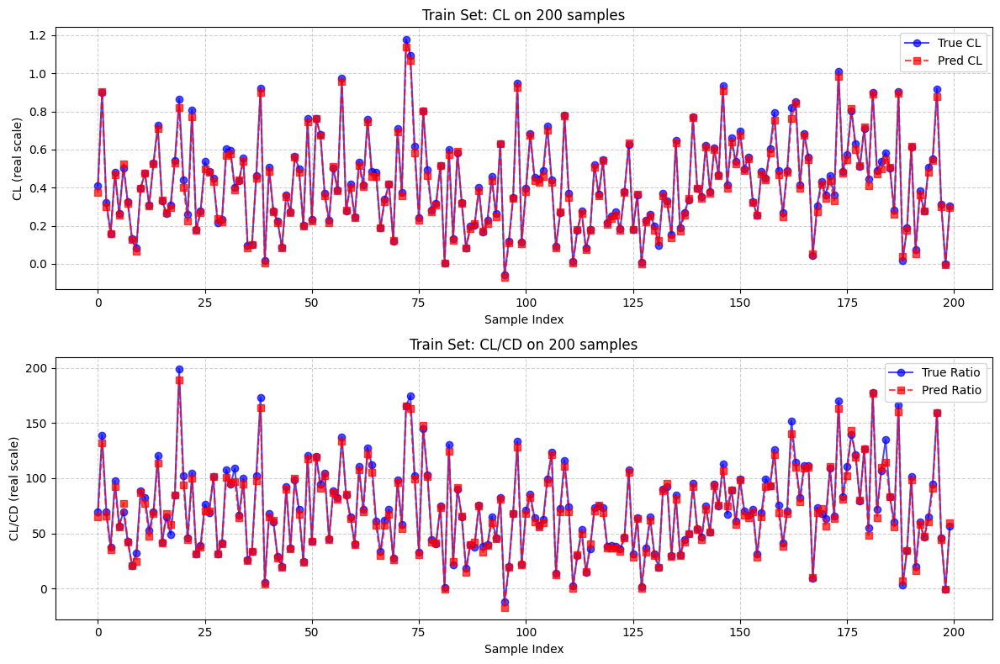

=== MLP_Final: 200-sample line plot (Test) ===


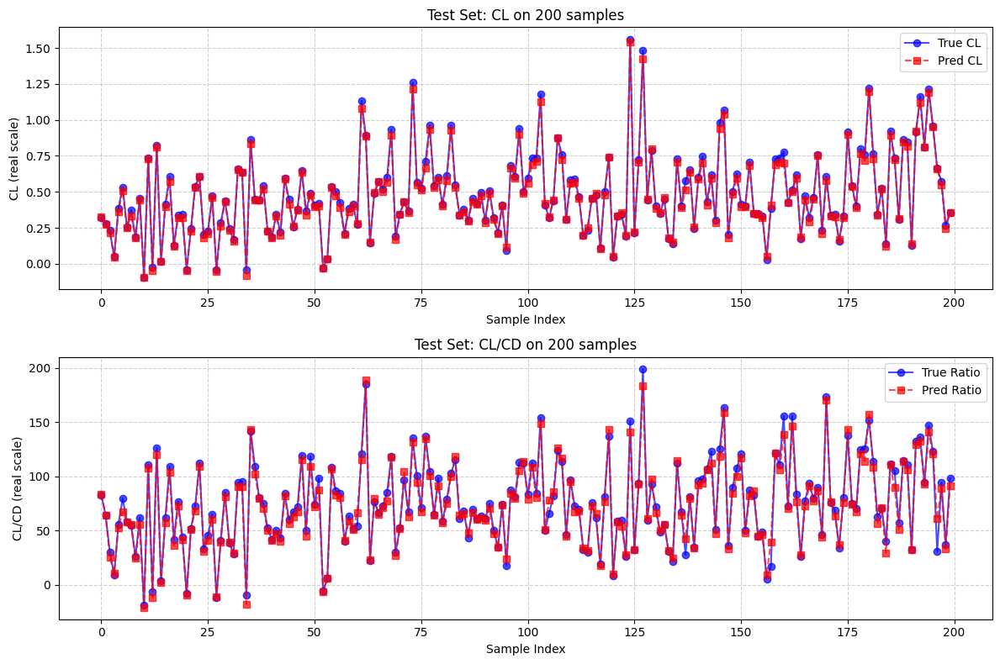

In [ ]:
##############################################
## 5) Visualization for Each Model & Dataset
##############################################

# A) ResidualV1_Best
print("\n=== ResidualV1_Best: Grid Plot (Train) ===")
visualize_predictions_grid(residv1_best_model, resid_train_dataset, resid_device, set_name="Train")
print("=== ResidualV1_Best: Grid Plot (Test) ===")
visualize_predictions_grid(residv1_best_model, resid_test_dataset,  resid_device, set_name="Test")

print("=== ResidualV1_Best: 200-sample line plot (Train) ===")
plot_small_subset_predictions(residv1_best_model, resid_train_dataset, resid_device, sample_count=200, set_name="Train")
print("=== ResidualV1_Best: 200-sample line plot (Test) ===")
plot_small_subset_predictions(residv1_best_model, resid_test_dataset,  resid_device, sample_count=200, set_name="Test")

# B) ResidualV1_Final
print("\n=== ResidualV1_Final: Grid Plot (Train) ===")
visualize_predictions_grid(residv1_final_model, resid_train_dataset, resid_device, set_name="Train")
print("=== ResidualV1_Final: Grid Plot (Test) ===")
visualize_predictions_grid(residv1_final_model, resid_test_dataset,  resid_device, set_name="Test")

print("=== ResidualV1_Final: 200-sample line plot (Train) ===")
plot_small_subset_predictions(residv1_final_model, resid_train_dataset, resid_device, sample_count=200, set_name="Train")
print("=== ResidualV1_Final: 200-sample line plot (Test) ===")
plot_small_subset_predictions(residv1_final_model, resid_test_dataset,  resid_device, sample_count=200, set_name="Test")

# C) MLP_Best
print("\n=== MLP_Best: Grid Plot (Train) ===")
visualize_predictions_grid_mlp(mlp_best_model, mlp_train_dataset, mlp_y_min, mlp_y_max, mlp_device, set_name="Train")
print("=== MLP_Best: Grid Plot (Test) ===")
visualize_predictions_grid_mlp(mlp_best_model, mlp_test_dataset,  mlp_y_min, mlp_y_max, mlp_device, set_name="Test")

print("=== MLP_Best: 200-sample line plot (Train) ===")
plot_small_subset_predictions_mlp(mlp_best_model, mlp_train_dataset, mlp_y_min, mlp_y_max, mlp_device,
                                  sample_count=200, set_name="Train")
print("=== MLP_Best: 200-sample line plot (Test) ===")
plot_small_subset_predictions_mlp(mlp_best_model, mlp_test_dataset,  mlp_y_min, mlp_y_max, mlp_device, sample_count=200, set_name="Test")

# D) MLP_Final
print("\n=== MLP_Final: Grid Plot (Train) ===")
visualize_predictions_grid_mlp(mlp_final_model, mlp_train_dataset, mlp_y_min, mlp_y_max, mlp_device, set_name="Train")
print("=== MLP_Final: Grid Plot (Test) ===")
visualize_predictions_grid_mlp(mlp_final_model, mlp_test_dataset,  mlp_y_min, mlp_y_max, mlp_device, set_name="Test")

print("=== MLP_Final: 200-sample line plot (Train) ===")
plot_small_subset_predictions_mlp(mlp_final_model, mlp_train_dataset, mlp_y_min, mlp_y_max, mlp_device,
                                  sample_count=200, set_name="Train")
print("=== MLP_Final: 200-sample line plot (Test) ===")
plot_small_subset_predictions_mlp(mlp_final_model, mlp_test_dataset,  mlp_y_min, mlp_y_max, mlp_device, sample_count=200, set_name="Test")


## VAE

In [ ]:
import torch
import torch.nn as nn

class DownBlock1D(nn.Module):
    r"""
    1D version of your Down conv block with attention.

    Sequence of steps for each "layer" in this block:
      1. ResNet block with optional time embedding addition
      2. Optional self-attention
      3. Optional cross-attention
    After all layers, if down_sample=True, we apply a 1D down-convolution (stride=2).

    Args:
      in_channels (int): Number of input channels.
      out_channels (int): Number of output channels.
      t_emb_dim (int): Dimensionality of the time-embedding (if used). Pass None if not used.
      down_sample (bool): Whether to apply a strided down-conv at the end.
      num_heads (int): Number of attention heads if attention is used.
      num_layers (int): How many internal ResNet+Attn sub-blocks exist in this stage.
      attn (bool): Whether to use self-attention.
      norm_channels (int): Number of groups for GroupNorm.
      cross_attn (bool): Whether to use cross-attention.
      context_dim (int): Dimensionality of context for cross-attention (only if cross_attn=True).
    """
    def __init__(
        self,
        in_channels,
        out_channels,
        t_emb_dim,
        down_sample,
        num_heads,
        num_layers,
        attn,
        norm_channels,
        cross_attn=False,
        context_dim=None
    ):
        super().__init__()
        self.num_layers = num_layers
        self.down_sample = down_sample
        self.attn = attn
        self.context_dim = context_dim
        self.cross_attn = cross_attn
        self.t_emb_dim = t_emb_dim

        # --------------------------
        # ResNet-like blocks (Conv1d)
        # --------------------------
        # For each layer:
        #   - "resnet_conv_first[i]": GroupNorm -> SiLU -> Conv1d
        #   - optional time embedding projection
        #   - "resnet_conv_second[i]": GroupNorm -> SiLU -> Conv1d
        #   - residual skip conv (1x1)
        self.resnet_conv_first = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, in_channels if i == 0 else out_channels),
                nn.SiLU(),
                nn.Conv1d(in_channels if i == 0 else out_channels,
                          out_channels,
                          kernel_size=3,
                          stride=1,
                          padding=1),
            )
            for i in range(num_layers)
        ])

        if self.t_emb_dim is not None:
            self.t_emb_layers = nn.ModuleList([
                nn.Sequential(
                    nn.SiLU(),
                    nn.Linear(self.t_emb_dim, out_channels)
                )
                for _ in range(num_layers)
            ])

        self.resnet_conv_second = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, out_channels),
                nn.SiLU(),
                nn.Conv1d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            )
            for _ in range(num_layers)
        ])

        self.residual_input_conv = nn.ModuleList([
            nn.Conv1d(in_channels if i == 0 else out_channels,
                      out_channels,
                      kernel_size=1)
            for i in range(num_layers)
        ])

        # -------------
        # Self-Attention
        # -------------
        if self.attn:
            self.attention_norms = nn.ModuleList([
                nn.GroupNorm(norm_channels, out_channels)
                for _ in range(num_layers)
            ])
            self.attentions = nn.ModuleList([
                nn.MultiheadAttention(
                    embed_dim=out_channels,
                    num_heads=num_heads,
                    batch_first=True
                )
                for _ in range(num_layers)
            ])

        # ---------------
        # Cross-Attention
        # ---------------
        if self.cross_attn:
            assert context_dim is not None, "You must pass context_dim for cross-attention."
            self.cross_attention_norms = nn.ModuleList([
                nn.GroupNorm(norm_channels, out_channels)
                for _ in range(num_layers)
            ])
            self.cross_attentions = nn.ModuleList([
                nn.MultiheadAttention(
                    embed_dim=out_channels,
                    num_heads=num_heads,
                    batch_first=True
                )
                for _ in range(num_layers)
            ])
            self.context_proj = nn.ModuleList([
                nn.Linear(context_dim, out_channels)
                for _ in range(num_layers)
            ])

        # -----------
        # Downsample
        # -----------
        # If down_sample=True, we use a strided conv1d (kernel_size=4, stride=2, padding=1).
        self.down_sample_conv = (
            nn.Conv1d(out_channels, out_channels, kernel_size=4, stride=2, padding=1)
            if down_sample else
            nn.Identity()
        )

    def forward(self, x, t_emb=None, context=None):
        """
        x: (batch, in_channels, length)
        t_emb: (batch, t_emb_dim) or None
        context: (batch, seq_len, context_dim) if cross-attn is used, else None
        """
        out = x
        for i in range(self.num_layers):
            # 1) First half of ResNet block
            res_input = out
            out = self.resnet_conv_first[i](out)

            # -- Optional time embedding addition --
            if self.t_emb_dim is not None and t_emb is not None:
                # out shape: (batch, out_channels, length)
                # t_emb_layers[i](t_emb) shape: (batch, out_channels)
                # we broadcast along the length dimension
                out = out + self.t_emb_layers[i](t_emb)[:, :, None]

            # 2) Second half of ResNet block
            out = self.resnet_conv_second[i](out)
            # Add residual via 1x1 conv
            out = out + self.residual_input_conv[i](res_input)

            # 3) Optional self-attention
            if self.attn:
                # out shape: (batch, out_channels, length)
                # GroupNorm expects (N, C, L), so we can feed directly:
                attn_input = self.attention_norms[i](out)
                # For MultiheadAttention with batch_first=True, we want (N, length, channels).
                attn_input = attn_input.transpose(1, 2)  # (batch, length, out_channels)
                out_attn, _ = self.attentions[i](attn_input, attn_input, attn_input)
                # Reshape back to (batch, out_channels, length)
                out_attn = out_attn.transpose(1, 2)
                out = out + out_attn

            # 4) Optional cross-attention
            if self.cross_attn:
                # 'out' -> groupnorm -> (batch, length, out_channels)
                cross_input = self.cross_attention_norms[i](out)
                cross_input = cross_input.transpose(1, 2)  # (batch, length, out_channels)

                assert context is not None, (
                    "You must supply 'context' if cross_attn is True."
                )
                # Project context to same dim as 'out'
                # context shape: (batch, context_seq_len, context_dim)
                context_proj = self.context_proj[i](context)  # (batch, context_seq_len, out_channels)

                out_cross, _ = self.cross_attentions[i](
                    cross_input,  # Q
                    context_proj, # K
                    context_proj  # V
                )
                out_cross = out_cross.transpose(1, 2)
                out = out + out_cross

        # 5) Downsample if requested
        out = self.down_sample_conv(out)
        return out



class MidBlock1D(nn.Module):
    r"""
    Mid conv block (1D) with attention.
    Sequence of blocks:
      1) Initial ResNet block with time embedding
      2) Then, for each of 'num_layers':
         - Self-attention block
         - (Optionally) cross-attention block
         - Another ResNet block with time embedding

    Args:
      in_channels (int): Number of input channels.
      out_channels (int): Number of output channels.
      t_emb_dim (int): Dimensionality of the time-embedding (or None if not used).
      num_heads (int): Number of heads in multi-head attention.
      num_layers (int): How many times we apply [Attn + CrossAttn + ResNet].
      norm_channels (int): Number of groups for GroupNorm.
      cross_attn (bool): Whether to enable cross-attention.
      context_dim (int): Dim of external context for cross-attention.
    """
    def __init__(
        self,
        in_channels,
        out_channels,
        t_emb_dim,
        num_heads,
        num_layers,
        norm_channels,
        cross_attn=False,
        context_dim=None
    ):
        super().__init__()
        self.num_layers = num_layers
        self.t_emb_dim = t_emb_dim
        self.context_dim = context_dim
        self.cross_attn = cross_attn

        # --------------------------
        # 1) ResNet-like layers (Conv1d)
        #    Each "layer" here is a pair of conv blocks: conv_first[i], conv_second[i]
        #    plus a residual skip "residual_input_conv[i]".
        # We have (num_layers + 1) because we do one extra block at the start.
        # --------------------------
        self.resnet_conv_first = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, in_channels if i == 0 else out_channels),
                nn.SiLU(),
                nn.Conv1d(in_channels if i == 0 else out_channels,
                          out_channels,
                          kernel_size=3,
                          stride=1,
                          padding=1),
            )
            for i in range(num_layers + 1)
        ])

        if self.t_emb_dim is not None:
            self.t_emb_layers = nn.ModuleList([
                nn.Sequential(
                    nn.SiLU(),
                    nn.Linear(t_emb_dim, out_channels)
                )
                for _ in range(num_layers + 1)
            ])

        self.resnet_conv_second = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, out_channels),
                nn.SiLU(),
                nn.Conv1d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            )
            for _ in range(num_layers + 1)
        ])

        self.residual_input_conv = nn.ModuleList([
            nn.Conv1d(in_channels if i == 0 else out_channels,
                      out_channels,
                      kernel_size=1)
            for i in range(num_layers + 1)
        ])

        # --------------------------
        # 2) Self-Attention Layers
        # --------------------------
        # We'll have "num_layers" of attention blocks in the loop (not num_layers+1).
        self.attention_norms = nn.ModuleList([
            nn.GroupNorm(norm_channels, out_channels)
            for _ in range(num_layers)
        ])
        self.attentions = nn.ModuleList([
            nn.MultiheadAttention(
                embed_dim=out_channels,
                num_heads=num_heads,
                batch_first=True
            )
            for _ in range(num_layers)
        ])

        # --------------------------
        # 3) Optional Cross-Attention
        # --------------------------
        if self.cross_attn:
            assert context_dim is not None, "Must provide context_dim if cross_attn=True."
            self.cross_attention_norms = nn.ModuleList([
                nn.GroupNorm(norm_channels, out_channels)
                for _ in range(num_layers)
            ])
            self.cross_attentions = nn.ModuleList([
                nn.MultiheadAttention(
                    embed_dim=out_channels,
                    num_heads=num_heads,
                    batch_first=True
                )
                for _ in range(num_layers)
            ])
            self.context_proj = nn.ModuleList([
                nn.Linear(context_dim, out_channels)
                for _ in range(num_layers)
            ])

    def forward(self, x, t_emb=None, context=None):
        """
        x:       (batch, in_channels, length)
        t_emb:   (batch, t_emb_dim) or None
        context: (batch, context_seq_len, context_dim), if cross_attn=True
        """
        out = x

        # --------------------------------------------------
        #  (A) First ResNet Block (index 0)
        # --------------------------------------------------
        res_in = out
        out = self.resnet_conv_first[0](out)
        if self.t_emb_dim is not None and t_emb is not None:
            out = out + self.t_emb_layers[0](t_emb)[:, :, None]  # shape => (batch, out_channels, length)
        out = self.resnet_conv_second[0](out)
        out = out + self.residual_input_conv[0](res_in)

        # --------------------------------------------------
        #  (B) For each of the num_layers:
        #      - Self-attention
        #      - Cross-attention (optional)
        #      - Another ResNet block
        # --------------------------------------------------
        for i in range(self.num_layers):
            # --- (B1) Self-Attention ---
            # out shape: (batch, out_channels, length)
            attn_input = self.attention_norms[i](out)         # GroupNorm over (N, C, L)
            attn_input = attn_input.transpose(1, 2)           # => (N, L, C) for MultiheadAttention w/ batch_first=True
            out_attn, _ = self.attentions[i](attn_input, attn_input, attn_input)
            out_attn = out_attn.transpose(1, 2)               # => (N, C, L)
            out = out + out_attn

            # --- (B2) Cross-Attention (if enabled) ---
            if self.cross_attn:
                assert context is not None, "Context must be provided if cross_attn=True."
                cross_input = self.cross_attention_norms[i](out)
                cross_input = cross_input.transpose(1, 2)  # (N, L, C)

                # Project the context to match out_channels
                context_proj = self.context_proj[i](context)  # (N, context_seq_len, out_channels)

                out_cross, _ = self.cross_attentions[i](
                    cross_input,    # Q
                    context_proj,   # K
                    context_proj    # V
                )
                out_cross = out_cross.transpose(1, 2)  # back to (N, C, L)
                out = out + out_cross

            # --- (B3) ResNet Block ---
            res_in = out
            out = self.resnet_conv_first[i + 1](out)
            if self.t_emb_dim is not None and t_emb is not None:
                out = out + self.t_emb_layers[i + 1](t_emb)[:, :, None]
            out = self.resnet_conv_second[i + 1](out)
            out = out + self.residual_input_conv[i + 1](res_in)

        return out



class UpBlock1D(nn.Module):
    r"""
    1D Up conv block with attention.

    Sequence of steps:
      1. Upsample (ConvTranspose1d) if up_sample=True
      2. (Optional) Concatenate skip-connection from down block: (x, out_down)
      3. For each layer (num_layers):
         - ResNet block with optional time embedding
         - Optional self-attention
    """

    def __init__(
        self,
        in_channels,
        out_channels,
        t_emb_dim,
        up_sample,
        num_heads,
        num_layers,
        attn,
        norm_channels
    ):
        super().__init__()
        self.num_layers = num_layers
        self.up_sample = up_sample
        self.t_emb_dim = t_emb_dim
        self.attn = attn

        # ------------------------------------
        # 1) ResNet-like Convs (Conv1d)
        # ------------------------------------
        # We'll do "num_layers" sets of:
        #   conv_first[i] -> (optionally add time embedding) -> conv_second[i] -> residual
        self.resnet_conv_first = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, in_channels if i == 0 else out_channels),
                nn.SiLU(),
                nn.Conv1d(
                    in_channels if i == 0 else out_channels,
                    out_channels,
                    kernel_size=3,
                    stride=1,
                    padding=1
                )
            )
            for i in range(num_layers)
        ])

        if self.t_emb_dim is not None:
            self.t_emb_layers = nn.ModuleList([
                nn.Sequential(
                    nn.SiLU(),
                    nn.Linear(t_emb_dim, out_channels)
                )
                for _ in range(num_layers)
            ])

        self.resnet_conv_second = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, out_channels),
                nn.SiLU(),
                nn.Conv1d(out_channels, out_channels, kernel_size=3, stride=1, padding=1),
            )
            for _ in range(num_layers)
        ])

        self.residual_input_conv = nn.ModuleList([
            nn.Conv1d(in_channels if i == 0 else out_channels, out_channels, kernel_size=1)
            for i in range(num_layers)
        ])

        # ------------------------------------
        # 2) Self-Attention (Optional)
        # ------------------------------------
        if self.attn:
            self.attention_norms = nn.ModuleList([
                nn.GroupNorm(norm_channels, out_channels)
                for _ in range(num_layers)
            ])
            self.attentions = nn.ModuleList([
                nn.MultiheadAttention(
                    embed_dim=out_channels,
                    num_heads=num_heads,
                    batch_first=True
                )
                for _ in range(num_layers)
            ])

        # ------------------------------------
        # 3) Upsampling
        # ------------------------------------
        # If up_sample=True, use strided ConvTranspose1d.
        self.up_sample_conv = (
            nn.ConvTranspose1d(in_channels, in_channels, kernel_size=4, stride=2, padding=1)
            if up_sample else
            nn.Identity()
        )

    def forward(self, x, out_down=None, t_emb=None):
        """
        x: (batch, in_channels, length)   - features from the previous layer
        out_down: (batch, skip_channels, skip_length) or None
                  - features from the corresponding DownBlock (skip-connection)
        t_emb: (batch, t_emb_dim) or None - optional time embedding
        """
        # 1) Upsample (if enabled)
        x = self.up_sample_conv(x)

        # 2) Concatenate skip-connection
        if out_down is not None:
            x = torch.cat([x, out_down], dim=1)  # Concat along channels

        out = x
        # 3) For each of the num_layers: ResNet block + (optional) self-attention
        for i in range(self.num_layers):
            # --- ResNet block ---
            res_input = out
            out = self.resnet_conv_first[i](out)

            if self.t_emb_dim is not None and t_emb is not None:
                out = out + self.t_emb_layers[i](t_emb)[:, :, None]  # broadcast over length

            out = self.resnet_conv_second[i](out)
            out = out + self.residual_input_conv[i](res_input)

            # --- Self-attention (optional) ---
            if self.attn:
                # out shape: (batch, channels, length)
                attn_input = self.attention_norms[i](out)
                attn_input = attn_input.transpose(1, 2)  # => (batch, length, channels)
                out_attn, _ = self.attentions[i](attn_input, attn_input, attn_input)
                out_attn = out_attn.transpose(1, 2)     # => (batch, channels, length)
                out = out + out_attn

        return out


class UpBlockUnet1D(nn.Module):
    r"""
    1D Up conv block with optional cross-attention.
    Sequence of steps:
      1) Upsample (optional) via ConvTranspose1d
      2) Concatenate skip-connection from a down block
      3) For each layer in num_layers:
         - ResNet block (with optional time embedding)
         - Self-Attention
         - (Optional) Cross-Attention
    """

    def __init__(
        self,
        in_channels,
        out_channels,
        t_emb_dim,
        up_sample,
        num_heads,
        num_layers,
        norm_channels,
        cross_attn=False,
        context_dim=None
    ):
        super().__init__()
        self.num_layers = num_layers
        self.up_sample = up_sample
        self.t_emb_dim = t_emb_dim
        self.cross_attn = cross_attn
        self.context_dim = context_dim

        # -------------------------
        # 1) ResNet-like Conv1d blocks
        # -------------------------
        self.resnet_conv_first = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, in_channels if i == 0 else out_channels),
                nn.SiLU(),
                nn.Conv1d(
                    in_channels if i == 0 else out_channels,
                    out_channels,
                    kernel_size=3,
                    stride=1,
                    padding=1
                )
            )
            for i in range(num_layers)
        ])

        if self.t_emb_dim is not None:
            self.t_emb_layers = nn.ModuleList([
                nn.Sequential(
                    nn.SiLU(),
                    nn.Linear(t_emb_dim, out_channels)
                )
                for _ in range(num_layers)
            ])

        self.resnet_conv_second = nn.ModuleList([
            nn.Sequential(
                nn.GroupNorm(norm_channels, out_channels),
                nn.SiLU(),
                nn.Conv1d(out_channels, out_channels, kernel_size=3, stride=1, padding=1)
            )
            for _ in range(num_layers)
        ])

        # Residual 1x1 conv to match channels
        self.residual_input_conv = nn.ModuleList([
            nn.Conv1d(in_channels if i == 0 else out_channels, out_channels, kernel_size=1)
            for i in range(num_layers)
        ])

        # -------------------------
        # 2) Attention blocks
        # -------------------------
        self.attention_norms = nn.ModuleList([
            nn.GroupNorm(norm_channels, out_channels)
            for _ in range(num_layers)
        ])
        self.attentions = nn.ModuleList([
            nn.MultiheadAttention(
                embed_dim=out_channels,
                num_heads=num_heads,
                batch_first=True
            )
            for _ in range(num_layers)
        ])

        # Cross Attention (if enabled)
        if self.cross_attn:
            assert context_dim is not None, "Context dimension must be provided for cross-attention."
            self.cross_attention_norms = nn.ModuleList([
                nn.GroupNorm(norm_channels, out_channels)
                for _ in range(num_layers)
            ])
            self.cross_attentions = nn.ModuleList([
                nn.MultiheadAttention(
                    embed_dim=out_channels,
                    num_heads=num_heads,
                    batch_first=True
                )
                for _ in range(num_layers)
            ])
            self.context_proj = nn.ModuleList([
                nn.Linear(context_dim, out_channels)
                for _ in range(num_layers)
            ])

        # -------------------------
        # 3) Upsample
        # -------------------------
        # Note: the original code does a factor of 2 upsample using in_channels//2, in_channels//2.
        # You may adjust if your channel counts differ in 1D usage.
        self.up_sample_conv = (
            nn.ConvTranspose1d(
                in_channels // 2,
                in_channels // 2,
                kernel_size=4,
                stride=2,
                padding=1
            )
            if up_sample else
            nn.Identity()
        )

    def forward(self, x, out_down=None, t_emb=None, context=None):
        """
        Args:
          x:        (batch, in_channels//2, length) => output from previous block
          out_down: (batch, skip_channels, skip_length) => skip-connection from the down block
          t_emb:    (batch, t_emb_dim) => time embedding or None
          context:  (batch, context_seq_len, context_dim) => cross-attention context or None
        Returns:
          out: (batch, out_channels, length_out)
        """
        # 1) Upsample
        x = self.up_sample_conv(x)

        # 2) Concatenate skip-connection
        if out_down is not None:
            x = torch.cat([x, out_down], dim=1)  # channel dimension

        out = x
        # 3) Apply ResNet + Attention blocks
        for i in range(self.num_layers):
            # ---- ResNet block ----
            res_in = out
            out = self.resnet_conv_first[i](out)

            if self.t_emb_dim is not None and t_emb is not None:
                out = out + self.t_emb_layers[i](t_emb)[:, :, None]

            out = self.resnet_conv_second[i](out)
            out = out + self.residual_input_conv[i](res_in)

            # ---- Self-Attention ----
            # shape: (batch, channels, length)
            attn_in = self.attention_norms[i](out)
            # MHA expects (batch, seq_len, channels) with batch_first=True
            attn_in = attn_in.transpose(1, 2)
            out_attn, _ = self.attentions[i](attn_in, attn_in, attn_in)
            out_attn = out_attn.transpose(1, 2)
            out = out + out_attn

            # ---- Cross-Attention (if enabled) ----
            if self.cross_attn:
                assert context is not None, (
                    "Context cannot be None if cross attention layers are used."
                )
                cross_in = self.cross_attention_norms[i](out).transpose(1, 2)  # (batch, length, channels)
                # Project the context to match out_channels
                context_proj = self.context_proj[i](context)  # (batch, context_seq_len, out_channels)
                out_cross, _ = self.cross_attentions[i](cross_in, context_proj, context_proj)
                out_cross = out_cross.transpose(1, 2)
                out = out + out_cross

        return out


In [ ]:

# import torch
# import torch.nn as nn


# class Discriminator(nn.Module):
#     r"""
#     PatchGAN Discriminator.
#     Rather than taking IMG_CHANNELSxIMG_HxIMG_W all the way to
#     1 scalar value , we instead predict grid of values.
#     Where each grid is prediction of how likely
#     the discriminator thinks that the image patch corresponding
#     to the grid cell is real
#     """

#     def __init__(self, im_channels=2,
#                  conv_channels=[64, 128, 256],
#                  kernels=[4,4,4,4],
#                  strides=[2,2,2,1],
#                  paddings=[1,1,1,1]):
#         super().__init__()
#         self.im_channels = im_channels
#         activation = nn.LeakyReLU(0.2)
#         layers_dim = [self.im_channels] + conv_channels + [1]
#         self.layers = nn.ModuleList([
#             nn.Sequential(
#                 nn.Conv1d(layers_dim[i], layers_dim[i + 1],
#                           kernel_size=kernels[i],
#                           stride=strides[i],
#                           padding=paddings[i],
#                           bias=False if i !=0 else True),
#                 nn.BatchNorm1d(layers_dim[i + 1]) if i != len(layers_dim) - 2 and i != 0 else nn.Identity(),
#                 activation if i != len(layers_dim) - 2 else nn.Identity()
#             )
#             for i in range(len(layers_dim) - 1)
#         ])

#     def forward(self, x):
#         out = x
#         for layer in self.layers:
#             out = layer(out)
#         return out


# if __name__ == '__main__':
#     x = torch.randn((2, 2, 192))
#     prob = Discriminator(im_channels=2)(x)
#     print(prob.shape)


In [ ]:
# from __future__ import absolute_import
# from collections import namedtuple
# import torch
# import torch.nn as nn
# import torch.nn.init as init
# from torch.autograd import Variable
# import numpy as np
# import torch.nn
# import torchvision

# # Taken from https://github.com/richzhang/PerceptualSimilarity/blob/master/lpips/lpips.py

# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# def spatial_average(in_tens, keepdim=True):
#     return in_tens.mean([2, 3], keepdim=keepdim)


# class vgg16(torch.nn.Module):
#     def __init__(self, requires_grad=False, pretrained=True):
#         super(vgg16, self).__init__()
#         # Load pretrained vgg model from torchvision
#         vgg_pretrained_features = torchvision.models.vgg16(pretrained=pretrained).features
#         self.slice1 = torch.nn.Sequential()
#         self.slice2 = torch.nn.Sequential()
#         self.slice3 = torch.nn.Sequential()
#         self.slice4 = torch.nn.Sequential()
#         self.slice5 = torch.nn.Sequential()
#         self.N_slices = 5
#         for x in range(4):
#             self.slice1.add_module(str(x), vgg_pretrained_features[x])
#         for x in range(4, 9):
#             self.slice2.add_module(str(x), vgg_pretrained_features[x])
#         for x in range(9, 16):
#             self.slice3.add_module(str(x), vgg_pretrained_features[x])
#         for x in range(16, 23):
#             self.slice4.add_module(str(x), vgg_pretrained_features[x])
#         for x in range(23, 30):
#             self.slice5.add_module(str(x), vgg_pretrained_features[x])

#         # Freeze vgg model
#         if not requires_grad:
#             for param in self.parameters():
#                 param.requires_grad = False

#     def forward(self, X):
#         # Return output of vgg features
#         h = self.slice1(X)
#         h_relu1_2 = h
#         h = self.slice2(h)
#         h_relu2_2 = h
#         h = self.slice3(h)
#         h_relu3_3 = h
#         h = self.slice4(h)
#         h_relu4_3 = h
#         h = self.slice5(h)
#         h_relu5_3 = h
#         vgg_outputs = namedtuple("VggOutputs", ['relu1_2', 'relu2_2', 'relu3_3', 'relu4_3', 'relu5_3'])
#         out = vgg_outputs(h_relu1_2, h_relu2_2, h_relu3_3, h_relu4_3, h_relu5_3)
#         return out


# # Learned perceptual metric
# class LPIPS(nn.Module):
#     def __init__(self, net='vgg', version='0.1', use_dropout=True, weights_path="/content/"):
#         super(LPIPS, self).__init__()
#         self.version = version
#         # Imagenet normalization
#         self.scaling_layer = ScalingLayer()
#         ########################

#         # Instantiate vgg model
#         self.chns = [64, 128, 256, 512, 512]
#         self.L = len(self.chns)
#         self.net = vgg16(pretrained=True, requires_grad=False)

#         # Add 1x1 convolutional Layers
#         self.lin0 = NetLinLayer(self.chns[0], use_dropout=use_dropout)
#         self.lin1 = NetLinLayer(self.chns[1], use_dropout=use_dropout)
#         self.lin2 = NetLinLayer(self.chns[2], use_dropout=use_dropout)
#         self.lin3 = NetLinLayer(self.chns[3], use_dropout=use_dropout)
#         self.lin4 = NetLinLayer(self.chns[4], use_dropout=use_dropout)
#         self.lins = [self.lin0, self.lin1, self.lin2, self.lin3, self.lin4]
#         self.lins = nn.ModuleList(self.lins)
#         ########################

#         model_path = weights_path  # Use the provided weights path
#         print('Loading model from: %s' % model_path)
#         self.load_state_dict(torch.load(model_path, map_location=device), strict=False)

#         # Load the weights of trained LPIPS model
#         # import inspect
#         # model_path = os.path.abspath(
#         #     os.path.join(inspect.getfile(self.__init__), '..', 'weights/v%s/%s.pth' % (version, net)))
#         # print('Loading model from: %s' % model_path)
#         # self.load_state_dict(torch.load(model_path, map_location=device), strict=False)
#         ########################

#         # Freeze all parameters
#         self.eval()
#         for param in self.parameters():
#             param.requires_grad = False
#         ########################

#     def forward(self, in0, in1, normalize=False):
#         # Scale the inputs to -1 to +1 range if needed
#         if normalize:  # turn on this flag if input is [0,1] so it can be adjusted to [-1, +1]
#             in0 = 2 * in0 - 1
#             in1 = 2 * in1 - 1
#         ########################

#         # Normalize the inputs according to imagenet normalization
#         in0_input, in1_input = self.scaling_layer(in0), self.scaling_layer(in1)
#         ########################

#         # Get VGG outputs for image0 and image1
#         outs0, outs1 = self.net.forward(in0_input), self.net.forward(in1_input)
#         feats0, feats1, diffs = {}, {}, {}
#         ########################

#         # Compute Square of Difference for each layer output
#         for kk in range(self.L):
#             feats0[kk], feats1[kk] = torch.nn.functional.normalize(outs0[kk], dim=1), torch.nn.functional.normalize(
#                 outs1[kk])
#             diffs[kk] = (feats0[kk] - feats1[kk]) ** 2
#         ########################

#         # 1x1 convolution followed by spatial average on the square differences
#         res = [spatial_average(self.lins[kk](diffs[kk]), keepdim=True) for kk in range(self.L)]
#         val = 0

#         # Aggregate the results of each layer
#         for l in range(self.L):
#             val += res[l]
#         return val


# class ScalingLayer(nn.Module):
#     def __init__(self):
#         super(ScalingLayer, self).__init__()
#         # Imagnet normalization for (0-1)
#         # mean = [0.485, 0.456, 0.406]
#         # std = [0.229, 0.224, 0.225]
#         self.register_buffer('shift', torch.Tensor([-.030, -.088, -.188])[None, :, None, None])
#         self.register_buffer('scale', torch.Tensor([.458, .448, .450])[None, :, None, None])

#     def forward(self, inp):
#         return (inp - self.shift) / self.scale


# class NetLinLayer(nn.Module):
#     ''' A single linear layer which does a 1x1 conv '''

#     def __init__(self, chn_in, chn_out=1, use_dropout=False):
#         super(NetLinLayer, self).__init__()

#         layers = [nn.Dropout(), ] if (use_dropout) else []
#         layers += [nn.Conv2d(chn_in, chn_out, 1, stride=1, padding=0, bias=False), ]
#         self.model = nn.Sequential(*layers)

#     def forward(self, x):
#         out = self.model(x)
#         return out


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class VAE1D(nn.Module):
    """
    A 1D VAE that uses DownBlock1D, MidBlock1D, UpBlock1D in the encoder–decoder.
    The code is adapted from the 2D version:
      - All Conv2d replaced with Conv1d
      - All GroupNorm/Conv shapes assume (batch, channels, length)
      - 2D padding (1,1) becomes 1D padding=1
      - 2D upsampling => ConvTranspose1d
    """
    def __init__(self, im_channels, model_config):
        super().__init__()
        # Model config parameters
        self.down_channels = model_config['down_channels']    # e.g. [32, 64, 128]
        self.mid_channels  = model_config['mid_channels']     # e.g. [128, 128]
        self.down_sample   = model_config['down_sample']      # e.g. [True, True]
        self.num_down_layers = model_config['num_down_layers'] # e.g. 1
        self.num_mid_layers  = model_config['num_mid_layers']  # e.g. 1
        self.num_up_layers   = model_config['num_up_layers']   # e.g. 1

        # To disable/enable attention in your Down/Up blocks
        self.attns = model_config['attn_down']                # e.g. [False, False]

        # Latent dimension
        self.z_channels   = model_config['z_channels']        # e.g. 16
        self.norm_channels = model_config['norm_channels']    # e.g. 32
        self.num_heads    = model_config['num_heads']         # e.g. 16

        # Some checks
        assert self.mid_channels[0] == self.down_channels[-1], \
            "mid_channels[0] must match the last down_channels"
        assert self.mid_channels[-1] == self.down_channels[-1], \
            "mid_channels[-1] must match the last down_channels"
        assert len(self.down_sample) == (len(self.down_channels) - 1), \
            "down_sample flags should be exactly one less than down_channels"
        assert len(self.attns) == (len(self.down_channels) - 1), \
            "attn_down length should match the number of down-sampling stages"

        # Generate the reversed up-sample flags for the decoder
        self.up_sample = list(reversed(self.down_sample))  # e.g. [True, True] -> [True, True]

        # -------------
        # Encoder
        # -------------
        # Initial 1D Conv: (im_channels -> down_channels[0])
        # Input shape is (batch, im_channels=2, length=192)
        self.encoder_conv_in = nn.Conv1d(
            in_channels=im_channels,
            out_channels=self.down_channels[0],
            kernel_size=3,
            padding=1
        )

        # Stack of DownBlock1D (and possibly mid-blocks after)
        # E.g. 2 stages if down_channels=[32,64,128] => i in [0,1]
        #   DownBlock1D(32->64), DownBlock1D(64->128)
        from_downblock1d = []
        for i in range(len(self.down_channels) - 1):
            from_downblock1d.append(
                DownBlock1D(
                    in_channels=self.down_channels[i],
                    out_channels=self.down_channels[i + 1],
                    t_emb_dim=None,
                    down_sample=self.down_sample[i],
                    num_heads=self.num_heads,
                    num_layers=self.num_down_layers,
                    attn=self.attns[i],
                    norm_channels=self.norm_channels
                )
            )
        self.encoder_layers = nn.ModuleList(from_downblock1d)

        # Mid-block(s)
        # e.g. mid_channels=[128,128], we do MidBlock1D(128->128)
        from_midblock1d_enc = []
        for i in range(len(self.mid_channels) - 1):
            from_midblock1d_enc.append(
                MidBlock1D(
                    in_channels=self.mid_channels[i],
                    out_channels=self.mid_channels[i + 1],
                    t_emb_dim=None,
                    num_heads=self.num_heads,
                    num_layers=self.num_mid_layers,
                    norm_channels=self.norm_channels
                )
            )
        self.encoder_mids = nn.ModuleList(from_midblock1d_enc)

        # Normalize & final conv to produce [mean, logvar]
        # After the final down_block (and mid_block), we have channels = down_channels[-1]
        self.encoder_norm_out = nn.GroupNorm(self.norm_channels, self.down_channels[-1])
        self.encoder_conv_out = nn.Conv1d(
            in_channels=self.down_channels[-1],
            out_channels=2 * self.z_channels,  # we produce mean + logvar
            kernel_size=3,
            padding=1
        )

        # 1×1 conv to get final 2*z_channels => shape remains (batch, 2*z_channels, length')
        self.pre_quant_conv = nn.Conv1d(2 * self.z_channels, 2 * self.z_channels, kernel_size=1)

        # -------------
        # Decoder
        # -------------
        # Post-quant conv from z_channels => z_channels
        self.post_quant_conv = nn.Conv1d(self.z_channels, self.z_channels, kernel_size=1)

        # Input to the decoder
        # mid_channels[-1] = last down_channels, so we do a 1D conv from z_channels -> that
        self.decoder_conv_in = nn.Conv1d(
            in_channels=self.z_channels,
            out_channels=self.mid_channels[-1],
            kernel_size=3,
            padding=1
        )

        # Mid-block(s) in reverse
        from_midblock1d_dec = []
        # If mid_channels=[128,128], that means one block from 128->128
        # reversed(range(1,2)) => range(1,2) is just [1], reversed is still [1], so we do a single block
        for i in reversed(range(1, len(self.mid_channels))):
            from_midblock1d_dec.append(
                MidBlock1D(
                    in_channels=self.mid_channels[i],
                    out_channels=self.mid_channels[i - 1],
                    t_emb_dim=None,
                    num_heads=self.num_heads,
                    num_layers=self.num_mid_layers,
                    norm_channels=self.norm_channels
                )
            )
        self.decoder_mids = nn.ModuleList(from_midblock1d_dec)

        # Up blocks in reverse
        from_upblock1d = []
        # e.g. down_channels=[32,64,128], reversed(range(1,3)) => i in [2,1], so we do:
        #   UpBlock1D(128->64, up_sample=self.up_sample[1]),
        #   UpBlock1D(64->32,  up_sample=self.up_sample[0])
        for i in reversed(range(1, len(self.down_channels))):
            from_upblock1d.append(
                UpBlock1D(
                    in_channels=self.down_channels[i],
                    out_channels=self.down_channels[i - 1],
                    t_emb_dim=None,
                    up_sample=self.up_sample[i - 1],
                    num_heads=self.num_heads,
                    num_layers=self.num_up_layers,
                    attn=self.attns[i - 1],
                    norm_channels=self.norm_channels
                )
            )
        self.decoder_layers = nn.ModuleList(from_upblock1d)

        # Finally, normalize & conv out => im_channels
        self.decoder_norm_out = nn.GroupNorm(self.norm_channels, self.down_channels[0])
        self.decoder_conv_out = nn.Conv1d(
            in_channels=self.down_channels[0],
            out_channels=im_channels,
            kernel_size=3,
            padding=1
        )

    # --------------------------
    # Encoding
    # --------------------------
    def encode(self, x):
        """
        x shape: (batch, im_channels=2, length=192)
        """
        # (A) Initial conv
        out = self.encoder_conv_in(x)  # (N, down_channels[0], L)

        # (B) Down blocks
        for down in self.encoder_layers:
            out = down(out)  # shape evolves in channels, length possibly halved

        # (C) Mid blocks
        for mid in self.encoder_mids:
            out = mid(out)

        # (D) Final norm & conv => produce 2*z_channels for mean & logvar
        out = self.encoder_norm_out(out)
        out = F.silu(out)  # or nn.SiLU() – same result
        out = self.encoder_conv_out(out)  # (N, 2*z_channels, L')

        # (E) 1×1 conv
        out = self.pre_quant_conv(out)    # (N, 2*z_channels, L')

        # (F) chunk => mean, logvar
        mean, logvar = torch.chunk(out, 2, dim=1)  # shape: each (N, z_channels, L')
        # (G) reparameterize
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        z   = mean + std * eps  # (N, z_channels, L')

        return z, (mean, logvar)

    # --------------------------
    # Decoding
    # --------------------------
    def decode(self, z):
        """
        z shape: (batch, z_channels, L')
        """
        # (A) Pre-conv
        out = self.post_quant_conv(z)          # (N, z_channels, L')
        out = self.decoder_conv_in(out)        # (N, mid_channels[-1], L')

        # (B) Mid blocks
        for mid in self.decoder_mids:
            out = mid(out)

        # (C) Up blocks
        for up in self.decoder_layers:
            out = up(out)  # shape evolves in channels, length doubles if up_sample=True

        # (D) Final norm & conv => back to im_channels
        out = self.decoder_norm_out(out)
        out = F.silu(out)
        out = self.decoder_conv_out(out)       # => (N, im_channels, final_length)
        return out

    # --------------------------
    # Forward
    # --------------------------
    def forward(self, x):
        """
        x shape: (batch, im_channels, length)
        Returns:
          recon: reconstruction of x
          (mean, logvar): from the encoder
          z: latent
        """
        z, (mean, logvar) = self.encode(x)
        recon = self.decode(z)
        return recon, (mean, logvar), z


In [ ]:
# import requests
# import os

# # URL for the vgg.pth weights
# url = 'https://github.com/richzhang/PerceptualSimilarity/raw/master/lpips/weights/v0.1/vgg.pth'

# # Specify the path to save the weights in Colab's local environment
# local_path = '/content/vgg.pth'

# # Check if the weights file already exists to avoid re-downloading
# if not os.path.exists(local_path):
#     # Make the request to download the file
#     response = requests.get(url, allow_redirects=True)

#     # Save the content of the response
#     with open(local_path, 'wb') as f:
#         f.write(response.content)
#     print(f"File downloaded and saved to {local_path}")
# else:
#     print(f"File already exists at {local_path}")



In [ ]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
from sklearn.manifold import TSNE

def select_specific_images(data_loader, class_labels):
    """Select one image per class label from the dataset."""
    images = []
    labels = []
    found_labels = set()
    for batch_images, batch_labels in data_loader:
        # Extract labels tensor from the dictionary
        batch_labels = batch_labels['class']  # Adjust this key based on your actual data structure
        for image, label in zip(batch_images, batch_labels):
            if label.item() in class_labels and label.item() not in found_labels:
                images.append(image.unsqueeze(0))  # Ensure image has batch dimension
                labels.append(label.item())
                found_labels.add(label.item())
            if len(found_labels) == len(class_labels):
                break
        if len(found_labels) == len(class_labels):
            break
    return images, labels

def compute_metrics(original, reconstructed):
    """Compute MSE, PSNR, and SSIM for a batch of images."""
    # Compute MSE for the entire batch at once
    mse = torch.nn.functional.mse_loss(reconstructed, original, reduction='mean').item()

    # Prepare to collect SSIM and PSNR for each image in the batch
    ssim_scores = []
    psnr_scores = []

    # Convert the tensors to numpy arrays and handle each image individually
    original_np = original.detach().cpu().numpy()
    reconstructed_np = reconstructed.detach().cpu().numpy()

    # Iterate over each image in the batch
    for i in range(original_np.shape[0]):
        # SSIM and PSNR expect single channel 2D arrays, hence [i, 0, :, :]
        ssim_score = ssim(original_np[i, 0], reconstructed_np[i, 0],
                          data_range=original_np[i, 0].max() - original_np[i, 0].min())
        psnr_score = psnr(original_np[i, 0], reconstructed_np[i, 0],
                          data_range=original_np[i, 0].max() - original_np[i, 0].min())

        ssim_scores.append(ssim_score)
        psnr_scores.append(psnr_score)

    # Compute average SSIM and PSNR over the batch
    avg_ssim = np.mean(ssim_scores)
    avg_psnr = np.mean(psnr_scores)

    return mse, avg_ssim, avg_psnr


def evaluate_on_test_set(model, test_data_loader, specific_images, specific_labels, config, epoch_num):
    """Evaluate the model on the test set and visualize results."""
    model.eval()
    total_mse, total_ssim, total_psnr, count = 0, 0, 0, 0
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    all_latents = []
    all_labels = []

    # Compute metrics over the whole test dataset
    with torch.no_grad():
        for images, data in test_data_loader:
            # print(data)
            labels = data['class']  # Adjust 'labels' based on actual key in your dataset
            images, labels = images.to(device), labels.to(device)
            outputs, _, latents = model(images)  # Unpack the tuple and only use the reconstructed images

            latents = latents.view(latents.size(0), -1)  # Reshape to [batch_size, product_of_other_dims]
            all_latents.append(latents.cpu().numpy())
            all_labels.append(labels.cpu().numpy())

            for idx in range(images.size(0)):
                reconstructed = outputs[idx:idx+1]
                original = images[idx:idx+1]
                mse, ssim_score, psnr_score = compute_metrics(original, reconstructed)
                total_mse += mse
                total_ssim += ssim_score
                total_psnr += psnr_score
                count += 1

    # Average metrics
    avg_mse = total_mse / count
    avg_ssim = total_ssim / count
    avg_psnr = total_psnr / count

    # Visualization of specific images
    fig, axs = plt.subplots(2, len(specific_images), figsize=(15, 6))
    for idx, (image, label) in enumerate(zip(specific_images, specific_labels)):
        image = image.to(device)
        output, _, _ = model(image)  # Unpack the tuple and use only the reconstructed image
        image_mse, image_ssim, image_psnr = compute_metrics(image, output)

        axs[0, idx].imshow(image.squeeze().cpu().numpy(), cmap='gray')
        axs[0, idx].set_title(f"Original - Class: {label}")
        axs[0, idx].axis('off')

        axs[1, idx].imshow(output.squeeze().detach().cpu().numpy(), cmap='gray')
        axs[1, idx].set_title(f"Eeconstruction \n MSE: {image_mse:.2f}, \n SSIM: {image_ssim:.2f}, \n PSNR: {image_psnr:.2f}")
        axs[1, idx].axis('off')

    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Leave space for the suptitle
    fig.suptitle(f"Image Reconstructions - Epoch {epoch_num:.2f}", fontsize=16, y=0.98)  # Adjust y to place it above
    plot_save_path = config['plot_save_path']
    plt.savefig(f"{plot_save_path}/evaluation_plot_epoch_{epoch_num:.2f}.png")
    plt.show()


    # Concatenate all batches of latents and labels
    all_latents = np.concatenate(all_latents, axis=0)
    all_labels = np.concatenate(all_labels, axis=0)

    # t-SNE for dimensionality reduction
    tsne = TSNE(n_components=2, random_state=42)
    latents_2d = tsne.fit_transform(all_latents)

    # Visualization of latent space
    plt.figure(figsize=(12, 10))
    scatter = plt.scatter(latents_2d[:, 0], latents_2d[:, 1], c=all_labels, cmap='viridis', alpha=0.6, edgecolors='w')
    plt.colorbar(scatter, label='Class Labels')
    plt.title(f"Epoch {epoch_num:.2f}: Latent Space Visualization on Entire Test Set", fontsize=16)
    plt.xlabel("Dimension 1", fontsize=12)
    plt.ylabel("Dimension 2", fontsize=12)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.savefig(f"{plot_save_path}/latent_visualization_epoch_{epoch_num:.2f}.png")
    plt.show()

    print(f"Test Metrics - Overall MSE: {avg_mse:.4f}, SSIM: {avg_ssim:.4f}, PSNR: {avg_psnr:.4f}")
    return avg_mse, avg_ssim, avg_psnr


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch

def compute_metrics(coords_true, coords_pred):
    """
    Compute reconstruction metrics.
    Here we do:
      - MSE (mean squared error)
      - MAE (mean absolute error)
      - RMSE (root mean squared error)

    Args:
      coords_true: (batch, 2, 192) ground truth
      coords_pred: (batch, 2, 192) predicted reconstruction

    Returns:
      A dictionary: {"mse": float, "mae": float, "rmse": float}
    """
    # Flatten to compute across all (batch * channels * length)
    diff = coords_pred - coords_true
    mse = torch.mean(diff**2).item()
    mae = torch.mean(torch.abs(diff)).item()
    rmse = np.sqrt(mse)

    return {"mse": mse, "mae": mae, "rmse": rmse}


def plot_reconstructions(
    coords_true,
    coords_pred,
    indices=None,
    n_samples=5,
    title_prefix="Airfoil Reconstruction",
    figsize=(15, 6)
):
    """
    Plot a few ground-truth vs. reconstructed airfoils side by side.

    Args:
      coords_true: (batch, 2, 192) ground truth
      coords_pred: (batch, 2, 192) predicted reconstruction
      indices: array/list of sample indices you want to visualize
      n_samples: how many samples to plot
      title_prefix: a string to prefix in the subplot titles
      figsize: size of the figure
    """
    # Move to CPU/numpy
    coords_true_np = coords_true.detach().cpu().numpy()
    coords_pred_np = coords_pred.detach().cpu().numpy()

    batch_size = coords_true_np.shape[0]
    # If no specific indices are provided, choose random ones
    if indices is None:
        indices = np.random.choice(batch_size, size=min(n_samples, batch_size), replace=False)
    else:
        indices = indices[:n_samples]  # just in case you gave more than n_samples

    fig, axes = plt.subplots(1, len(indices), figsize=figsize, squeeze=False)
    axes = axes[0]  # flatten

    for i, idx in enumerate(indices):
        ax = axes[i]
        # coords_true_np[idx] shape = (2, 192) => x: coords_true_np[idx,0], y: coords_true_np[idx,1]
        x_true, y_true = coords_true_np[idx, 0], coords_true_np[idx, 1]
        x_pred, y_pred = coords_pred_np[idx, 0], coords_pred_np[idx, 1]

        ax.plot(x_true, y_true, 'b-', label='Ground Truth', alpha=0.7)
        ax.plot(x_pred, y_pred, 'r--', label='Reconstructed', alpha=0.7)
        ax.set_aspect('equal', 'box')
        ax.set_title(f"{title_prefix} #{idx}")
        ax.legend()
    plt.tight_layout()
    plt.show()


def select_specific_samples(dataset, indices):
    """
    Return a list of (coords, label) for the requested indices in the dataset.
    This is analogous to 'select_specific_images' but for airfoil samples.
    """
    samples = []
    for idx in indices:
        # each item from __getitem__ is (coords_tensor, label_tensor)
        coords_tensor, label_tensor = dataset[idx]
        samples.append((coords_tensor.unsqueeze(0), label_tensor.unsqueeze(0)))
        # unsqueeze(0) => make it shape (1,2,192), (1,2)
    return samples


@torch.no_grad()
def evaluate_on_test_set(
    model,
    test_loader,
    device,
    epoch_num=0,
    plot_n_samples=5,
    specific_indices=None,
    plot_prefix="Epoch"
):
    """
    Evaluate the VAE on the test loader, compute average metrics (MSE, MAE, RMSE),
    and optionally plot some ground-truth vs. reconstructed curves.

    Returns average metrics: (avg_mse, avg_mae, avg_rmse).
    """
    model.eval()
    total_mse, total_mae, total_rmse = 0., 0., 0.
    count = 0

    # We'll store a small batch for plotting
    # or we can do it at the end by picking random samples from the test set
    coords_batch_gt = []
    coords_batch_pred = []

    for coords, _ in test_loader:
        coords = coords.to(device)
        recon, (mean, logvar), z = model(coords)
        metrics = compute_metrics(coords, recon)

        bs = coords.size(0)
        total_mse  += metrics["mse"]  * bs
        total_mae  += metrics["mae"]  * bs
        total_rmse += metrics["rmse"] * bs
        count      += bs

        # Optionally store first few for plotting
        # (You can do it once at the end or for all samples. We'll do once for demonstration.)
        if len(coords_batch_gt) < plot_n_samples:
            coords_batch_gt.append(coords[:1])    # only 1 sample to avoid storing huge
            coords_batch_pred.append(recon[:1])

    # Average
    avg_mse  = total_mse / count
    avg_mae  = total_mae / count
    avg_rmse = total_rmse / count

    print(f"{plot_prefix} {epoch_num} - Test MSE: {avg_mse:.6f}, MAE: {avg_mae:.6f}, RMSE: {avg_rmse:.6f}")

    # (Optional) Plot
    # Combine the small batch we collected
    coords_gt_plot  = torch.cat(coords_batch_gt, dim=0)
    coords_pred_plot= torch.cat(coords_batch_pred, dim=0)
    plot_reconstructions(coords_gt_plot, coords_pred_plot, n_samples=plot_n_samples,
                         title_prefix=f"{plot_prefix} {epoch_num} Reconstruction")

    return avg_mse, avg_mae, avg_rmse


In [ ]:
class Config:
    def __init__(self):
        """
        This config is simplified for the 1D VAE training on Airfoil data.
        Adjust paths, hyperparameters, etc. as needed.
        """
        self.config = {
            "dataset_params": {
                # Paths to your preprocessed airfoil data
                "train_xs": "/content/data/xs_train.npy",
                "train_ys": "/content/data/ys_train_scaled.npy",
                "test_xs":  "/content/data/xs_test.npy",      # or you can keep same as train for testing
                "test_ys":  "/content/data/ys_test_scaled.npy",
                # Min/max label paths (if needed, else remove)
                "y_min": "/content/data/y_min.npy",
                "y_max": "/content/data/y_max.npy",
                "batch_size": 64,        # Adjust to your GPU memory
                "shuffle": True
            },

            "autoencoder_params": {
                "z_channels": 64,
                "down_channels": [4, 8, 16, 32],
                "mid_channels": [32, 32],
                "down_sample": [True, True, True],
                "attn_down": [True, True, True],
                "norm_channels": 4,
                "num_heads": 4,
                "num_down_layers": 4,
                "num_mid_layers": 2,
                "num_up_layers": 4
            },

            "train_params": {
                "epochs": 20,
                "lr": 0.0002,
                "kl_weight": 0.0001,  # how heavily you weight KL divergence
                "seed": 1111,
                "checkpoint_dir": "/content/vae_checkpoints",
                "save_every": 5,  # save model every 5 epochs
                "report_every": 1
            }
        }


In [ ]:
pip install torchsummary


In [ ]:
import os
import torch
import random
import numpy as np
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary


def train_vae1d(custom_config=None):
    """
    Example training routine for your 1D VAE on Airfoil data.
    """
    # 1) Load config
    if custom_config is not None:
        config = custom_config.config
    else:
        config = Config().config

    dataset_params  = config["dataset_params"]
    ae_params       = config["autoencoder_params"]
    train_params    = config["train_params"]

    seed            = train_params["seed"]
    lr              = train_params["lr"]
    kl_weight       = train_params["kl_weight"]
    num_epochs      = train_params["epochs"]
    checkpoint_dir  = train_params["checkpoint_dir"]
    save_every      = train_params["save_every"]
    report_every      = train_params["report_every"]

    # 2) Set random seed for reproducibility
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    # 3) Create dataset + dataloader
    #    If you don't need labels, you can ignore them or pass dummy paths
    train_dataset = AirfoilDataset(
        xs_path=dataset_params["train_xs"],
        ys_path=dataset_params["train_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    train_loader = DataLoader(
        train_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=dataset_params["shuffle"]
    )

    # Optionally create a test dataset if you want some validation
    # (or pass the same train paths if you don't have a separate test set)
    test_dataset = AirfoilDataset(
        xs_path=dataset_params["test_xs"],
        ys_path=dataset_params["test_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=False
    )

    # 4) Create the VAE model
    #    The 'im_channels' = 2 because each sample is shape (2, 192)
    #    The length dimension is 192, but the VAE doesn't need that explicitly
    #    in its constructor; the DownBlock1D/UpBlock1D handle the shape dynamically.
    model = VAE1D(im_channels=2, model_config=ae_params).to(device)

    summary(model, (2, 192))

    # ------------------------------------
    # B) Test a dummy forward pass
    # ------------------------------------
    with torch.no_grad():
        dummy_input = torch.randn(2, 2, 192).to(device)  # batch=1, channels=2, length=192
        recon, (mean, logvar), z = model(dummy_input)
        print(f"\nDummy Input Shape: {dummy_input.shape}")
        print(f"Reconstruction Shape: {recon.shape}")
        print(f"Mean Shape: {mean.shape}, Logvar Shape: {logvar.shape}, z Shape: {z.shape}\n")

    # 5) Define an optimizer
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # 6) Make sure checkpoint directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    # 7) Training loop
    for epoch in range(1, num_epochs + 1):
        model.train()
        epoch_loss = 0.0
        epoch_kld  = 0.0
        epoch_recon= 0.0

        for coords, _ in train_loader:
            # coords shape: (batch, 2, 192)
            coords = coords.to(device)

            # Forward through the VAE
            recon, (mean, logvar), z = model(coords)
            # recon shape is also (batch, 2, 192)

            # (A) Reconstruction Loss (MSE)
            recon_loss = F.mse_loss(recon, coords, reduction='mean')

            # (B) KL Divergence
            # mean/logvar: (batch, z_channels, L')
            # A typical VAE KL formula:
            # KL = 0.5 * sum( exp(logvar) + mean^2 - 1 - logvar ) across channels & length
            # We'll do a mean across batch
            # shape: (batch, z_channels, L'), so sum across dim=[1,2], then mean across batch
            kld_per_sample = 0.5 * torch.sum(torch.exp(logvar) + mean**2 - 1.0 - logvar, dim=[1,2])
            kld = torch.mean(kld_per_sample)

            # Weighted total loss
            loss = recon_loss + kl_weight * kld

            # Backprop
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Accumulate for the epoch
            epoch_loss  += loss.item() * coords.size(0)
            epoch_recon += recon_loss.item() * coords.size(0)
            epoch_kld   += kld.item() * coords.size(0)

        # Average over the epoch
        dataset_size = len(train_loader.dataset)
        epoch_loss  /= dataset_size
        epoch_recon /= dataset_size
        epoch_kld   /= dataset_size

        print(f"Epoch [{epoch}/{num_epochs}] | "
              f"Loss: {epoch_loss:.6f} | Recon: {epoch_recon:.6f} | KL: {epoch_kld:.6f}")

        # 8) (Optional) Save checkpoint every `save_every` epochs
        if epoch % save_every == 0 or epoch == num_epochs:
            save_path = os.path.join(checkpoint_dir, f"vae1d_epoch_{epoch}.pt")
            torch.save(model.state_dict(), save_path)
            print(f"Checkpoint saved at: {save_path}")


        # Evaluate on test set every epoch or every `save_every`
        if epoch % report_every == 0 or epoch == num_epochs:
            evaluate_on_test_set(model, test_loader, device, epoch_num=epoch,
                                plot_n_samples=2, specific_indices=None,
                                plot_prefix="Epoch")

    print("Training Complete!")


Using device: cuda
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1               [-1, 4, 192]              28
         GroupNorm-2               [-1, 4, 192]               8
              SiLU-3               [-1, 4, 192]               0
            Conv1d-4               [-1, 8, 192]             104
         GroupNorm-5               [-1, 8, 192]              16
              SiLU-6               [-1, 8, 192]               0
            Conv1d-7               [-1, 8, 192]             200
            Conv1d-8               [-1, 8, 192]              40
         GroupNorm-9               [-1, 8, 192]              16
MultiheadAttention-10  [[-1, 192, 8], [-1, 192, 192]]               0
        GroupNorm-11               [-1, 8, 192]              16
             SiLU-12               [-1, 8, 192]               0
           Conv1d-13               [-1, 8, 192]             200
        GroupN

<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/20] | Loss: 0.048361 | Recon: 0.046974 | KL: 13.874153
Epoch 1 - Test MSE: 0.003982, MAE: 0.048378, RMSE: 0.062892


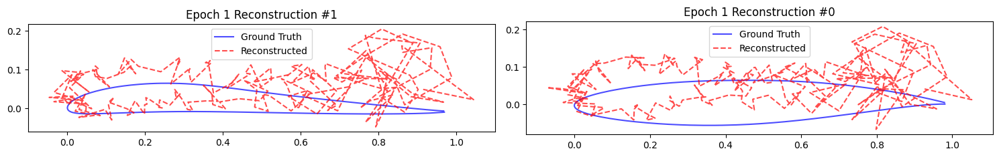

Epoch [2/20] | Loss: 0.002952 | Recon: 0.002130 | KL: 8.220967
Epoch 2 - Test MSE: 0.001935, MAE: 0.033520, RMSE: 0.043894


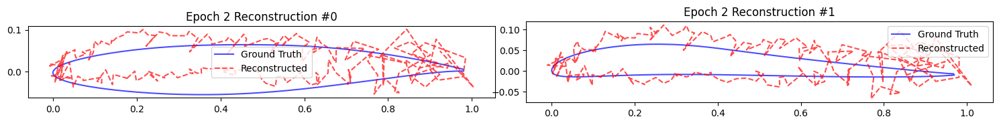

Epoch [3/20] | Loss: 0.001981 | Recon: 0.001332 | KL: 6.492421
Epoch 3 - Test MSE: 0.001400, MAE: 0.028682, RMSE: 0.037332


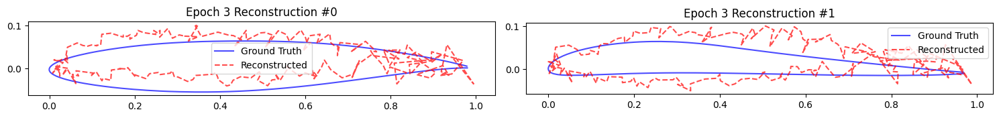

Epoch [4/20] | Loss: 0.001560 | Recon: 0.001141 | KL: 4.187167
Epoch 4 - Test MSE: 0.001175, MAE: 0.026316, RMSE: 0.034181


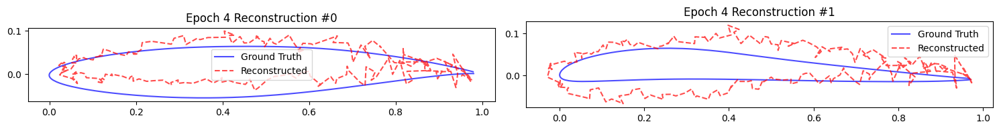

Epoch [5/20] | Loss: 0.001018 | Recon: 0.000956 | KL: 0.619763
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_5.pt
Epoch 5 - Test MSE: 0.000929, MAE: 0.023517, RMSE: 0.030427


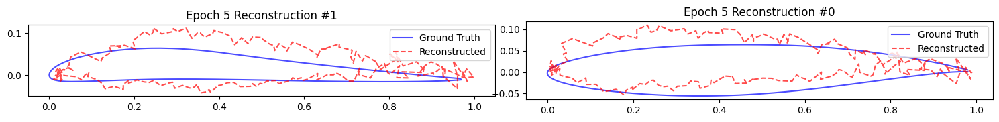

Epoch [6/20] | Loss: 0.000797 | Recon: 0.000793 | KL: 0.034393
Epoch 6 - Test MSE: 0.000910, MAE: 0.023065, RMSE: 0.030108


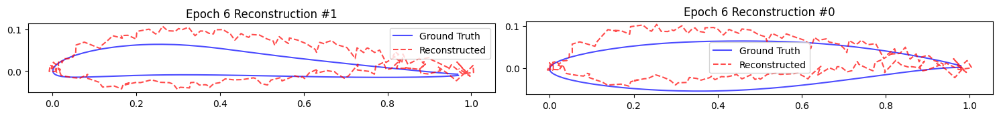

Epoch [7/20] | Loss: 0.000742 | Recon: 0.000740 | KL: 0.015779
Epoch 7 - Test MSE: 0.000811, MAE: 0.021747, RMSE: 0.028426


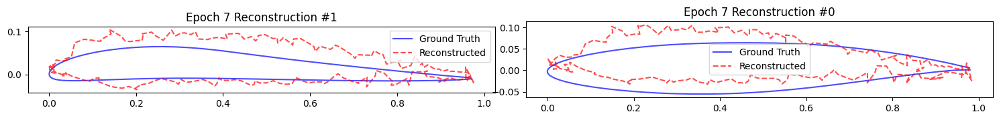

Epoch [8/20] | Loss: 0.000711 | Recon: 0.000710 | KL: 0.008857
Epoch 8 - Test MSE: 0.000832, MAE: 0.021633, RMSE: 0.028733


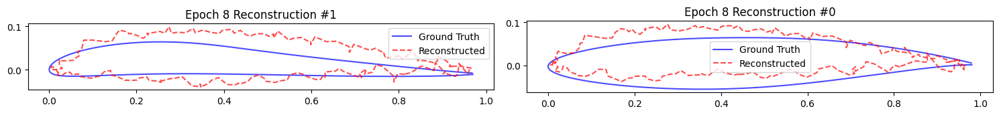

Epoch [9/20] | Loss: 0.000685 | Recon: 0.000685 | KL: 0.005098
Epoch 9 - Test MSE: 0.000787, MAE: 0.020977, RMSE: 0.027986


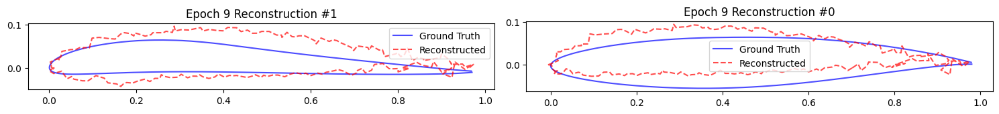

Epoch [10/20] | Loss: 0.000672 | Recon: 0.000671 | KL: 0.003064
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_10.pt
Epoch 10 - Test MSE: 0.000741, MAE: 0.020033, RMSE: 0.027118


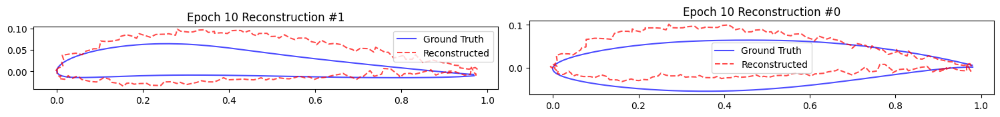

Epoch [11/20] | Loss: 0.000664 | Recon: 0.000664 | KL: 0.001970
Epoch 11 - Test MSE: 0.000831, MAE: 0.021205, RMSE: 0.028660


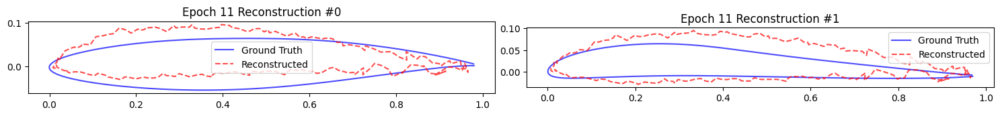

Epoch [12/20] | Loss: 0.000659 | Recon: 0.000659 | KL: 0.001366
Epoch 12 - Test MSE: 0.000761, MAE: 0.019883, RMSE: 0.027393


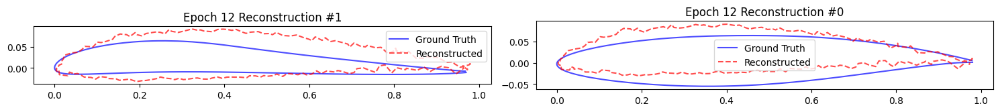

Epoch [13/20] | Loss: 0.000655 | Recon: 0.000655 | KL: 0.000996
Epoch 13 - Test MSE: 0.000821, MAE: 0.020315, RMSE: 0.028466


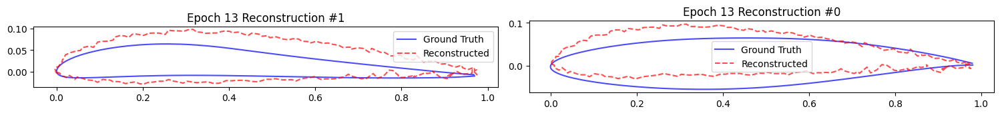

Epoch [14/20] | Loss: 0.000650 | Recon: 0.000650 | KL: 0.000763
Epoch 14 - Test MSE: 0.000711, MAE: 0.019690, RMSE: 0.026625


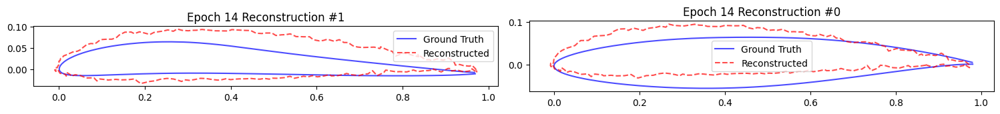

Epoch [15/20] | Loss: 0.000648 | Recon: 0.000648 | KL: 0.000582
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_15.pt
Epoch 15 - Test MSE: 0.000750, MAE: 0.019789, RMSE: 0.027246


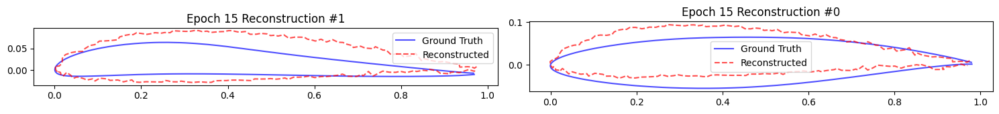

Epoch [16/20] | Loss: 0.000647 | Recon: 0.000647 | KL: 0.000488
Epoch 16 - Test MSE: 0.000750, MAE: 0.019931, RMSE: 0.027306


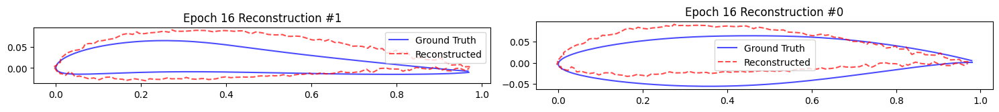

Epoch [17/20] | Loss: 0.000645 | Recon: 0.000645 | KL: 0.000408
Epoch 17 - Test MSE: 0.000755, MAE: 0.019821, RMSE: 0.027297


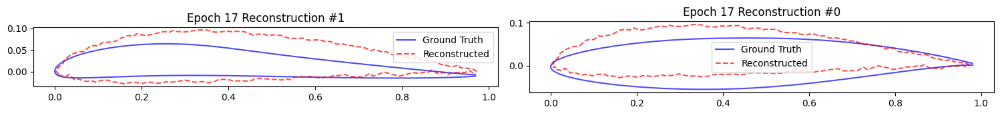

Epoch [18/20] | Loss: 0.000643 | Recon: 0.000643 | KL: 0.000355
Epoch 18 - Test MSE: 0.000751, MAE: 0.019881, RMSE: 0.027208


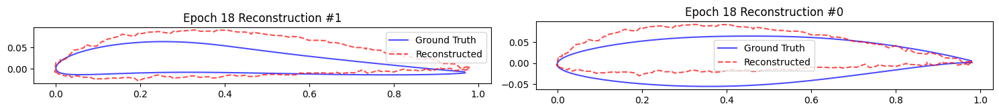

Epoch [19/20] | Loss: 0.000644 | Recon: 0.000644 | KL: 0.000320
Epoch 19 - Test MSE: 0.000737, MAE: 0.019931, RMSE: 0.027039


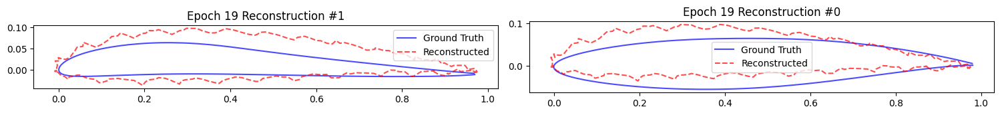

Epoch [20/20] | Loss: 0.000642 | Recon: 0.000642 | KL: 0.000301
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_20.pt
Epoch 20 - Test MSE: 0.000728, MAE: 0.019599, RMSE: 0.026850


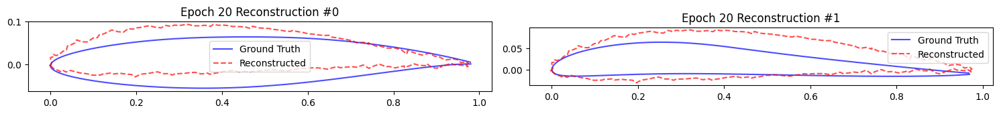

Training Complete!


In [ ]:

# Define your custom configuration
custom_config = Config()
# custom_config.config["autoencoder_params"]["z_channels"] = 16
# custom_config.config["train_params"]["task_name"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/models"
# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

#### V2

In [ ]:
class Config:
    def __init__(self):
        """
        This config is simplified for the 1D VAE training on Airfoil data.
        Adjust paths, hyperparameters, etc. as needed.
        """
        self.config = {
            "dataset_params": {
                # Paths to your preprocessed airfoil data
                "train_xs": "/content/data/xs_train.npy",
                "train_ys": "/content/data/ys_train_scaled.npy",
                "test_xs":  "/content/data/xs_test.npy",      # or you can keep same as train for testing
                "test_ys":  "/content/data/ys_test_scaled.npy",
                # Min/max label paths (if needed, else remove)
                "y_min": "/content/data/y_min.npy",
                "y_max": "/content/data/y_max.npy",
                "batch_size": 64,        # Adjust to your GPU memory
                "shuffle": True
            },

            "autoencoder_params": {
                "z_channels": 64,
                "down_channels": [4, 8, 16, 32],
                "mid_channels": [32, 32],
                "down_sample": [True, True, True],
                "attn_down": [True, True, True],
                "norm_channels": 4,
                "num_heads": 4,
                "num_down_layers": 4,
                "num_mid_layers": 2,
                "num_up_layers": 4
            },

            "train_params": {
                "epochs": 50,
                "lr": 0.002,
                "kl_weight": 0.001,  # how heavily you weight KL divergence
                "seed": 1111,
                "checkpoint_dir": "/content/vae_checkpointsv1",
                "save_every": 5,  # save model every 5 epochs
                "report_every": 1
            }
        }


Using device: cuda
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1              [-1, 16, 192]             112
         GroupNorm-2              [-1, 16, 192]              32
              SiLU-3              [-1, 16, 192]               0
            Conv1d-4              [-1, 32, 192]           1,568
         GroupNorm-5              [-1, 32, 192]              64
              SiLU-6              [-1, 32, 192]               0
            Conv1d-7              [-1, 32, 192]           3,104
            Conv1d-8              [-1, 32, 192]             544
         GroupNorm-9              [-1, 32, 192]              64
MultiheadAttention-10  [[-1, 192, 32], [-1, 192, 192]]               0
        GroupNorm-11              [-1, 32, 192]              64
             SiLU-12              [-1, 32, 192]               0
           Conv1d-13              [-1, 32, 192]           3,104
        Group

<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/50] | Loss: 0.002976 | Recon: 0.002633 | KL: 0.342707
Epoch 1 - Test MSE: 0.000840, MAE: 0.022482, RMSE: 0.028939


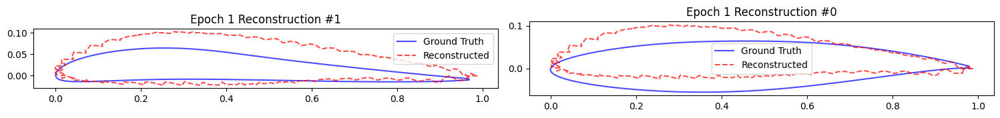

Epoch [2/50] | Loss: 0.000677 | Recon: 0.000676 | KL: 0.000999
Epoch 2 - Test MSE: 0.000745, MAE: 0.019842, RMSE: 0.027065


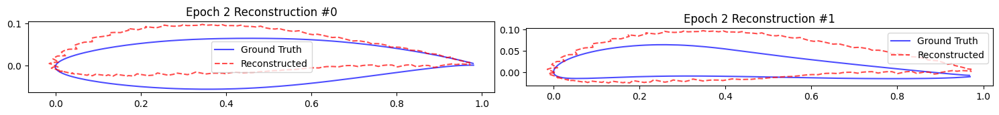

Epoch [3/50] | Loss: 0.000670 | Recon: 0.000666 | KL: 0.003186
Epoch 3 - Test MSE: 0.000714, MAE: 0.019580, RMSE: 0.026624


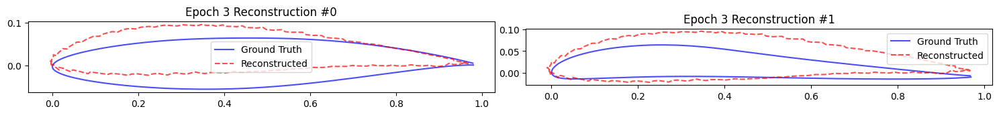

Epoch [4/50] | Loss: 0.000669 | Recon: 0.000668 | KL: 0.001670
Epoch 4 - Test MSE: 0.000703, MAE: 0.019644, RMSE: 0.026459


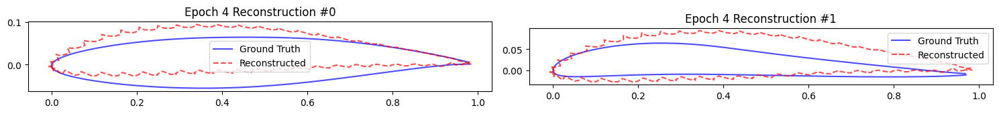

Epoch [5/50] | Loss: 0.000670 | Recon: 0.000668 | KL: 0.002117
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_5.pt
Epoch 5 - Test MSE: 0.000825, MAE: 0.021434, RMSE: 0.028649


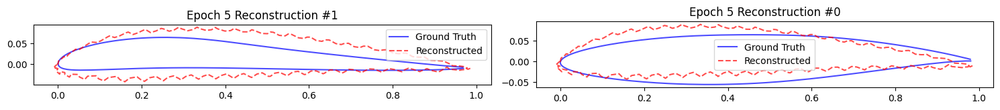

Epoch [6/50] | Loss: 0.000670 | Recon: 0.000668 | KL: 0.001290
Epoch 6 - Test MSE: 0.000951, MAE: 0.022197, RMSE: 0.030457


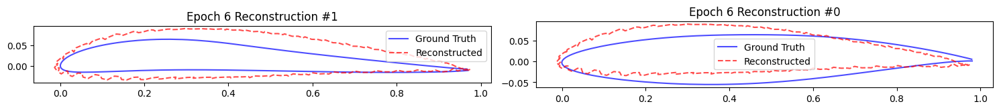

Epoch [7/50] | Loss: 0.000671 | Recon: 0.000670 | KL: 0.001263
Epoch 7 - Test MSE: 0.000691, MAE: 0.019434, RMSE: 0.026178


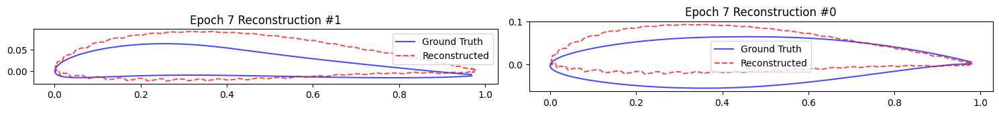

Epoch [8/50] | Loss: 0.000672 | Recon: 0.000670 | KL: 0.001240
Epoch 8 - Test MSE: 0.000938, MAE: 0.022067, RMSE: 0.030399


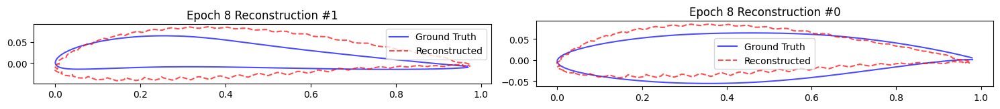

Epoch [9/50] | Loss: 0.000664 | Recon: 0.000663 | KL: 0.001059
Epoch 9 - Test MSE: 0.000756, MAE: 0.020238, RMSE: 0.027480


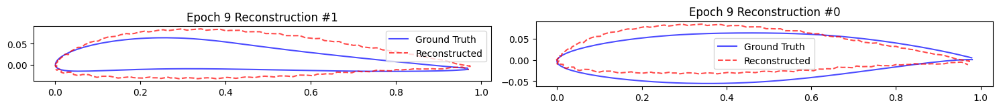

Epoch [10/50] | Loss: 0.015474 | Recon: 0.011835 | KL: 3.638408
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_10.pt
Epoch 10 - Test MSE: 0.004282, MAE: 0.049294, RMSE: 0.065387


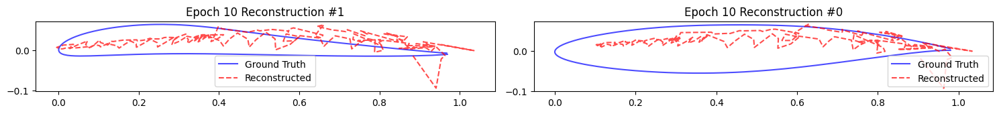

Epoch [11/50] | Loss: 0.002380 | Recon: 0.002158 | KL: 0.222059
Epoch 11 - Test MSE: 0.001288, MAE: 0.028555, RMSE: 0.035816


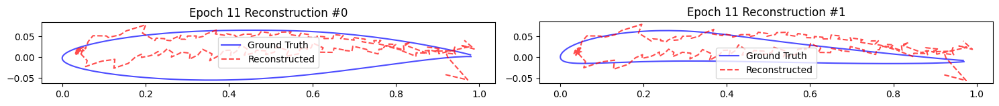

Epoch [12/50] | Loss: 0.000908 | Recon: 0.000908 | KL: 0.000223
Epoch 12 - Test MSE: 0.000816, MAE: 0.021659, RMSE: 0.028480


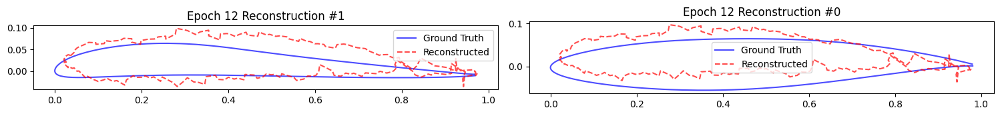

Epoch [13/50] | Loss: 0.008904 | Recon: 0.007401 | KL: 1.502716
Epoch 13 - Test MSE: 0.003775, MAE: 0.044639, RMSE: 0.061366


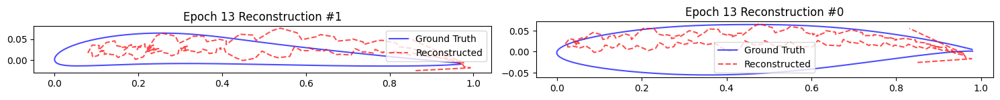

Epoch [14/50] | Loss: 0.006392 | Recon: 0.004223 | KL: 2.169326
Epoch 14 - Test MSE: 0.002719, MAE: 0.039382, RMSE: 0.052078


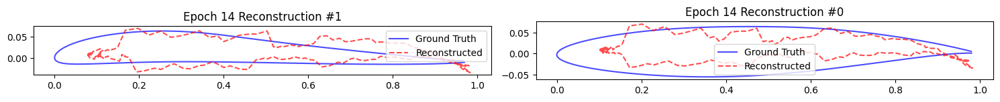

Epoch [15/50] | Loss: 0.001131 | Recon: 0.001127 | KL: 0.003918
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_15.pt
Epoch 15 - Test MSE: 0.001049, MAE: 0.025095, RMSE: 0.032192


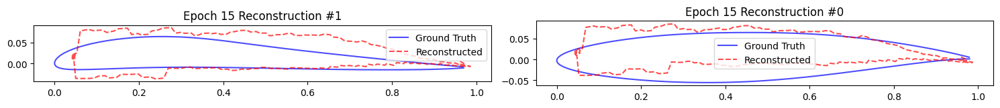

Epoch [16/50] | Loss: 0.000891 | Recon: 0.000891 | KL: 0.000185
Epoch 16 - Test MSE: 0.000936, MAE: 0.023851, RMSE: 0.030456


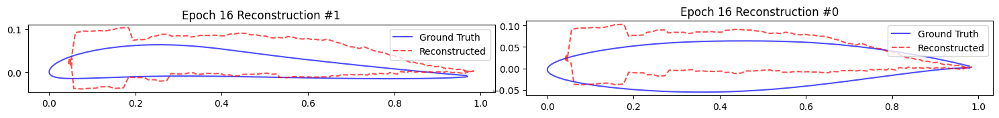

Epoch [17/50] | Loss: 0.002568 | Recon: 0.002393 | KL: 0.174835
Epoch 17 - Test MSE: 0.001072, MAE: 0.025272, RMSE: 0.032708


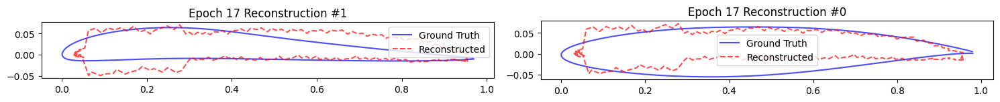

Epoch [18/50] | Loss: 0.000758 | Recon: 0.000758 | KL: 0.000309
Epoch 18 - Test MSE: 0.000871, MAE: 0.021817, RMSE: 0.029305


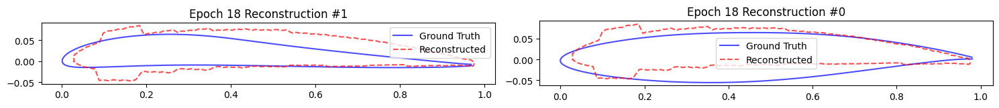

Epoch [19/50] | Loss: 0.000680 | Recon: 0.000680 | KL: 0.000089
Epoch 19 - Test MSE: 0.000820, MAE: 0.020809, RMSE: 0.028419


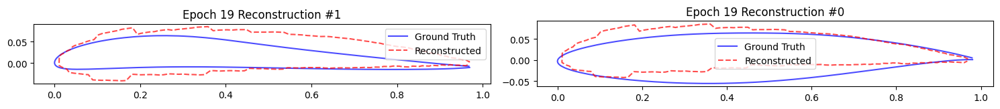

Epoch [20/50] | Loss: 0.000675 | Recon: 0.000675 | KL: 0.000051
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_20.pt
Epoch 20 - Test MSE: 0.000755, MAE: 0.020234, RMSE: 0.027364


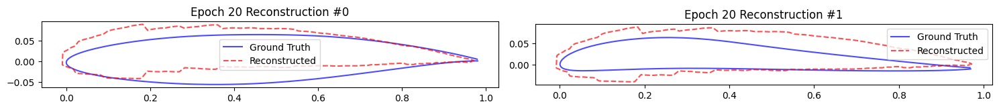

Epoch [21/50] | Loss: 0.000671 | Recon: 0.000671 | KL: 0.000031
Epoch 21 - Test MSE: 0.000725, MAE: 0.020183, RMSE: 0.026886


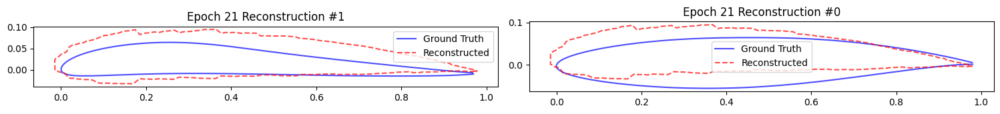

Epoch [22/50] | Loss: 0.000669 | Recon: 0.000669 | KL: 0.000021
Epoch 22 - Test MSE: 0.000832, MAE: 0.020794, RMSE: 0.028543


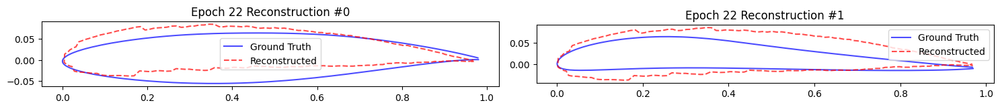

Epoch [23/50] | Loss: 0.000663 | Recon: 0.000663 | KL: 0.000015
Epoch 23 - Test MSE: 0.000721, MAE: 0.019961, RMSE: 0.026809


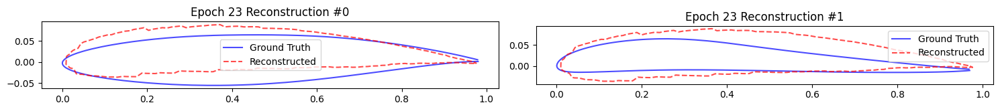

Epoch [24/50] | Loss: 0.000668 | Recon: 0.000668 | KL: 0.000012
Epoch 24 - Test MSE: 0.000750, MAE: 0.020076, RMSE: 0.027278


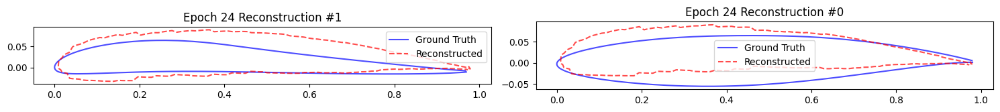

Epoch [25/50] | Loss: 0.000663 | Recon: 0.000663 | KL: 0.000010
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_25.pt
Epoch 25 - Test MSE: 0.000861, MAE: 0.021240, RMSE: 0.028875


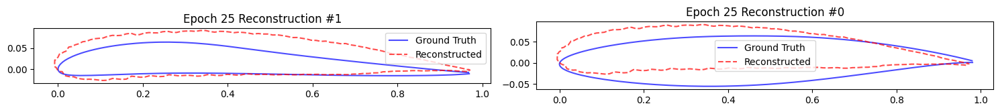

Epoch [26/50] | Loss: 0.000667 | Recon: 0.000667 | KL: 0.000009
Epoch 26 - Test MSE: 0.000827, MAE: 0.021554, RMSE: 0.028442


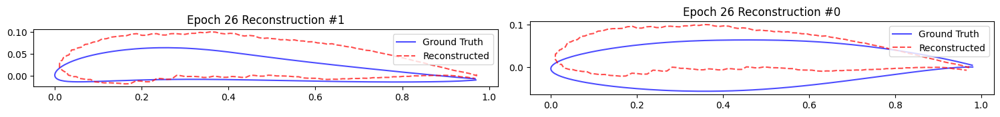

Epoch [27/50] | Loss: 0.000662 | Recon: 0.000662 | KL: 0.000009
Epoch 27 - Test MSE: 0.000723, MAE: 0.019697, RMSE: 0.026745


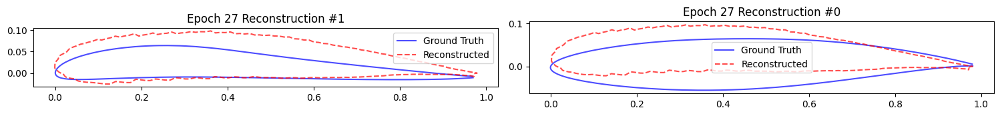

Epoch [28/50] | Loss: 0.000658 | Recon: 0.000658 | KL: 0.000009
Epoch 28 - Test MSE: 0.000763, MAE: 0.020388, RMSE: 0.027519


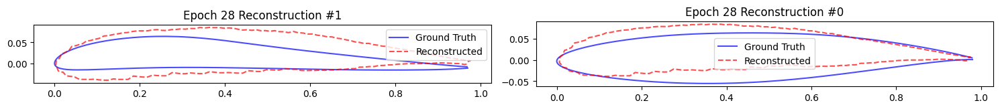

Epoch [29/50] | Loss: 0.000656 | Recon: 0.000656 | KL: 0.000013
Epoch 29 - Test MSE: 0.000727, MAE: 0.019621, RMSE: 0.026760


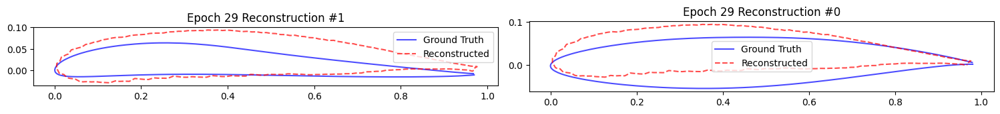

Epoch [30/50] | Loss: 0.000659 | Recon: 0.000659 | KL: 0.000017
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_30.pt
Epoch 30 - Test MSE: 0.000767, MAE: 0.020341, RMSE: 0.027406


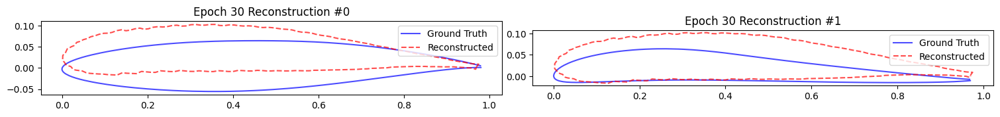

Epoch [31/50] | Loss: 0.000655 | Recon: 0.000655 | KL: 0.000017
Epoch 31 - Test MSE: 0.000811, MAE: 0.020867, RMSE: 0.028282


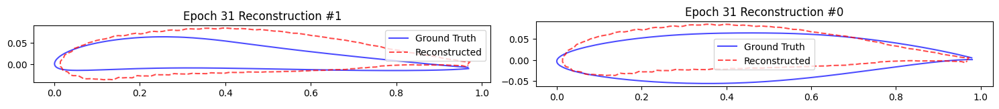

Epoch [32/50] | Loss: 0.000654 | Recon: 0.000654 | KL: 0.000017
Epoch 32 - Test MSE: 0.000766, MAE: 0.020192, RMSE: 0.027611


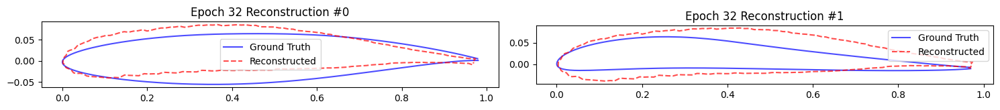

Epoch [33/50] | Loss: 0.000654 | Recon: 0.000654 | KL: 0.000015
Epoch 33 - Test MSE: 0.000733, MAE: 0.019618, RMSE: 0.026930


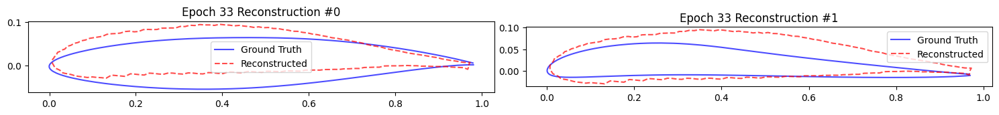

Epoch [34/50] | Loss: 0.000653 | Recon: 0.000653 | KL: 0.000015
Epoch 34 - Test MSE: 0.000820, MAE: 0.021388, RMSE: 0.028509


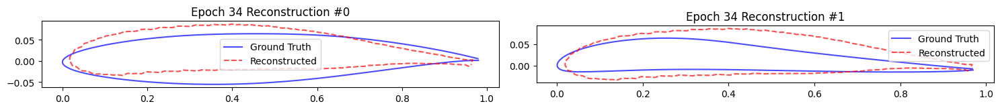

Epoch [35/50] | Loss: 0.000654 | Recon: 0.000654 | KL: 0.000012
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_35.pt
Epoch 35 - Test MSE: 0.000729, MAE: 0.019609, RMSE: 0.026833


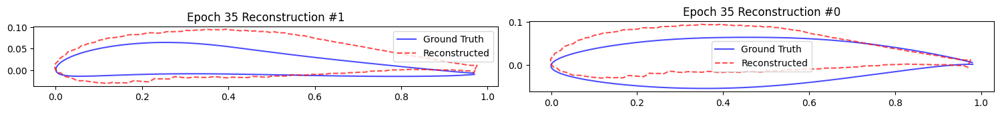

Epoch [36/50] | Loss: 0.000650 | Recon: 0.000650 | KL: 0.000012
Epoch 36 - Test MSE: 0.000740, MAE: 0.019756, RMSE: 0.027020


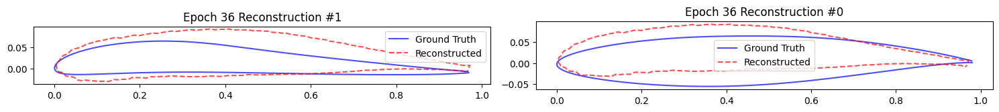

Epoch [37/50] | Loss: 0.000653 | Recon: 0.000653 | KL: 0.000011
Epoch 37 - Test MSE: 0.000706, MAE: 0.019359, RMSE: 0.026516


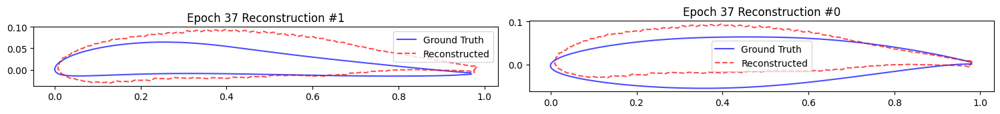

Epoch [38/50] | Loss: 0.000652 | Recon: 0.000652 | KL: 0.000009
Epoch 38 - Test MSE: 0.000741, MAE: 0.019917, RMSE: 0.027195


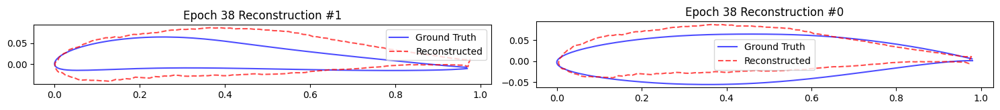

Epoch [39/50] | Loss: 0.000652 | Recon: 0.000652 | KL: 0.000009
Epoch 39 - Test MSE: 0.000814, MAE: 0.020564, RMSE: 0.028340


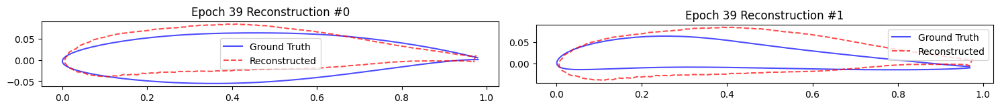

Epoch [40/50] | Loss: 0.000649 | Recon: 0.000649 | KL: 0.000008
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_40.pt
Epoch 40 - Test MSE: 0.000847, MAE: 0.020993, RMSE: 0.028891


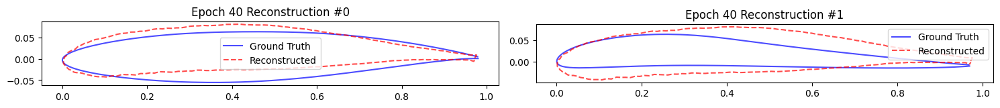

Epoch [41/50] | Loss: 0.001844 | Recon: 0.001840 | KL: 0.004774
Epoch 41 - Test MSE: 0.005606, MAE: 0.055238, RMSE: 0.074528


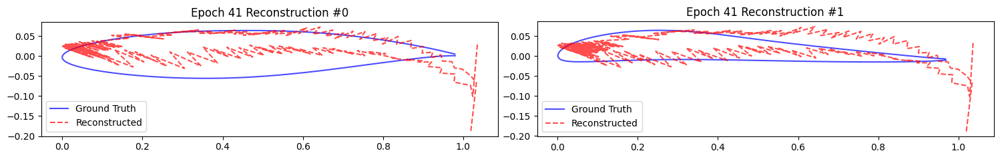

Epoch [42/50] | Loss: 0.046226 | Recon: 0.046226 | KL: 0.000164
Epoch 42 - Test MSE: 0.048303, MAE: 0.154245, RMSE: 0.219739


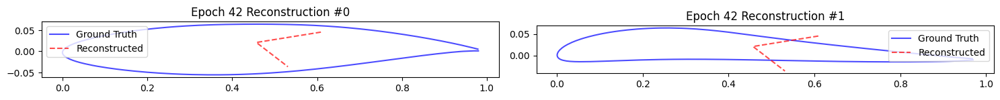

Epoch [43/50] | Loss: 0.046392 | Recon: 0.046392 | KL: 0.000003
Epoch 43 - Test MSE: 0.047556, MAE: 0.153050, RMSE: 0.218032


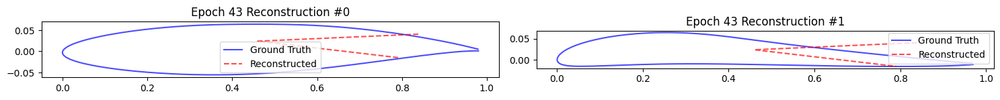

Epoch [44/50] | Loss: 0.045942 | Recon: 0.045942 | KL: 0.000002
Epoch 44 - Test MSE: 0.047435, MAE: 0.152080, RMSE: 0.217752


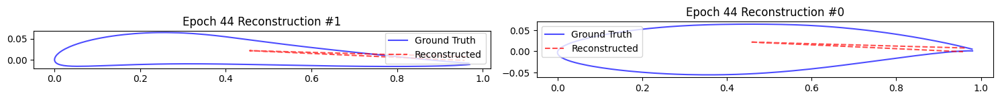

KeyboardInterrupt: 

In [ ]:
# Define your custom configuration
custom_config = Config()
custom_config.config["autoencoder_params"]["z_channels"] = 16
custom_config.config["autoencoder_params"]["down_channels"] = [16, 32, 64, 128]
custom_config.config["autoencoder_params"]["mid_channels"] = [128, 128, 128, 128]
custom_config.config["autoencoder_params"]["down_sample"] = [True, True, True]
custom_config.config["autoencoder_params"]["down_sample"] = [True, True, True]
custom_config.config["autoencoder_params"]["norm_channels"] = 8
custom_config.config["autoencoder_params"]["num_heads"] = 8


# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

#### V3

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class Encoder1D(nn.Module):
    """
    A simple 1D encoder that repeatedly downsamples until length is small, then flattens
    and produces (mean, logvar) for the latent distribution.
    """
    def __init__(self,
                 in_channels=2,
                 down_channels=(32, 64, 128, 256),
                 latent_dim=64):
        super().__init__()
        self.latent_dim = latent_dim

        # -----------------------
        # Convolutional Downsampling
        # -----------------------
        # Each step: Conv1d -> ReLU -> (optionally GroupNorm) -> stride=2
        # Input shape is (B, 2, 192) initially
        modules = []
        prev_ch = in_channels
        for ch in down_channels:
            modules.append(
                nn.Sequential(
                    nn.Conv1d(prev_ch, ch, kernel_size=4, stride=2, padding=1),
                    nn.ReLU(inplace=True),
                )
            )
            prev_ch = ch
        self.conv_down = nn.Sequential(*modules)

        # If down_channels = [32, 64, 128, 256],
        # final shape after conv_down is (B, 256, 12) for input length=192

        # Flatten (256*12 = 3072) -> fully connected to latent
        # We'll produce mean & logvar from a single hidden layer for example
        self.flatten_dim = down_channels[-1]  # 256
        self.flatten_len = 12                # computed from 192 / (2^4)
        fc_in = self.flatten_dim * self.flatten_len  # 256 * 12 = 3072

        # A small hidden linear layer before producing mean/logvar
        hidden_size = 512
        self.fc1 = nn.Linear(fc_in, hidden_size)
        self.fc_mu = nn.Linear(hidden_size, latent_dim)
        self.fc_logvar = nn.Linear(hidden_size, latent_dim)

    def forward(self, x):
        """
        Args:
            x: (B, 2, 192)
        Returns:
            mu, logvar (both shape (B, latent_dim))
        """
        out = self.conv_down(x)  # e.g. (B, 256, 12)
        out = out.view(out.size(0), -1)  # flatten to (B, 256*12=3072)

        h = F.relu(self.fc1(out))        # (B, 512)
        mu = self.fc_mu(h)               # (B, latent_dim)
        logvar = self.fc_logvar(h)       # (B, latent_dim)
        return mu, logvar


class Decoder1D(nn.Module):
    """
    A simple 1D decoder that starts from a latent vector (z_dim) and
    reconstructs the 1D data of shape (2, 192).
    """
    def __init__(self,
                 out_channels=2,
                 up_channels=(256, 128, 64, 32),
                 latent_dim=64):
        super().__init__()
        self.latent_dim = latent_dim

        # We'll do the "inverse" of the encoder:
        # linear from z_dim -> (256 * 12) -> reshape -> upsample 4 times -> final 2 channels.

        self.flatten_dim = up_channels[0]  # 256
        self.flatten_len = 12             # after 4 downsamples from 192, we had length=12
        fc_out = self.flatten_dim * self.flatten_len  # 256 * 12 = 3072

        hidden_size = 512
        self.fc = nn.Linear(latent_dim, hidden_size)
        self.fc_out = nn.Linear(hidden_size, fc_out)

        # Convolutional Transpose blocks: 4 steps from length=12 -> 192
        # up_channels = (256, 128, 64, 32)
        # The final step out must have out_channels=2
        modules = []
        for i in range(len(up_channels) - 1):
            in_ch = up_channels[i]
            out_ch = up_channels[i + 1]
            modules.append(
                nn.Sequential(
                    nn.ConvTranspose1d(in_ch, out_ch, kernel_size=4, stride=2, padding=1),
                    nn.ReLU(inplace=True),
                )
            )
        self.deconv_blocks = nn.Sequential(*modules)

        # Final upsample from up_channels[-1] -> out_channels=2
        self.last_deconv = nn.ConvTranspose1d(
            up_channels[-1], out_channels, kernel_size=4, stride=2, padding=1
        )

    def forward(self, z):
        """
        Args:
            z: (B, latent_dim)
        Returns:
            recon: (B, out_channels=2, 192)
        """
        h = F.relu(self.fc(z))           # (B, 512)
        h = self.fc_out(h)              # (B, 3072)
        h = h.view(h.size(0), self.flatten_dim, self.flatten_len)  # => (B, 256, 12)

        out = self.deconv_blocks(h)      # => (B, 32, 96) after the 3rd up block for example
        out = self.last_deconv(out)      # => (B, 2, 192)
        return out


class VAE1D(nn.Module):
    """
    High-level VAE1D that composes the above Encoder1D and Decoder1D.
    """
    def __init__(self,
                 in_channels=2,        # input is e.g. (2, 192)
                 out_channels=2,       # reconstruct same shape
                 down_channels=(32, 64, 128, 256),
                 up_channels=(256, 128, 64, 32),
                 latent_dim=64):
        super().__init__()
        self.encoder = Encoder1D(in_channels, down_channels, latent_dim)
        self.decoder = Decoder1D(out_channels, up_channels, latent_dim)

    def forward(self, x):
        """
        Returns:
          recon: (B, out_channels, 192)
          mu, logvar: (B, latent_dim)
          z: (B, latent_dim)
        """
        mu, logvar = self.encoder(x)
        # reparameterize
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        z = mu + eps * std

        recon = self.decoder(z)
        return recon, (mu, logvar), z


def vae_loss_function(recon, x, mu, logvar, kl_weight=1.0, loss_type="mse"):
    """
    A typical VAE loss:  reconstruction term + KL term.
      - recon, x are shape: (B, 2, 192)
      - mu, logvar: shape: (B, latent_dim)
    """
    if loss_type == "mse":
        recon_loss = F.mse_loss(recon, x, reduction="mean")
    elif loss_type == "l1":
        recon_loss = F.l1_loss(recon, x, reduction="mean")
    else:
        # or combine them, e.g. 0.5*MSE + 0.5*L1
        recon_loss = 0.5*F.mse_loss(recon, x, reduction="mean") + \
                     0.5*F.l1_loss(recon, x, reduction="mean")

    # KL Divergence = 0.5 * \sum( exp(logvar) + mu^2 - 1 - logvar )
    # Then average over batch
    kld_per_sample = 0.5 * torch.sum(torch.exp(logvar) + mu**2 - 1.0 - logvar, dim=1)
    kld = torch.mean(kld_per_sample)

    loss = recon_loss + kl_weight * kld
    return loss, recon_loss, kld


# ---------------------
# Example Training Snippet
# ---------------------
if __name__ == "__main__":
    # Suppose we have (B,2,192) input
    B = 4
    x = torch.randn(B, 2, 192)

    vae = VAE1D(in_channels=2, out_channels=2,
                down_channels=(32,64,128,256),
                up_channels=(256,128,64,32),
                latent_dim=64)

    recon, (mu, logvar), z = vae(x)
    print("Input:", x.shape)
    print("Recon:", recon.shape)
    print("mu, logvar:", mu.shape, logvar.shape)
    print("z:", z.shape)

    # Example loss
    loss, recon_loss, kld = vae_loss_function(recon, x, mu, logvar, kl_weight=0.001, loss_type="mse")
    print(f"Loss: {loss.item():.3f} | Recon: {recon_loss.item():.3f} | KL: {kld.item():.3f}")

    # Then do backward, step optimizer, etc.
    loss.backward()


Input: torch.Size([4, 2, 192])
Recon: torch.Size([4, 2, 192])
mu, logvar: torch.Size([4, 64]) torch.Size([4, 64])
z: torch.Size([4, 64])
Loss: 1.088 | Recon: 1.088 | KL: 0.038


Using device: cuda
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1               [-1, 32, 96]             288
              ReLU-2               [-1, 32, 96]               0
            Conv1d-3               [-1, 64, 48]           8,256
              ReLU-4               [-1, 64, 48]               0
            Conv1d-5              [-1, 128, 24]          32,896
              ReLU-6              [-1, 128, 24]               0
            Conv1d-7              [-1, 256, 12]         131,328
              ReLU-8              [-1, 256, 12]               0
            Linear-9                  [-1, 512]       1,573,376
           Linear-10                   [-1, 64]          32,832
           Linear-11                   [-1, 64]          32,832
        Encoder1D-12       [[-1, 64], [-1, 64]]               0
           Linear-13                  [-1, 512]          33,280
           Linear-14

<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/50] | Loss: 0.016619 | Recon: 0.016606 | KL: 0.001300
Epoch 1 - Test MSE: 0.000807, MAE: 0.020685, RMSE: 0.028367


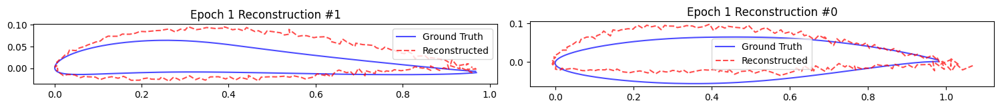

Epoch [2/50] | Loss: 0.010054 | Recon: 0.010054 | KL: 0.000028
Epoch 2 - Test MSE: 0.000902, MAE: 0.021511, RMSE: 0.029741


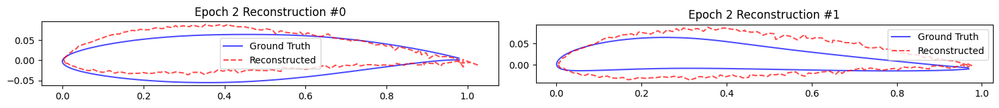

Epoch [3/50] | Loss: 0.009763 | Recon: 0.009763 | KL: 0.000007
Epoch 3 - Test MSE: 0.000873, MAE: 0.021527, RMSE: 0.029302


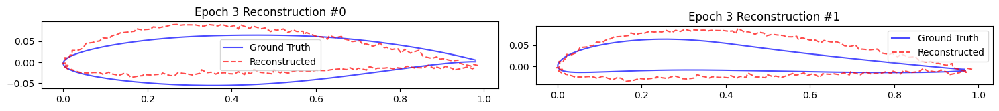

Epoch [4/50] | Loss: 0.009761 | Recon: 0.009760 | KL: 0.000013
Epoch 4 - Test MSE: 0.000810, MAE: 0.021143, RMSE: 0.028404


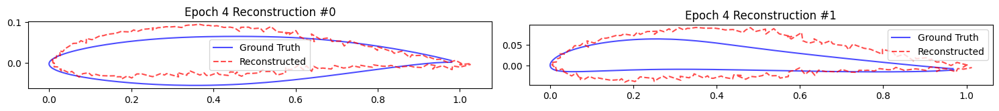

Epoch [5/50] | Loss: 0.009683 | Recon: 0.009683 | KL: 0.000003
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_5.pt
Epoch 5 - Test MSE: 0.000736, MAE: 0.019598, RMSE: 0.027028


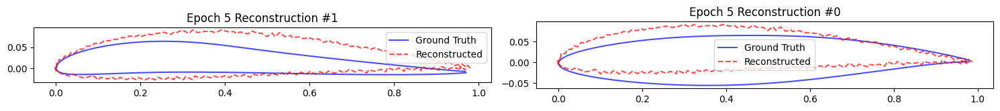

Epoch [6/50] | Loss: 0.009556 | Recon: 0.009556 | KL: 0.000002
Epoch 6 - Test MSE: 0.000763, MAE: 0.019932, RMSE: 0.027372


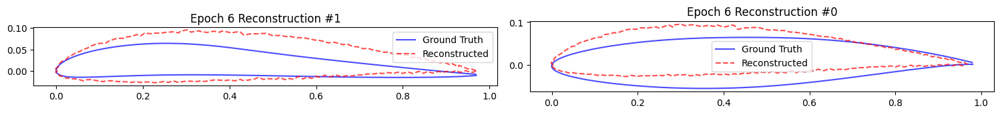

Epoch [7/50] | Loss: 0.009586 | Recon: 0.009586 | KL: 0.000002
Epoch 7 - Test MSE: 0.000753, MAE: 0.019767, RMSE: 0.027273


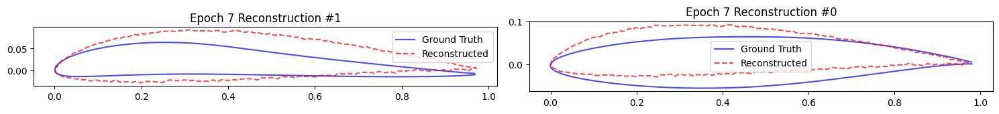

Epoch [8/50] | Loss: 0.009548 | Recon: 0.009548 | KL: 0.000002
Epoch 8 - Test MSE: 0.000827, MAE: 0.020869, RMSE: 0.028669


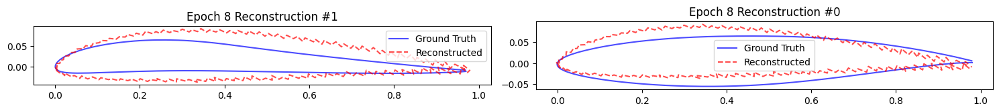

Epoch [9/50] | Loss: 0.009587 | Recon: 0.009587 | KL: 0.000007
Epoch 9 - Test MSE: 0.000718, MAE: 0.019591, RMSE: 0.026777


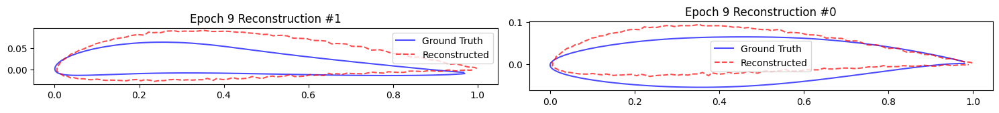

Epoch [10/50] | Loss: 0.009547 | Recon: 0.009547 | KL: 0.000003
Checkpoint saved at: /content/vae_checkpointsv1/vae1d_epoch_10.pt
Epoch 10 - Test MSE: 0.000859, MAE: 0.021231, RMSE: 0.028721


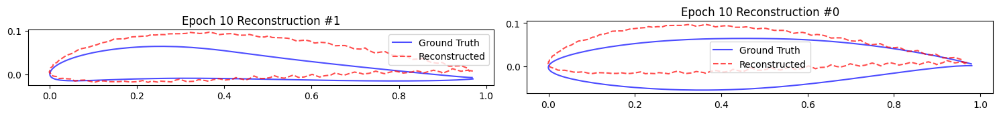

Epoch [11/50] | Loss: 0.009535 | Recon: 0.009535 | KL: 0.000003
Epoch 11 - Test MSE: 0.000726, MAE: 0.019515, RMSE: 0.026886


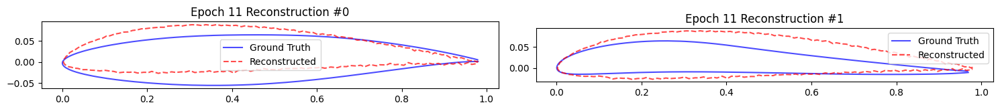

Epoch [12/50] | Loss: 0.009517 | Recon: 0.009517 | KL: 0.000004
Epoch 12 - Test MSE: 0.000748, MAE: 0.019759, RMSE: 0.027296


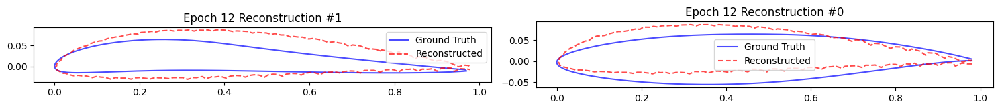

Epoch [13/50] | Loss: 0.009542 | Recon: 0.009541 | KL: 0.000020
Epoch 13 - Test MSE: 0.000756, MAE: 0.019832, RMSE: 0.027298


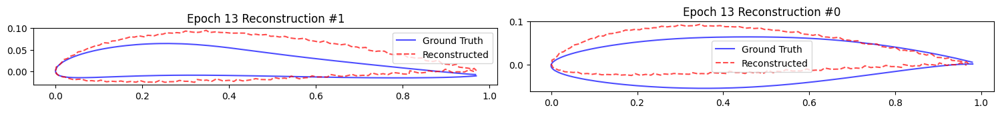

Epoch [14/50] | Loss: 0.009513 | Recon: 0.009513 | KL: 0.000007
Epoch 14 - Test MSE: 0.000748, MAE: 0.019743, RMSE: 0.027171


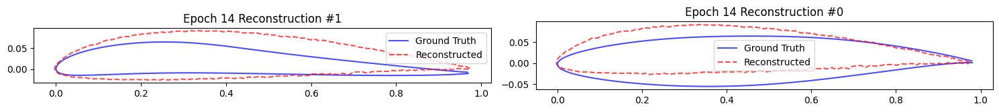

In [ ]:
import os
import torch
import random
import numpy as np
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary


def train_vae1d(custom_config=None):
    """
    Example training routine for your 1D VAE on Airfoil data.
    """
    # 1) Load config
    if custom_config is not None:
        config = custom_config.config
    else:
        config = Config().config

    dataset_params  = config["dataset_params"]
    ae_params       = config["autoencoder_params"]
    train_params    = config["train_params"]

    seed            = train_params["seed"]
    lr              = train_params["lr"]
    kl_weight       = train_params["kl_weight"]
    num_epochs      = train_params["epochs"]
    checkpoint_dir  = train_params["checkpoint_dir"]
    save_every      = train_params["save_every"]
    report_every      = train_params["report_every"]

    # 2) Set random seed for reproducibility
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    train_dataset = AirfoilDataset(
        xs_path=dataset_params["train_xs"],
        ys_path=dataset_params["train_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    train_loader = DataLoader(
        train_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=dataset_params["shuffle"]
    )

    # Optionally create a test dataset if you want some validation
    # (or pass the same train paths if you don't have a separate test set)
    test_dataset = AirfoilDataset(
        xs_path=dataset_params["test_xs"],
        ys_path=dataset_params["test_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=False
    )

    model = VAE1D(in_channels=2, out_channels=2,
                down_channels=(32,64,128,256),
                up_channels=(256,128,64,32),
                latent_dim=64).to(device)

    summary(model, (2, 192))

    # ------------------------------------
    # B) Test a dummy forward pass
    # ------------------------------------
    with torch.no_grad():
        dummy_input = torch.randn(2, 2, 192).to(device)  # batch=1, channels=2, length=192
        recon, (mean, logvar), z = model(dummy_input)
        print(f"\nDummy Input Shape: {dummy_input.shape}")
        print(f"Reconstruction Shape: {recon.shape}")
        print(f"Mean Shape: {mean.shape}, Logvar Shape: {logvar.shape}, z Shape: {z.shape}\n")

    # 5) Define an optimizer
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # 6) Make sure checkpoint directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    # 7) Training loop
    for epoch in range(1, num_epochs + 1):
        model.train()
        epoch_loss = 0.0
        epoch_kld  = 0.0
        epoch_recon= 0.0

        for coords, _ in train_loader:
            # coords shape: (batch, 2, 192)
            coords = coords.to(device)

            # Forward through the VAE
            recon, (mean, logvar), z = model(coords)
            # print(f"recon.shape: ", recon.shape)
            # print(f"coords.shape: ", coords.shape)
            # print(f"coords.shape: ", coord.shape)

            loss, recon_loss, kld = vae_loss_function(recon, coords, mean, logvar, kl_weight=0.01, loss_type="both")
            # Backprop
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Accumulate for the epoch
            epoch_loss  += loss.item() * coords.size(0)
            epoch_recon += recon_loss.item() * coords.size(0)
            epoch_kld   += kld.item() * coords.size(0)

        # Average over the epoch
        dataset_size = len(train_loader.dataset)
        epoch_loss  /= dataset_size
        epoch_recon /= dataset_size
        epoch_kld   /= dataset_size

        print(f"Epoch [{epoch}/{num_epochs}] | "
              f"Loss: {epoch_loss:.6f} | Recon: {epoch_recon:.6f} | KL: {epoch_kld:.6f}")

        # 8) (Optional) Save checkpoint every `save_every` epochs
        if epoch % save_every == 0 or epoch == num_epochs:
            save_path = os.path.join(checkpoint_dir, f"vae1d_epoch_{epoch}.pt")
            torch.save(model.state_dict(), save_path)
            print(f"Checkpoint saved at: {save_path}")


        # Evaluate on test set every epoch or every `save_every`
        if epoch % report_every == 0 or epoch == num_epochs:
            evaluate_on_test_set(model, test_loader, device, epoch_num=epoch,
                                plot_n_samples=2, specific_indices=None,
                                plot_prefix="Epoch")

    print("Training Complete!")



# Define your custom configuration
custom_config = Config()
# custom_config.config["autoencoder_params"]["z_channels"] = 16
# custom_config.config["train_params"]["task_name"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/models"
# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

NameError: name 'seed' is not defined

#### V4

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Make sure your DownBlock1D, MidBlock1D, UpBlock1D
# are in scope (already imported from your code).


class VAE1D_ResAttention(nn.Module):
    """
    A 1D VAE that:
      - uses your DownBlock1D for repeated down-sampling
      - optional MidBlock1D at the smallest resolution
      - flattens to a linear latent (mu/logvar)
      - reparameterize z
      - up-samples via UpBlock1D, optionally a mid-block in reverse
      - final 1D conv to get the reconstruction
    """

    def __init__(
        self,
        in_channels=2,          # e.g. (2, 192) input
        base_channels=[32,64,128,256],  # the progression of channels in the down path
        latent_dim=64,
        # For attention blocks:
        num_heads=4,
        norm_groups=8,
        # Down sampling config:
        down_num_layers=1,  # how many res-attn layers inside each DownBlock1D
        down_attn=[False, False, True],  # which stages get self-attn? length is (len(base_channels)-1)
        # Up sampling config:
        up_num_layers=1,
        up_attn=[False, False, True],
        # Mid block config:
        mid_num_layers=2,   # how many times we do [Attn + CrossAttn + ResNet] in the mid
        mid_use=True
    ):
        super().__init__()

        # -------------------------------------------------
        # A) Encoder
        # -------------------------------------------------
        # 1) Initial Conv
        self.in_conv = nn.Conv1d(in_channels, base_channels[0], kernel_size=3, stride=1, padding=1)

        # 2) Down Blocks
        #    If base_channels = [32,64,128,256], we have len=4. We'll create 3 down stages:
        #       stage0: 32->64, stage1: 64->128, stage2: 128->256
        #    'down_attn' is length=3 => e.g. [False,False,True]
        #    Each DownBlock1D can have 1 or more internal layers (down_num_layers).
        self.down_blocks = nn.ModuleList()
        for i in range(len(base_channels)-1):
            block = DownBlock1D(
                in_channels=base_channels[i],
                out_channels=base_channels[i+1],
                t_emb_dim=None,
                down_sample=True,         # each stage does stride=2
                num_heads=num_heads,
                num_layers=down_num_layers,
                attn=down_attn[i],
                norm_channels=norm_groups
            )
            self.down_blocks.append(block)

        # 3) Optional mid block at the bottom resolution
        #    That is, at shape (B, base_channels[-1], L_small)
        #    We'll do a MidBlock1D with mid_num_layers, no cross-attn.
        #    This does not change shape, just does attn + res
        self.mid_use = mid_use
        if mid_use:
            self.mid_block = MidBlock1D(
                in_channels=base_channels[-1],
                out_channels=base_channels[-1],
                t_emb_dim=None,
                num_heads=num_heads,
                num_layers=mid_num_layers,
                norm_channels=norm_groups,
                cross_attn=False
            )
        else:
            self.mid_block = nn.Identity()

        # 4) Flatten to get global latent
        #    We won't know L_small exactly unless we know the input length & how many downsamples.
        #    Suppose input length = 192 => after 3 downsample => 192->96->48->24
        #    So L_small=24, channels=base_channels[-1]=256 => flatten size=256*24=6144
        #    We'll do a "Linear -> mu, logvar" approach.
        #    But let's not hardcode 24, we might do self.final_len=192/(2^(len(down_blocks)))
        #    or we can just do an adaptive approach in forward().
        #
        #    For convenience, let's define a placeholder for the final conv shape.
        #    We'll find the shape by hooking or by passing a dummy input.
        #    Or we can require the user to pass the known final length.
        #
        #    For demonstration, let's just store them as buffers after a dummy pass if needed.

        # We'll store the linear layers in a separate small submodule:
        # We'll define them after we see the shape in the forward, or we can do a "manual" approach if we know the shape is always 24.
        # For now, let's do a parameter "final_len" that we can set from outside if we know the input length.
        # Another approach is to do a "build" function that runs a dummy forward pass to set the shape.

        self.final_len = 24  # <-- if you know your input is 192 and #downs=3, then length=24
        self.final_ch  = base_channels[-1]
        flat_dim = self.final_ch * self.final_len   # e.g. 256*24=6144

        # small MLP => z
        hidden_dim = 512
        self.fc_enc = nn.Linear(flat_dim, hidden_dim)
        self.fc_mu = nn.Linear(hidden_dim, latent_dim)
        self.fc_logvar = nn.Linear(hidden_dim, latent_dim)

        # -------------------------------------------------
        # B) Decoder
        # -------------------------------------------------
        # We'll do the inverse:
        #  1) z => linear => flatten_dim => reshape => (C=base_channels[-1], L=24)
        #  2) optional mid_block in reverse (still shape not changed)
        #  3) up blocks in reverse order to get back to base_channels[0], length=192
        #  4) final conv to out_channels=2
        #

        self.fc_dec1 = nn.Linear(latent_dim, hidden_dim)
        self.fc_dec2 = nn.Linear(hidden_dim, flat_dim)

        # optional mid block again
        if mid_use:
            self.mid_block_dec = MidBlock1D(
                in_channels=base_channels[-1],
                out_channels=base_channels[-1],
                t_emb_dim=None,
                num_heads=num_heads,
                num_layers=mid_num_layers,
                norm_channels=norm_groups,
                cross_attn=False
            )
        else:
            self.mid_block_dec = nn.Identity()

        # Up Blocks
        # We'll do them in reverse order of base_channels, so 256->128->64->32
        # 'up_attn' must match length=3
        # Each UpBlock1D also has up_sample=True
        self.up_blocks = nn.ModuleList()
        for i in reversed(range(len(base_channels)-1)):
            block = UpBlock1D(
                in_channels=base_channels[i+1],
                out_channels=base_channels[i],
                t_emb_dim=None,
                up_sample=True,        # stride=2
                num_heads=num_heads,
                num_layers=up_num_layers,
                attn=up_attn[i],
                norm_channels=norm_groups
            )
            self.up_blocks.append(block)

        # final 1D conv
        self.out_conv = nn.Conv1d(base_channels[0], in_channels, kernel_size=3, padding=1)


    def encode(self, x):
        """
        x: shape (B, in_channels=2, length=192) [assuming 192 for example]
        """
        out = self.in_conv(x)  # => (B,32,192)
        for block in self.down_blocks:
            out = block(out)   # => final shape e.g. (B,256,24) after 3 downs

        out = self.mid_block(out)  # => (B,256,24) if used

        # flatten
        B, C, L = out.shape
        out = out.reshape(B, -1)  # => (B, C*L)
        h = F.relu(self.fc_enc(out))  # => (B, hidden_dim)
        mu = self.fc_mu(h)            # => (B, latent_dim)
        logvar = self.fc_logvar(h)    # => (B, latent_dim)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        z = mu + eps * std
        return z

    def decode(self, z):
        """
        z: shape (B, latent_dim)
        returns: (B, in_channels, length=192)
        """
        h = F.relu(self.fc_dec1(z))   # (B, hidden_dim)
        out = self.fc_dec2(h)        # (B, C*L) e.g. (B,256*24=6144)
        B = out.size(0)
        out = out.view(B, self.final_ch, self.final_len)  # => (B,256,24)

        out = self.mid_block_dec(out) # => (B,256,24) if used

        # up blocks
        for block in self.up_blocks:
            out = block(out)  # => eventually (B,32,192)

        out = self.out_conv(out)      # => (B,2,192)
        return out

    def forward(self, x):
        """
        returns recon, (mu, logvar), z
        """
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        recon = self.decode(z)
        return recon, (mu, logvar), z


In [ ]:
# Example usage:
model_config = {
    'down_channels': [32,64,128,256],
    'z_channels': 16,      # not used in this version, since we do a global flatten
    'mid_channels': [256, 256],  # if you want that in your original code, but we won't use it here
    'down_sample': [True, True, True],
    'attn_down': [False, False, True],
    'num_down_layers': 1,
    'num_mid_layers': 2,
    'num_up_layers': 1,
    'norm_channels': 8,
    'num_heads': 4
}

vae = VAE1D_ResAttention(
    in_channels=2,
    base_channels=model_config['down_channels'],
    latent_dim=64,
    num_heads=model_config['num_heads'],
    norm_groups=model_config['norm_channels'],
    down_num_layers=model_config['num_down_layers'],
    down_attn=model_config['attn_down'],
    up_num_layers=model_config['num_up_layers'],
    up_attn=model_config['attn_down'],   # or a different pattern
    mid_num_layers=model_config['num_mid_layers'],
    mid_use=True
)

x = torch.randn(4, 2, 192)  # (batch=4)
recon, (mu, logvar), z = vae(x)
print("Input:", x.shape)
print("Recon:", recon.shape)       # (4, 2, 192)
print("mu, logvar:", mu.shape, logvar.shape)  # (4, 64)
print("z:", z.shape)


Input: torch.Size([4, 2, 192])
Recon: torch.Size([4, 2, 192])
mu, logvar: torch.Size([4, 64]) torch.Size([4, 64])
z: torch.Size([4, 64])


In [ ]:
def vae_loss_function(recon, x, mu, logvar, kl_weight=1.0, loss_type="mse"):
    if loss_type == "mse":
        recon_loss = F.mse_loss(recon, x, reduction="mean")
    elif loss_type == "l1":
        recon_loss = F.l1_loss(recon, x, reduction="mean")
    else: # both
        recon_loss = 0.5 * F.mse_loss(recon, x, reduction="mean") + \
                     0.5 * F.l1_loss(recon, x, reduction="mean")

    kld_per_sample = 0.5 * torch.sum(torch.exp(logvar) + mu**2 - 1.0 - logvar, dim=1)
    kld = torch.mean(kld_per_sample)

    loss = recon_loss + kl_weight * kld
    return loss, recon_loss, kld


Using device: cuda
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1              [-1, 32, 192]             224
         GroupNorm-2              [-1, 32, 192]              64
              SiLU-3              [-1, 32, 192]               0
            Conv1d-4              [-1, 64, 192]           6,208
         GroupNorm-5              [-1, 64, 192]             128
              SiLU-6              [-1, 64, 192]               0
            Conv1d-7              [-1, 64, 192]          12,352
            Conv1d-8              [-1, 64, 192]           2,112
            Conv1d-9               [-1, 64, 96]          16,448
      DownBlock1D-10               [-1, 64, 96]               0
        GroupNorm-11               [-1, 64, 96]             128
             SiLU-12               [-1, 64, 96]               0
           Conv1d-13              [-1, 128, 96]          24,704
        GroupNorm-14

<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/20] | Loss: 0.013225 | Recon: 0.013164 | KL: 0.006034
Epoch 1 - Test MSE: 0.000766, MAE: 0.020055, RMSE: 0.027591


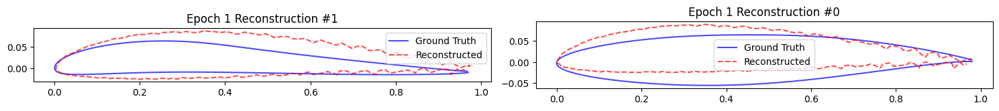

Epoch [2/20] | Loss: 0.009804 | Recon: 0.009803 | KL: 0.000122
Epoch 2 - Test MSE: 0.000750, MAE: 0.019672, RMSE: 0.027249


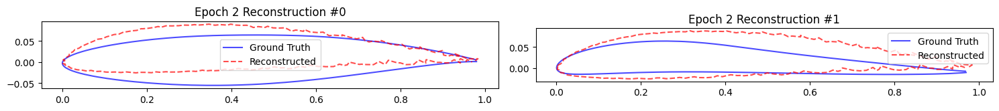

Epoch [3/20] | Loss: 0.009761 | Recon: 0.009760 | KL: 0.000107
Epoch 3 - Test MSE: 0.000757, MAE: 0.019847, RMSE: 0.027425


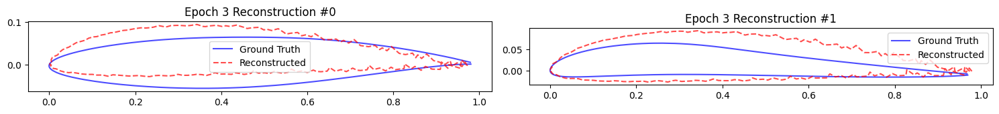

Epoch [4/20] | Loss: 0.009729 | Recon: 0.009728 | KL: 0.000049
Epoch 4 - Test MSE: 0.000871, MAE: 0.021053, RMSE: 0.029186


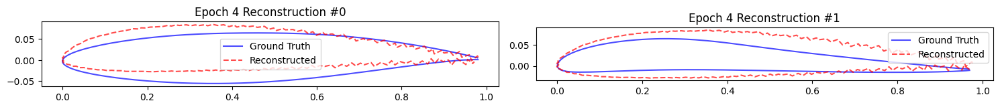

Epoch [5/20] | Loss: 0.009674 | Recon: 0.009673 | KL: 0.000029
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_5.pt
Epoch 5 - Test MSE: 0.000768, MAE: 0.020184, RMSE: 0.027606


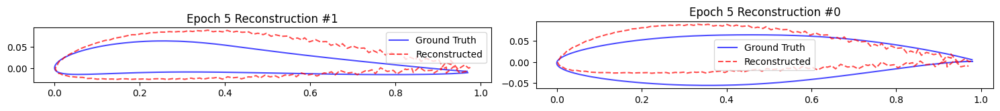

Epoch [6/20] | Loss: 0.009624 | Recon: 0.009624 | KL: 0.000025
Epoch 6 - Test MSE: 0.000795, MAE: 0.020247, RMSE: 0.027883


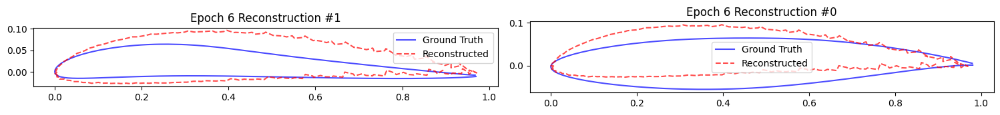

Epoch [7/20] | Loss: 0.009619 | Recon: 0.009619 | KL: 0.000020
Epoch 7 - Test MSE: 0.000721, MAE: 0.019599, RMSE: 0.026819


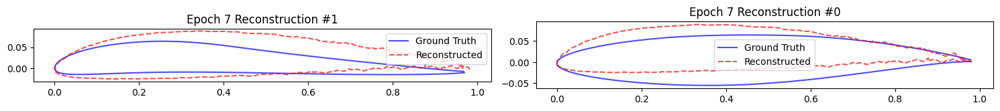

Epoch [8/20] | Loss: 0.009639 | Recon: 0.009639 | KL: 0.000019
Epoch 8 - Test MSE: 0.000830, MAE: 0.020558, RMSE: 0.028284


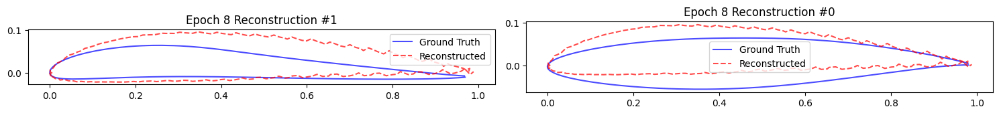

Epoch [9/20] | Loss: 0.009966 | Recon: 0.009616 | KL: 0.035000
Epoch 9 - Test MSE: 0.000758, MAE: 0.020085, RMSE: 0.027366


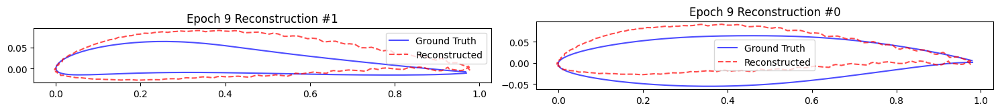

Epoch [10/20] | Loss: 0.009615 | Recon: 0.009615 | KL: 0.000008
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_10.pt
Epoch 10 - Test MSE: 0.000744, MAE: 0.019699, RMSE: 0.027061


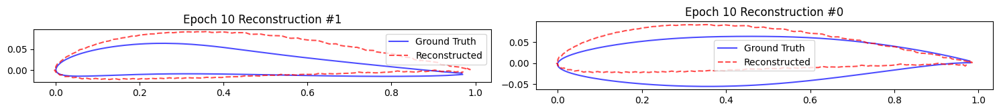

Epoch [11/20] | Loss: 0.009574 | Recon: 0.009574 | KL: 0.000000
Epoch 11 - Test MSE: 0.000730, MAE: 0.020000, RMSE: 0.026991


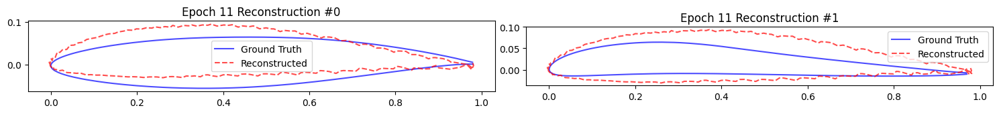

Epoch [12/20] | Loss: 0.009567 | Recon: 0.009567 | KL: 0.000000
Epoch 12 - Test MSE: 0.000741, MAE: 0.019705, RMSE: 0.027123


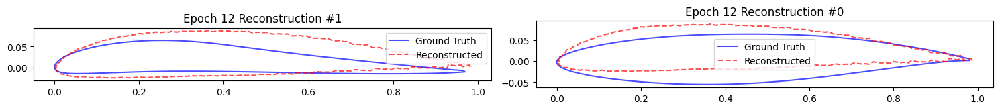

Epoch [13/20] | Loss: 0.009539 | Recon: 0.009539 | KL: 0.000000
Epoch 13 - Test MSE: 0.000765, MAE: 0.019900, RMSE: 0.027516


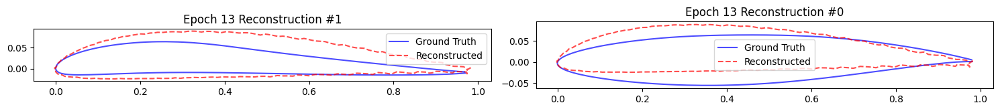

KeyboardInterrupt: 

In [ ]:
import os
import torch
import random
import numpy as np
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary


def train_vae1d(custom_config=None):
    """
    Example training routine for your 1D VAE on Airfoil data.
    """
    # 1) Load config
    if custom_config is not None:
        config = custom_config.config
    else:
        config = Config().config

    dataset_params  = config["dataset_params"]
    ae_params       = config["autoencoder_params"]
    train_params    = config["train_params"]

    seed            = train_params["seed"]
    lr              = train_params["lr"]
    kl_weight       = train_params["kl_weight"]
    num_epochs      = train_params["epochs"]
    checkpoint_dir  = train_params["checkpoint_dir"]
    save_every      = train_params["save_every"]
    report_every      = train_params["report_every"]

    # 2) Set random seed for reproducibility
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    train_dataset = AirfoilDataset(
        xs_path=dataset_params["train_xs"],
        ys_path=dataset_params["train_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    train_loader = DataLoader(
        train_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=dataset_params["shuffle"]
    )

    # Optionally create a test dataset if you want some validation
    # (or pass the same train paths if you don't have a separate test set)
    test_dataset = AirfoilDataset(
        xs_path=dataset_params["test_xs"],
        ys_path=dataset_params["test_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=False
    )

    model = VAE1D_ResAttention(
                  in_channels=2,
                  base_channels=model_config['down_channels'],
                  latent_dim=64,
                  num_heads=model_config['num_heads'],
                  norm_groups=model_config['norm_channels'],
                  down_num_layers=model_config['num_down_layers'],
                  down_attn=model_config['attn_down'],
                  up_num_layers=model_config['num_up_layers'],
                  up_attn=model_config['attn_down'],   # or a different pattern
                  mid_num_layers=model_config['num_mid_layers'],
                  mid_use=True).to(device)

    summary(model, (2, 192))

    # ------------------------------------
    # B) Test a dummy forward pass
    # ------------------------------------
    with torch.no_grad():
        dummy_input = torch.randn(2, 2, 192).to(device)  # batch=1, channels=2, length=192
        recon, (mean, logvar), z = model(dummy_input)
        print(f"\nDummy Input Shape: {dummy_input.shape}")
        print(f"Reconstruction Shape: {recon.shape}")
        print(f"Mean Shape: {mean.shape}, Logvar Shape: {logvar.shape}, z Shape: {z.shape}\n")

    # 5) Define an optimizer
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # 6) Make sure checkpoint directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    # 7) Training loop
    for epoch in range(1, num_epochs + 1):
        model.train()
        epoch_loss = 0.0
        epoch_kld  = 0.0
        epoch_recon= 0.0

        for coords, _ in train_loader:
            # coords shape: (batch, 2, 192)
            coords = coords.to(device)

            # Forward through the VAE
            recon, (mean, logvar), z = model(coords)
            # print(f"recon.shape: ", recon.shape)
            # print(f"coords.shape: ", coords.shape)
            # print(f"coords.shape: ", coord.shape)

            loss, recon_loss, kld = vae_loss_function(recon, coords, mean, logvar, kl_weight=0.1, loss_type="both")
            # Backprop
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Accumulate for the epoch
            epoch_loss  += loss.item() * coords.size(0)
            epoch_recon += recon_loss.item() * coords.size(0)
            epoch_kld   += kld.item() * coords.size(0)

        # Average over the epoch
        dataset_size = len(train_loader.dataset)
        epoch_loss  /= dataset_size
        epoch_recon /= dataset_size
        epoch_kld   /= dataset_size

        print(f"Epoch [{epoch}/{num_epochs}] | "
              f"Loss: {epoch_loss:.6f} | Recon: {epoch_recon:.6f} | KL: {epoch_kld:.6f}")

        # 8) (Optional) Save checkpoint every `save_every` epochs
        if epoch % save_every == 0 or epoch == num_epochs:
            save_path = os.path.join(checkpoint_dir, f"vae1d_epoch_{epoch}.pt")
            torch.save(model.state_dict(), save_path)
            print(f"Checkpoint saved at: {save_path}")


        # Evaluate on test set every epoch or every `save_every`
        if epoch % report_every == 0 or epoch == num_epochs:
            evaluate_on_test_set(model, test_loader, device, epoch_num=epoch,
                                plot_n_samples=2, specific_indices=None,
                                plot_prefix="Epoch")

    print("Training Complete!")



# Define your custom configuration
custom_config = Config()
# custom_config.config["autoencoder_params"]["z_channels"] = 16
# custom_config.config["train_params"]["task_name"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/models"
# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

#### V4_2

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# Make sure your DownBlock1D, MidBlock1D, UpBlock1D
# are in scope (already imported from your code).


class VAE1D_ResAttention(nn.Module):
    """
    A 1D VAE that:
      - uses your DownBlock1D for repeated down-sampling
      - optional MidBlock1D at the smallest resolution
      - flattens to a linear latent (mu/logvar)
      - reparameterize z
      - up-samples via UpBlock1D, optionally a mid-block in reverse
      - final 1D conv to get the reconstruction
    """

    def __init__(
        self,
        in_channels=2,          # e.g. (2, 192) input
        base_channels=[32,64,128,256],  # the progression of channels in the down path
        latent_dim=64,
        # For attention blocks:
        num_heads=4,
        norm_groups=8,
        # Down sampling config:
        down_num_layers=1,  # how many res-attn layers inside each DownBlock1D
        down_attn=[False, False, True],  # which stages get self-attn? length is (len(base_channels)-1)
        # Up sampling config:
        up_num_layers=1,
        up_attn=[False, False, True],
        # Mid block config:
        mid_num_layers=2,   # how many times we do [Attn + CrossAttn + ResNet] in the mid
        mid_use=True
    ):
        super().__init__()

        # -------------------------------------------------
        # A) Encoder
        # -------------------------------------------------
        # 1) Initial Conv
        self.in_conv = nn.Conv1d(in_channels, base_channels[0], kernel_size=3, stride=1, padding=1)

        # 2) Down Blocks
        #    If base_channels = [32,64,128,256], we have len=4. We'll create 3 down stages:
        #       stage0: 32->64, stage1: 64->128, stage2: 128->256
        #    'down_attn' is length=3 => e.g. [False,False,True]
        #    Each DownBlock1D can have 1 or more internal layers (down_num_layers).
        self.down_blocks = nn.ModuleList()
        for i in range(len(base_channels)-1):
            block = DownBlock1D(
                in_channels=base_channels[i],
                out_channels=base_channels[i+1],
                t_emb_dim=None,
                down_sample=True,         # each stage does stride=2
                num_heads=num_heads,
                num_layers=down_num_layers,
                attn=down_attn[i],
                norm_channels=norm_groups
            )
            self.down_blocks.append(block)

        # 3) Optional mid block at the bottom resolution
        #    That is, at shape (B, base_channels[-1], L_small)
        #    We'll do a MidBlock1D with mid_num_layers, no cross-attn.
        #    This does not change shape, just does attn + res
        self.mid_use = mid_use
        if mid_use:
            self.mid_block = MidBlock1D(
                in_channels=base_channels[-1],
                out_channels=base_channels[-1],
                t_emb_dim=None,
                num_heads=num_heads,
                num_layers=mid_num_layers,
                norm_channels=norm_groups,
                cross_attn=False
            )
        else:
            self.mid_block = nn.Identity()

        # 4) Flatten to get global latent
        #    We won't know L_small exactly unless we know the input length & how many downsamples.
        #    Suppose input length = 192 => after 3 downsample => 192->96->48->24
        #    So L_small=24, channels=base_channels[-1]=256 => flatten size=256*24=6144
        #    We'll do a "Linear -> mu, logvar" approach.
        #    But let's not hardcode 24, we might do self.final_len=192/(2^(len(down_blocks)))
        #    or we can just do an adaptive approach in forward().
        #
        #    For convenience, let's define a placeholder for the final conv shape.
        #    We'll find the shape by hooking or by passing a dummy input.
        #    Or we can require the user to pass the known final length.
        #
        #    For demonstration, let's just store them as buffers after a dummy pass if needed.

        # We'll store the linear layers in a separate small submodule:
        # We'll define them after we see the shape in the forward, or we can do a "manual" approach if we know the shape is always 24.
        # For now, let's do a parameter "final_len" that we can set from outside if we know the input length.
        # Another approach is to do a "build" function that runs a dummy forward pass to set the shape.

        self.final_len = 24  # <-- if you know your input is 192 and #downs=3, then length=24
        self.final_ch  = base_channels[-1]
        flat_dim = self.final_ch * self.final_len   # e.g. 256*24=6144

        # small MLP => z
        hidden_dim = 512
        self.fc_enc = nn.Linear(flat_dim, hidden_dim)
        self.fc_mu = nn.Linear(hidden_dim, latent_dim)
        self.fc_logvar = nn.Linear(hidden_dim, latent_dim)

        # -------------------------------------------------
        # B) Decoder
        # -------------------------------------------------
        # We'll do the inverse:
        #  1) z => linear => flatten_dim => reshape => (C=base_channels[-1], L=24)
        #  2) optional mid_block in reverse (still shape not changed)
        #  3) up blocks in reverse order to get back to base_channels[0], length=192
        #  4) final conv to out_channels=2
        #

        self.fc_dec1 = nn.Linear(latent_dim, hidden_dim)
        self.fc_dec2 = nn.Linear(hidden_dim, flat_dim)

        # optional mid block again
        if mid_use:
            self.mid_block_dec = MidBlock1D(
                in_channels=base_channels[-1],
                out_channels=base_channels[-1],
                t_emb_dim=None,
                num_heads=num_heads,
                num_layers=mid_num_layers,
                norm_channels=norm_groups,
                cross_attn=False
            )
        else:
            self.mid_block_dec = nn.Identity()

        # Up Blocks
        # We'll do them in reverse order of base_channels, so 256->128->64->32
        # 'up_attn' must match length=3
        # Each UpBlock1D also has up_sample=True
        self.up_blocks = nn.ModuleList()
        for i in reversed(range(len(base_channels)-1)):
            block = UpBlock1D(
                in_channels=base_channels[i+1],
                out_channels=base_channels[i],
                t_emb_dim=None,
                up_sample=True,        # stride=2
                num_heads=num_heads,
                num_layers=up_num_layers,
                attn=up_attn[i],
                norm_channels=norm_groups
            )
            self.up_blocks.append(block)

        # final 1D conv
        self.out_conv = nn.Conv1d(base_channels[0], in_channels, kernel_size=3, padding=1)


    def encode(self, x):
        """
        x: shape (B, in_channels=2, length=192) [assuming 192 for example]
        """
        out = self.in_conv(x)  # => (B,32,192)
        for block in self.down_blocks:
            out = block(out)   # => final shape e.g. (B,256,24) after 3 downs

        out = self.mid_block(out)  # => (B,256,24) if used

        # flatten
        B, C, L = out.shape
        out = out.reshape(B, -1)  # => (B, C*L)
        h = F.relu(self.fc_enc(out))  # => (B, hidden_dim)
        mu = self.fc_mu(h)            # => (B, latent_dim)
        logvar = self.fc_logvar(h)    # => (B, latent_dim)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        z = mu + eps * std
        return z

    def decode(self, z):
        """
        z: shape (B, latent_dim)
        returns: (B, in_channels, length=192)
        """
        h = F.relu(self.fc_dec1(z))   # (B, hidden_dim)
        out = self.fc_dec2(h)        # (B, C*L) e.g. (B,256*24=6144)
        B = out.size(0)
        out = out.view(B, self.final_ch, self.final_len)  # => (B,256,24)

        out = self.mid_block_dec(out) # => (B,256,24) if used

        # up blocks
        for block in self.up_blocks:
            out = block(out)  # => eventually (B,32,192)

        out = self.out_conv(out)      # => (B,2,192)
        return out

    def forward(self, x):
        """
        returns recon, (mu, logvar), z
        """
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        recon = self.decode(z)
        return recon, (mu, logvar), z


In [ ]:
# Example usage:
model_config = {
    'down_channels': [32,64,128,256],
    'z_channels': 64,      # not used in this version, since we do a global flatten
    'mid_channels': [256, 256],  # if you want that in your original code, but we won't use it here
    'down_sample': [True, True, True],
    'attn_down': [True, True, True],
    'num_down_layers': 2,
    'num_mid_layers': 2,
    'num_up_layers': 2,
    'norm_channels': 8,
    'num_heads': 4
}

vae = VAE1D_ResAttention(
    in_channels=2,
    base_channels=model_config['down_channels'],
    latent_dim=64,
    num_heads=model_config['num_heads'],
    norm_groups=model_config['norm_channels'],
    down_num_layers=model_config['num_down_layers'],
    down_attn=model_config['attn_down'],
    up_num_layers=model_config['num_up_layers'],
    up_attn=model_config['attn_down'],   # or a different pattern
    mid_num_layers=model_config['num_mid_layers'],
    mid_use=True
)

x = torch.randn(4, 2, 192)  # (batch=4)
recon, (mu, logvar), z = vae(x)
print("Input:", x.shape)
print("Recon:", recon.shape)       # (4, 2, 192)
print("mu, logvar:", mu.shape, logvar.shape)  # (4, 64)
print("z:", z.shape)


Input: torch.Size([4, 2, 192])
Recon: torch.Size([4, 2, 192])
mu, logvar: torch.Size([4, 64]) torch.Size([4, 64])
z: torch.Size([4, 64])


In [ ]:
def vae_loss_function(recon, x, mu, logvar, recon_weight=100, kl_weight=1.0, loss_type="mse"):
    if loss_type == "mse":
        recon_loss = F.mse_loss(recon, x, reduction="mean")
    elif loss_type == "l1":
        recon_loss = F.l1_loss(recon, x, reduction="mean")
    else: # both
        recon_loss = 0.5 * F.mse_loss(recon, x, reduction="mean") + \
                     0.5 * F.l1_loss(recon, x, reduction="mean")

    kld_per_sample = 0.5 * torch.sum(torch.exp(logvar) + mu**2 - 1.0 - logvar, dim=1)
    kld = torch.mean(kld_per_sample)

    loss = recon_weight * recon_loss + kl_weight * kld
    return loss, recon_loss, kld


Using device: cuda
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv1d-1              [-1, 32, 192]             224
         GroupNorm-2              [-1, 32, 192]              64
              SiLU-3              [-1, 32, 192]               0
            Conv1d-4              [-1, 64, 192]           6,208
         GroupNorm-5              [-1, 64, 192]             128
              SiLU-6              [-1, 64, 192]               0
            Conv1d-7              [-1, 64, 192]          12,352
            Conv1d-8              [-1, 64, 192]           2,112
         GroupNorm-9              [-1, 64, 192]             128
MultiheadAttention-10  [[-1, 192, 64], [-1, 192, 192]]               0
        GroupNorm-11              [-1, 64, 192]             128
             SiLU-12              [-1, 64, 192]               0
           Conv1d-13              [-1, 64, 192]          12,352
        Group

<ipython-input-18-937e767fd041>:55: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  return torch.tensor(coords_tensor, dtype=torch.float32), label_tensor


Epoch [1/20] | Loss: 1.574651 | Recon: 0.015671 | KL: 0.007575
Epoch 1 - Test MSE: 0.000770, MAE: 0.020127, RMSE: 0.027642


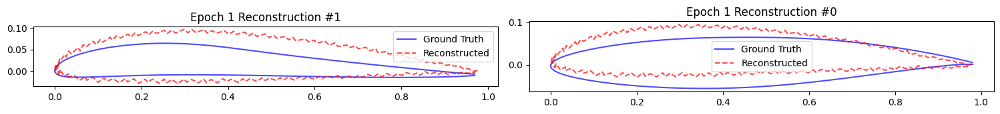

Epoch [2/20] | Loss: 1.000824 | Recon: 0.009987 | KL: 0.002098
Epoch 2 - Test MSE: 0.000820, MAE: 0.021864, RMSE: 0.028605


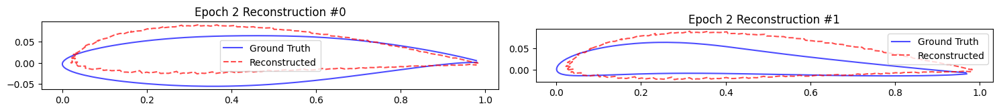

Epoch [3/20] | Loss: 0.991825 | Recon: 0.009918 | KL: 0.000015
Epoch 3 - Test MSE: 0.000757, MAE: 0.020335, RMSE: 0.027456


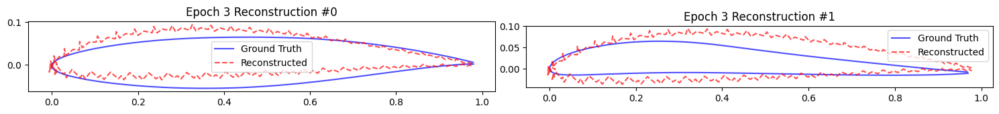

Epoch [4/20] | Loss: 0.985125 | Recon: 0.009851 | KL: 0.000011
Epoch 4 - Test MSE: 0.000840, MAE: 0.021136, RMSE: 0.028752


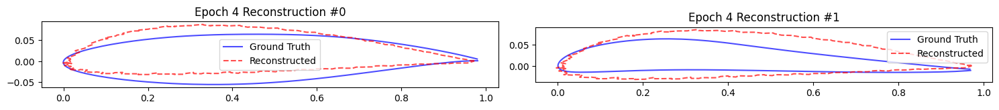

Epoch [5/20] | Loss: 0.978622 | Recon: 0.009786 | KL: 0.000009
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_5.pt
Epoch 5 - Test MSE: 0.000717, MAE: 0.019773, RMSE: 0.026664


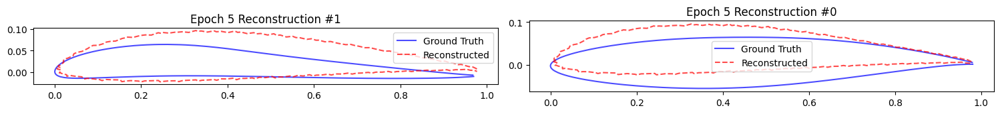

Epoch [6/20] | Loss: 0.971703 | Recon: 0.009717 | KL: 0.000005
Epoch 6 - Test MSE: 0.000710, MAE: 0.019680, RMSE: 0.026506


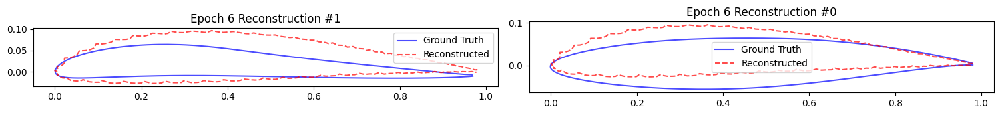

Epoch [7/20] | Loss: 0.972359 | Recon: 0.009724 | KL: 0.000005
Epoch 7 - Test MSE: 0.000763, MAE: 0.020182, RMSE: 0.027537


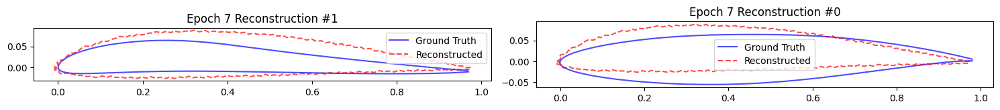

Epoch [8/20] | Loss: 0.970621 | Recon: 0.009706 | KL: 0.000004
Epoch 8 - Test MSE: 0.000760, MAE: 0.020396, RMSE: 0.027455


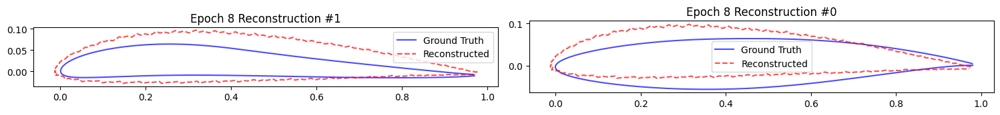

Epoch [9/20] | Loss: 0.966767 | Recon: 0.009668 | KL: 0.000003
Epoch 9 - Test MSE: 0.000736, MAE: 0.020370, RMSE: 0.027108


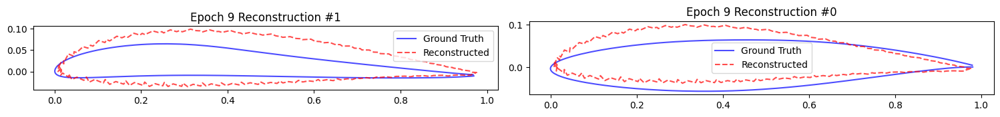

Epoch [10/20] | Loss: 0.970097 | Recon: 0.009701 | KL: 0.000003
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_10.pt
Epoch 10 - Test MSE: 0.000865, MAE: 0.021228, RMSE: 0.028980


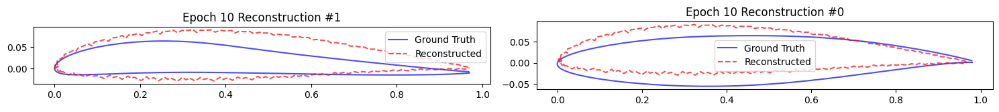

Epoch [11/20] | Loss: 0.963796 | Recon: 0.009638 | KL: 0.000002
Epoch 11 - Test MSE: 0.000849, MAE: 0.020981, RMSE: 0.028658


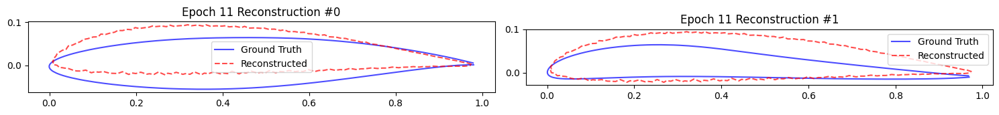

Epoch [12/20] | Loss: 0.964274 | Recon: 0.009643 | KL: 0.000002
Epoch 12 - Test MSE: 0.000739, MAE: 0.019889, RMSE: 0.027134


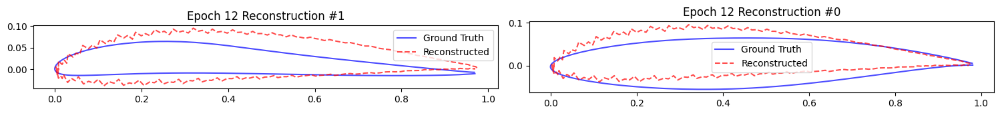

Epoch [13/20] | Loss: 0.964012 | Recon: 0.009640 | KL: 0.000002
Epoch 13 - Test MSE: 0.000754, MAE: 0.019980, RMSE: 0.027381


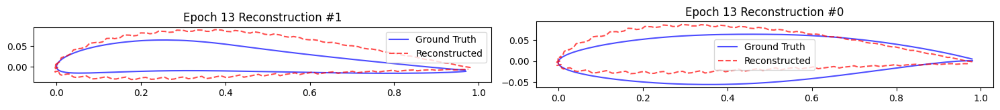

Epoch [14/20] | Loss: 0.961244 | Recon: 0.009612 | KL: 0.000002
Epoch 14 - Test MSE: 0.000804, MAE: 0.020469, RMSE: 0.028036


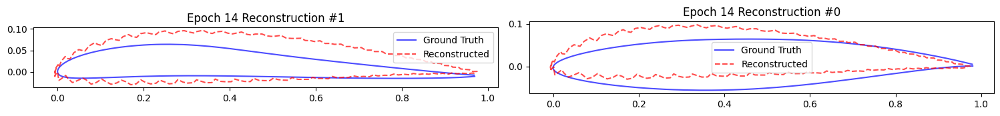

Epoch [15/20] | Loss: 0.960873 | Recon: 0.009609 | KL: 0.000001
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_15.pt
Epoch 15 - Test MSE: 0.000732, MAE: 0.019855, RMSE: 0.026929


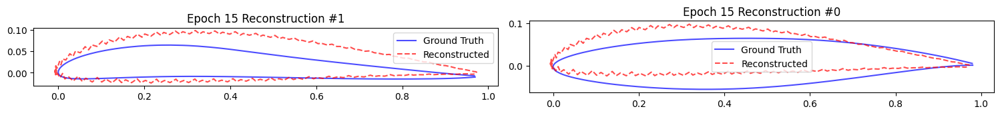

Epoch [16/20] | Loss: 0.960343 | Recon: 0.009603 | KL: 0.000001
Epoch 16 - Test MSE: 0.000730, MAE: 0.019622, RMSE: 0.026864


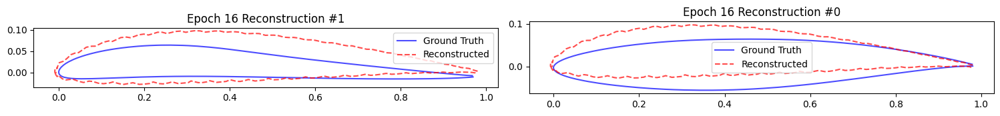

Epoch [17/20] | Loss: 0.956445 | Recon: 0.009564 | KL: 0.000001
Epoch 17 - Test MSE: 0.000769, MAE: 0.020450, RMSE: 0.027542


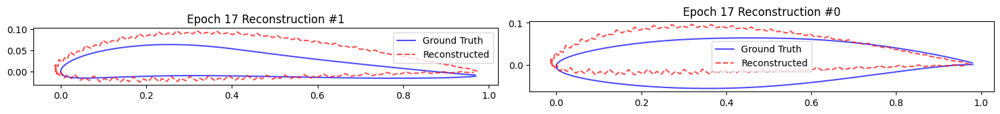

Epoch [18/20] | Loss: 0.958616 | Recon: 0.009586 | KL: 0.000001
Epoch 18 - Test MSE: 0.000723, MAE: 0.019415, RMSE: 0.026701


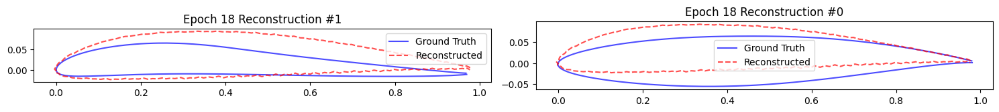

Epoch [19/20] | Loss: 2840.274674 | Recon: 0.010143 | KL: 2839.260409
Epoch 19 - Test MSE: 0.000775, MAE: 0.020173, RMSE: 0.027740


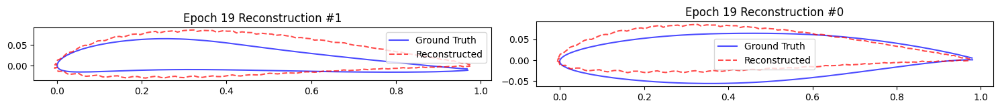

Epoch [20/20] | Loss: 1.048802 | Recon: 0.009547 | KL: 0.094137
Checkpoint saved at: /content/vae_checkpoints/vae1d_epoch_20.pt
Epoch 20 - Test MSE: 0.000765, MAE: 0.020242, RMSE: 0.027476


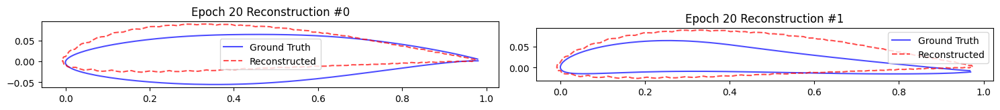

Training Complete!


In [ ]:
import os
import torch
import random
import numpy as np
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary


def train_vae1d(custom_config=None):
    """
    Example training routine for your 1D VAE on Airfoil data.
    """
    # 1) Load config
    if custom_config is not None:
        config = custom_config.config
    else:
        config = Config().config

    dataset_params  = config["dataset_params"]
    ae_params       = config["autoencoder_params"]
    train_params    = config["train_params"]

    seed            = train_params["seed"]
    lr              = train_params["lr"]
    kl_weight       = train_params["kl_weight"]
    num_epochs      = train_params["epochs"]
    checkpoint_dir  = train_params["checkpoint_dir"]
    save_every      = train_params["save_every"]
    report_every    = train_params["report_every"]

    # 2) Set random seed for reproducibility
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    train_dataset = AirfoilDataset(
        xs_path=dataset_params["train_xs"],
        ys_path=dataset_params["train_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    train_loader = DataLoader(
        train_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=dataset_params["shuffle"]
    )

    # Optionally create a test dataset if you want some validation
    # (or pass the same train paths if you don't have a separate test set)
    test_dataset = AirfoilDataset(
        xs_path=dataset_params["test_xs"],
        ys_path=dataset_params["test_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=False
    )

    model = VAE1D_ResAttention(
                  in_channels=2,
                  base_channels=model_config['down_channels'],
                  latent_dim=64,
                  num_heads=model_config['num_heads'],
                  norm_groups=model_config['norm_channels'],
                  down_num_layers=model_config['num_down_layers'],
                  down_attn=model_config['attn_down'],
                  up_num_layers=model_config['num_up_layers'],
                  up_attn=model_config['attn_down'],   # or a different pattern
                  mid_num_layers=model_config['num_mid_layers'],
                  mid_use=True).to(device)

    summary(model, (2, 192))

    # ------------------------------------
    # B) Test a dummy forward pass
    # ------------------------------------
    with torch.no_grad():
        dummy_input = torch.randn(2, 2, 192).to(device)  # batch=1, channels=2, length=192
        recon, (mean, logvar), z = model(dummy_input)
        print(f"\nDummy Input Shape: {dummy_input.shape}")
        print(f"Reconstruction Shape: {recon.shape}")
        print(f"Mean Shape: {mean.shape}, Logvar Shape: {logvar.shape}, z Shape: {z.shape}\n")

    # 5) Define an optimizer
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # 6) Make sure checkpoint directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    # 7) Training loop
    for epoch in range(1, num_epochs + 1):
        model.train()
        epoch_loss = 0.0
        epoch_kld  = 0.0
        epoch_recon= 0.0

        for coords, _ in train_loader:
            # coords shape: (batch, 2, 192)
            coords = coords.to(device)

            # Forward through the VAE
            recon, (mean, logvar), z = model(coords)
            # print(f"recon.shape: ", recon.shape)
            # print(f"coords.shape: ", coords.shape)
            # print(f"coords.shape: ", coord.shape)

            loss, recon_loss, kld = vae_loss_function(recon, coords, mean, logvar, loss_type="both")
            # Backprop
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Accumulate for the epoch
            epoch_loss  += loss.item() * coords.size(0)
            epoch_recon += recon_loss.item() * coords.size(0)
            epoch_kld   += kld.item() * coords.size(0)

        # Average over the epoch
        dataset_size = len(train_loader.dataset)
        epoch_loss  /= dataset_size
        epoch_recon /= dataset_size
        epoch_kld   /= dataset_size

        print(f"Epoch [{epoch}/{num_epochs}] | "
              f"Loss: {epoch_loss:.6f} | Recon: {epoch_recon:.6f} | KL: {epoch_kld:.6f}")

        # 8) (Optional) Save checkpoint every `save_every` epochs
        if epoch % save_every == 0 or epoch == num_epochs:
            save_path = os.path.join(checkpoint_dir, f"vae1d_epoch_{epoch}.pt")
            torch.save(model.state_dict(), save_path)
            print(f"Checkpoint saved at: {save_path}")


        # Evaluate on test set every epoch or every `save_every`
        if epoch % report_every == 0 or epoch == num_epochs:
            evaluate_on_test_set(model, test_loader, device, epoch_num=epoch,
                                plot_n_samples=2, specific_indices=None,
                                plot_prefix="Epoch")

    print("Training Complete!")



# Define your custom configuration
custom_config = Config()
# custom_config.config["autoencoder_params"]["z_channels"] = 16
# custom_config.config["train_params"]["task_name"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/models"
# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

#### V5

In [ ]:

class Encoder(nn.Module):
    def __init__(self, input_channels, latent_dim):
        super(Encoder, self).__init__()
        self.conv1 = nn.Conv1d(input_channels, 16, kernel_size=3, stride=2, padding=1)
        self.conv2 = nn.Conv1d(16, 32, kernel_size=3, stride=2, padding=1)
        self.conv3 = nn.Conv1d(32, 64, kernel_size=3, stride=2, padding=1)
        self.fc1 = nn.Linear(64*8, 128)  # Adjust based on the size of the feature map
        self.fc2 = nn.Linear(128, latent_dim)
        self.fc3 = nn.Linear(128, latent_dim)

    def forward(self, x):
        x = torch.relu(self.conv1(x))
        x = torch.relu(self.conv2(x))
        x = torch.relu(self.conv3(x))
        x = x.view(x.size(0), -1)
        x = torch.relu(self.fc1(x))
        mu = self.fc2(x)
        logvar = self.fc3(x)
        return mu, logvar

class Decoder(nn.Module):
    def __init__(self, latent_dim, output_channels):
        super(Decoder, self).__init__()
        self.fc1 = nn.Linear(latent_dim, 128)
        self.fc2 = nn.Linear(128, 64*8)  # Adjust based on the size of the feature map
        self.deconv1 = nn.ConvTranspose1d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.deconv2 = nn.ConvTranspose1d(32, 16, kernel_size=3, stride=2, padding=1, output_padding=1)
        self.deconv3 = nn.ConvTranspose1d(16, output_channels, kernel_size=3, stride=2, padding=1, output_padding=1)

    def forward(self, x):
        x = torch.relu(self.fc1(x))
        x = torch.relu(self.fc2(x))
        x = x.view(x.size(0), 64, 8, 8)  # Adjust based on the size of the feature map
        x = torch.relu(self.deconv1(x))
        x = torch.relu(self.deconv2(x))
        x = torch.sigmoid(self.deconv3(x))
        return x


class VAE(nn.Module):
    def __init__(self, input_channels, latent_dim, output_channels):
        super(VAE, self).__init__()
        self.enc = Encoder(input_channels, latent_dim)
        self.dec = Decoder(latent_dim, output_channels)

    def forward(self, x):
        mu, logvar = self.enc(x)
        z = self.reparameterize(mu, logvar)
        return self.dec(z), mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        return self.dec(z)


def kl_divergence(mu, logvar):
    return -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())


def train(args):
    setup_logging(args.run_name)
    device = args.device
    dataset = AirfoilDataset(args.dataset_path, num_points_per_side=args.num_airfoil_points)
    dataloader = DataLoader(dataset, batch_size=args.batch_size, shuffle=True)

    # Update the model initialization to match the modified architecture
    model = VAE(input_channels=2, latent_dim=args.latent_dim, output_channels=2).to(device)

    optimizer = torch.optim.Adam(model.parameters(), lr=args.lr)
    for epoch in range(args.epochs):
        model.train()
        for i, data in enumerate(dataloader):
            airfoil = data['train_coords'].to(device).float()  # Use 'train_coords' which is the reshaped 2D data
            print(f'Airfoil shape: {airfoil.shape}')
            optimizer.zero_grad()
            recon_airfoil, mu, logvar = model(airfoil)

            # Calculate the loss
            kl_loss = 0.1 * kl_divergence(mu, logvar)
            recon_loss = 10 * F.mse_loss(recon_airfoil, airfoil)
            loss = kl_loss + recon_loss

            loss.backward()
            optimizer.step()

            if i % args.log_interval == 0:
                logging.info(f"Epoch {epoch}, Batch {i}, Loss: {loss.item()}, KL Loss: {kl_loss.item()}, Recon Loss: {recon_loss.item()}")

        if epoch % args.save_interval == 0:
            torch.save(model.state_dict(), f"vae_epoch_{epoch}.pt")

def launch():
    import argparse
    parser = argparse.ArgumentParser()
    parser.add_argument('--run_name', type=str, default='vae')
    parser.add_argument('--device', type=str, default='cuda')
    parser.add_argument('--dataset_path', type=str, default='coord_seligFmt/')
    parser.add_argument('--num_airfoil_points', type=int, default=100)
    parser.add_argument('--latent_dim', type=int, default=32)
    parser.add_argument('--lr', type=float, default=1e-3)
    parser.add_argument('--epochs', type=int, default=1001)
    parser.add_argument('--batch_size', type=int, default=256)
    parser.add_argument('--log_interval', type=int, default=100)
    parser.add_argument('--save_interval', type=int, default=100)
    args = parser.parse_args()
    train(args)

if __name__ == '__main__':
    launch()

In [ ]:
import os
import torch
import random
import numpy as np
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim
from torchsummary import summary


def train_vae1d(custom_config=None):
    """
    Example training routine for your 1D VAE on Airfoil data.
    """
    # 1) Load config
    if custom_config is not None:
        config = custom_config.config
    else:
        config = Config().config

    dataset_params  = config["dataset_params"]
    ae_params       = config["autoencoder_params"]
    train_params    = config["train_params"]

    seed            = train_params["seed"]
    lr              = train_params["lr"]
    kl_weight       = train_params["kl_weight"]
    num_epochs      = train_params["epochs"]
    checkpoint_dir  = train_params["checkpoint_dir"]
    save_every      = train_params["save_every"]
    report_every      = train_params["report_every"]

    # 2) Set random seed for reproducibility
    torch.manual_seed(seed)
    np.random.seed(seed)
    random.seed(seed)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    train_dataset = AirfoilDataset(
        xs_path=dataset_params["train_xs"],
        ys_path=dataset_params["train_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    train_loader = DataLoader(
        train_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=dataset_params["shuffle"]
    )

    # Optionally create a test dataset if you want some validation
    # (or pass the same train paths if you don't have a separate test set)
    test_dataset = AirfoilDataset(
        xs_path=dataset_params["test_xs"],
        ys_path=dataset_params["test_ys"],
        y_min_path=dataset_params["y_min"],
        y_max_path=dataset_params["y_max"]
    )
    test_loader = DataLoader(
        test_dataset,
        batch_size=dataset_params["batch_size"],
        shuffle=False
    )

    # model = VAE1D_ResAttention(
    #               in_channels=2,
    #               base_channels=model_config['down_channels'],
    #               latent_dim=64,
    #               num_heads=model_config['num_heads'],
    #               norm_groups=model_config['norm_channels'],
    #               down_num_layers=model_config['num_down_layers'],
    #               down_attn=model_config['attn_down'],
    #               up_num_layers=model_config['num_up_layers'],
    #               up_attn=model_config['attn_down'],   # or a different pattern
    #               mid_num_layers=model_config['num_mid_layers'],
    #               mid_use=True).to(device)
    model = VAE(input_channels=2, latent_dim=args.latent_dim, output_channels=2).to(device)

    summary(model, (2, 192))

    # ------------------------------------
    # B) Test a dummy forward pass
    # ------------------------------------
    with torch.no_grad():
        dummy_input = torch.randn(2, 2, 192).to(device)  # batch=1, channels=2, length=192
        recon, (mean, logvar), z = model(dummy_input)
        print(f"\nDummy Input Shape: {dummy_input.shape}")
        print(f"Reconstruction Shape: {recon.shape}")
        print(f"Mean Shape: {mean.shape}, Logvar Shape: {logvar.shape}, z Shape: {z.shape}\n")

    # 5) Define an optimizer
    optimizer = optim.Adam(model.parameters(), lr=lr)

    # 6) Make sure checkpoint directory exists
    os.makedirs(checkpoint_dir, exist_ok=True)

    # 7) Training loop
    for epoch in range(1, num_epochs + 1):
        model.train()
        epoch_loss = 0.0
        epoch_kld  = 0.0
        epoch_recon= 0.0

        for coords, _ in train_loader:
            # coords shape: (batch, 2, 192)
            coords = coords.to(device)

            # Forward through the VAE
            recon, (mean, logvar), z = model(coords)
            # print(f"recon.shape: ", recon.shape)
            # print(f"coords.shape: ", coords.shape)
            # print(f"coords.shape: ", coord.shape)

            loss, recon_loss, kld = vae_loss_function(recon, coords, mean, logvar, kl_weight=0.1, loss_type="both")
            # Backprop
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Accumulate for the epoch
            epoch_loss  += loss.item() * coords.size(0)
            epoch_recon += recon_loss.item() * coords.size(0)
            epoch_kld   += kld.item() * coords.size(0)

        # Average over the epoch
        dataset_size = len(train_loader.dataset)
        epoch_loss  /= dataset_size
        epoch_recon /= dataset_size
        epoch_kld   /= dataset_size

        print(f"Epoch [{epoch}/{num_epochs}] | "
              f"Loss: {epoch_loss:.6f} | Recon: {epoch_recon:.6f} | KL: {epoch_kld:.6f}")

        # 8) (Optional) Save checkpoint every `save_every` epochs
        if epoch % save_every == 0 or epoch == num_epochs:
            save_path = os.path.join(checkpoint_dir, f"vae1d_epoch_{epoch}.pt")
            torch.save(model.state_dict(), save_path)
            print(f"Checkpoint saved at: {save_path}")


        # Evaluate on test set every epoch or every `save_every`
        if epoch % report_every == 0 or epoch == num_epochs:
            evaluate_on_test_set(model, test_loader, device, epoch_num=epoch,
                                plot_n_samples=2, specific_indices=None,
                                plot_prefix="Epoch")

    print("Training Complete!")



# Define your custom configuration
custom_config = Config()
# custom_config.config["autoencoder_params"]["z_channels"] = 16
# custom_config.config["train_params"]["task_name"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/models"
# custom_config.config["train_params"]["plot_save_path"] = "/content/drive/My Drive/AI/Projects/VAE/Mnist/variable_latent_sizes/latent_16/V1/plots"

# Call the train_VAE function with the custom configuration
train_vae1d(custom_config=custom_config)

## Diffusion

### Model

In [14]:
!pip install wandb accelerate ema-pytorch tqdm torch torchvision numpy matplotlib einops


In [15]:
!pip install denoising-diffusion-pytorch


In [16]:
import os
import math
from pathlib import Path
from random import random
from functools import partial
from collections import namedtuple
from multiprocessing import cpu_count

import torch
from torch import nn, einsum, Tensor
from torch.nn import Module, ModuleList
import torch.nn.functional as F
from torch.cuda.amp import autocast
from torch.optim import Adam
from torch.utils.data import Dataset, DataLoader

from einops import rearrange, reduce
from einops.layers.torch import Rearrange

from accelerate import Accelerator
from ema_pytorch import EMA

from tqdm.auto import tqdm

from denoising_diffusion_pytorch.version import __version__

# constants

ModelPrediction =  namedtuple('ModelPrediction', ['pred_noise', 'pred_x_start'])

model_save_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM"
os.makedirs(model_save_dir, exist_ok=True)

# helpers functions

def exists(x):
    return x is not None

def default(val, d):
    if exists(val):
        return val
    return d() if callable(d) else d

def identity(t, *args, **kwargs):
    return t

def cycle(dl):
    while True:
        for data in dl:
            yield data

def has_int_squareroot(num):
    return (math.sqrt(num) ** 2) == num

def num_to_groups(num, divisor):
    groups = num // divisor
    remainder = num % divisor
    arr = [divisor] * groups
    if remainder > 0:
        arr.append(remainder)
    return arr

def convert_image_to_fn(img_type, image):
    if image.mode != img_type:
        return image.convert(img_type)
    return image

# normalization functions

def normalize_to_neg_one_to_one(img):
    return img * 2 - 1

def unnormalize_to_zero_to_one(t):
    return (t + 1) * 0.5

# data

class Dataset1D(Dataset):
    def __init__(self, tensor: Tensor):
        super().__init__()
        self.tensor = tensor.clone()

    def __len__(self):
        return len(self.tensor)

    def __getitem__(self, idx):
        return self.tensor[idx].clone()

# small helper modules

class Residual(Module):
    def __init__(self, fn):
        super().__init__()
        self.fn = fn

    def forward(self, x, *args, **kwargs):
        return self.fn(x, *args, **kwargs) + x
'''
def Upsample(dim, dim_out = None):
    return nn.Sequential(
        nn.Upsample(scale_factor = 2, mode = 'nearest'),
        nn.Conv1d(dim, default(dim_out, dim), 3, padding = 1)
    )

def Downsample(dim, dim_out = None):
    return nn.Conv1d(dim, default(dim_out, dim), 4, 2, 1)
'''

def Downsample(dim, dim_out=None):
    return nn.Sequential(
        nn.Conv1d(dim, default(dim_out, dim), 4, stride=2, padding=1)
    )

def Upsample(dim, dim_out=None):
    return nn.Sequential(
        nn.ConvTranspose1d(dim, default(dim_out, dim), 4, stride=2, padding=1, output_padding=1)
    )


class RMSNorm(nn.Module):
    def __init__(self, dim, eps=1e-8):
        super().__init__()
        self.g   = nn.Parameter(torch.ones(1, dim, 1))
        self.eps = eps

    def forward(self, x):
        # x: (B, C, L); compute rms over L for each channel
        rms = x.pow(2).mean(dim=2, keepdim=True).add(self.eps).sqrt()
        return (x / rms) * self.g


class PreNorm(Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.fn = fn
        self.norm = RMSNorm(dim)

    def forward(self, x):
        x = self.norm(x)
        return self.fn(x)

# sinusoidal positional embeds

class SinusoidalPosEmb(Module):
    def __init__(self, dim, theta = 10000):
        super().__init__()
        self.dim = dim
        self.theta = theta

    def forward(self, x):
        device = x.device
        half_dim = self.dim // 2
        emb = math.log(self.theta) / (half_dim - 1)
        emb = torch.exp(torch.arange(half_dim, device=device) * -emb)
        emb = x[:, None] * emb[None, :]
        emb = torch.cat((emb.sin(), emb.cos()), dim=-1)
        return emb

class RandomOrLearnedSinusoidalPosEmb(Module):
    """ following @crowsonkb 's lead with random (learned optional) sinusoidal pos emb """
    """ https://github.com/crowsonkb/v-diffusion-jax/blob/master/diffusion/models/danbooru_128.py#L8 """

    def __init__(self, dim, is_random = False):
        super().__init__()
        assert (dim % 2) == 0
        half_dim = dim // 2
        self.weights = nn.Parameter(torch.randn(half_dim), requires_grad = not is_random)

    def forward(self, x):
        x = rearrange(x, 'b -> b 1')
        freqs = x * rearrange(self.weights, 'd -> 1 d') * 2 * math.pi
        fouriered = torch.cat((freqs.sin(), freqs.cos()), dim = -1)
        fouriered = torch.cat((x, fouriered), dim = -1)
        return fouriered

# building block modules

class Block(Module):
    def __init__(self, dim, dim_out, dropout = 0.):
        super().__init__()
        self.proj = nn.Conv1d(dim, dim_out, 3, padding = 1)
        self.norm = RMSNorm(dim_out)
        self.act = nn.SiLU()
        self.dropout = nn.Dropout(dropout)

    def forward(self, x, scale_shift = None):
        x = self.proj(x)
        x = self.norm(x)

        if exists(scale_shift):
            scale, shift = scale_shift
            x = x * (scale + 1) + shift

        x = self.act(x)
        return self.dropout(x)

class ResnetBlock(Module):
    def __init__(self, dim, dim_out, *, time_emb_dim = None, dropout = 0.):
        super().__init__()
        self.mlp = nn.Sequential(
            nn.SiLU(),
            nn.Linear(time_emb_dim, dim_out * 2)
        ) if exists(time_emb_dim) else None

        self.block1 = Block(dim, dim_out, dropout = dropout)
        self.block2 = Block(dim_out, dim_out)
        self.res_conv = nn.Conv1d(dim, dim_out, 1) if dim != dim_out else nn.Identity()

    def forward(self, x, time_emb = None):

        scale_shift = None
        if exists(self.mlp) and exists(time_emb):
            time_emb = self.mlp(time_emb)
            time_emb = rearrange(time_emb, 'b c -> b c 1')
            scale_shift = time_emb.chunk(2, dim = 1)

        h = self.block1(x, scale_shift = scale_shift)

        h = self.block2(h)

        return h + self.res_conv(x)

class LinearAttention(Module):
    def __init__(self, dim, heads = 4, dim_head = 32):
        super().__init__()
        self.scale = dim_head ** -0.5
        self.heads = heads
        hidden_dim = dim_head * heads
        self.to_qkv = nn.Conv1d(dim, hidden_dim * 3, 1, bias = False)

        self.to_out = nn.Sequential(
            nn.Conv1d(hidden_dim, dim, 1),
            RMSNorm(dim)
        )

    def forward(self, x):
        b, c, n = x.shape
        qkv = self.to_qkv(x).chunk(3, dim = 1)
        q, k, v = map(lambda t: rearrange(t, 'b (h c) n -> b h c n', h = self.heads), qkv)

        q = q.softmax(dim = -2)
        k = k.softmax(dim = -1)

        q = q * self.scale

        context = torch.einsum('b h d n, b h e n -> b h d e', k, v)

        out = torch.einsum('b h d e, b h d n -> b h e n', context, q)
        out = rearrange(out, 'b h c n -> b (h c) n', h = self.heads)
        return self.to_out(out)

class Attention(Module):
    def __init__(self, dim, heads = 4, dim_head = 32):
        super().__init__()
        self.scale = dim_head ** -0.5
        self.heads = heads
        hidden_dim = dim_head * heads

        self.to_qkv = nn.Conv1d(dim, hidden_dim * 3, 1, bias = False)
        self.to_out = nn.Conv1d(hidden_dim, dim, 1)

    def forward(self, x):
        b, c, n = x.shape
        qkv = self.to_qkv(x).chunk(3, dim = 1)
        q, k, v = map(lambda t: rearrange(t, 'b (h c) n -> b h c n', h = self.heads), qkv)

        q = q * self.scale

        sim = einsum('b h d i, b h d j -> b h i j', q, k)
        attn = sim.softmax(dim = -1)
        out = einsum('b h i j, b h d j -> b h i d', attn, v)

        out = rearrange(out, 'b h n d -> b (h d) n')
        return self.to_out(out)

# model

class Unet1D(Module):
    def __init__(
        self,
        dim,
        init_dim = None,
        out_dim = None,
        dim_mults=(1, 2, 4, 8),
        channels = 3,
        dropout = 0.,
        learned_variance = False,
        learned_sinusoidal_cond = False,
        random_fourier_features = False,
        learned_sinusoidal_dim = 16,
        sinusoidal_pos_emb_theta = 10000,
        attn_dim_head = 32,
        attn_heads = 4
    ):
        super().__init__()

        # determine dimensions

        self.channels = channels
        input_channels = channels

        init_dim = default(init_dim, dim)
        self.init_conv = nn.Conv1d(input_channels, init_dim, 7, padding = 3)

        dims = [init_dim, *map(lambda m: dim * m, dim_mults)]
        in_out = list(zip(dims[:-1], dims[1:]))

        # time embeddings

        time_dim = dim * 4

        self.random_or_learned_sinusoidal_cond = learned_sinusoidal_cond or random_fourier_features

        if self.random_or_learned_sinusoidal_cond:
            sinu_pos_emb = RandomOrLearnedSinusoidalPosEmb(learned_sinusoidal_dim, random_fourier_features)
            fourier_dim = learned_sinusoidal_dim + 1
        else:
            sinu_pos_emb = SinusoidalPosEmb(dim, theta = sinusoidal_pos_emb_theta)
            fourier_dim = dim

        self.time_mlp = nn.Sequential(
            sinu_pos_emb,
            nn.Linear(fourier_dim, time_dim),
            nn.GELU(),
            nn.Linear(time_dim, time_dim)
        )

        resnet_block = partial(ResnetBlock, time_emb_dim = time_dim, dropout = dropout)

        # layers

        self.downs = ModuleList([])
        self.ups = ModuleList([])
        num_resolutions = len(in_out)

        for ind, (dim_in, dim_out) in enumerate(in_out):
            is_last = ind >= (num_resolutions - 1)

            self.downs.append(ModuleList([
                resnet_block(dim_in, dim_in),
                resnet_block(dim_in, dim_in),
                Residual(PreNorm(dim_in, LinearAttention(dim_in))),
                Downsample(dim_in, dim_out) if not is_last else nn.Conv1d(dim_in, dim_out, 3, padding = 1)
            ]))

        mid_dim = dims[-1]
        self.mid_block1 = resnet_block(mid_dim, mid_dim)
        self.mid_attn = Residual(PreNorm(mid_dim, Attention(mid_dim, dim_head = attn_dim_head, heads = attn_heads)))
        self.mid_block2 = resnet_block(mid_dim, mid_dim)

        for ind, (dim_in, dim_out) in enumerate(reversed(in_out)):
            is_last = ind == (len(in_out) - 1)

            self.ups.append(ModuleList([
                resnet_block(dim_out + dim_in, dim_out),
                resnet_block(dim_out + dim_in, dim_out),
                Residual(PreNorm(dim_out, LinearAttention(dim_out))),
                Upsample(dim_out, dim_in) if not is_last else  nn.Conv1d(dim_out, dim_in, 3, padding = 1)
            ]))

        default_out_dim = channels * (1 if not learned_variance else 2)
        self.out_dim = default(out_dim, default_out_dim)

        self.final_res_block = resnet_block(init_dim * 2, init_dim)
        self.final_conv = nn.Conv1d(init_dim, self.out_dim, 1)


    def forward(self, x, time):
        x = self.init_conv(x)
        r = x.clone()

        t = self.time_mlp(time)

        h = []

        for block1, block2, attn, downsample in self.downs:
            x = block1(x, t)
            h.append(x)

            x = block2(x, t)
            x = attn(x)
            h.append(x)

            x = downsample(x)

        x = self.mid_block1(x, t)
        x = self.mid_attn(x)
        x = self.mid_block2(x, t)

        for block1, block2, attn, upsample in self.ups:
            x_skip = h.pop()
            if x.shape[-1] != x_skip.shape[-1]:
                # Adjust the size by trimming or padding
                if x.shape[-1] > x_skip.shape[-1]:
                    x = x[..., :x_skip.shape[-1]]
                else:
                    x_skip = x_skip[..., :x.shape[-1]]

            x = torch.cat((x, x_skip), dim=1)
            x = block1(x, t)

            x_skip = h.pop()
            if x.shape[-1] != x_skip.shape[-1]:
                if x.shape[-1] > x_skip.shape[-1]:
                    x = x[..., :x_skip.shape[-1]]
                else:
                    x_skip = x_skip[..., :x.shape[-1]]

            x = torch.cat((x, x_skip), dim=1)
            x = block2(x, t)
            x = attn(x)

            x = upsample(x)

        x = torch.cat((x, r), dim=1)

        x = self.final_res_block(x, t)
        return self.final_conv(x)

class Unet1DConditional(Module):
    def __init__(
        self,
        dim,
        cond_dim = 1,
        init_dim = None,
        out_dim = None,
        dim_mults=(1, 2, 4, 8),
        channels = 3,
        dropout = 0.,
        learned_variance = False,
        learned_sinusoidal_cond = False,
        random_fourier_features = False,
        learned_sinusoidal_dim = 16,
        sinusoidal_pos_emb_theta = 10000,
        attn_dim_head = 32,
        attn_heads = 4
    ):
        super().__init__()

        # determine dimensions

        self.channels = channels
        input_channels = channels

        init_dim = default(init_dim, dim)
        self.init_conv = nn.Conv1d(input_channels, init_dim, 7, padding = 3)

        dims = [init_dim, *map(lambda m: dim * m, dim_mults)]
        in_out = list(zip(dims[:-1], dims[1:]))

        # time embeddings

        time_dim = dim * 4

        self.random_or_learned_sinusoidal_cond = learned_sinusoidal_cond or random_fourier_features

        if self.random_or_learned_sinusoidal_cond:
            sinu_pos_emb = RandomOrLearnedSinusoidalPosEmb(learned_sinusoidal_dim, random_fourier_features)
            fourier_dim = learned_sinusoidal_dim + 1
        else:
            sinu_pos_emb = SinusoidalPosEmb(dim, theta = sinusoidal_pos_emb_theta)
            fourier_dim = dim

        self.time_mlp = nn.Sequential(
            sinu_pos_emb,
            nn.Linear(fourier_dim, time_dim),
            nn.GELU(),
            nn.Linear(time_dim, time_dim)
        )

        resnet_block = partial(ResnetBlock, time_emb_dim = time_dim, dropout = dropout)

        # layers

        self.downs = ModuleList([])
        self.ups = ModuleList([])
        num_resolutions = len(in_out)

        for ind, (dim_in, dim_out) in enumerate(in_out):
            is_last = ind >= (num_resolutions - 1)

            self.downs.append(ModuleList([
                resnet_block(dim_in, dim_in),
                resnet_block(dim_in, dim_in),
                Residual(PreNorm(dim_in, LinearAttention(dim_in))),
                Downsample(dim_in, dim_out) if not is_last else nn.Conv1d(dim_in, dim_out, 3, padding = 1)
            ]))

        mid_dim = dims[-1]
        self.mid_block1 = resnet_block(mid_dim, mid_dim)
        self.mid_attn = Residual(PreNorm(mid_dim, Attention(mid_dim, dim_head = attn_dim_head, heads = attn_heads)))
        self.mid_block2 = resnet_block(mid_dim, mid_dim)

        for ind, (dim_in, dim_out) in enumerate(reversed(in_out)):
            is_last = ind == (len(in_out) - 1)

            self.ups.append(ModuleList([
                resnet_block(dim_out + dim_in, dim_out),
                resnet_block(dim_out + dim_in, dim_out),
                Residual(PreNorm(dim_out, LinearAttention(dim_out))),
                Upsample(dim_out, dim_in) if not is_last else  nn.Conv1d(dim_out, dim_in, 3, padding = 1)
            ]))

        default_out_dim = channels * (1 if not learned_variance else 2)
        self.out_dim = default(out_dim, default_out_dim)

        self.final_res_block = resnet_block(init_dim * 2, init_dim)
        self.final_conv = nn.Conv1d(init_dim, self.out_dim, 1)

        # conditioning layers
        self.cond_1 = nn.Linear(cond_dim, init_dim)
        self.cond_2 = nn.Linear(init_dim, init_dim*2)
        self.cond_emb = nn.Bilinear(init_dim*2, time_dim, time_dim)


    def forward(self, x, time, conditioning):
        x = self.init_conv(x)
        r = x.clone()

        t = self.time_mlp(time)

        if conditioning is not None:
            cond = self.cond_1(conditioning)
            cond = F.relu(cond)
            cond = self.cond_2(cond)
            cond = self.cond_emb(cond, t)
            t = t + cond

        h = []

        for block1, block2, attn, downsample in self.downs:
            x = block1(x, t)
            h.append(x)

            x = block2(x, t)
            x = attn(x)
            h.append(x)

            x = downsample(x)

        x = self.mid_block1(x, t)
        x = self.mid_attn(x)
        x = self.mid_block2(x, t)

        for block1, block2, attn, upsample in self.ups:
            x_skip = h.pop()
            if x.shape[-1] != x_skip.shape[-1]:
                # Adjust the size by trimming or padding
                if x.shape[-1] > x_skip.shape[-1]:
                    x = x[..., :x_skip.shape[-1]]
                else:
                    x_skip = x_skip[..., :x.shape[-1]]

            x = torch.cat((x, x_skip), dim=1)
            x = block1(x, t)

            x_skip = h.pop()
            if x.shape[-1] != x_skip.shape[-1]:
                if x.shape[-1] > x_skip.shape[-1]:
                    x = x[..., :x_skip.shape[-1]]
                else:
                    x_skip = x_skip[..., :x.shape[-1]]

            x = torch.cat((x, x_skip), dim=1)
            x = block2(x, t)
            x = attn(x)

            x = upsample(x)

        x = torch.cat((x, r), dim=1)

        x = self.final_res_block(x, t)
        return self.final_conv(x)



def extract(a, t, x_shape):
    b, *_ = t.shape
    out = a.gather(-1, t)
    return out.reshape(b, *((1,) * (len(x_shape) - 1)))

def linear_beta_schedule(timesteps):
    scale = 1000 / timesteps
    beta_start = scale * 0.0001
    beta_end = scale * 0.02
    return torch.linspace(beta_start, beta_end, timesteps, dtype = torch.float64)

def cosine_beta_schedule(timesteps, s = 0.008):
    """
    cosine schedule
    as proposed in https://openreview.net/forum?id=-NEXDKk8gZ
    """
    steps = timesteps + 1
    x = torch.linspace(0, timesteps, steps, dtype = torch.float64)
    alphas_cumprod = torch.cos(((x / timesteps) + s) / (1 + s) * math.pi * 0.5) ** 2
    alphas_cumprod = alphas_cumprod / alphas_cumprod[0]
    betas = 1 - (alphas_cumprod[1:] / alphas_cumprod[:-1])
    return torch.clip(betas, 0, 0.999)



class GaussianDiffusion1D(Module):
    def __init__(
        self,
        model,
        *,
        seq_length,
        timesteps = 1000,
        sampling_timesteps = None,
        objective = 'pred_noise',
        beta_schedule = 'cosine',
        ddim_sampling_eta = 0.,
        auto_normalize = False
    ):
        super().__init__()
        self.model = model
        self.channels = self.model.channels

        self.seq_length = seq_length

        self.objective = objective

        assert objective in {'pred_noise', 'pred_x0', 'pred_v'}, 'objective must be either pred_noise (predict noise) or pred_x0 (predict image start) or pred_v (predict v [v-parameterization as defined in appendix D of progressive distillation paper, used in imagen-video successfully])'

        if beta_schedule == 'linear':
            betas = linear_beta_schedule(timesteps)
        elif beta_schedule == 'cosine':
            betas = cosine_beta_schedule(timesteps)
        else:
            raise ValueError(f'unknown beta schedule {beta_schedule}')

        alphas = 1. - betas
        alphas_cumprod = torch.cumprod(alphas, dim=0)
        alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value = 1.)

        timesteps, = betas.shape
        self.num_timesteps = int(timesteps)

        # sampling related parameters

        self.sampling_timesteps = default(sampling_timesteps, timesteps) # default num sampling timesteps to number of timesteps at training

        assert self.sampling_timesteps <= timesteps
        self.is_ddim_sampling = self.sampling_timesteps < timesteps
        self.ddim_sampling_eta = ddim_sampling_eta

        # helper function to register buffer from float64 to float32

        register_buffer = lambda name, val: self.register_buffer(name, val.to(torch.float32))

        register_buffer('betas', betas)
        register_buffer('alphas_cumprod', alphas_cumprod)
        register_buffer('alphas_cumprod_prev', alphas_cumprod_prev)

        # calculations for diffusion q(x_t | x_{t-1}) and others

        register_buffer('sqrt_alphas_cumprod', torch.sqrt(alphas_cumprod))
        register_buffer('sqrt_one_minus_alphas_cumprod', torch.sqrt(1. - alphas_cumprod))
        register_buffer('log_one_minus_alphas_cumprod', torch.log(1. - alphas_cumprod))
        register_buffer('sqrt_recip_alphas_cumprod', torch.sqrt(1. / alphas_cumprod))
        register_buffer('sqrt_recipm1_alphas_cumprod', torch.sqrt(1. / alphas_cumprod - 1))

        # calculations for posterior q(x_{t-1} | x_t, x_0)

        posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

        # above: equal to 1. / (1. / (1. - alpha_cumprod_tm1) + alpha_t / beta_t)

        register_buffer('posterior_variance', posterior_variance)

        # below: log calculation clipped because the posterior variance is 0 at the beginning of the diffusion chain

        register_buffer('posterior_log_variance_clipped', torch.log(posterior_variance.clamp(min =1e-20)))
        register_buffer('posterior_mean_coef1', betas * torch.sqrt(alphas_cumprod_prev) / (1. - alphas_cumprod))
        register_buffer('posterior_mean_coef2', (1. - alphas_cumprod_prev) * torch.sqrt(alphas) / (1. - alphas_cumprod))

        # calculate loss weight

        snr = alphas_cumprod / (1 - alphas_cumprod)

        if objective == 'pred_noise':
            loss_weight = torch.ones_like(snr)
        elif objective == 'pred_x0':
            loss_weight = snr
        elif objective == 'pred_v':
            loss_weight = snr / (snr + 1)

        register_buffer('loss_weight', loss_weight)

        # whether to autonormalize

        self.normalize = normalize_to_neg_one_to_one if auto_normalize else identity
        self.unnormalize = unnormalize_to_zero_to_one if auto_normalize else identity

    def predict_start_from_noise(self, x_t, t, noise):
        return (
            extract(self.sqrt_recip_alphas_cumprod, t, x_t.shape) * x_t -
            extract(self.sqrt_recipm1_alphas_cumprod, t, x_t.shape) * noise
        )

    def predict_noise_from_start(self, x_t, t, x0):
        return (
            (extract(self.sqrt_recip_alphas_cumprod, t, x_t.shape) * x_t - x0) / \
            extract(self.sqrt_recipm1_alphas_cumprod, t, x_t.shape)
        )

    def predict_v(self, x_start, t, noise):
        return (
            extract(self.sqrt_alphas_cumprod, t, x_start.shape) * noise -
            extract(self.sqrt_one_minus_alphas_cumprod, t, x_start.shape) * x_start
        )

    def predict_start_from_v(self, x_t, t, v):
        return (
            extract(self.sqrt_alphas_cumprod, t, x_t.shape) * x_t -
            extract(self.sqrt_one_minus_alphas_cumprod, t, x_t.shape) * v
        )

    def q_posterior(self, x_start, x_t, t):
        posterior_mean = (
            extract(self.posterior_mean_coef1, t, x_t.shape) * x_start +
            extract(self.posterior_mean_coef2, t, x_t.shape) * x_t
        )
        posterior_variance = extract(self.posterior_variance, t, x_t.shape)
        posterior_log_variance_clipped = extract(self.posterior_log_variance_clipped, t, x_t.shape)
        return posterior_mean, posterior_variance, posterior_log_variance_clipped

    def model_predictions(self, x, t, conditioning = None,  clip_x_start = False, rederive_pred_noise = False):
        model_output = self.model(x, t)
        maybe_clip = partial(torch.clamp, min = -1., max = 1.) if clip_x_start else identity

        if self.objective == 'pred_noise':
            pred_noise = model_output
            x_start = self.predict_start_from_noise(x, t, pred_noise)
            x_start = maybe_clip(x_start)

            if clip_x_start and rederive_pred_noise:
                pred_noise = self.predict_noise_from_start(x, t, x_start)

        elif self.objective == 'pred_x0':
            x_start = model_output
            x_start = maybe_clip(x_start)
            pred_noise = self.predict_noise_from_start(x, t, x_start)

        elif self.objective == 'pred_v':
            v = model_output
            x_start = self.predict_start_from_v(x, t, v)
            x_start = maybe_clip(x_start)
            pred_noise = self.predict_noise_from_start(x, t, x_start)

        return ModelPrediction(pred_noise, x_start)

    def p_mean_variance(self, x, t, conditioning = None, clip_denoised = True):
        preds = self.model_predictions(x, t)
        x_start = preds.pred_x_start

        if clip_denoised:
            x_start.clamp_(-1., 1.)

        model_mean, posterior_variance, posterior_log_variance = self.q_posterior(x_start = x_start, x_t = x, t = t)
        return model_mean, posterior_variance, posterior_log_variance, x_start

    @torch.no_grad()
    def p_sample(self, x, t: int, conditioning = None, clip_denoised = True):
        b, *_, device = *x.shape, x.device
        batched_times = torch.full((b,), t, device = x.device, dtype = torch.long)
        model_mean, _, model_log_variance, x_start = self.p_mean_variance(x = x, t = batched_times, clip_denoised = clip_denoised)
        noise = torch.randn_like(x) if t > 0 else 0. # no noise if t == 0
        pred_img = model_mean + (0.5 * model_log_variance).exp() * noise
        return pred_img, x_start

    @torch.no_grad()
    def p_sample_loop(self, shape, conditioning = None):
        batch, device = shape[0], self.betas.device

        img = torch.randn(shape, device=device)

        x_start = None

        for t in tqdm(reversed(range(0, self.num_timesteps)), desc = 'sampling loop time step', total = self.num_timesteps):
            img, x_start = self.p_sample(img, t)

        img = self.unnormalize(img)
        return img

    @torch.no_grad()
    def ddim_sample(self, shape, clip_denoised = True):
        batch, device, total_timesteps, sampling_timesteps, eta, objective = shape[0], self.betas.device, self.num_timesteps, self.sampling_timesteps, self.ddim_sampling_eta, self.objective

        times = torch.linspace(-1, total_timesteps - 1, steps=sampling_timesteps + 1)   # [-1, 0, 1, 2, ..., T-1] when sampling_timesteps == total_timesteps
        times = list(reversed(times.int().tolist()))
        time_pairs = list(zip(times[:-1], times[1:])) # [(T-1, T-2), (T-2, T-3), ..., (1, 0), (0, -1)]

        img = torch.randn(shape, device = device)

        x_start = None

        for time, time_next in tqdm(time_pairs, desc = 'sampling loop time step'):
            time_cond = torch.full((batch,), time, device=device, dtype=torch.long)
            pred_noise, x_start, *_ = self.model_predictions(img, time_cond, clip_x_start = clip_denoised)

            if time_next < 0:
                img = x_start
                continue

            alpha = self.alphas_cumprod[time]
            alpha_next = self.alphas_cumprod[time_next]

            sigma = eta * ((1 - alpha / alpha_next) * (1 - alpha_next) / (1 - alpha)).sqrt()
            c = (1 - alpha_next - sigma ** 2).sqrt()

            noise = torch.randn_like(img)

            img = x_start * alpha_next.sqrt() + \
                  c * pred_noise + \
                  sigma * noise

        img = self.unnormalize(img)
        return img

    @torch.no_grad()
    def sample(self, batch_size = 16, conditioning = None):
        seq_length, channels = self.seq_length, self.channels
        sample_fn = self.p_sample_loop if not self.is_ddim_sampling else self.ddim_sample
        return sample_fn((batch_size, channels, seq_length))

    @torch.no_grad()
    def interpolate(self, x1, x2, t = None, lam = 0.5):
        b, *_, device = *x1.shape, x1.device
        t = default(t, self.num_timesteps - 1)

        assert x1.shape == x2.shape

        t_batched = torch.full((b,), t, device = device)
        xt1, xt2 = map(lambda x: self.q_sample(x, t = t_batched), (x1, x2))

        img = (1 - lam) * xt1 + lam * xt2

        x_start = None

        for i in tqdm(reversed(range(0, t)), desc = 'interpolation sample time step', total = t):
            img, x_start = self.p_sample(img, i)

        return img

    @autocast(enabled = False)
    def q_sample(self, x_start, t, noise=None):
        noise = default(noise, lambda: torch.randn_like(x_start))

        return (
            extract(self.sqrt_alphas_cumprod, t, x_start.shape) * x_start +
            extract(self.sqrt_one_minus_alphas_cumprod, t, x_start.shape) * noise
        )

    def p_losses(self, x_start, t, noise = None):
        b, c, n = x_start.shape
        noise = default(noise, lambda: torch.randn_like(x_start))

        # noise sample

        x = self.q_sample(x_start = x_start, t = t, noise = noise)

        # if doing self-conditioning, 50% of the time, predict x_start from current set of times
        # and condition with unet with that
        # this technique will slow down training by 25%, but seems to lower FID significantly


        # predict and take gradient step

        model_out = self.model(x, t)

        if self.objective == 'pred_noise':
            target = noise
        elif self.objective == 'pred_x0':
            target = x_start
        elif self.objective == 'pred_v':
            v = self.predict_v(x_start, t, noise)
            target = v
        else:
            raise ValueError(f'unknown objective {self.objective}')

        loss = F.mse_loss(model_out, target, reduction = 'none')
        loss = reduce(loss, 'b ... -> b', 'mean')

        loss = loss * extract(self.loss_weight, t, loss.shape)
        return loss.mean()

    def forward(self, img, *args, **kwargs):
        b, c, n, device, seq_length, = *img.shape, img.device, self.seq_length
        assert n == seq_length, f'seq length must be {seq_length}'
        t = torch.randint(0, self.num_timesteps, (b,), device=device).long()

        img = self.normalize(img)
        return self.p_losses(img, t)



if __name__ == "__main__":
    model = Unet1D(
        dim=32,                # hidden channel base
        init_dim=None,         # you can leave as default
        out_dim=None,          # defaults to channels*1
        dim_mults=(2, 4, 8, 16),
        channels=2,            # X and Y coords
        dropout=0.             # no dropout
    )

    # Count the number of parameters
    num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)

    print(f"Number of parameters in Unet1DConditional: {num_params}")


Number of parameters in Unet1DConditional: 13788546


<ipython-input-16-bdfaee0ca047>:846: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  @autocast(enabled = False)


In [17]:

# ---------------------------------------------------------

import torch

# Define model architecture
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model = Unet1D(
    dim=32,
    dim_mults=(2, 4, 8, 16),
    channels=2,  # X and Y coordinates
    dropout=0.1
).to(device)

# Check number of parameters
num_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print(f"Number of parameters in Unet1D: {num_params}")

Number of parameters in Unet1D: 13788546


### Train


The main full version was trained on kaggle in this [link](https://www.kaggle.com/code/mahanveisi/generativeairfoil).



In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.tensorboard import SummaryWriter
from torch.optim.lr_scheduler import ReduceLROnPlateau
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np

# Training Parameters
EPOCHS = 100
BATCH_SIZE = 128
LR = 1e-3
VIS_EPOCHS = 20


data_dir = "/content/data"
ds = AirfoilDataset(
    xs_scaled_path      = os.path.join(data_dir, "xs_train_scaled.npy"),
    ys_scaled_path      = os.path.join(data_dir, "ys_train_scaled.npy"),
    coord_min_max_path  = os.path.join(data_dir, "coord_min_max.npy"),
    label_min_max_path  = os.path.join(data_dir, "label_min_max.npy")
)
dataloader = DataLoader(ds, batch_size=BATCH_SIZE, shuffle=True, num_workers=2, pin_memory=True)


# Define optimizer and scheduler
optimizer = optim.AdamW(model.parameters(), lr=LR)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.75, patience=10, verbose=True)

loss_fn = nn.L1Loss()

# 2) Create diffusion wrapper
diffusion = GaussianDiffusion1D(
    model,
    seq_length=192,
    objective='pred_noise',
    timesteps=1000
).to(device)

writer = SummaryWriter(log_dir="logs")

# For tracking loss
epoch_losses = []

model_save_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM"
os.makedirs(model_save_dir, exist_ok=True)

for epoch in range(EPOCHS):
    epoch_loss = 0.0
    pbar = tqdm(dataloader, desc=f"Epoch {epoch}/{EPOCHS}")

    model.train()
    for batch_idx, (coords, _) in enumerate(pbar):
        train_coords = coords.to(device).float()

        # Sample random timesteps
        t = torch.randint(0, diffusion.num_timesteps, (train_coords.shape[0],), device=train_coords.device).long()
        noise = torch.randn_like(train_coords, device=train_coords.device)

        # Forward through diffusion
        x_t = diffusion.q_sample(train_coords, t, noise=noise)
        predicted_noise = diffusion.model(x_t, t)

        # Compute loss
        loss = loss_fn(noise, predicted_noise)

        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()
        pbar.set_postfix({"loss": loss.item()})

    avg_loss = epoch_loss / len(dataloader)
    epoch_losses.append(avg_loss)
    writer.add_scalar("Loss/train", avg_loss, epoch)

    # Step scheduler
    scheduler.step(avg_loss)

    # ---------------------------
    # Visualize samples inline
    # ---------------------------
    if (epoch % VIS_EPOCHS == 0) or (epoch == EPOCHS - 1):
        model.eval()
        with torch.no_grad():
            samples = diffusion.sample(batch_size=4)  # sample 4 airfoils
        samples = samples.cpu().numpy()  # shape: (4, 2, 192)

        # Plot inline
        fig, axs = plt.subplots(1, 4, figsize=(16, 4))
        for j in range(4):
            coords = samples[j]  # shape (2, 192)
            coords_plot = coords.T  # shape (192, 2)
            axs[j].plot(coords_plot[:, 0], coords_plot[:, 1], lw=2)
            axs[j].set_title(f"Sample {j}")
            axs[j].axis('equal')
            axs[j].axis('off')
        plt.suptitle(f"Generated Samples at Epoch {epoch}", fontsize=14)
        plt.show()  # Show inline in Colab

        # Also log figure to TensorBoard
        writer.add_figure("Samples", fig, epoch)
        plt.close(fig)

    # ---------------------------
    # Save model weights
    # ---------------------------
    if (epoch % 25 == 0) or (epoch == EPOCHS - 1):
        save_path = os.path.join(model_save_dir, f"model_epoch_{epoch}.pt")
        torch.save(model.state_dict(), save_path)

writer.close()

# ---------------------------
# Plot the training loss curve
# ---------------------------
plt.figure(figsize=(8,5))
plt.plot(range(EPOCHS), epoch_losses, label='Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Diffusion Model Training Loss')
plt.legend()
plt.show()

Epoch 0/100:   3%|▎         | 8/304 [01:26<53:17, 10.80s/it, loss=0.446]


KeyboardInterrupt: 

### Test

#### unscaled diffusion (V0)

##### on X_Test

In [17]:
import torch
import os

# Same architecture as in training
model = Unet1D(
    dim=32,
    dim_mults=(2, 4, 8, 16),
    channels=2,  # X and Y
    dropout=0.1
).cuda()  # or .to(device)

# Create the same diffusion wrapper
diffusion = GaussianDiffusion1D(
    model,
    seq_length=192,      # must match your training setup
    objective='pred_noise',
    timesteps=1000
).cuda()  # or .to(device)

# Load checkpoint
checkpoint_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499.pt"
model.load_state_dict(torch.load(checkpoint_path))
model.eval()
print("Loaded model weights from:", checkpoint_path)


Loaded model weights from: /content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499.pt


In [ ]:
import numpy as np

# Suppose you want to generate the same number as xs_test has: 9701
# We'll do it in smaller chunks to avoid OOM errors.

num_to_generate = 9701
batch_size = 128
all_generated = []

model.eval()
with torch.no_grad():
    num_done = 0
    while num_done < num_to_generate:
        current_batch_size = min(batch_size, num_to_generate - num_done)
        # shape: (batch_size, channels=2, seq_length=192)
        samples = diffusion.sample(batch_size=current_batch_size)  # random noise -> reverse diffusion
        samples_np = samples.cpu().numpy()  # shape: (current_batch_size, 2, 192)
        all_generated.append(samples_np)
        num_done += current_batch_size
        print(f"Generated {num_done} / {num_to_generate} so far...")

all_generated = np.concatenate(all_generated, axis=0)  # shape: (9701, 2, 192)
print("Final generated shape:", all_generated.shape)


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 128 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 256 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 384 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 512 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 640 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 768 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 896 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1024 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1152 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1280 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1408 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1536 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1664 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1792 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1920 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2048 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2176 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2304 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2432 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2560 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2688 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2816 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2944 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3072 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3200 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3328 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3456 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3584 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3712 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3840 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3968 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4096 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4224 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4352 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4480 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4608 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4736 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4864 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4992 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5120 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5248 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5376 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5504 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5632 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5760 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5888 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6016 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6144 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6272 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6400 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6528 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6656 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6784 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6912 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7040 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7168 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7296 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7424 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7552 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7680 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7808 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7936 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8064 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8192 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8320 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8448 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8576 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8704 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8832 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8960 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9088 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9216 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9344 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9472 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9600 / 9701 so far...


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9701 / 9701 so far...
Final generated shape: (9701, 2, 192)


In [ ]:
save_path = "/content/generated_airfoils.npy"
np.save(save_path, all_generated)
print(f"Saved generated airfoils to: {save_path}")

Saved generated airfoils to: /content/generated_airfoils.npy


In [ ]:
save_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/generated_airfoils.npy"
np.save(save_path, all_generated)
print(f"Saved generated airfoils to: {save_path}")


Saved generated airfoils to: /content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/generated_airfoils.npy


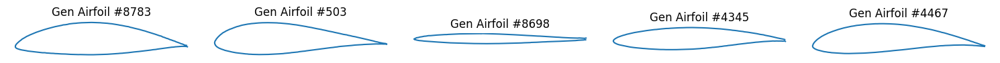

In [ ]:
import matplotlib.pyplot as plt

num_plots = 5
indices = np.random.choice(len(all_generated), num_plots, replace=False)

fig, axs = plt.subplots(1, num_plots, figsize=(3*num_plots, 3))
for i, idx in enumerate(indices):
    coords = all_generated[idx]  # shape (2, 192)
    coords_plot = coords.T       # (192, 2)
    axs[i].plot(coords_plot[:,0], coords_plot[:,1])
    axs[i].set_aspect('equal')
    axs[i].axis('off')
    axs[i].set_title(f"Gen Airfoil #{idx}")
plt.tight_layout()
plt.show()


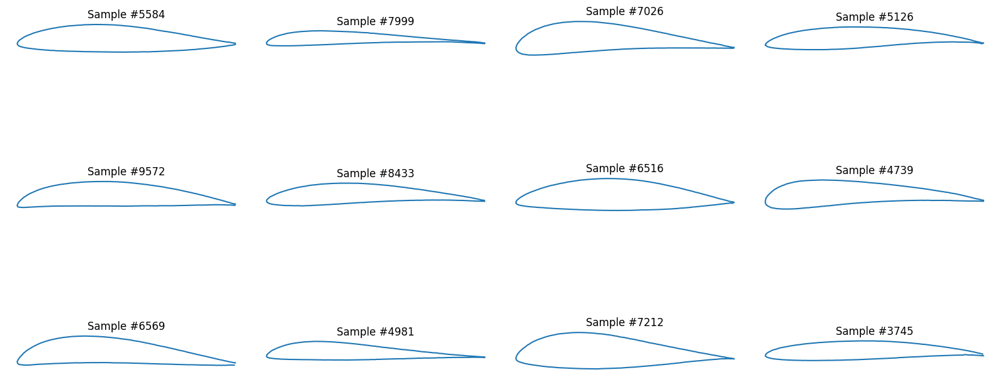

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def plot_grid_of_samples(all_generated, num_rows=3, num_cols=4):
    """
    Plots a grid of randomly chosen generated airfoils.
    :param all_generated: numpy array of shape (N, 2, 192)
    :param num_rows: number of rows in the subplot grid
    :param num_cols: number of columns in the subplot grid
    """
    fig, axs = plt.subplots(num_rows, num_cols, figsize=(4*num_cols, 3*num_rows))
    indices = np.random.choice(len(all_generated), num_rows * num_cols, replace=False)

    for i, idx in enumerate(indices):
        row = i // num_cols
        col = i % num_cols
        coords = all_generated[idx]          # (2, 192)
        coords_plot = coords.T              # (192, 2)
        axs[row, col].plot(coords_plot[:, 0], coords_plot[:, 1], lw=1.5)
        axs[row, col].set_aspect('equal')
        axs[row, col].axis('off')
        axs[row, col].set_title(f"Sample #{idx}")

    plt.tight_layout()
    plt.show()

plot_grid_of_samples(all_generated, num_rows=3, num_cols=4)


In [ ]:
# Flatten
generated_flat = all_generated.reshape(all_generated.shape[0], -1)  # (9701, 384)

xs_test = np.load('/content/data/xs_test.npy')  # shape (9701, 192, 2)
real_flat = xs_test.reshape(xs_test.shape[0], -1)  # (9701, 384)

print("generated_flat shape:", generated_flat.shape)
print("real_flat shape:", real_flat.shape)


generated_flat shape: (9701, 384)
real_flat shape: (9701, 384)


Running t-SNE on full combined dataset...


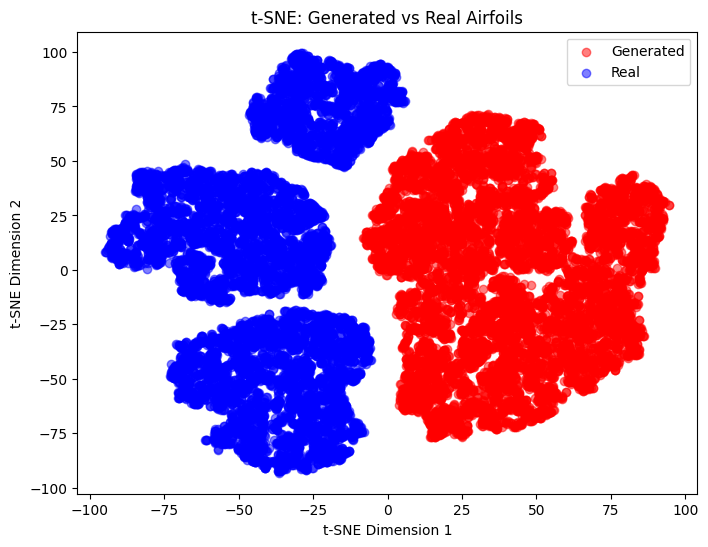

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

# Assuming generated_flat and real_flat have shapes (9701, 384) each
print("Running t-SNE on full combined dataset...")
combined = np.concatenate([generated_flat, real_flat], axis=0)  # Shape: (19402, 384)
labels = np.array([0]*len(generated_flat) + [1]*len(real_flat))   # 0=generated, 1=real

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
combined_2d = tsne.fit_transform(combined)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(combined_2d[:len(generated_flat), 0],
            combined_2d[:len(generated_flat), 1],
            c='red', alpha=0.5, label='Generated')
plt.scatter(combined_2d[len(generated_flat):, 0],
            combined_2d[len(generated_flat):, 1],
            c='blue', alpha=0.5, label='Real')
plt.legend()
plt.title("t-SNE: Generated vs Real Airfoils")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.show()


##### Performance check on the surrogate residual model

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt

# Make sure you have your SurrogateModel1D class and AirfoilDataset class defined from before
# e.g.:
# class SurrogateModel1D(nn.Module): ...
# class AirfoilDataset(Dataset): ...
# etc.

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Paths
checkpoint_dir = "/content/drive/MyDrive/AI/Airfoil_diffusion/surrogate_model/residualV1"
best_model_path = f"{checkpoint_dir}/best_model.pt"

# Reconstruct your best Residual model
residv1_best_model = SurrogateModel1D(
    n_points=192,
    in_channels=2,
    depth=16,
    residual_list=[2,2,2,2]
).to(device)

# Load the checkpoint
residv1_best_model.load_state_dict(torch.load(best_model_path, map_location=device))
residv1_best_model.eval()
print("Loaded best Residual surrogate model.")


Loaded best Residual surrogate model.


In [ ]:
def predict_airfoils_residual(model, airfoils_np, y_min, y_max, device='cpu', batch_size=128):
    """
    Predict (CL, CL/CD) in *real* scale for an array of airfoils, shape (N, 2, 192).
    Returns an array of shape (N, 2) => columns [CL_real, ratio_real].
    """
    model.eval()

    # We will store predictions here
    all_preds = []

    n_total = airfoils_np.shape[0]
    idx_start = 0

    while idx_start < n_total:
        idx_end = min(idx_start + batch_size, n_total)
        batch_np = airfoils_np[idx_start:idx_end]  # shape (batch, 2, 192)

        # Convert to torch
        batch_torch = torch.from_numpy(batch_np).float().to(device)  # (batch, 2, 192)

        with torch.no_grad():
            # Surrogate model forward => scaled predictions, shape (batch, 2)
            preds_scaled = model(batch_torch)  # in [0,1] space
            # Move to CPU for inverse scaling
            preds_scaled_cpu = preds_scaled.cpu().numpy()  # shape (batch,2)

        # Inverse scale
        eps = 1e-12
        real_label = preds_scaled_cpu * (y_max - y_min + eps) + y_min  # shape (batch,2)

        all_preds.append(real_label)
        idx_start = idx_end

    all_preds = np.concatenate(all_preds, axis=0)  # shape (N,2)
    return all_preds


In [ ]:
# 3.1) Load the generated airfoils
generated_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/generated_airfoils.npy"
gen_airfoils = np.load(generated_path)  # shape: (N_generated, 2, 192)
print("Generated airfoils shape:", gen_airfoils.shape)

# === NEW: Load training data to get bounding box for x, y ===
xs_train_path = "/content/data/xs_train.npy"
xs_train = np.load(xs_train_path)  # shape: (N_train, 192, 2)

train_xmin = xs_train[..., 0].min()
train_xmax = xs_train[..., 0].max()
train_ymin = xs_train[..., 1].min()
train_ymax = xs_train[..., 1].max()

# Compute the bounding box in the generated data
gen_xmin = gen_airfoils[:, 0, :].min()
gen_xmax = gen_airfoils[:, 0, :].max()
gen_ymin = gen_airfoils[:, 1, :].min()
gen_ymax = gen_airfoils[:, 1, :].max()

# Shift+scale the generated airfoils to match the train bounding box
gen_airfoils_shifted = gen_airfoils.copy()
eps = 1e-12

# -- X channel
gen_airfoils_shifted[:, 0, :] = (gen_airfoils_shifted[:, 0, :] - gen_xmin) / (gen_xmax - gen_xmin + eps)
gen_airfoils_shifted[:, 0, :] = gen_airfoils_shifted[:, 0, :] * (train_xmax - train_xmin) + train_xmin

# -- Y channel
gen_airfoils_shifted[:, 1, :] = (gen_airfoils_shifted[:, 1, :] - gen_ymin) / (gen_ymax - gen_ymin + eps)
gen_airfoils_shifted[:, 1, :] = gen_airfoils_shifted[:, 1, :] * (train_ymax - train_ymin) + train_ymin

gen_airfoils = gen_airfoils_shifted

# 3.2) Load the real test airfoils
real_xs_test_path = "/content/data/xs_test.npy"  # shape: (N_test, 192, 2)
real_test = np.load(real_xs_test_path)
# We want to feed them in the shape (N, 2, 192), so transpose if needed
real_test = np.transpose(real_test, (0,2,1))  # (N_test, 2, 192)
print("Real test airfoils shape (transposed):", real_test.shape)

# 3.3) Also load min_y, max_y for inverse-scaling
y_min = np.load("/content/data/y_min.npy")  # shape: (1,2)
y_max = np.load("/content/data/y_max.npy")  # shape: (1,2)


Generated airfoils shape: (9701, 2, 192)
Real test airfoils shape (transposed): (9701, 2, 192)


In [ ]:
gen_airfoils[0]

array([[ 9.83747840e-01,  9.82275367e-01,  9.80726182e-01,
         9.76694643e-01,  9.59370792e-01,  9.56759810e-01,
         9.46564674e-01,  9.42171454e-01,  9.32444453e-01,
         9.26148951e-01,  9.14748013e-01,  9.11454320e-01,
         9.03091252e-01,  8.95555317e-01,  8.82048309e-01,
         8.75299633e-01,  8.67019594e-01,  8.55401099e-01,
         8.47448468e-01,  8.37685347e-01,  8.26901376e-01,
         8.16640973e-01,  8.08567524e-01,  7.97552049e-01,
         7.86703169e-01,  7.76167989e-01,  7.68008769e-01,
         7.58242667e-01,  7.48596728e-01,  7.36991763e-01,
         7.25042403e-01,  7.12196231e-01,  7.00734437e-01,
         6.91688955e-01,  6.83263659e-01,  6.73922956e-01,
         6.60620153e-01,  6.43127024e-01,  6.30371749e-01,
         6.19307578e-01,  6.08470440e-01,  5.98793209e-01,
         5.86554825e-01,  5.73806763e-01,  5.65516651e-01,
         5.53149819e-01,  5.38079321e-01,  5.28725803e-01,
         5.20124376e-01,  5.04636645e-01,  4.93534178e-0

In [ ]:
real_test[0]

array([[ 9.79070544e-01,  9.78393137e-01,  9.76360977e-01,
         9.70665097e-01,  9.54314291e-01,  9.49958980e-01,
         9.40773189e-01,  9.34073627e-01,  9.25311744e-01,
         9.17369306e-01,  9.05916393e-01,  9.01730180e-01,
         8.92270207e-01,  8.84260476e-01,  8.69805753e-01,
         8.63483191e-01,  8.54523599e-01,  8.44979823e-01,
         8.36374938e-01,  8.26168537e-01,  8.16030383e-01,
         8.05350244e-01,  7.97733545e-01,  7.87081301e-01,
         7.77254879e-01,  7.65913486e-01,  7.57789195e-01,
         7.47857451e-01,  7.38471329e-01,  7.26753294e-01,
         7.14828908e-01,  7.00592756e-01,  6.89684570e-01,
         6.79467440e-01,  6.72558963e-01,  6.63796902e-01,
         6.51028633e-01,  6.33164287e-01,  6.22315407e-01,
         6.10876083e-01,  6.02077365e-01,  5.91758847e-01,
         5.79581916e-01,  5.68454027e-01,  5.60283780e-01,
         5.50013065e-01,  5.35189271e-01,  5.28365016e-01,
         5.19505858e-01,  5.05849183e-01,  4.93503660e-0

In [ ]:
# 4.1) Predict for generated
gen_preds = predict_airfoils_residual(
    residv1_best_model,
    gen_airfoils,
    y_min,
    y_max,
    device=device,
    batch_size=128
)  # shape (N_generated, 2) => [CL, CL/CD]

# 4.2) Predict for real test
test_preds = predict_airfoils_residual(
    residv1_best_model,
    real_test,
    y_min,
    y_max,
    device=device,
    batch_size=128
)  # shape (N_test, 2) => [CL, CL/CD]


In [ ]:
test_preds[:, 0]

array([0.19429089, 0.07191869, 0.15907964, ..., 0.21038795, 0.40636121,
       0.24275355])

In [ ]:
gen_preds[:, 0]

array([-0.1947012 , -0.09187904,  0.30647924, ..., -0.09344784,
        0.01232571,  0.61422501])

In [ ]:
def convert_CL_ratio_to_CD(pred_array):
    """
    pred_array shape: (N, 2) => columns [CL, (CL/CD)] in real scale
    returns an array shape (N,3) => columns [CL, ratio, CD]
    """
    eps = 1e-12
    CL = pred_array[:, 0]
    ratio = pred_array[:, 1]
    CD = CL / (ratio + eps)
    return np.column_stack([CL, ratio, CD])

gen_perf = convert_CL_ratio_to_CD(gen_preds)   # shape: (N_generated, 3)
test_perf = convert_CL_ratio_to_CD(test_preds) # shape: (N_test, 3)

# For convenience:
# gen_perf[:,0] = CL
# gen_perf[:,1] = CL/CD ratio
# gen_perf[:,2] = CD


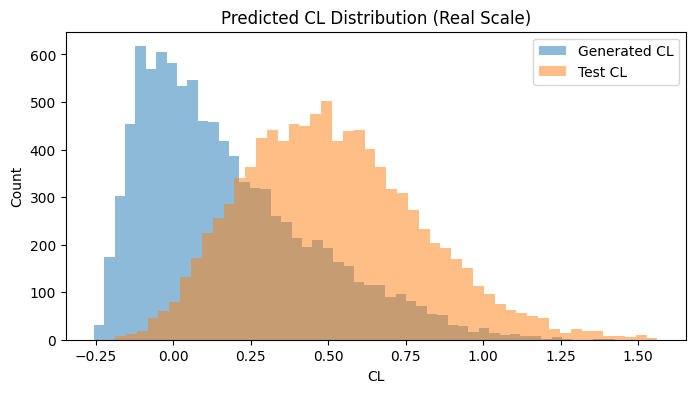

In [ ]:
plt.figure(figsize=(8,4))
plt.hist(gen_perf[:,0], bins=50, alpha=0.5, label="Generated CL")
plt.hist(test_perf[:,0], bins=50, alpha=0.5, label="Test CL")
plt.title("Predicted CL Distribution (Real Scale)")
plt.xlabel("CL")
plt.ylabel("Count")
plt.legend()
plt.show()


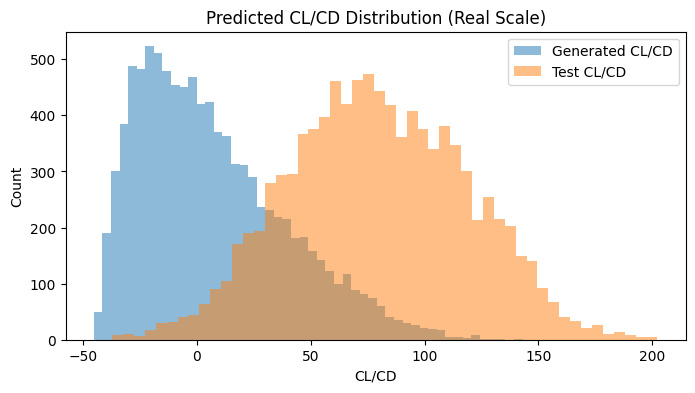

In [ ]:
plt.figure(figsize=(8,4))
plt.hist(gen_perf[:,1], bins=50, alpha=0.5, label="Generated CL/CD")
plt.hist(test_perf[:,1], bins=50, alpha=0.5, label="Test CL/CD")
plt.title("Predicted CL/CD Distribution (Real Scale)")
plt.xlabel("CL/CD")
plt.ylabel("Count")
plt.legend()
plt.show()


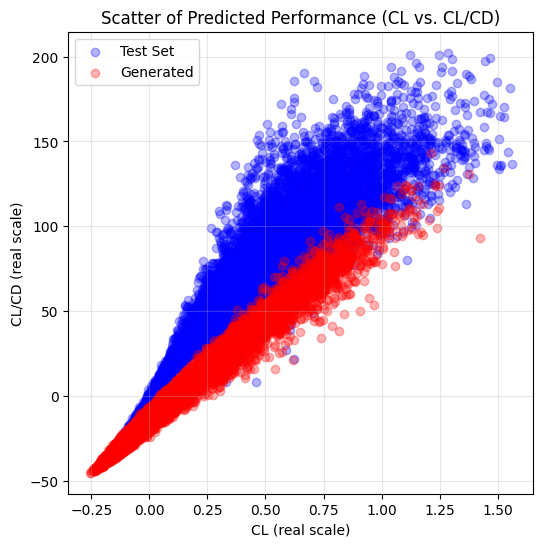

In [ ]:
plt.figure(figsize=(6,6))
plt.scatter(test_perf[:,0], test_perf[:,1], c='blue', alpha=0.3, label='Test Set')
plt.scatter(gen_perf[:,0],  gen_perf[:,1],  c='red',  alpha=0.3, label='Generated')
plt.title("Scatter of Predicted Performance (CL vs. CL/CD)")
plt.xlabel("CL (real scale)")
plt.ylabel("CL/CD (real scale)")
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()


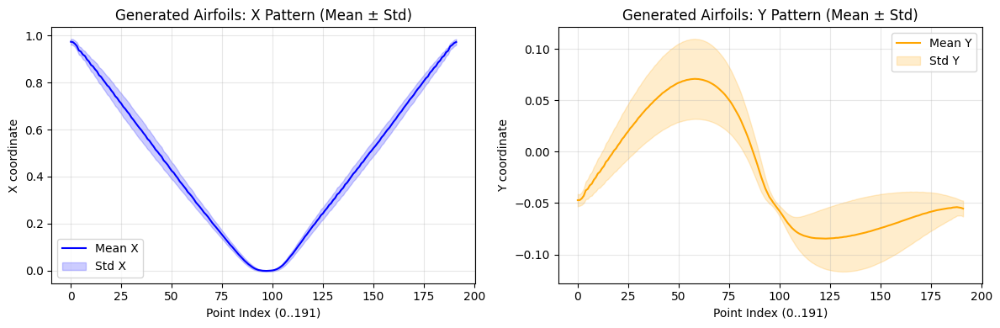

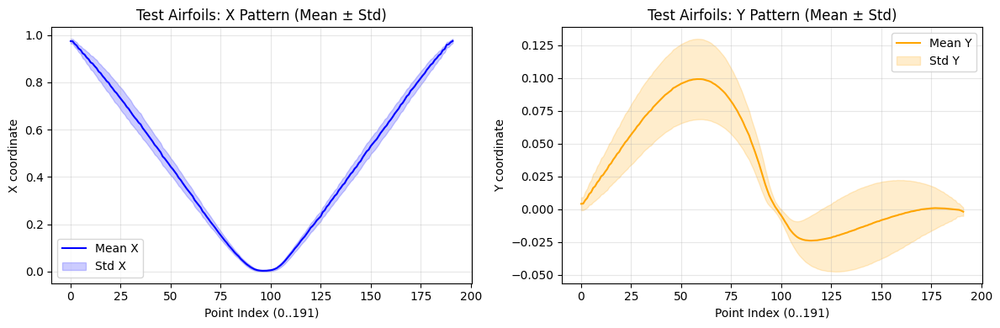

In [ ]:
def analyze_pointwise_pattern(xs, name="Data"):
    """
    xs: shape (N, 192, 2)
    """
    xs = np.asarray(xs)
    N, n_points, _ = xs.shape

    all_x = xs[..., 0]  # shape (N, 192)
    all_y = xs[..., 1]  # shape (N, 192)

    mean_x = all_x.mean(axis=0)
    std_x  = all_x.std(axis=0)
    mean_y = all_y.mean(axis=0)
    std_y  = all_y.std(axis=0)

    fig, ax = plt.subplots(1, 2, figsize=(12, 4))

    # X pattern
    ax[0].plot(mean_x, label='Mean X', color='blue')
    ax[0].fill_between(range(n_points), mean_x - std_x, mean_x + std_x,
                       alpha=0.2, color='blue', label='Std X')
    ax[0].set_title(f"{name}: X Pattern (Mean ± Std)")
    ax[0].set_xlabel("Point Index (0..191)")
    ax[0].set_ylabel("X coordinate")
    ax[0].legend()
    ax[0].grid(True, alpha=0.3)

    # Y pattern
    ax[1].plot(mean_y, label='Mean Y', color='orange')
    ax[1].fill_between(range(n_points), mean_y - std_y, mean_y + std_y,
                       alpha=0.2, color='orange', label='Std Y')
    ax[1].set_title(f"{name}: Y Pattern (Mean ± Std)")
    ax[1].set_xlabel("Point Index (0..191)")
    ax[1].set_ylabel("Y coordinate")
    ax[1].legend()
    ax[1].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

# Apply to generated
gen_airfoils_transposed = np.transpose(gen_airfoils, (0,2,1))  # shape (N,192,2)
analyze_pointwise_pattern(gen_airfoils_transposed, name="Generated Airfoils")

# Compare with test set (which might already be shape (N,2,192); transpose again):
real_test_transposed = np.transpose(real_test, (0,2,1))  # shape (N,192,2)
analyze_pointwise_pattern(real_test_transposed, name="Test Airfoils")


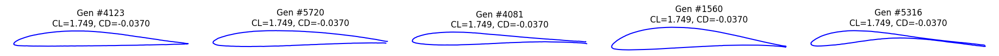

In [ ]:
def plot_generated_with_surrogate(gen_airfoils, model, y_min, y_max, device='cpu', num_samples=5):
    # gen_airfoils: shape (N, 2, 192)
    import random
    indices = random.sample(range(len(gen_airfoils)), num_samples)

    fig, axs = plt.subplots(1, num_samples, figsize=(4*num_samples, 3))

    # Predict once in a batch for these indices
    batch_data = gen_airfoils[indices]          # shape (num_samples, 2, 192)
    preds_scaled = []
    model.eval()
    with torch.no_grad():
        t = torch.from_numpy(batch_data).float().to(device)
        p = model(t)  # shape (num_samples, 2) in scaled
        preds_scaled = p.cpu().numpy()
    # Inverse scale
    eps = 1e-12
    preds_real = preds_scaled * (y_max - y_min + eps) + y_min  # shape (num_samples,2)

    for i, idx in enumerate(indices):
        coords = gen_airfoils[idx]     # (2, 192)
        coords_2d = coords.T          # (192,2)

        cl_real   = preds_real[i, 0]
        ratio     = preds_real[i, 1]
        cd_real   = cl_real / (ratio + eps)

        axs[i].plot(coords_2d[:,0], coords_2d[:,1], 'b-', lw=1.5)
        axs[i].set_aspect('equal')
        axs[i].axis('off')
        axs[i].set_title(f"Gen #{idx}\nCL={cl_real:.3f}, CD={cd_real:.4f}")

    plt.tight_layout()
    plt.show()

plot_generated_with_surrogate(gen_airfoils, residv1_best_model, y_min, y_max, device=device, num_samples=5)


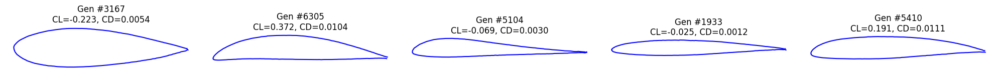

In [ ]:
def plot_generated_with_surrogate(gen_airfoils, model, y_min, y_max, device='cpu', num_samples=5):
    # gen_airfoils: shape (N, 2, 192)
    import random
    indices = random.sample(range(len(gen_airfoils)), num_samples)

    fig, axs = plt.subplots(1, num_samples, figsize=(4*num_samples, 3))

    # Predict once in a batch for these indices
    batch_data = gen_airfoils[indices]          # shape (num_samples, 2, 192)
    preds_scaled = []
    model.eval()
    with torch.no_grad():
        t = torch.from_numpy(batch_data).float().to(device)
        p = model(t)  # shape (num_samples, 2) in scaled
        preds_scaled = p.cpu().numpy()
    # Inverse scale
    eps = 1e-12
    preds_real = preds_scaled * (y_max - y_min + eps) + y_min  # shape (num_samples,2)

    for i, idx in enumerate(indices):
        coords = gen_airfoils[idx]     # (2, 192)
        coords_2d = coords.T          # (192,2)

        cl_real   = preds_real[i, 0]
        ratio     = preds_real[i, 1]
        cd_real   = cl_real / (ratio + eps)

        axs[i].plot(coords_2d[:,0], coords_2d[:,1], 'b-', lw=1.5)
        axs[i].set_aspect('equal')
        axs[i].axis('off')
        axs[i].set_title(f"Gen #{idx}\nCL={cl_real:.3f}, CD={cd_real:.4f}")

    plt.tight_layout()
    plt.show()

plot_generated_with_surrogate(gen_airfoils, residv1_best_model, y_min, y_max, device=device, num_samples=5)


In [ ]:
# Flatten
# gen_airfoils_transposed
# real_test_transposed
generated_flat = gen_airfoils_transposed.reshape(gen_airfoils_transposed.shape[0], -1)  # (9701, 384)

# xs_test = np.load('/content/data/xs_test.npy')  # shape (9701, 192, 2)
real_flat = real_test_transposed.reshape(real_test_transposed.shape[0], -1)  # (9701, 384)

print("generated_flat shape:", generated_flat.shape)
print("real_flat shape:", real_flat.shape)


generated_flat shape: (9701, 384)
real_flat shape: (9701, 384)


Running t-SNE on full combined dataset...


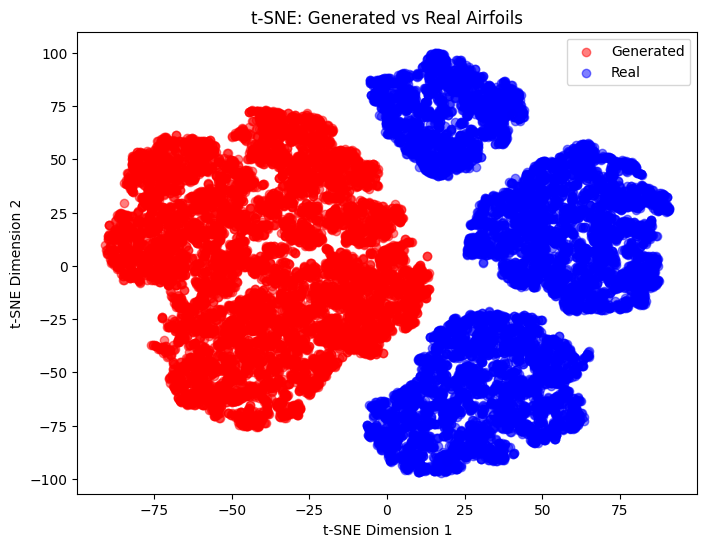

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

# Assuming generated_flat and real_flat have shapes (9701, 384) each
print("Running t-SNE on full combined dataset...")
combined = np.concatenate([generated_flat, real_flat], axis=0)  # Shape: (19402, 384)
labels = np.array([0]*len(generated_flat) + [1]*len(real_flat))   # 0=generated, 1=real

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
combined_2d = tsne.fit_transform(combined)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(combined_2d[:len(generated_flat), 0],
            combined_2d[:len(generated_flat), 1],
            c='red', alpha=0.5, label='Generated')
plt.scatter(combined_2d[len(generated_flat):, 0],
            combined_2d[len(generated_flat):, 1],
            c='blue', alpha=0.5, label='Real')
plt.legend()
plt.title("t-SNE: Generated vs Real Airfoils")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.show()


##### On x_Train

In [ ]:
xs_train = np.load('/content/data/xs_train.npy')  # shape (9701, 192, 2)
real_flat = xs_train.reshape(xs_train.shape[0], -1)  # (9701, 384)
real_flat = real_flat[:9701]
print("generated_flat shape:", generated_flat.shape)
print("real_flat shape:", real_flat.shape)


generated_flat shape: (9701, 384)
real_flat shape: (9701, 384)


Running t-SNE on full combined dataset...


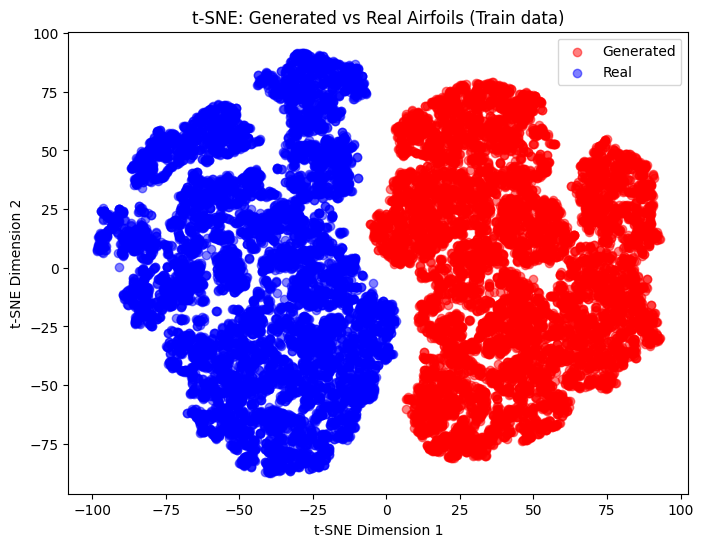

In [ ]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

# Assuming generated_flat and real_flat have shapes (9701, 384) each
print("Running t-SNE on full combined dataset...")
combined = np.concatenate([generated_flat, real_flat], axis=0)  # Shape: (19402, 384)
labels = np.array([0]*len(generated_flat) + [1]*len(real_flat))   # 0=generated, 1=real

tsne = TSNE(n_components=2, perplexity=30, random_state=42)
combined_2d = tsne.fit_transform(combined)

# Plot the results
plt.figure(figsize=(8, 6))
plt.scatter(combined_2d[:len(generated_flat), 0],
            combined_2d[:len(generated_flat), 1],
            c='red', alpha=0.5, label='Generated')
plt.scatter(combined_2d[len(generated_flat):, 0],
            combined_2d[len(generated_flat):, 1],
            c='blue', alpha=0.5, label='Real')
plt.legend()
plt.title("t-SNE: Generated vs Real Airfoils (Train data)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.show()


#### Scaled diffusion (Without RMSnorm fix)

In [ ]:
# ================================================================
#  Test
#  #### Scaled diffusion
# ================================================================
import torch, os, numpy as np, matplotlib.pyplot as plt
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ---------- 1) Re-create the model architecture -----------------
model = Unet1D(
    dim        = 32,
    dim_mults  = (2, 4, 8, 16),
    channels   = 2,
    dropout    = 0.1
).to(device)

diffusion = GaussianDiffusion1D(
    model,
    seq_length = 192,
    objective  = 'pred_noise',
    timesteps  = 1000
).to(device)

# ---------- 2) Load scaled checkpoint ---------------------------
ckpt_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499_scaled.pt"
model.load_state_dict(torch.load(ckpt_path, map_location=device))
model.eval()
print("Loaded scaled-space weights:", ckpt_path)

# ---------- 3) Helper to inverse-scale coords -------------------
DATA_DIR = Path("/content/data")
coord_mm = np.load(DATA_DIR/"coord_min_max.npy")  # [[x_min,y_min],[x_max,y_max]]
x_min,y_min = coord_mm[0]; x_max,y_max = coord_mm[1]

def inv_coords(xs_s):                   # xs_s shape (...,2,192) tensor
    xs_np = xs_s.permute(0,2,1).cpu().numpy()    # -> (B,192,2)
    xs_np[...,0] = xs_np[...,0]*(x_max-x_min) + x_min
    xs_np[...,1] = xs_np[...,1]*(y_max-y_min) + y_min
    return xs_np                                # (B,192,2) numpy

# ---------- 4) Generate same count as real test -----------------
num_to_generate = 9701
batch_size      = 128
generated_scaled = []

with torch.no_grad():
    done = 0
    while done < num_to_generate:
        cur = min(batch_size, num_to_generate - done)
        samples_s = diffusion.sample(batch_size = cur)     # (cur,2,192) scaled
        generated_scaled.append(samples_s)
        done += cur
        print(f"Generated {done}/{num_to_generate}")

generated_scaled = torch.cat(generated_scaled, dim=0)      # tensor (9701,2,192)
print("Scaled tensor shape:", generated_scaled.shape)

# ---------- 5) Inverse-scale to physical coords ----------------
generated_real = inv_coords(generated_scaled)               # numpy (9701,192,2)
np.save("/content/generated_airfoils_scaled.npy", generated_real)
print("Saved un-scaled airfoils to /content/generated_airfoils_scaled.npy")

# ---------- 6) Quick plot of 5 random airfoils -----------------
idxs = np.random.choice(len(generated_real), 5, replace=False)
fig, ax = plt.subplots(1,5, figsize=(15,3))
for j, idx in enumerate(idxs):
    xy = generated_real[idx]
    ax[j].plot(xy[:,0], xy[:,1])
    ax[j].axis('equal'); ax[j].axis('off'); ax[j].set_title(f"#{idx}")
plt.suptitle("Inverse-scaled generated airfoils"); plt.show()


Loaded scaled-space weights: /content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499_scaled.pt


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

=== Point-wise signature comparison ===


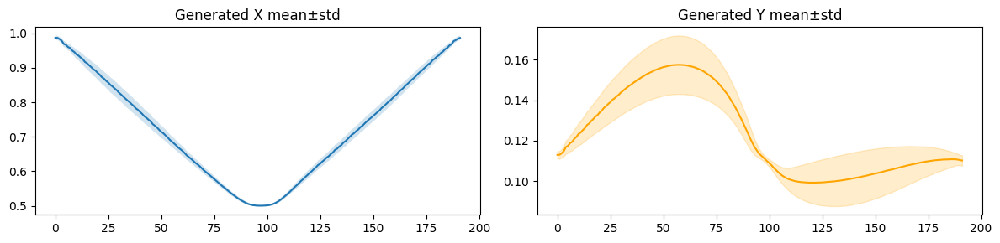

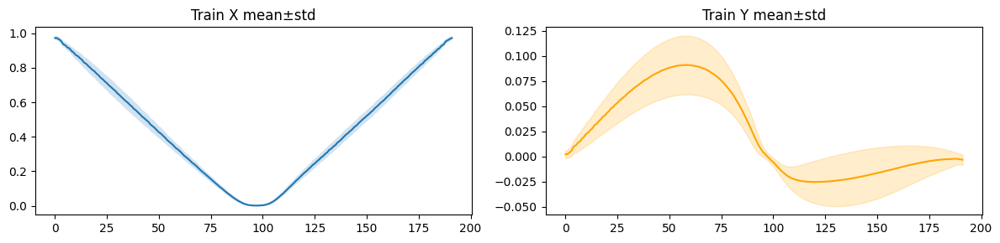

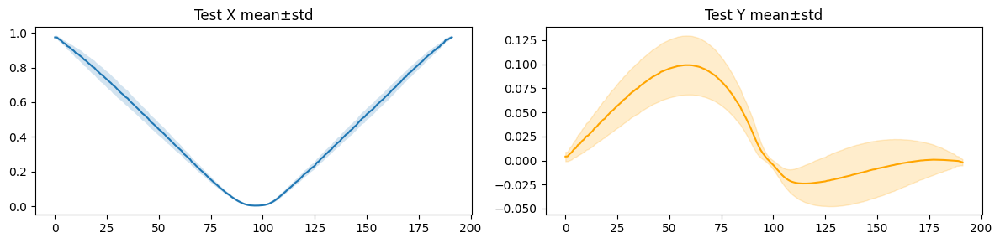

Running t-SNE on Generated vs Test …


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


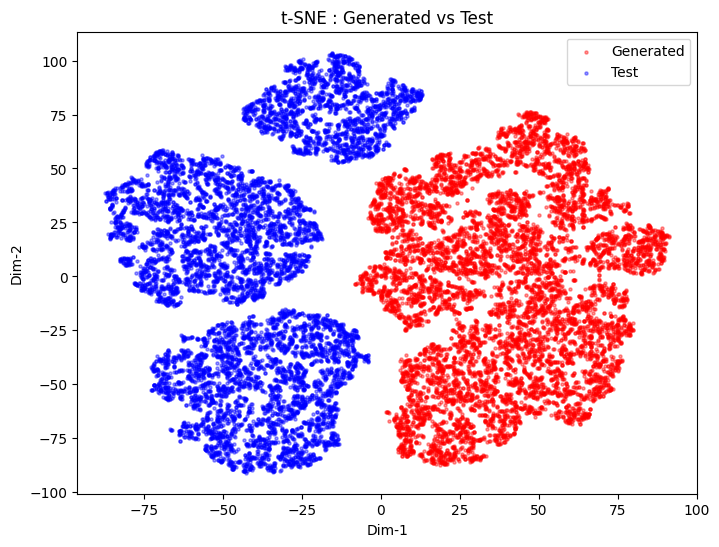

In [ ]:
# ================================================================
#  Sanity - pattern and t-SNE on inverse-scaled results
# ================================================================
import numpy as np, matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# -------- helper to draw mean ± std signature -------------------
def plot_signature(xs, name):
    xs = np.asarray(xs)                      # (N,192,2)
    mean_x, std_x = xs[...,0].mean(0), xs[...,0].std(0)
    mean_y, std_y = xs[...,1].mean(0), xs[...,1].std(0)
    fig, ax = plt.subplots(1,2, figsize=(12,3))
    ax[0].plot(mean_x); ax[0].fill_between(range(192), mean_x-std_x, mean_x+std_x, alpha=.2)
    ax[0].set_title(f"{name} X mean±std")
    ax[1].plot(mean_y, color='orange'); ax[1].fill_between(range(192), mean_y-std_y, mean_y+std_y, alpha=.2,color='orange')
    ax[1].set_title(f"{name} Y mean±std")
    plt.tight_layout(); plt.show()

# transpose generated_real to (N,192,2) if not already
gen_xyz = generated_real                     # (9701,192,2)

print("=== Point-wise signature comparison ===")
plot_signature(gen_xyz,           "Generated")
plot_signature(xs_train,          "Train")
plot_signature(xs_test,           "Test")

# -------- t-SNE settings ----------------------------------------
USE_TRAIN_AS_REAL = False          # set True to compare with train set

real_set   = xs_train if USE_TRAIN_AS_REAL else xs_test
real_label = "Train" if USE_TRAIN_AS_REAL else "Test"

# Flatten for t-SNE
gen_flat  = gen_xyz.reshape(gen_xyz.shape[0], -1)     # (N_gen, 384)
real_flat = real_set.reshape(real_set.shape[0], -1)   # (N_real,384)

print(f"Running t-SNE on Generated vs {real_label} …")
combined = np.vstack([gen_flat, real_flat])
labels   = np.array([0]*len(gen_flat) + [1]*len(real_flat))

tsne = TSNE(n_components=2, perplexity=30, random_state=42, n_iter=1000)
embed = tsne.fit_transform(combined)

plt.figure(figsize=(8,6))
plt.scatter(embed[labels==0,0], embed[labels==0,1], c='red',  alpha=.4, label='Generated', s=5)
plt.scatter(embed[labels==1,0], embed[labels==1,1], c='blue', alpha=.4, label=real_label, s=5)
plt.legend(); plt.title(f"t-SNE : Generated vs {real_label}"); plt.xlabel("Dim-1"); plt.ylabel("Dim-2")
plt.show()


####  Scaled  dpp Diffusion (Without RMSnorm fix)




Saved un-scaled airfoils to /content/generated_airfoils_real.npy


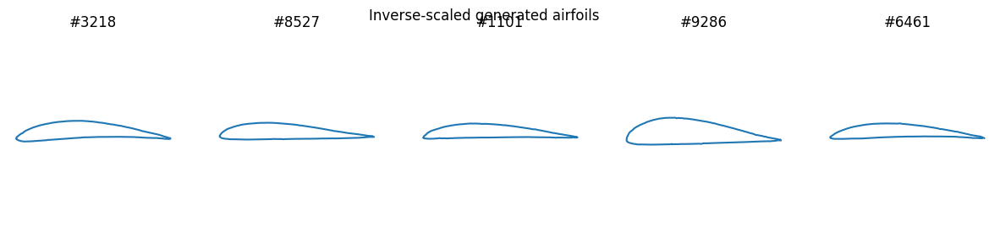

In [ ]:
# ================================================================
#  Test
#  #### Scaled diffusion
# ================================================================
import torch, os, numpy as np, matplotlib.pyplot as plt
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ---------- 1) Re-create the model architecture -----------------
model = Unet1D(
    dim        = 32,
    dim_mults  = (2, 4, 8, 16),
    channels   = 2,
    dropout    = 0.1
).to(device)

diffusion = GaussianDiffusion1D(
    model,
    seq_length = 192,
    objective  = 'pred_noise',
    timesteps  = 1000
).to(device)


surrogate_model = SurrogateModel1D(n_points=192,
                                   in_channels=2,
                                   depth=16,
                                   residual_list=[2,2,2,2]
).to(device)

load_path = rf"/content/drive/MyDrive/AI/Airfoil_diffusion/dpp_diffusion_model_scaled/best_model.pt"
surrogate_model.load_state_dict(torch.load(load_path))
surrogate_model.eval()

# ---------- 2) Load scaled checkpoint ---------------------------
ckpt_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/dpp_diffusion_model_scaled/model_epoch_400.pt"
model.load_state_dict(torch.load(ckpt_path, map_location=device))
model.eval()
print("Loaded scaled-space weights:", ckpt_path)

# ---------- 3) Helper to inverse-scale coords -------------------
DATA_DIR = Path("/content/data")
coord_mm = np.load(DATA_DIR/"coord_min_max.npy")  # [[x_min,y_min],[x_max,y_max]]
x_min,y_min = coord_mm[0]; x_max,y_max = coord_mm[1]

def inv_coords(xs_s):                   # xs_s shape (...,2,192) tensor
    xs_np = xs_s.permute(0,2,1).cpu().numpy()    # -> (B,192,2)
    xs_np[...,0] = xs_np[...,0]*(x_max-x_min) + x_min
    xs_np[...,1] = xs_np[...,1]*(y_max-y_min) + y_min
    return xs_np                                # (B,192,2) numpy

# ---------- 4) Generate same count as real test -----------------
num_to_generate = 9701
batch_size      = 128
generated_scaled = []

with torch.no_grad():
    done = 0
    while done < num_to_generate:
        cur = min(batch_size, num_to_generate - done)
        samples_s = diffusion.sample(batch_size = cur)     # (cur,2,192) scaled
        generated_scaled.append(samples_s)
        done += cur
        print(f"Generated {done}/{num_to_generate}")

generated_scaled = torch.cat(generated_scaled, dim=0)      # tensor (9701,2,192)
print("Scaled tensor shape:", generated_scaled.shape)

# ---------- 5) Inverse-scale to physical coords ----------------
generated_real = inv_coords(generated_scaled)               # numpy (9701,192,2)
np.save("/content/generated_airfoils_real.npy", generated_real)
# generated_real = np.load("/content/drive/MyDrive/AI/Airfoil_diffusion/dpp_diffusion_model_scaled/generated_airfoils_real.npy")
print("Saved un-scaled airfoils to /content/generated_airfoils_real.npy")

# ---------- 6) Quick plot of 5 random airfoils -----------------
idxs = np.random.choice(len(generated_real), 5, replace=False)
fig, ax = plt.subplots(1,5, figsize=(15,3))
for j, idx in enumerate(idxs):
    xy = generated_real[idx]
    ax[j].plot(xy[:,0], xy[:,1])
    ax[j].axis('equal'); ax[j].axis('off'); ax[j].set_title(f"#{idx}")
plt.suptitle("Inverse-scaled generated airfoils"); plt.show()


=== Point-wise signature comparison ===


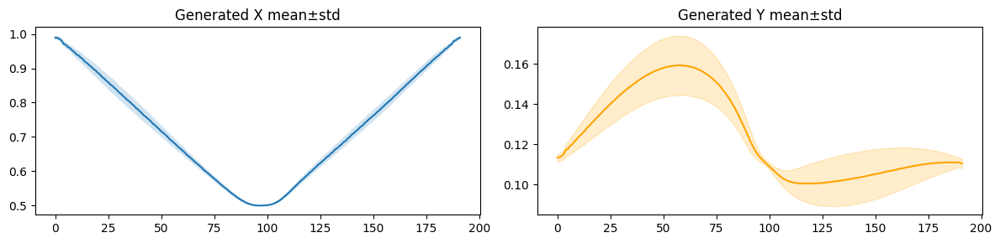

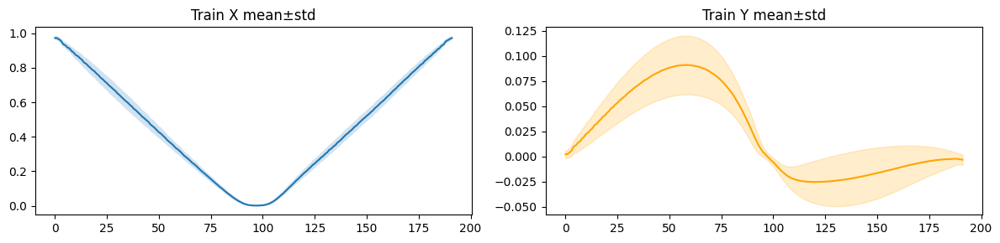

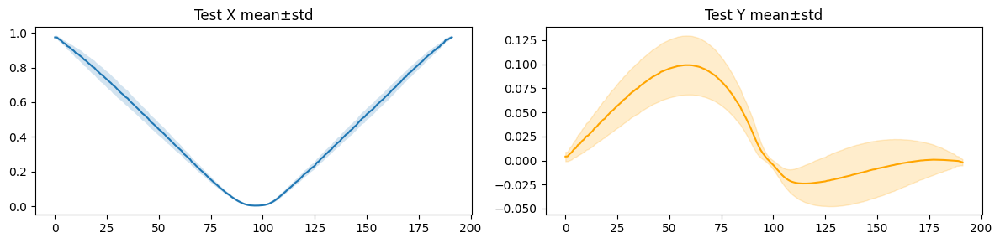

Running t-SNE on Generated vs Test …


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


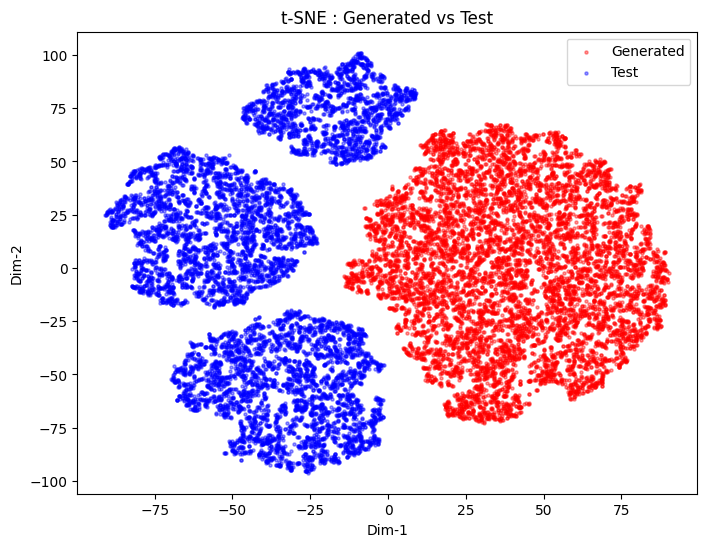

In [ ]:
# ================================================================
#  Sanity - pattern and t-SNE on inverse-scaled results
# ================================================================
import numpy as np, matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# -------- helper to draw mean ± std signature -------------------
def plot_signature(xs, name):
    xs = np.asarray(xs)                      # (N,192,2)
    mean_x, std_x = xs[...,0].mean(0), xs[...,0].std(0)
    mean_y, std_y = xs[...,1].mean(0), xs[...,1].std(0)
    fig, ax = plt.subplots(1,2, figsize=(12,3))
    ax[0].plot(mean_x); ax[0].fill_between(range(192), mean_x-std_x, mean_x+std_x, alpha=.2)
    ax[0].set_title(f"{name} X mean±std")
    ax[1].plot(mean_y, color='orange'); ax[1].fill_between(range(192), mean_y-std_y, mean_y+std_y, alpha=.2,color='orange')
    ax[1].set_title(f"{name} Y mean±std")
    plt.tight_layout(); plt.show()

# transpose generated_real to (N,192,2) if not already
gen_xyz = generated_real                     # (9701,192,2)

print("=== Point-wise signature comparison ===")
plot_signature(gen_xyz,           "Generated")
plot_signature(xs_train,          "Train")
plot_signature(xs_test,           "Test")

# -------- t-SNE settings ----------------------------------------
USE_TRAIN_AS_REAL = False          # set True to compare with train set

real_set   = xs_train if USE_TRAIN_AS_REAL else xs_test
real_label = "Train" if USE_TRAIN_AS_REAL else "Test"

# Flatten for t-SNE
gen_flat  = gen_xyz.reshape(gen_xyz.shape[0], -1)     # (N_gen, 384)
real_flat = real_set.reshape(real_set.shape[0], -1)   # (N_real,384)

print(f"Running t-SNE on Generated vs {real_label} …")
combined = np.vstack([gen_flat, real_flat])
labels   = np.array([0]*len(gen_flat) + [1]*len(real_flat))

tsne = TSNE(n_components=2, perplexity=30, random_state=42, n_iter=1000)
embed = tsne.fit_transform(combined)

plt.figure(figsize=(8,6))
plt.scatter(embed[labels==0,0], embed[labels==0,1], c='red',  alpha=.4, label='Generated', s=5)
plt.scatter(embed[labels==1,0], embed[labels==1,1], c='blue', alpha=.4, label=real_label, s=5)
plt.legend(); plt.title(f"t-SNE : Generated vs {real_label}"); plt.xlabel("Dim-1"); plt.ylabel("Dim-2")
plt.show()


#### Uncaled diffusion (With RMSnorm and gussian norm fix)

Loaded scaled-space weights: /content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499_RMSnorm_unscaled.pt


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 128/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 256/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 384/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 512/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 640/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 768/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 896/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1024/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1152/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1280/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1408/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1536/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1664/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1792/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 1920/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2048/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2176/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2304/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2432/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2560/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2688/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2816/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 2944/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3072/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3200/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3328/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3456/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3584/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3712/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3840/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 3968/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4096/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4224/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4352/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4480/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4608/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4736/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4864/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 4992/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5120/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5248/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5376/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5504/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5632/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5760/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 5888/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6016/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6144/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6272/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6400/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6528/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6656/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6784/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 6912/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7040/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7168/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7296/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7424/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7552/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7680/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7808/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 7936/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8064/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8192/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8320/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8448/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8576/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8704/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8832/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 8960/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9088/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9216/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9344/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9472/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9600/9701


sampling loop time step:   0%|          | 0/1000 [00:00<?, ?it/s]

Generated 9701/9701
Scaled tensor shape: torch.Size([9701, 2, 192])
Saved un-scaled airfoils to /content/generated_airfoils_scaled.npy


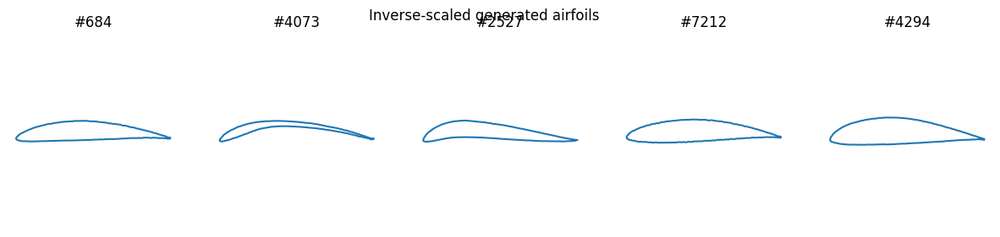

In [18]:
# ============================

# ====================================
#  Test
#  #### Scaled diffusion
# ================================================================
import torch, os, numpy as np, matplotlib.pyplot as plt
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ---------- 1) Re-create the model architecture -----------------
model = Unet1D(
    dim        = 32,
    dim_mults  = (2, 4, 8, 16),
    channels   = 2,
    dropout    = 0.1
).to(device)

diffusion = GaussianDiffusion1D(
    model,
    seq_length = 192,
    objective  = 'pred_noise',
    timesteps  = 1000
).to(device)

# ---------- 2) Load scaled checkpoint ---------------------------
ckpt_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/model_epoch_499_RMSnorm_unscaled.pt"
model.load_state_dict(torch.load(ckpt_path, map_location=device))
model.eval()
print("Loaded scaled-space weights:", ckpt_path)

# ---------- 3) Helper to inverse-scale coords -------------------
DATA_DIR = Path("/content/data")
coord_mm = np.load(DATA_DIR/"coord_min_max.npy")  # [[x_min,y_min],[x_max,y_max]]
x_min,y_min = coord_mm[0]; x_max,y_max = coord_mm[1]

def inv_coords(xs_s):                   # xs_s shape (...,2,192) tensor
    xs_np = xs_s.permute(0,2,1).cpu().numpy()    # -> (B,192,2)
    xs_np[...,0] = xs_np[...,0]*(x_max-x_min) + x_min
    xs_np[...,1] = xs_np[...,1]*(y_max-y_min) + y_min
    return xs_np                                # (B,192,2) numpy

# ---------- 4) Generate same count as real test -----------------
num_to_generate = 9701
batch_size      = 128
generated_scaled = []

with torch.no_grad():
    done = 0
    while done < num_to_generate:
        cur = min(batch_size, num_to_generate - done)
        samples_s = diffusion.sample(batch_size = cur)     # (cur,2,192) scaled
        generated_scaled.append(samples_s)
        done += cur
        print(f"Generated {done}/{num_to_generate}")

generated_scaled = torch.cat(generated_scaled, dim=0)      # tensor (9701,2,192)
print("Scaled tensor shape:", generated_scaled.shape)

# ---------- 5) Inverse-scale to physical coords ----------------
generated_real = inv_coords(generated_scaled)               # numpy (9701,192,2)
np.save("/content/new_new_generated_airfoils_scaled.npy", generated_real)
print("Saved un-scaled airfoils to /content/generated_airfoils_scaled.npy")

# ---------- 6) Quick plot of 5 random airfoils -----------------
idxs = np.random.choice(len(generated_real), 5, replace=False)
fig, ax = plt.subplots(1,5, figsize=(15,3))
for j, idx in enumerate(idxs):
    xy = generated_real[idx]
    ax[j].plot(xy[:,0], xy[:,1])
    ax[j].axis('equal'); ax[j].axis('off'); ax[j].set_title(f"#{idx}")
plt.suptitle("Inverse-scaled generated airfoils"); plt.show()


In [20]:
generated_real = inv_coords(generated_scaled)               # numpy (9701,192,2)
save_path = "/content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/generated_airfoils_RMS_fixed_auto_norm_false.npy"
np.save(save_path, generated_real)
print(f"Saved RMSnorm fixed generated airfoils to: {save_path}")


Saved RMSnorm fixed generated airfoils to: /content/drive/MyDrive/AI/Airfoil_diffusion/model_weights/Simple_DDPM/generated_airfoils_RMS_fixed_auto_norm_false.npy


=== Point-wise signature comparison ===


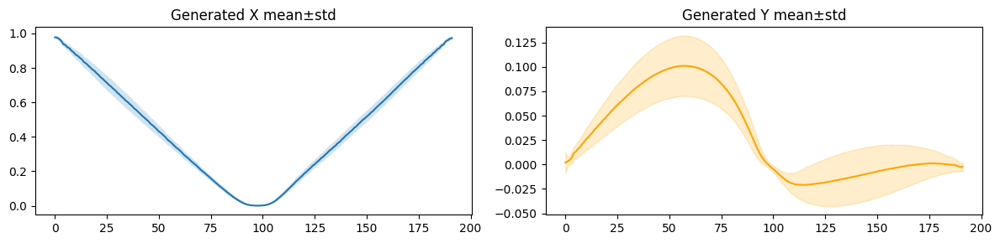

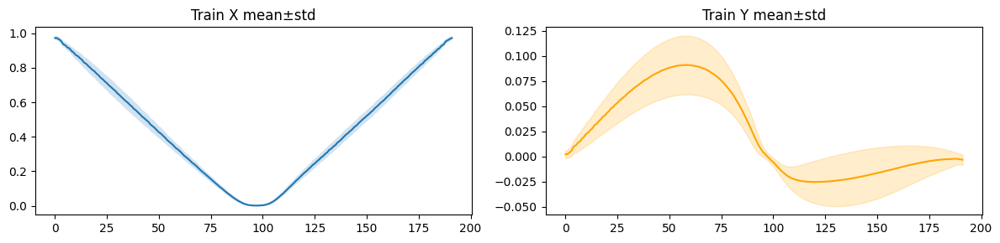

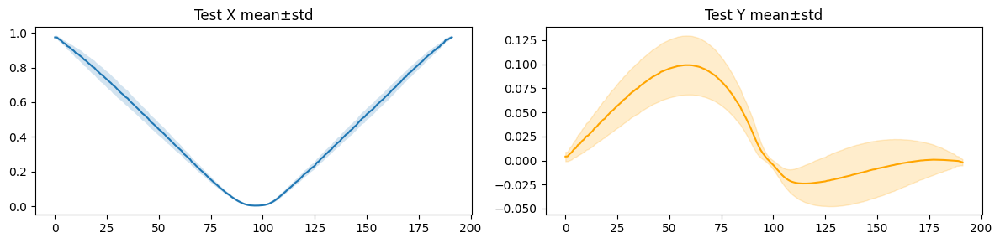

Running t-SNE on Generated vs Test …


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


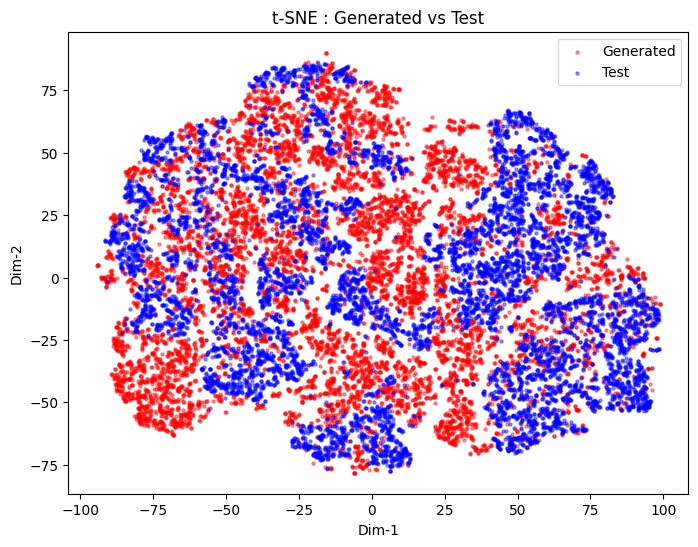

In [21]:
# ================================================================
#  Sanity - pattern and t-SNE on inverse-scaled results
# ================================================================
import numpy as np, matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# -------- helper to draw mean ± std signature -------------------
def plot_signature(xs, name):
    xs = np.asarray(xs)                      # (N,192,2)
    mean_x, std_x = xs[...,0].mean(0), xs[...,0].std(0)
    mean_y, std_y = xs[...,1].mean(0), xs[...,1].std(0)
    fig, ax = plt.subplots(1,2, figsize=(12,3))
    ax[0].plot(mean_x); ax[0].fill_between(range(192), mean_x-std_x, mean_x+std_x, alpha=.2)
    ax[0].set_title(f"{name} X mean±std")
    ax[1].plot(mean_y, color='orange'); ax[1].fill_between(range(192), mean_y-std_y, mean_y+std_y, alpha=.2,color='orange')
    ax[1].set_title(f"{name} Y mean±std")
    plt.tight_layout(); plt.show()

# transpose generated_real to (N,192,2) if not already
gen_xyz = generated_real                     # (9701,192,2)

print("=== Point-wise signature comparison ===")
plot_signature(gen_xyz,           "Generated")
plot_signature(xs_train,          "Train")
plot_signature(xs_test,           "Test")

# # -------- t-SNE settings ----------------------------------------
USE_TRAIN_AS_REAL = False          # set True to compare with train set

real_set   = xs_train if USE_TRAIN_AS_REAL else xs_test
real_label = "Train" if USE_TRAIN_AS_REAL else "Test"

# Flatten for t-SNE
gen_flat  = gen_xyz.reshape(gen_xyz.shape[0], -1)     # (N_gen, 384)
real_flat = real_set.reshape(real_set.shape[0], -1)   # (N_real,384)

print(f"Running t-SNE on Generated vs {real_label} …")
combined = np.vstack([gen_flat, real_flat])
labels   = np.array([0]*len(gen_flat) + [1]*len(real_flat))

tsne = TSNE(n_components=2, perplexity=30, random_state=42, n_iter=1000)
embed = tsne.fit_transform(combined)

plt.figure(figsize=(8,6))
plt.scatter(embed[labels==0,0], embed[labels==0,1], c='red',  alpha=.4, label='Generated', s=5)
plt.scatter(embed[labels==1,0], embed[labels==1,1], c='blue', alpha=.4, label=real_label, s=5)
plt.legend(); plt.title(f"t-SNE : Generated vs {real_label}"); plt.xlabel("Dim-1"); plt.ylabel("Dim-2")
plt.show()


Running t-SNE on Generated vs Test …


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


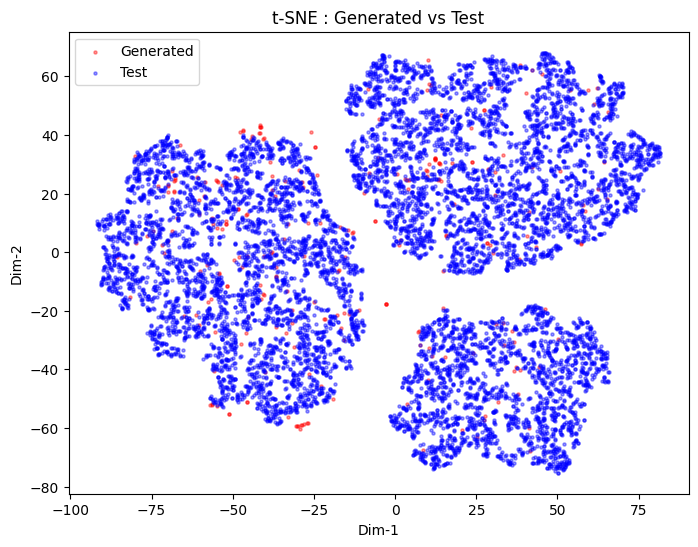

In [ ]:
# -------- t-SNE settings ----------------------------------------
USE_TRAIN_AS_REAL = False          # set True to compare with train set

real_set   = xs_train if USE_TRAIN_AS_REAL else xs_test
real_label = "Train" if USE_TRAIN_AS_REAL else "Test"

# Flatten for t-SNE
gen_flat  = gen_xyz.reshape(gen_xyz.shape[0], -1)     # (N_gen, 384)
real_flat = real_set.reshape(real_set.shape[0], -1)   # (N_real,384)

print(f"Running t-SNE on Generated vs {real_label} …")
combined = np.vstack([gen_flat, real_flat])
labels   = np.array([0]*len(gen_flat) + [1]*len(real_flat))

tsne = TSNE(n_components=2, perplexity=30, random_state=42, n_iter=1000)
embed = tsne.fit_transform(combined)

plt.figure(figsize=(8,6))
plt.scatter(embed[labels==0,0], embed[labels==0,1], c='red',  alpha=.4, label='Generated', s=5)
plt.scatter(embed[labels==1,0], embed[labels==1,1], c='blue', alpha=.4, label=real_label, s=5)
plt.legend(); plt.title(f"t-SNE : Generated vs {real_label}"); plt.xlabel("Dim-1"); plt.ylabel("Dim-2")
plt.show()

## geting the score of the surrogate  model

In [ ]:
generated_samples = np.load("/content/drive/MyDrive/AI/Airfoil_diffusion/dpp_diffusion_model_scaled/generated_airfoils_real.npy")
generated_samples.shape

(9701, 192, 2)

In [ ]:
generated_samples.transpose(1,2)
generated_samples.shape

ValueError: axes don't match array